In [1]:
!pip install seaborn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
# -*- coding: utf-8 -*-
import sys
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.utils.rnn as rnn_utils
import torch.optim as optim
import torch.nn.utils as utils
import seaborn as sns
import matplotlib.pyplot as plt
import time
import random
from torch.utils import data
from tqdm import tqdm

from torch.utils.data import DataLoader
from torch.nn.utils.rnn import pad_sequence,pack_padded_sequence,pad_packed_sequence


cuda = torch.cuda.is_available()
print(cuda, sys.version)
device = torch.device("cuda" if cuda else "cpu")
np.random.seed(420)
torch.manual_seed(420)

LETTER_LIST = ['<sos>', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 
               'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '-', "'", '.', '_', '+', ' ', '<eos>']

True 3.7.13 (default, Apr 24 2022, 01:04:09) 
[GCC 7.5.0]


In [10]:
from typing import List, Tuple, Dict
#%%
def create_dictionaries(letter_list: List[str]) -> Tuple[Dict[str, int], Dict[int, str]]:
    '''
    Create dictionaries for letter2index and index2letter transformations
    '''
    letter2index, index2letter = {}, {}
    for i, j in enumerate(letter_list):
      letter2index[j] = i
      index2letter[i] = j
    return (letter2index, index2letter)
    
def transform_letter_to_index(raw_transcripts: List[str]) -> List[List[int]]:
    '''
    Transforms text input to numerical input by converting each letter 
    to its corresponding index from letter_list

    Args:
        raw_transcripts: Raw text transcripts
    
    Return:
        transcripts: Converted index-format transcripts.
    '''  
    transcripts = []
    for raw in raw_transcripts:
        transcripts2index = list(map(lambda x: LETTER_LIST.index(x), raw))
        transcripts.append(transcripts2index)
    return transcripts
    
# Create the letter2index and index2letter dictionary
letter2index, index2letter = create_dictionaries(LETTER_LIST)

In [11]:
%cd /content/drive/MyDrive/Colab Notebooks/hw4p2_toy_dataset

/content/drive/MyDrive/Colab Notebooks/hw4p2_toy_dataset


In [12]:
# Load the training, validation and testing data
train_data = np.load('train.npz', allow_pickle=True, encoding='bytes')['data'] # Training set contains a random sequence of characters, each of variable length and 40 frequency bands.
valid_data = np.load('dev.npz', allow_pickle=True, encoding='bytes')['data'] # Development set contains a random sequence of characters, each of variable length and 40 frequency bands.

# Load the training, validation raw text transcripts
raw_train_transcript = np.load('train_transcripts.npz', allow_pickle=True)['data'] # Transcripts corresponding to the sequences in train.npz. These are arranged in the same order as the sequences.
raw_valid_transcript = np.load('dev_transcripts.npz', allow_pickle=True)['data'] # Transcripts corresponding to the sequences in dev.npz. These are arranged in the same order as the sequences.

# Convert the raw text transcripts into indexes
train_transcript = transform_letter_to_index(raw_train_transcript) # A list of list of ints 
valid_transcript = transform_letter_to_index(raw_valid_transcript)

In [13]:
class MyDataset(data.Dataset):
    def __init__(self, X, Y):
        self.X = X
        self.Y = Y

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, index):
        # For testing set, return only x
        if self.Y is None:
            return torch.as_tensor(self.X[index])
        # For training and validation set, return x and y
        else:
            return torch.as_tensor(self.X[index]), torch.as_tensor(self.Y[index])

def collate_train_val(data):
    """
    Return:
        pad_x: the padded x (training/validation speech data) 
        pad_y: the padded y (text labels - transcripts)
        x_len: the length of x
        y_len: the length of y
    """
    #data is a list of (x,y)
    x,y = zip(*data)
    pad_x = pad_sequence(x, batch_first=True)
    pad_y = pad_sequence(y, batch_first=True)
    x_len= torch.tensor([len(i) for i in x])
    y_len= torch.tensor([len(i) for i in y])
    return (pad_x, pad_y, x_len, y_len)

In [14]:
# Create datasets
batch_size=64
# Create datasets
train_dataset = MyDataset(train_data, train_transcript)
valid_dataset = MyDataset(valid_data, valid_transcript)


# Create data loaders
train_loader = data.DataLoader(dataset=train_dataset, 
                          batch_size=batch_size, 
                          shuffle=True, 
                          collate_fn=collate_train_val,
                          num_workers = 2,
                          pin_memory = True)
valid_loader = data.DataLoader(dataset=valid_dataset, 
                          batch_size=1, shuffle=False, 
                          collate_fn=collate_train_val,
                          num_workers = 2,
                          pin_memory = True)

In [15]:
class pBLSTM(nn.Module):
    '''
    Pyramidal BiLSTM
    Read paper and understand the concepts and then write your implementation here.
    '''
    def __init__(self, input_dim, hidden_dim):
        super(pBLSTM, self).__init__()
        self.blstm = nn.LSTM(input_size=input_dim, 
                             hidden_size=hidden_dim, num_layers=1, 
                             batch_first=True, bidirectional=True)
    def forward(self, x):
        x_unpacked, len_x = pad_packed_sequence(x, batch_first=True)
        # Truncate the input length dimension with odd length input
        seq_len = x_unpacked.shape[1]
        if seq_len % 2:
          x_unpacked = x_unpacked[:, :-1, :]
          len_x = torch.where(len_x == seq_len, seq_len - 1, len_x)
        new_L = x_unpacked.shape[1]//2
        x_reshaped = x_unpacked.reshape(x_unpacked.shape[0], new_L, x_unpacked.shape[2]*2)
        len_x = torch.where(len_x > new_L, new_L, len_x)
        x_pad = pack_padded_sequence(x_reshaped, len_x, batch_first=True, enforce_sorted=False)
        out,_ = self.blstm(x_pad) 
        return out

In [16]:
class Encoder(nn.Module):
    '''
    Encoder takes the utterances as inputs and returns the key, value and unpacked_x_len.

    '''
    def __init__(self, input_dim, encoder_hidden_dim, key_value_size=128):
        super(Encoder, self).__init__()
        # The first LSTM layer at the bottom
        self.lstm = nn.LSTM(input_size=input_dim,
                            hidden_size=encoder_hidden_dim,
                            num_layers=1, batch_first=True,
                            bidirectional=True)
        # self.pBLSTMs = nn.Sequential(
        #     pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim),
        #     pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim),
        #     pBLSTM(input_dim=encoder_hidden_dim*4, hidden_dim=encoder_hidden_dim)
        # )
        self.key_network = nn.Linear(encoder_hidden_dim*2, key_value_size)
        self.value_network = nn.Linear(encoder_hidden_dim*2, key_value_size)
    def forward(self, x, x_len):
        pack_x = pack_padded_sequence(x, x_len, batch_first=True, enforce_sorted=False)
        out,_ = self.lstm(pack_x)
        # out = self.pBLSTMs(out) # Not using pBLSTM 
        out_packed, len_out = pad_packed_sequence(out, batch_first=True)
        key = self.key_network(out_packed)
        value = self.value_network(out_packed)
        return key, value, len_out

In [17]:
def plot_attention(attention):
    # utility function for debugging
    plt.clf()
    sns.heatmap(attention, cmap='GnBu')
    plt.show()

class Attention(nn.Module):
    '''
    Attention is calculated using key and value from encoder and query from decoder.
    '''
    def __init__(self):
        super(Attention, self).__init__()

    def forward(self, query, key, value, mask):
        """
        input:
            key: (batch_size, seq_len, d_k)
            value: (batch_size, seq_len, d_v)
            query: (batch_size, d_q)
        return:
            context: (batch_size, key_val_dim)
        
        """
        # Dot-product attention
        out = torch.bmm(key, query.unsqueeze(2)).squeeze(2) # Compute the energy of the attention, (batch_size, seq_len)
        out.masked_fill_(mask, -(1e9))
        
        attention = F.softmax(out, dim=1) # (batch_size, seq_len)
        
        context = torch.bmm(attention.unsqueeze(1), value).squeeze(1) # Compute the context, (batch_size, d_v)
        return context, attention      

In [18]:
class Decoder(nn.Module):
    '''
    As mentioned in a previous recitation, each forward call of decoder deals with just one time step.
    Thus we use LSTMCell instead of LSTM here.
    The output from the last LSTMCell can be used as a query for calculating attention.
    Methods like Gumble noise and teacher forcing can also be incorporated for improving the performance.
    '''
    def __init__(self, vocab_size, decoder_hidden_dim, embed_dim, key_value_size=128):
        super(Decoder, self).__init__()
        # padded value = 0 -> padding_idx = 0 : no gradient update on padded values
        self.embedding = nn.Embedding(vocab_size, 
                                      embedding_dim=embed_dim, 
                                      padding_idx=0)
        # The number of cells is defined based on the paper
        self.lstm1 = nn.LSTMCell(embed_dim + key_value_size, decoder_hidden_dim) # Context ci−1 is be used as an extra input by concatenated with the input
        self.lstm2 = nn.LSTMCell(decoder_hidden_dim, key_value_size)
    
        self.attention = Attention()     
        self.vocab_size = vocab_size
        self.key_value_size = key_value_size
      
        self.character_prob = nn.Linear(2*key_value_size, vocab_size) #: concat query and context [d_q, d_v] -> vocab_size
        # Weight tying
        self.character_prob.weight = self.embedding.weight

        


    def forward(self, key, value, encoder_len, mode, y=None):
        '''
        Args:
            key :(B, T, d_k) - Output of the Encoder (possibly from the Key projection layer)
            value: (B, T, d_v) - Output of the Encoder (possibly from the Value projection layer)
            y: (B, text_len) - Batch input of text with text_length
            mode: Train or eval mode for teacher forcing
        Return:
            predictions: the character perdiction probability 
        '''

        B, key_seq_max_len, key_value_size = key.shape
        max_len =  y.shape[1]

        # Create the attention mask here (outside the for loop rather than inside) to aviod repetition
        mask = torch.arange(key_seq_max_len).unsqueeze(0) >= encoder_len.unsqueeze(1)
        mask = mask.to(device)
        
        predictions = []
        # This is the first input to the decoder
        prediction = torch.full((B,), fill_value=letter2index['<sos>'], device=device) #dtype=long
        # The length of hidden_states vector should depend on the number of LSTM Cells defined in init
        # The paper uses 2
        hidden_states = [None, None] 
        
        # Initialize the context
        context = value[:, 0, :]

        attention_plot = [] 

        for i in range(max_len):
            if mode == 'train':
                # Implement Teacher Forcing               
                rate = random.random()
                teacher_forcing = True if rate > 0.1 else False
                if i == 0:
                    char_embed = self.embedding(prediction) # [B, embed_dim]
                else:
                    if teacher_forcing:
                        char_embed = self.embedding(y[:,i-1])
                    else:
                        char_embed = self.embedding(prediction.argmax(dim=-1))
            else:
                if i == 0:
                    char_embed = self.embedding(prediction)
                else:
                    char_embed = self.embedding(prediction.argmax(dim=-1)) # embedding of the previous prediction
                    
            y_context = torch.cat([char_embed, context], dim=1)
            # context and hidden states of lstm 1 from the previous time step should be fed
            hidden_states[0] = self.lstm1(y_context, hidden_states[0])

            # hidden states of lstm1 and hidden states of lstm2 from the previous time step should be fed
            hidden_states[1] = self.lstm2(hidden_states[0][0], hidden_states[1])

            query = hidden_states[1][0] # [B, key_value_size]
            
            # Compute attention from the output of the second LSTM Cell
            context, attention = self.attention(query, key, value, mask)
            if mode == 'train':
                attention_plot.append(attention[:1].detach().cpu()) # Append the first batch for debugging
            else:
                attention_plot.append(attention.detach().cpu())

            output_context = torch.cat([query, context], dim=1)
            prediction = self.character_prob(output_context)
            # store predictions
            predictions.append(prediction.unsqueeze(1))
        
        # Concatenate the attention and predictions to return
        attentions = torch.stack(attention_plot, dim=1)
        predictions = torch.cat(predictions, dim=1)
        return predictions, attentions
#%%

In [19]:
class Seq2Seq(nn.Module):
    '''
    We train an end-to-end sequence to sequence model comprising of Encoder and Decoder.
    '''
    def __init__(self, input_dim, vocab_size, encoder_hidden_dim=256, decoder_hidden_dim=512, embed_dim=256, key_value_size=128):
        super().__init__()
        self.encoder = Encoder(input_dim, encoder_hidden_dim, key_value_size)
        self.decoder = Decoder(vocab_size, decoder_hidden_dim, embed_dim, key_value_size)

    def forward(self, x, x_len, y=None, mode='train'):
        key, value, encoder_len = self.encoder(x, x_len)
        predictions, attentions = self.decoder(key, value, encoder_len, y=y, mode=mode)
        return predictions, attentions

In [20]:
def train(model, train_loader, criterion, optimizer):
    model.train()
    running_loss = 0
    
    
    for i, (x, y, x_len, y_len) in enumerate(train_loader):
        x, y = x.to(device), y.to(device)
        optimizer.zero_grad()
        predictions, attentions = model(x, x_len, y, mode='train')
        y_len = y_len.to(device)
        # Generate a mask based on target length. This is to mark padded elements
        # so that we can exclude them from computing loss
        ymax_len = y.shape[1]
        mask = (torch.arange(ymax_len).repeat(y_len.size(0), 1).to(device) < y_len.unsqueeze(1).expand(y_len.size(0), ymax_len)).int()# fill this out
            
        loss =  criterion(predictions.view(-1, predictions.shape[2]),y.view(-1))
        # Use the mask defined above to compute the average loss
        masked_loss = torch.sum(loss * mask.view(-1)) / torch.sum(mask)

        # backprop
        masked_loss.backward()
        
        optimizer.step() 
        # plot_attention(attentions[0]) # For debugging
        pbar.update(pbar_num)
        
        
def val(model, valid_loader):
    model.eval()
    attention_list = []
    with torch.no_grad(): 
      for i, (x, y, x_len, y_len) in enumerate(valid_loader):
          x, y = x.to(device), y.to(device)
          predictions, attentions = model(x, x_len, y, mode='val')
          pbar.update(pbar_num)
          for attention in (attentions):
            plot_attention(attention)
          attention_list.append(attentions)
    return attention_list

  2%|▏         | 0.6108949416342395/30 [00:11<09:14, 18.86s/it]

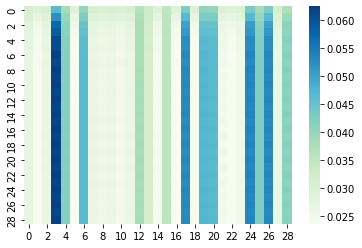

  2%|▏         | 0.6186770428015547/30 [00:11<17:39, 36.06s/it]

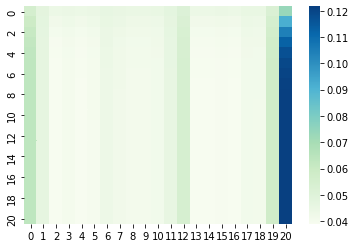

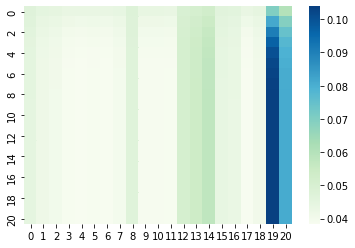

  2%|▏         | 0.6264591439688698/30 [00:12<22:44, 46.45s/it]

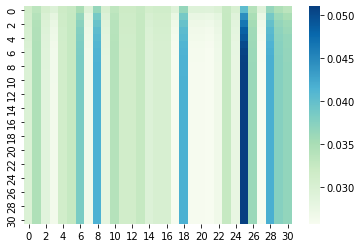

  2%|▏         | 0.6303501945525274/30 [00:12<24:32, 50.15s/it]

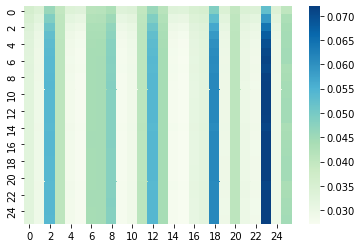

  2%|▏         | 0.634241245136185/30 [00:12<26:35, 54.32s/it] 

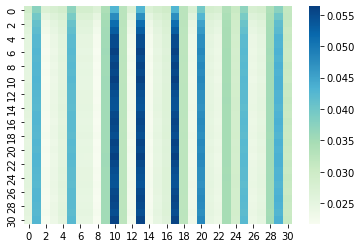

  2%|▏         | 0.6381322957198425/30 [00:13<28:18, 57.83s/it]

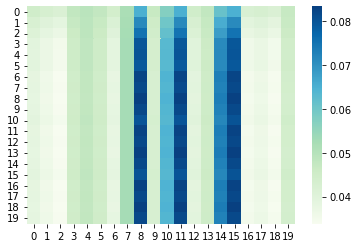

  2%|▏         | 0.6420233463035001/30 [00:13<34:18, 70.12s/it]

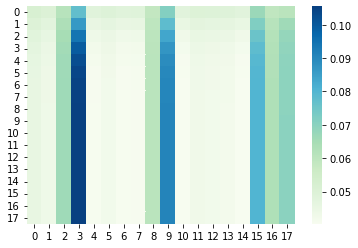

  2%|▏         | 0.6459143968871577/30 [00:13<34:37, 70.79s/it]

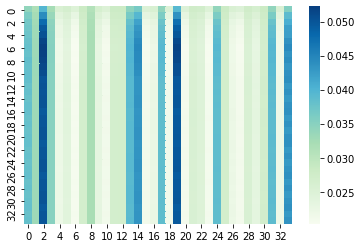

  2%|▏         | 0.6498054474708153/30 [00:14<34:57, 71.48s/it]

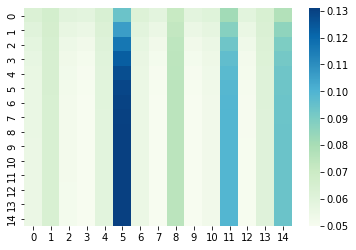

  2%|▏         | 0.6536964980544728/30 [00:14<34:16, 70.06s/it]

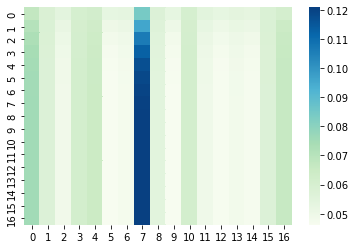

  2%|▏         | 0.6575875486381304/30 [00:14<34:23, 70.34s/it]

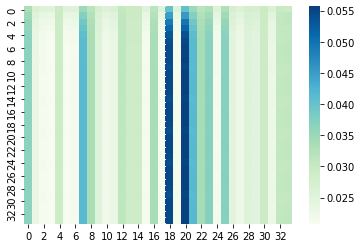

  2%|▏         | 0.661478599221788/30 [00:15<34:33, 70.68s/it] 

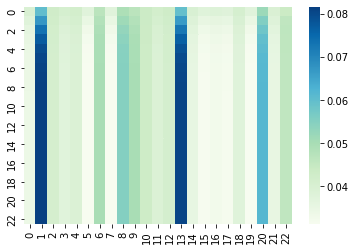

  2%|▏         | 0.6653696498054456/30 [00:15<34:55, 71.43s/it]

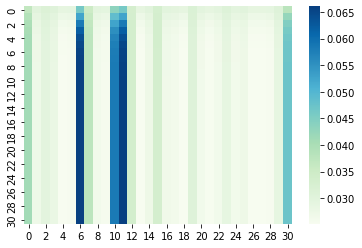

  2%|▏         | 0.6692607003891031/30 [00:15<35:04, 71.75s/it]

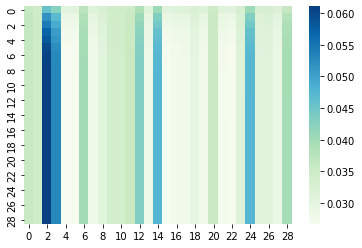

  2%|▏         | 0.6731517509727607/30 [00:15<34:47, 71.19s/it]

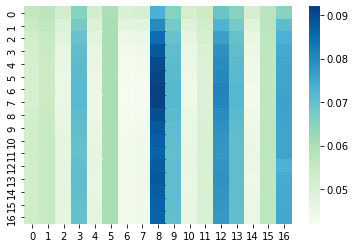

  2%|▏         | 0.6770428015564183/30 [00:16<34:39, 70.90s/it]

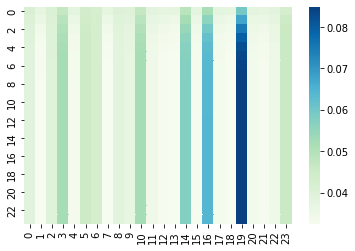

  2%|▏         | 0.6809338521400758/30 [00:16<35:09, 71.95s/it]

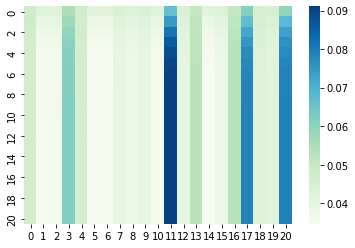

  2%|▏         | 0.6848249027237334/30 [00:16<38:26, 78.67s/it]

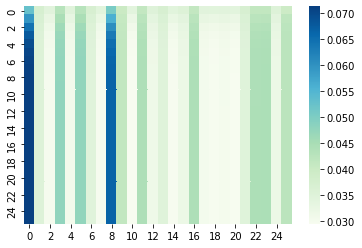

  2%|▏         | 0.688715953307391/30 [00:17<36:27, 74.64s/it] 

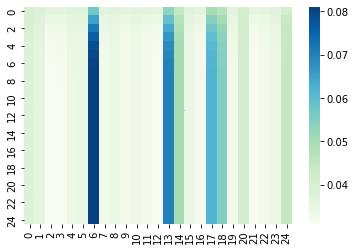

  2%|▏         | 0.6926070038910486/30 [00:17<36:51, 75.46s/it]

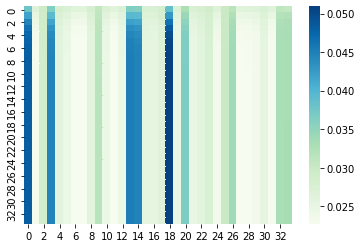

  2%|▏         | 0.6964980544747061/30 [00:17<36:05, 73.90s/it]

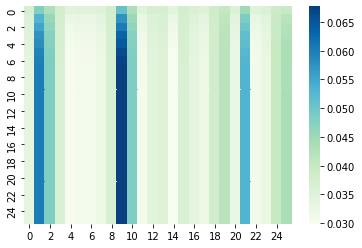

  2%|▏         | 0.7003891050583637/30 [00:17<34:51, 71.38s/it]

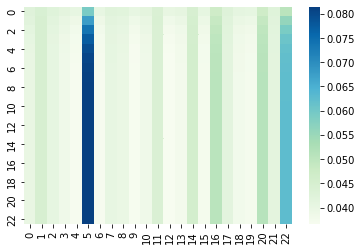

  2%|▏         | 0.7042801556420213/30 [00:18<35:28, 72.67s/it]

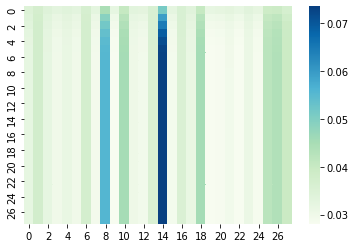

  2%|▏         | 0.7081712062256789/30 [00:18<34:40, 71.02s/it]

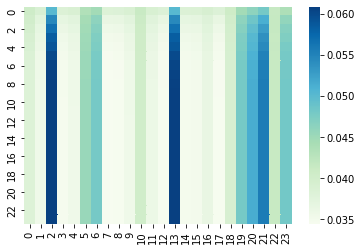

  2%|▏         | 0.7120622568093364/30 [00:18<34:44, 71.18s/it]

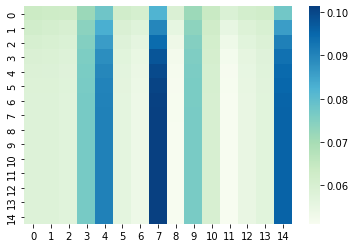

  2%|▏         | 0.715953307392994/30 [00:19<33:32, 68.71s/it] 

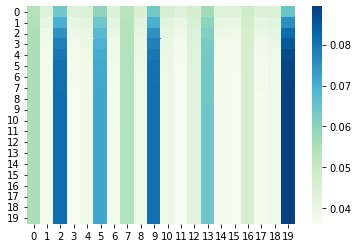

  2%|▏         | 0.7198443579766516/30 [00:19<35:08, 72.01s/it]

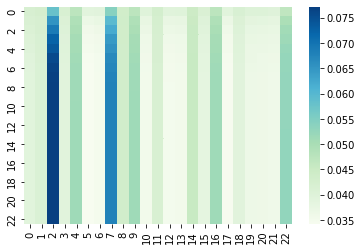

  2%|▏         | 0.7237354085603092/30 [00:19<35:28, 72.70s/it]

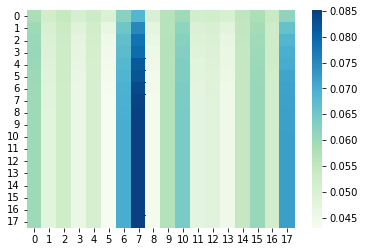

  2%|▏         | 0.7276264591439667/30 [00:20<40:40, 83.39s/it]

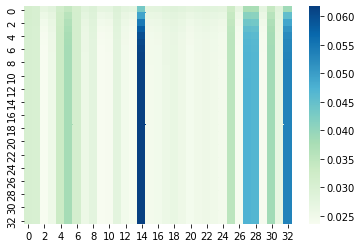

  2%|▏         | 0.7315175097276243/30 [00:20<39:24, 80.80s/it]

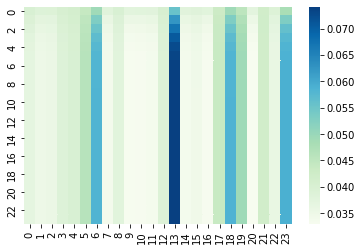

  2%|▏         | 0.7354085603112819/30 [00:20<44:04, 90.37s/it]

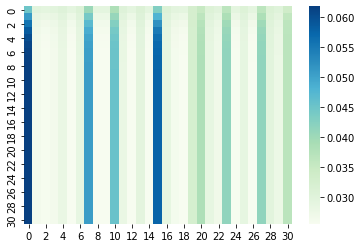

  2%|▏         | 0.7392996108949395/30 [00:21<40:59, 84.06s/it]

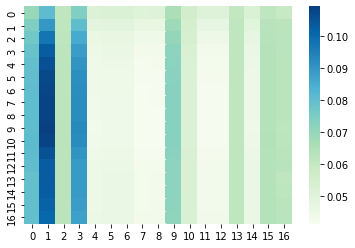

  2%|▏         | 0.743190661478597/30 [00:21<38:56, 79.86s/it] 

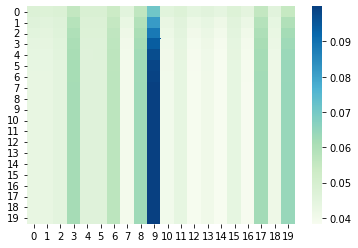

  2%|▏         | 0.7470817120622546/30 [00:21<38:31, 79.02s/it]

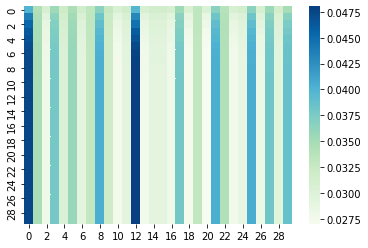

  3%|▎         | 0.7509727626459122/30 [00:21<37:30, 76.93s/it]

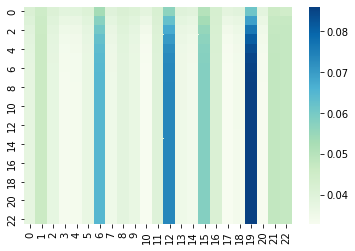

  3%|▎         | 0.7548638132295697/30 [00:22<36:47, 75.49s/it]

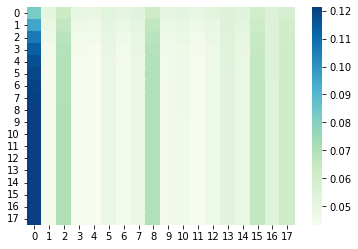

  3%|▎         | 0.7587548638132273/30 [00:22<36:46, 75.46s/it]

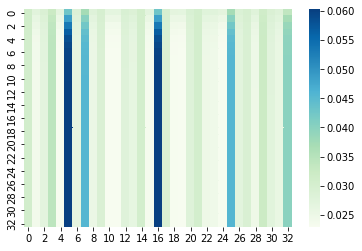

  3%|▎         | 0.7626459143968849/30 [00:22<36:07, 74.12s/it]

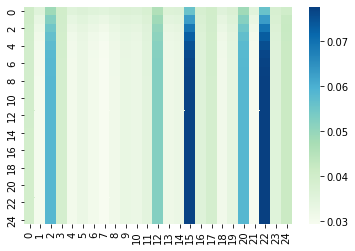

  3%|▎         | 0.7665369649805425/30 [00:23<36:23, 74.69s/it]

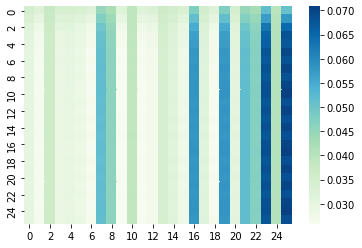

  3%|▎         | 0.7704280155642/30 [00:23<39:24, 80.89s/it]   

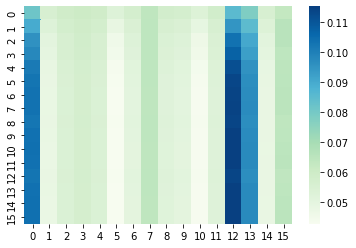

  3%|▎         | 0.7743190661478576/30 [00:23<37:34, 77.15s/it]

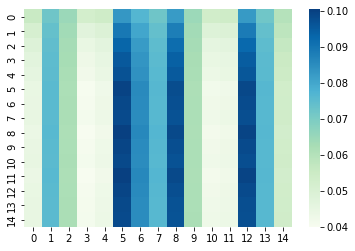

  3%|▎         | 0.7782101167315152/30 [00:23<36:02, 73.99s/it]

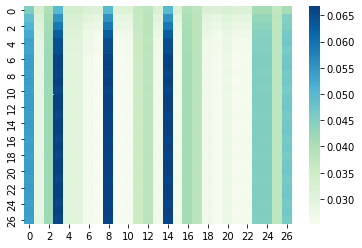

  3%|▎         | 0.7821011673151728/30 [00:24<35:03, 72.00s/it]

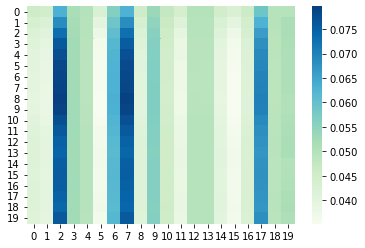

  3%|▎         | 0.7859922178988303/30 [00:24<36:53, 75.76s/it]

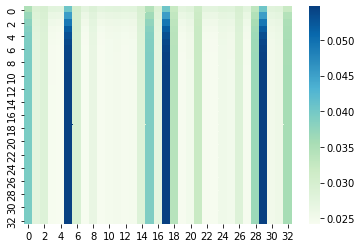

  3%|▎         | 0.7898832684824879/30 [00:24<38:40, 79.45s/it]

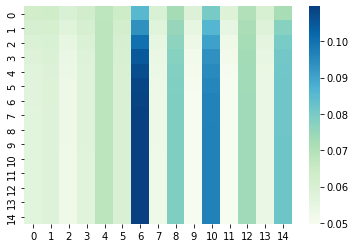

  3%|▎         | 0.7937743190661455/30 [00:25<41:18, 84.87s/it]

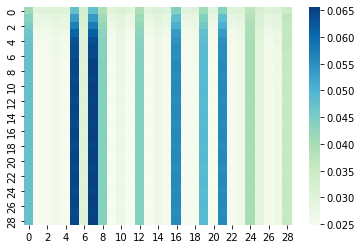

  3%|▎         | 0.7976653696498031/30 [00:25<43:43, 89.85s/it]

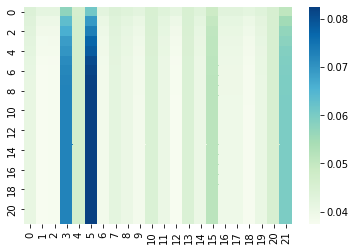

  3%|▎         | 0.8015564202334606/30 [00:26<44:45, 91.96s/it]

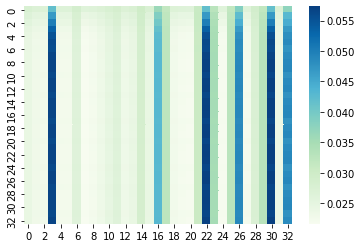

  3%|▎         | 0.8054474708171182/30 [00:26<44:52, 92.22s/it]

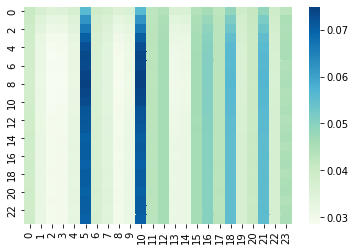

  3%|▎         | 0.8093385214007758/30 [00:26<47:42, 98.07s/it]

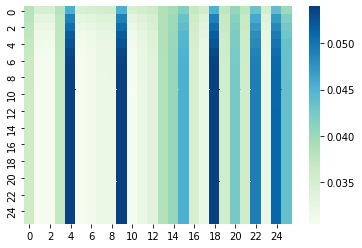

  3%|▎         | 0.8132295719844334/30 [00:27<52:21, 107.64s/it]

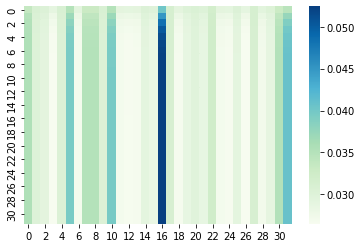

  3%|▎         | 0.8171206225680909/30 [00:27<51:22, 105.62s/it]

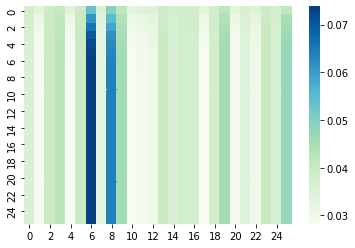

  3%|▎         | 0.8210116731517485/30 [00:28<50:22, 103.59s/it]

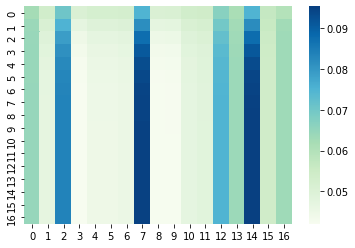

  3%|▎         | 0.8249027237354061/30 [00:28<47:57, 98.64s/it] 

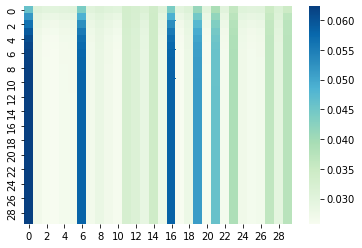

  3%|▎         | 0.8287937743190636/30 [00:28<43:34, 89.63s/it]

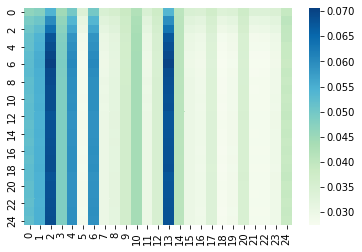

  3%|▎         | 0.8326848249027212/30 [00:29<43:14, 88.94s/it]

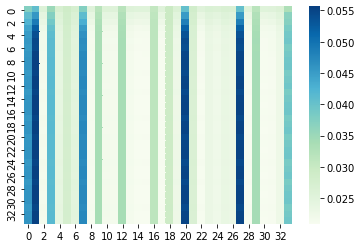

  3%|▎         | 0.8365758754863788/30 [00:29<40:25, 83.18s/it]

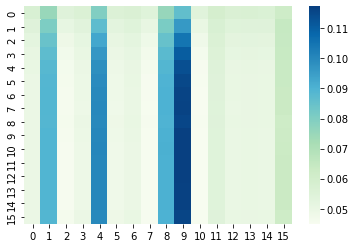

  3%|▎         | 0.8404669260700364/30 [00:29<38:28, 79.16s/it]

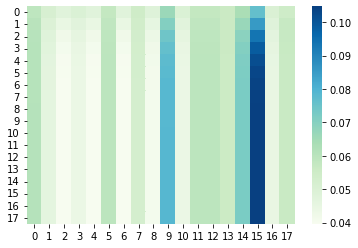

  3%|▎         | 0.8443579766536939/30 [00:29<38:15, 78.73s/it]

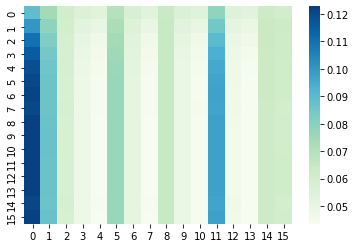

  3%|▎         | 0.8482490272373515/30 [00:30<37:19, 76.82s/it]

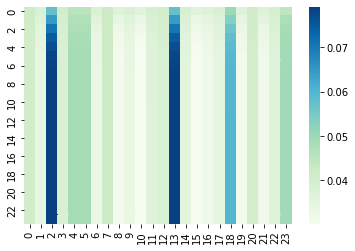

  3%|▎         | 0.8521400778210091/30 [00:30<37:13, 76.63s/it]

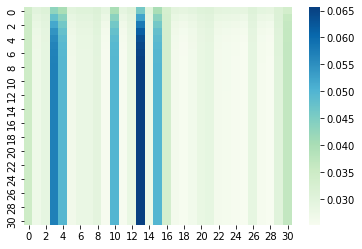

  3%|▎         | 0.8560311284046667/30 [00:30<40:48, 84.00s/it]

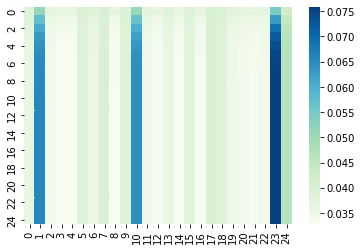

  3%|▎         | 0.8599221789883242/30 [00:31<40:08, 82.64s/it]

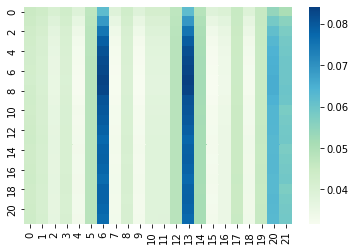

  3%|▎         | 0.8638132295719818/30 [00:31<38:43, 79.73s/it]

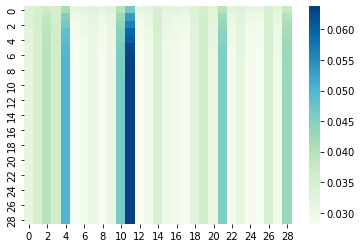

  3%|▎         | 0.8677042801556394/30 [00:31<36:54, 76.02s/it]

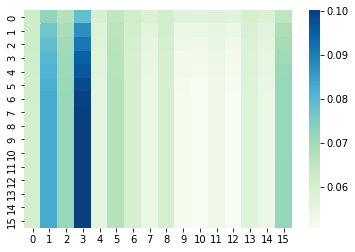

  3%|▎         | 0.871595330739297/30 [00:31<36:15, 74.70s/it] 

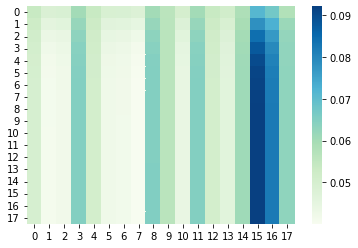

  3%|▎         | 0.8754863813229545/30 [00:32<36:09, 74.48s/it]

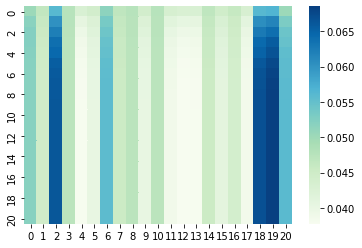

  3%|▎         | 0.8793774319066121/30 [00:32<34:42, 71.50s/it]

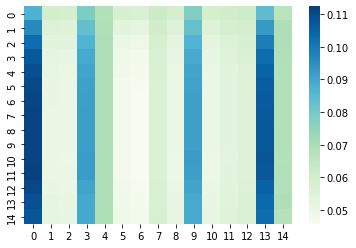

  3%|▎         | 0.8832684824902697/30 [00:32<34:09, 70.38s/it]

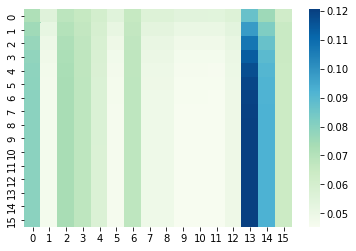

  3%|▎         | 0.8871595330739273/30 [00:33<35:35, 73.34s/it]

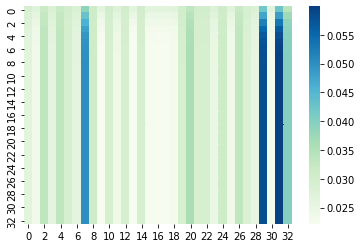

  3%|▎         | 0.8910505836575848/30 [00:33<35:54, 74.02s/it]

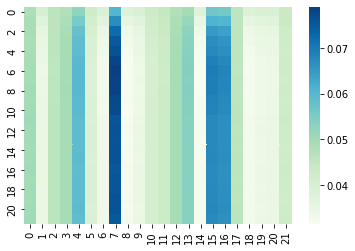

  3%|▎         | 0.8949416342412424/30 [00:33<35:24, 73.00s/it]

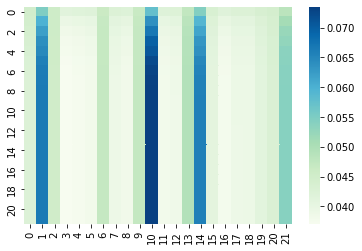

  3%|▎         | 0.8988326848249/30 [00:34<41:20, 85.23s/it]   

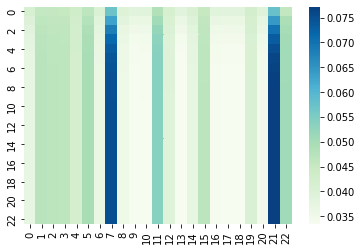

  3%|▎         | 0.9027237354085575/30 [00:34<40:03, 82.60s/it]

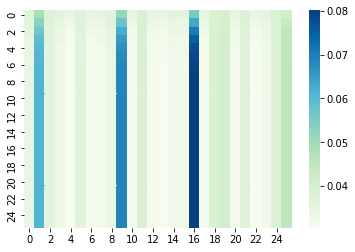

  3%|▎         | 0.9066147859922151/30 [00:34<37:48, 77.99s/it]

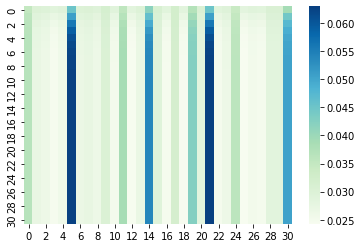

  3%|▎         | 0.9105058365758727/30 [00:34<37:07, 76.57s/it]

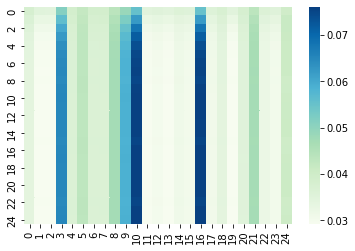

  3%|▎         | 0.9143968871595303/30 [00:35<36:33, 75.42s/it]

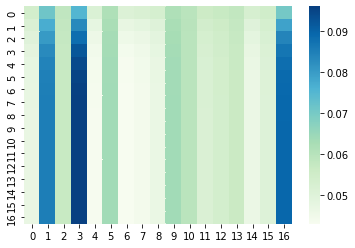

  3%|▎         | 0.9182879377431878/30 [00:35<35:50, 73.96s/it]

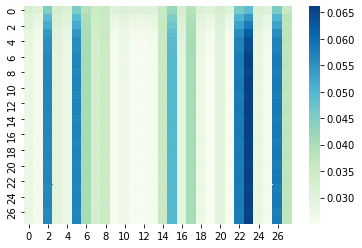

  3%|▎         | 0.9221789883268454/30 [00:35<34:58, 72.17s/it]

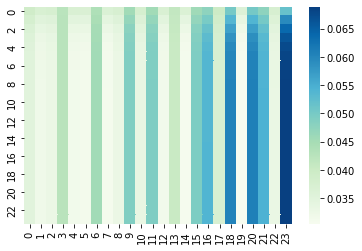

  3%|▎         | 0.926070038910503/30 [00:36<35:32, 73.36s/it] 

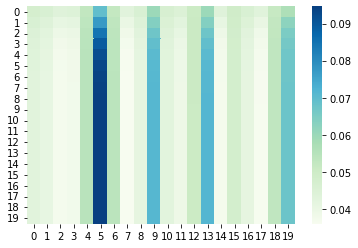

  3%|▎         | 0.9299610894941606/30 [00:36<36:10, 74.65s/it]

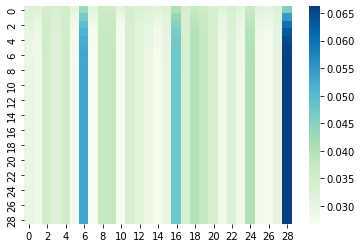

  3%|▎         | 0.9338521400778181/30 [00:36<35:12, 72.69s/it]

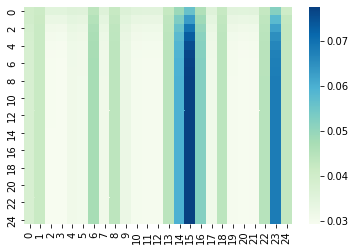

  3%|▎         | 0.9377431906614757/30 [00:36<35:39, 73.62s/it]

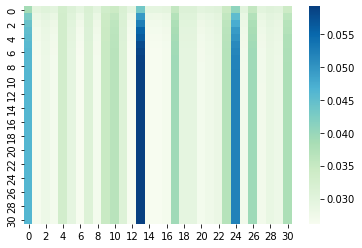

  3%|▎         | 0.9416342412451333/30 [00:37<39:43, 82.02s/it]

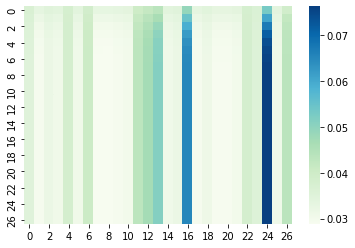

  3%|▎         | 0.9455252918287909/30 [00:37<37:09, 76.75s/it]

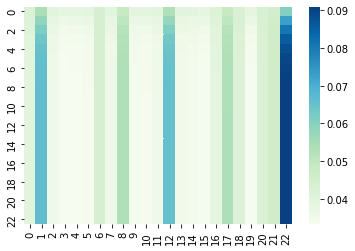

  3%|▎         | 0.9494163424124484/30 [00:37<36:35, 75.57s/it]

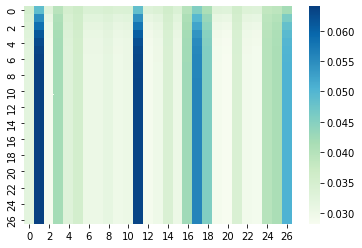

  3%|▎         | 0.953307392996106/30 [00:38<35:41, 73.74s/it] 

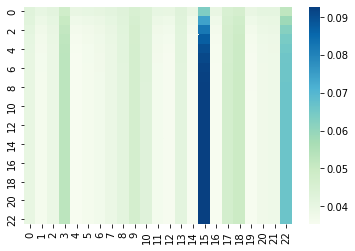

  3%|▎         | 0.9571984435797636/30 [00:38<35:50, 74.04s/it]

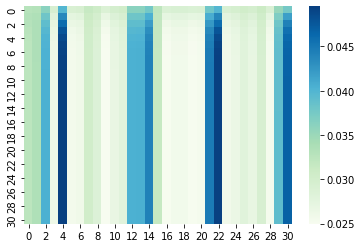

  3%|▎         | 0.9610894941634212/30 [00:38<35:28, 73.30s/it]

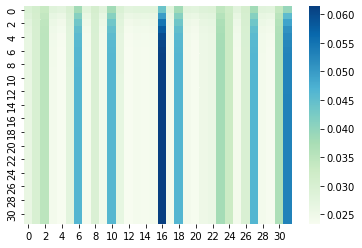

  3%|▎         | 0.9649805447470787/30 [00:38<35:30, 73.38s/it]

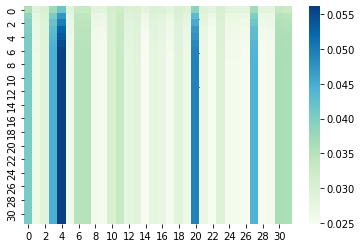

  3%|▎         | 0.9688715953307363/30 [00:39<35:29, 73.34s/it]

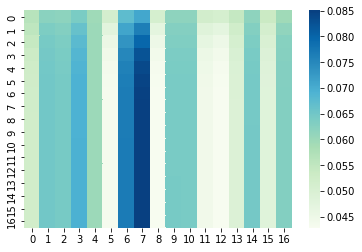

  3%|▎         | 0.9727626459143939/30 [00:39<35:18, 72.97s/it]

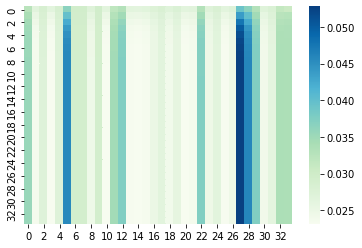

  3%|▎         | 0.9766536964980514/30 [00:39<35:24, 73.20s/it]

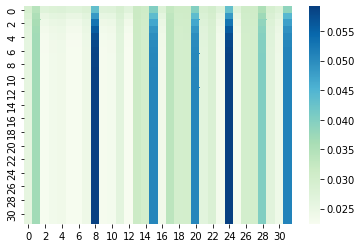

  3%|▎         | 0.980544747081709/30 [00:40<35:05, 72.57s/it] 

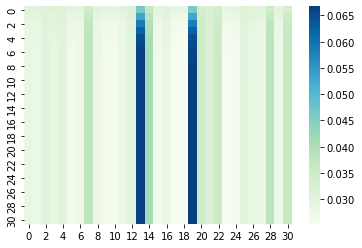

  3%|▎         | 0.9844357976653666/30 [00:40<39:15, 81.19s/it]

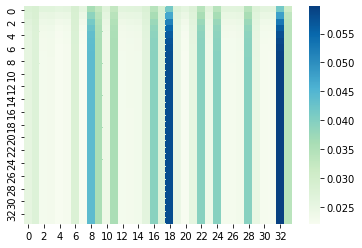

  3%|▎         | 0.9883268482490242/30 [00:40<37:38, 77.86s/it]

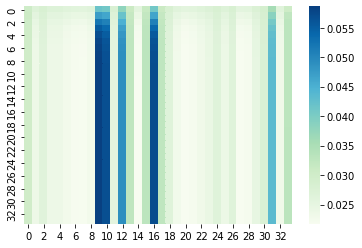

  3%|▎         | 0.9922178988326817/30 [00:41<37:06, 76.75s/it]

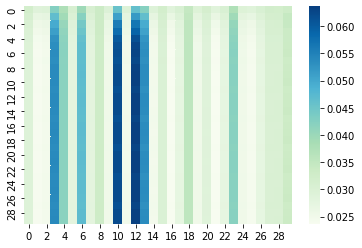

  3%|▎         | 0.9961089494163393/30 [00:41<36:00, 74.51s/it]

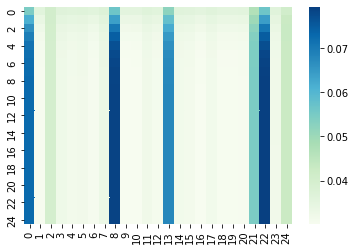

  3%|▎         | 0.9999999999999969/30 [00:41<36:18, 75.10s/it]

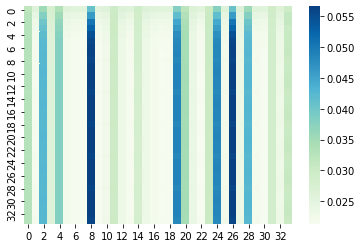

  5%|▌         | 1.610894941634236/30 [00:52<07:40, 16.20s/it] 

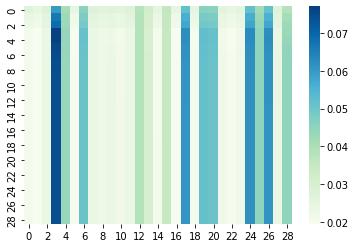

  5%|▌         | 1.6186770428015511/30 [00:52<13:17, 28.09s/it]

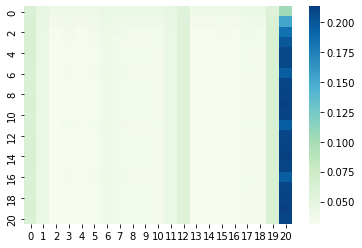

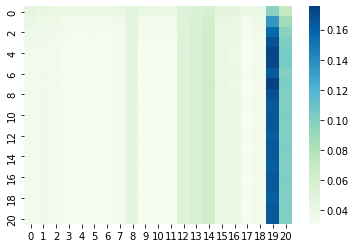

  5%|▌         | 1.6264591439688663/30 [00:53<19:38, 41.53s/it]

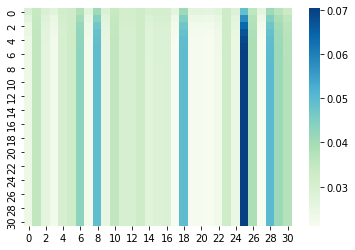

  5%|▌         | 1.6303501945525238/30 [00:53<21:57, 46.43s/it]

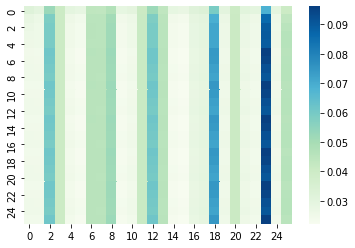

  5%|▌         | 1.6342412451361814/30 [00:54<24:05, 50.96s/it]

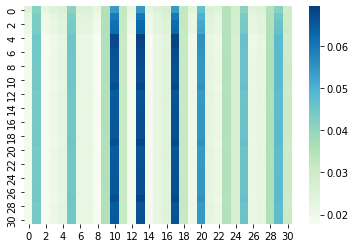

  5%|▌         | 1.638132295719839/30 [00:54<30:23, 64.29s/it] 

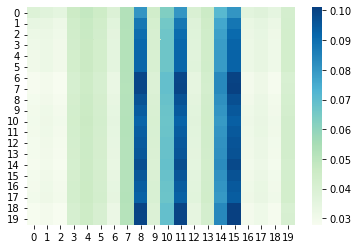

  5%|▌         | 1.6420233463034966/30 [00:54<32:00, 67.73s/it]

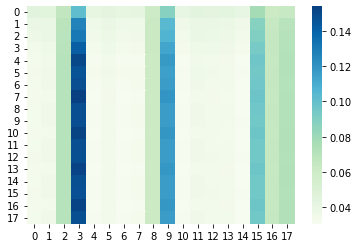

  5%|▌         | 1.6459143968871541/30 [00:55<33:42, 71.33s/it]

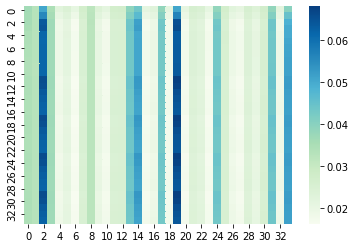

  5%|▌         | 1.6498054474708117/30 [00:55<33:33, 71.03s/it]

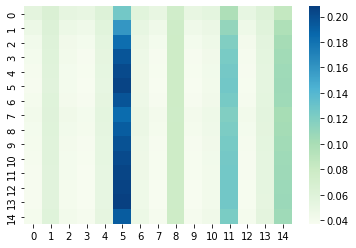

  6%|▌         | 1.6536964980544693/30 [00:55<33:19, 70.52s/it]

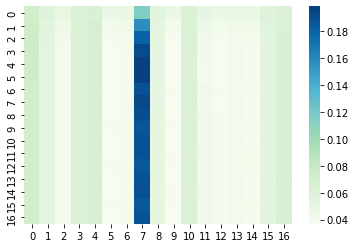

  6%|▌         | 1.6575875486381269/30 [00:55<33:54, 71.80s/it]

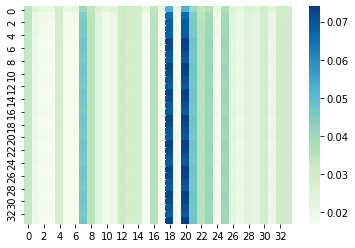

  6%|▌         | 1.6614785992217844/30 [00:56<33:54, 71.81s/it]

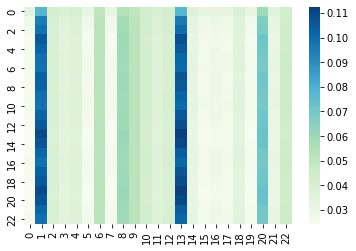

  6%|▌         | 1.665369649805442/30 [00:56<35:08, 74.41s/it] 

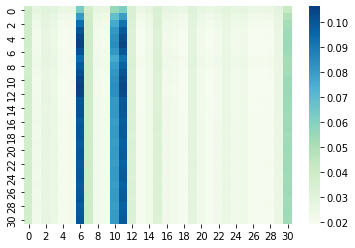

  6%|▌         | 1.6692607003890996/30 [00:56<34:44, 73.58s/it]

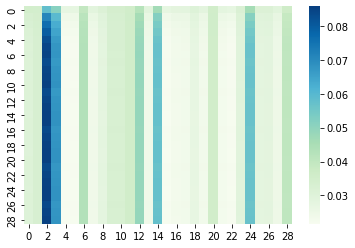

  6%|▌         | 1.6731517509727571/30 [00:57<33:54, 71.83s/it]

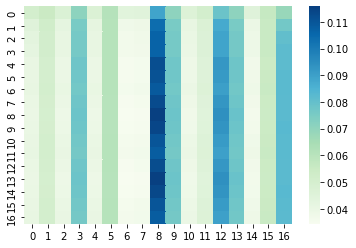

  6%|▌         | 1.6770428015564147/30 [00:57<34:01, 72.07s/it]

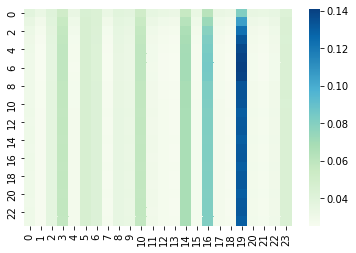

  6%|▌         | 1.6809338521400723/30 [00:57<38:30, 81.60s/it]

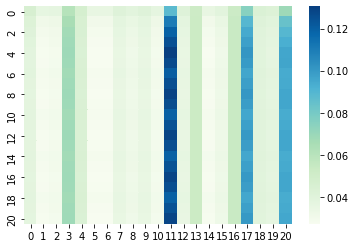

  6%|▌         | 1.6848249027237299/30 [00:57<36:59, 78.39s/it]

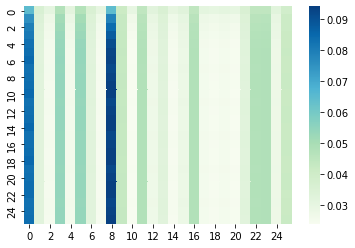

  6%|▌         | 1.6887159533073874/30 [00:58<35:15, 74.73s/it]

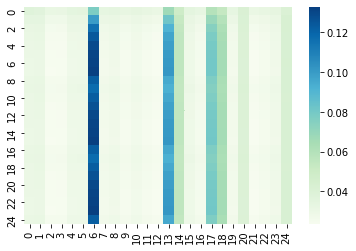

  6%|▌         | 1.692607003891045/30 [00:58<36:21, 77.06s/it] 

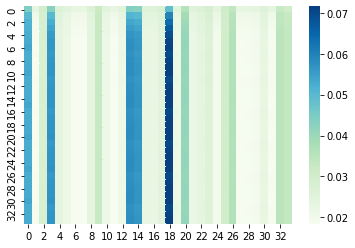

  6%|▌         | 1.6964980544747026/30 [00:58<35:27, 75.18s/it]

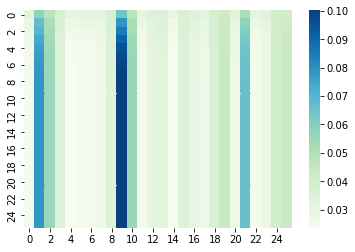

  6%|▌         | 1.7003891050583602/30 [00:59<35:12, 74.64s/it]

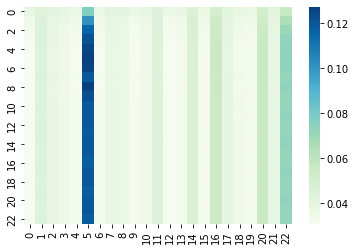

  6%|▌         | 1.7042801556420177/30 [00:59<35:13, 74.71s/it]

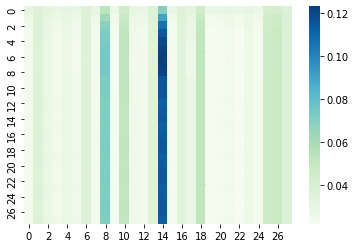

  6%|▌         | 1.7081712062256753/30 [00:59<34:23, 72.92s/it]

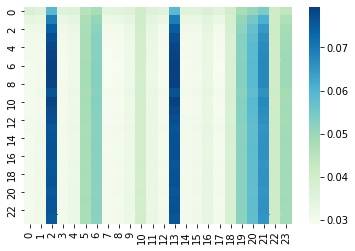

  6%|▌         | 1.7120622568093329/30 [00:59<34:39, 73.50s/it]

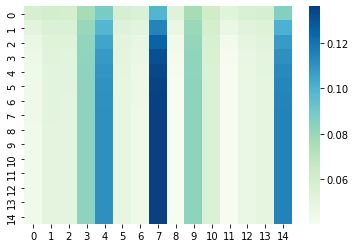

  6%|▌         | 1.7159533073929905/30 [01:00<33:55, 71.97s/it]

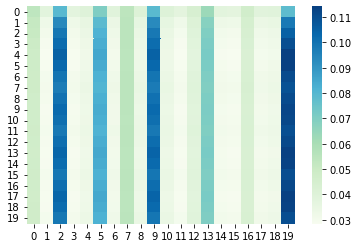

  6%|▌         | 1.719844357976648/30 [01:00<35:23, 75.08s/it] 

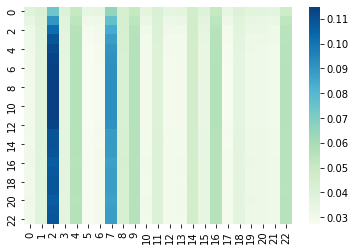

  6%|▌         | 1.7237354085603056/30 [01:00<39:27, 83.72s/it]

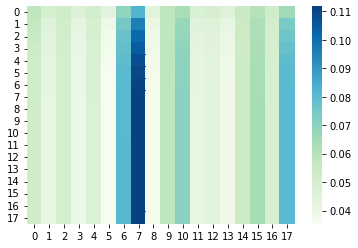

  6%|▌         | 1.7276264591439632/30 [01:01<38:54, 82.56s/it]

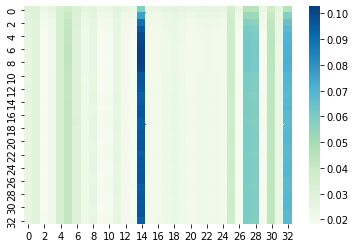

  6%|▌         | 1.7315175097276208/30 [01:01<38:05, 80.86s/it]

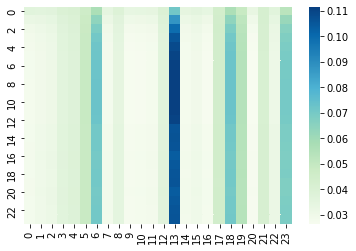

  6%|▌         | 1.7354085603112783/30 [01:01<37:50, 80.31s/it]

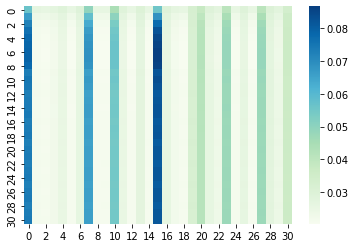

  6%|▌         | 1.739299610894936/30 [01:02<36:23, 77.27s/it] 

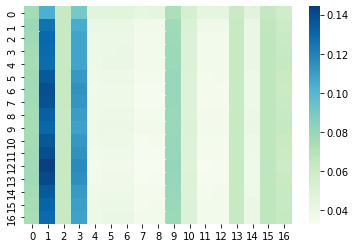

  6%|▌         | 1.7431906614785935/30 [01:02<35:31, 75.43s/it]

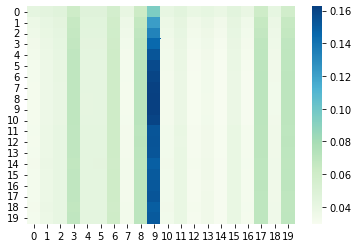

  6%|▌         | 1.747081712062251/30 [01:02<36:09, 76.80s/it] 

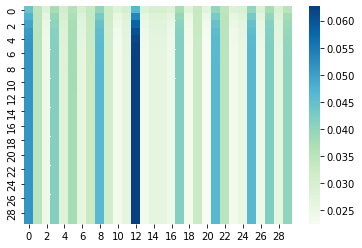

  6%|▌         | 1.7509727626459086/30 [01:03<35:20, 75.05s/it]

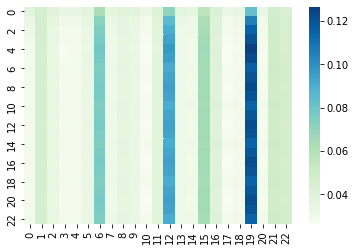

  6%|▌         | 1.7548638132295662/30 [01:03<35:19, 75.04s/it]

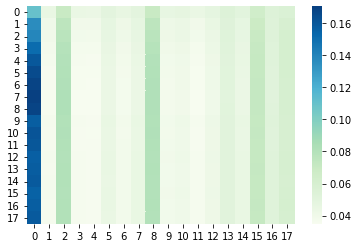

  6%|▌         | 1.7587548638132238/30 [01:03<36:24, 77.35s/it]

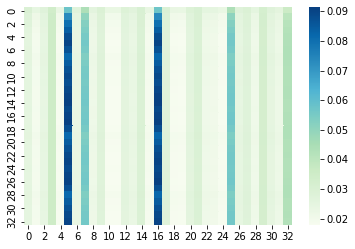

  6%|▌         | 1.7626459143968813/30 [01:03<36:01, 76.54s/it]

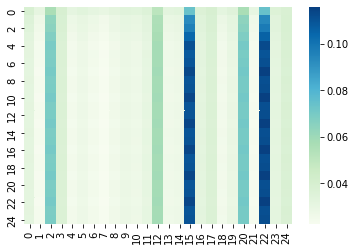

  6%|▌         | 1.766536964980539/30 [01:04<40:18, 85.66s/it] 

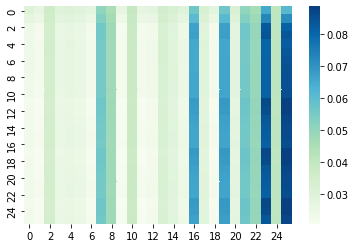

  6%|▌         | 1.7704280155641965/30 [01:04<37:36, 79.92s/it]

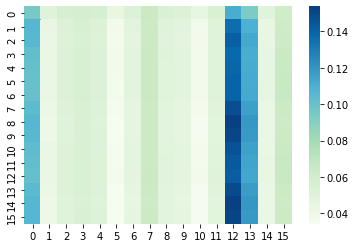

  6%|▌         | 1.774319066147854/30 [01:04<35:50, 76.20s/it] 

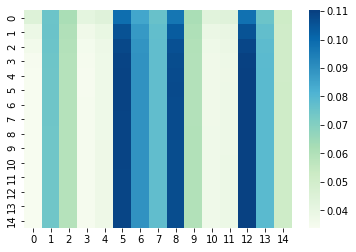

  6%|▌         | 1.7782101167315116/30 [01:05<35:09, 74.74s/it]

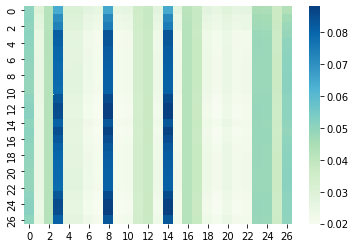

  6%|▌         | 1.7821011673151692/30 [01:05<34:42, 73.80s/it]

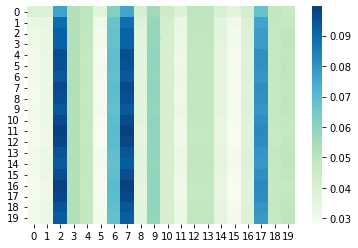

  6%|▌         | 1.7859922178988268/30 [01:05<36:04, 76.72s/it]

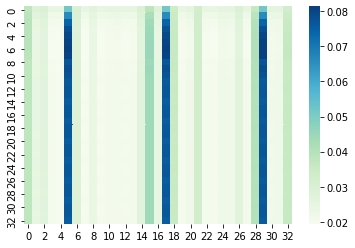

  6%|▌         | 1.7898832684824844/30 [01:06<35:55, 76.42s/it]

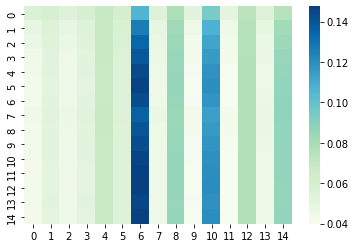

  6%|▌         | 1.793774319066142/30 [01:06<35:13, 74.92s/it] 

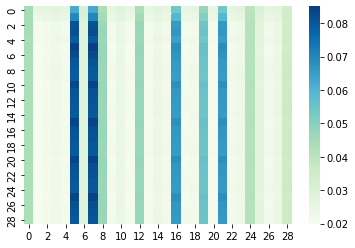

  6%|▌         | 1.7976653696497995/30 [01:06<34:18, 73.00s/it]

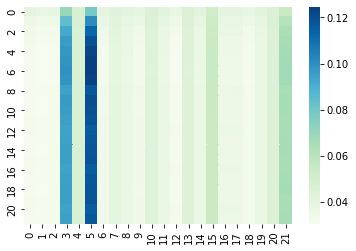

  6%|▌         | 1.801556420233457/30 [01:06<35:06, 74.69s/it] 

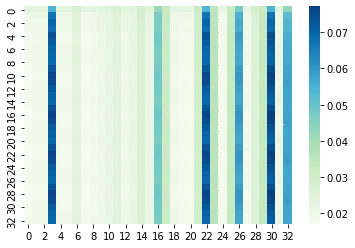

  6%|▌         | 1.8054474708171147/30 [01:07<34:54, 74.30s/it]

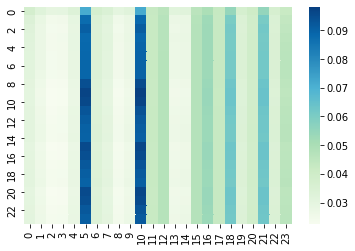

  6%|▌         | 1.8093385214007722/30 [01:07<39:33, 84.18s/it]

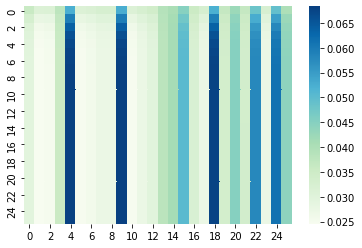

  6%|▌         | 1.8132295719844298/30 [01:07<37:48, 80.48s/it]

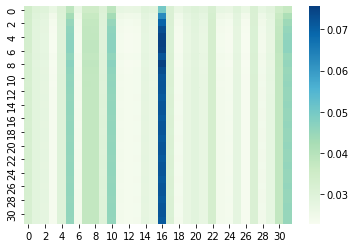

  6%|▌         | 1.8171206225680874/30 [01:08<37:17, 79.39s/it]

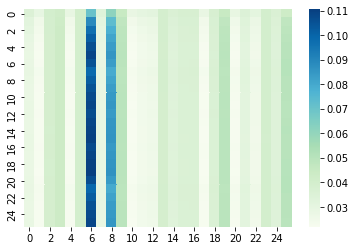

  6%|▌         | 1.821011673151745/30 [01:08<35:49, 76.29s/it] 

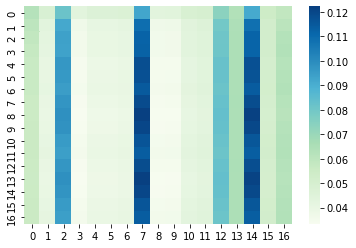

  6%|▌         | 1.8249027237354025/30 [01:08<36:03, 76.78s/it]

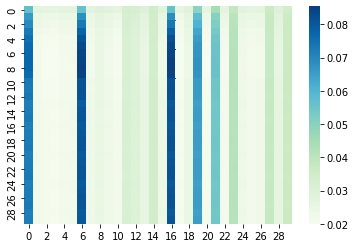

  6%|▌         | 1.82879377431906/30 [01:09<35:17, 75.16s/it]  

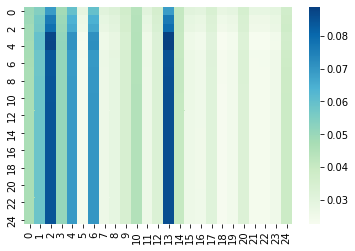

  6%|▌         | 1.8326848249027177/30 [01:09<35:44, 76.15s/it]

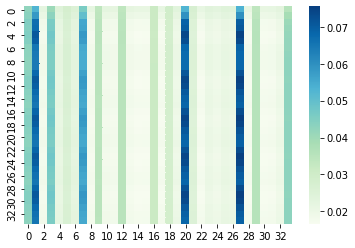

  6%|▌         | 1.8365758754863752/30 [01:09<35:12, 74.99s/it]

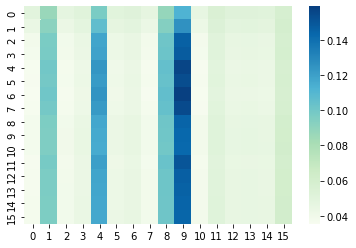

  6%|▌         | 1.8404669260700328/30 [01:09<35:19, 75.28s/it]

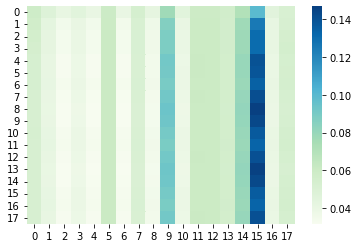

  6%|▌         | 1.8443579766536904/30 [01:10<35:28, 75.59s/it]

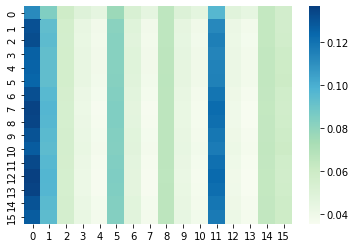

  6%|▌         | 1.848249027237348/30 [01:10<34:55, 74.43s/it] 

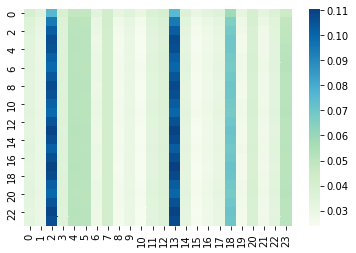

  6%|▌         | 1.8521400778210055/30 [01:10<39:38, 84.50s/it]

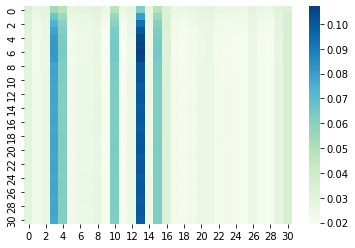

  6%|▌         | 1.856031128404663/30 [01:11<38:14, 81.52s/it] 

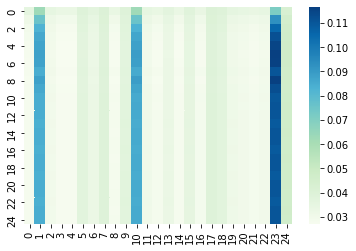

  6%|▌         | 1.8599221789883207/30 [01:11<38:39, 82.44s/it]

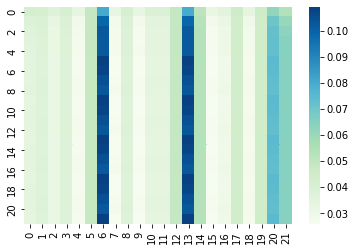

  6%|▌         | 1.8638132295719783/30 [01:11<38:07, 81.29s/it]

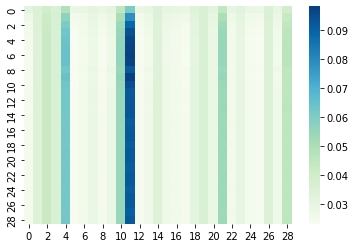

  6%|▌         | 1.8677042801556358/30 [01:12<36:19, 77.48s/it]

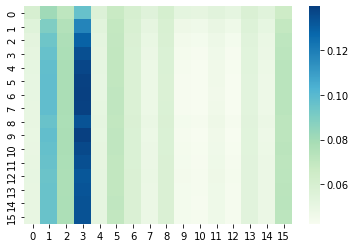

  6%|▌         | 1.8715953307392934/30 [01:12<35:09, 75.01s/it]

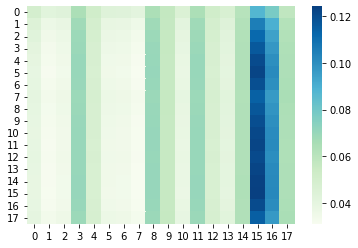

  6%|▋         | 1.875486381322951/30 [01:12<35:09, 75.02s/it] 

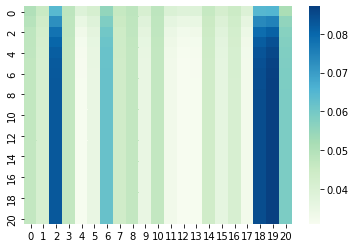

  6%|▋         | 1.8793774319066086/30 [01:12<34:19, 73.25s/it]

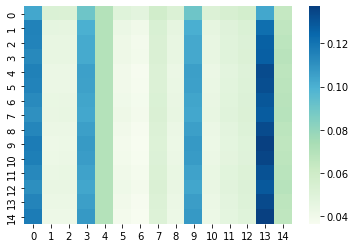

  6%|▋         | 1.8832684824902661/30 [01:13<34:03, 72.69s/it]

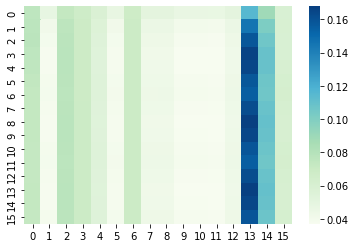

  6%|▋         | 1.8871595330739237/30 [01:13<34:26, 73.52s/it]

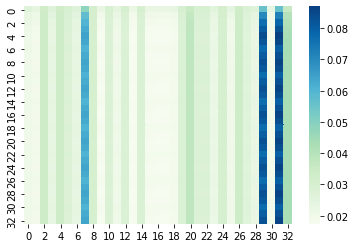

  6%|▋         | 1.8910505836575813/30 [01:13<34:44, 74.17s/it]

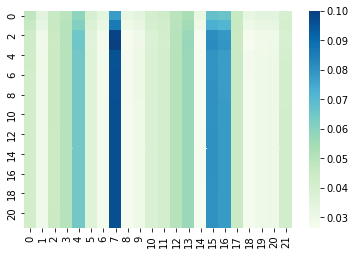

  6%|▋         | 1.8949416342412388/30 [01:14<38:55, 83.09s/it]

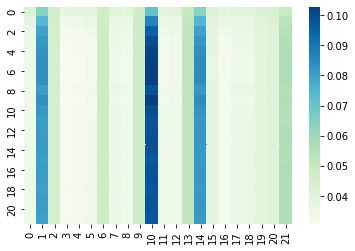

  6%|▋         | 1.8988326848248964/30 [01:14<37:44, 80.57s/it]

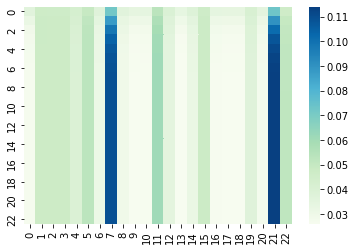

  6%|▋         | 1.902723735408554/30 [01:14<37:25, 79.92s/it] 

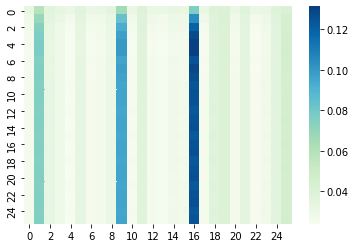

  6%|▋         | 1.9066147859922116/30 [01:15<35:49, 76.51s/it]

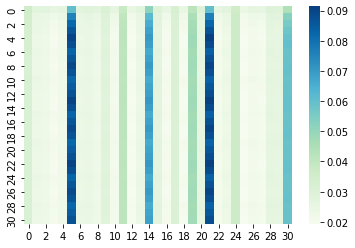

  6%|▋         | 1.9105058365758691/30 [01:15<35:20, 75.50s/it]

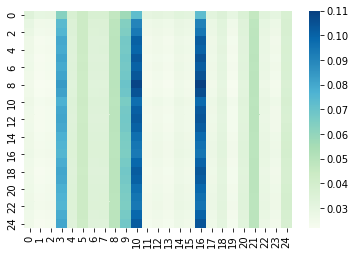

  6%|▋         | 1.9143968871595267/30 [01:15<35:56, 76.80s/it]

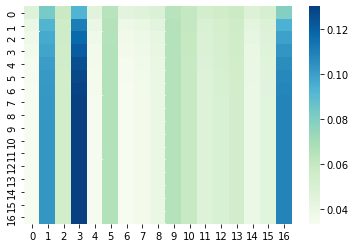

  6%|▋         | 1.9182879377431843/30 [01:15<35:55, 76.76s/it]

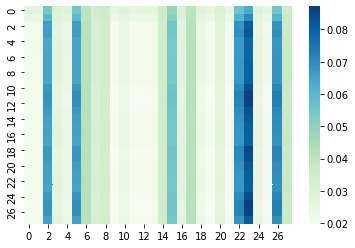

  6%|▋         | 1.9221789883268419/30 [01:16<34:46, 74.33s/it]

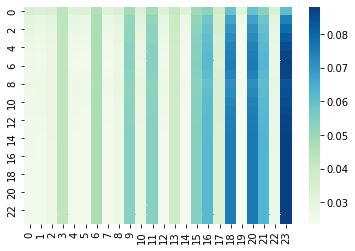

  6%|▋         | 1.9260700389104994/30 [01:16<34:42, 74.19s/it]

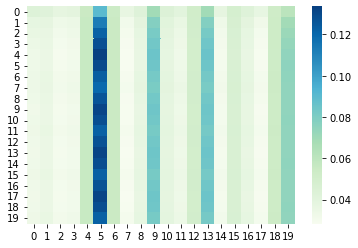

  6%|▋         | 1.929961089494157/30 [01:16<35:40, 76.25s/it] 

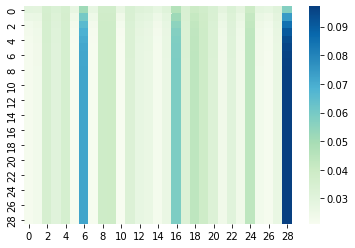

  6%|▋         | 1.9338521400778146/30 [01:17<35:17, 75.44s/it]

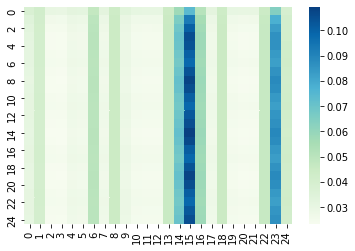

  6%|▋         | 1.9377431906614722/30 [01:17<40:20, 86.24s/it]

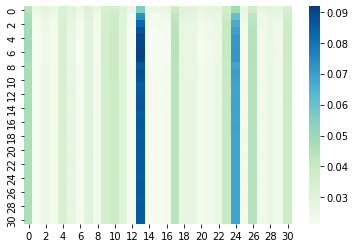

  6%|▋         | 1.9416342412451297/30 [01:17<38:16, 81.83s/it]

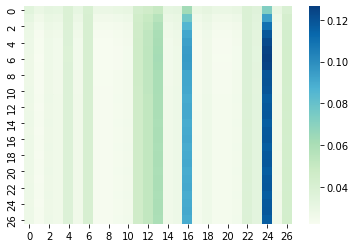

  6%|▋         | 1.9455252918287873/30 [01:18<36:42, 78.51s/it]

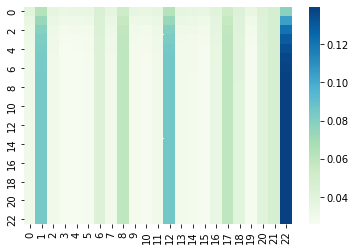

  6%|▋         | 1.9494163424124449/30 [01:18<36:14, 77.53s/it]

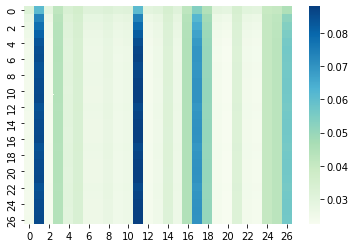

  7%|▋         | 1.9533073929961025/30 [01:18<34:45, 74.35s/it]

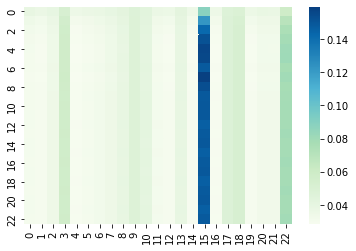

  7%|▋         | 1.95719844357976/30 [01:18<35:10, 75.25s/it]  

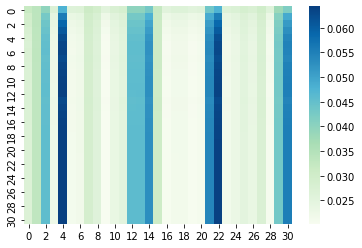

  7%|▋         | 1.9610894941634176/30 [01:19<35:11, 75.30s/it]

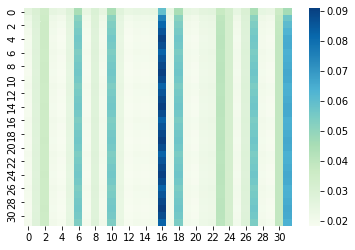

  7%|▋         | 1.9649805447470752/30 [01:19<34:52, 74.65s/it]

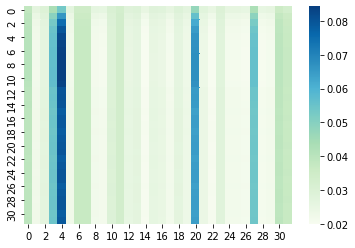

  7%|▋         | 1.9688715953307327/30 [01:19<34:39, 74.17s/it]

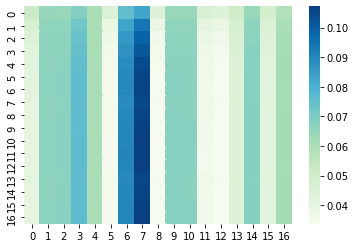

  7%|▋         | 1.9727626459143903/30 [01:20<35:39, 76.34s/it]

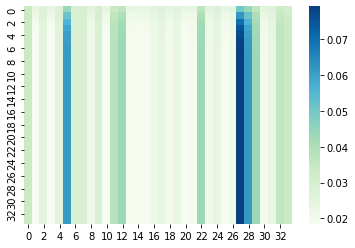

  7%|▋         | 1.976653696498048/30 [01:20<35:16, 75.52s/it] 

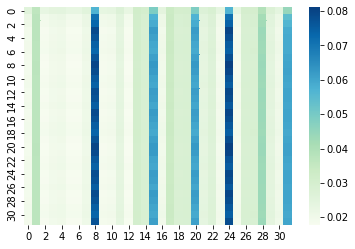

  7%|▋         | 1.9805447470817055/30 [01:20<39:02, 83.61s/it]

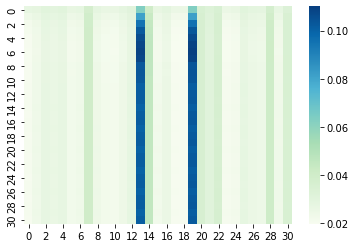

  7%|▋         | 1.984435797665363/30 [01:21<38:22, 82.17s/it] 

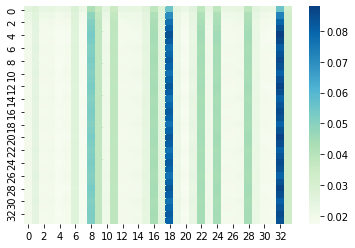

  7%|▋         | 1.9883268482490206/30 [01:21<37:33, 80.47s/it]

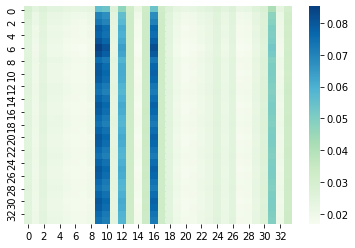

  7%|▋         | 1.9922178988326782/30 [01:21<36:57, 79.17s/it]

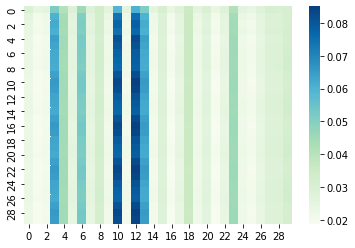

  7%|▋         | 1.9961089494163358/30 [01:22<36:06, 77.36s/it]

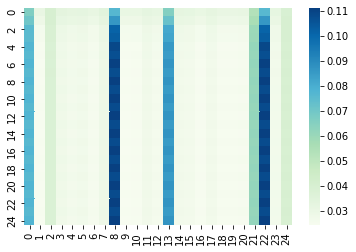

  7%|▋         | 1.9999999999999933/30 [01:22<37:16, 79.87s/it]

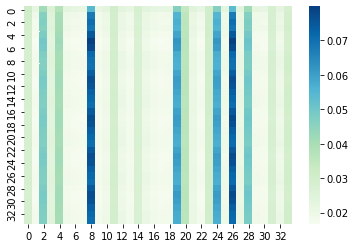

  9%|▊         | 2.6108949416342324/30 [01:34<07:49, 17.13s/it]

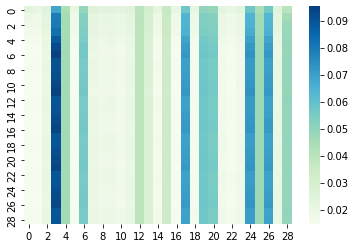

  9%|▊         | 2.6186770428015476/30 [01:35<13:26, 29.44s/it]

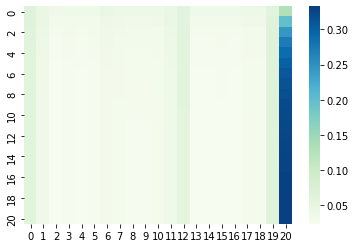

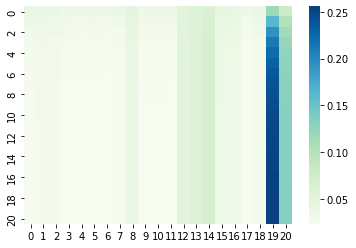

  9%|▉         | 2.6264591439688627/30 [01:35<19:30, 42.75s/it]

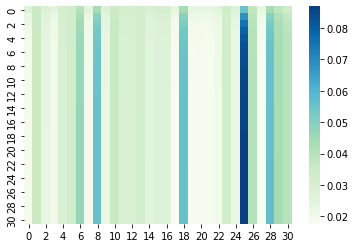

  9%|▉         | 2.6303501945525203/30 [01:36<22:08, 48.55s/it]

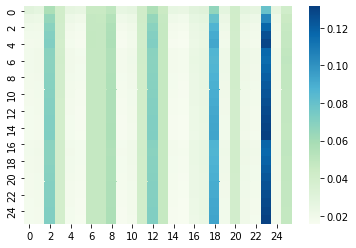

  9%|▉         | 2.634241245136178/30 [01:36<27:41, 60.73s/it] 

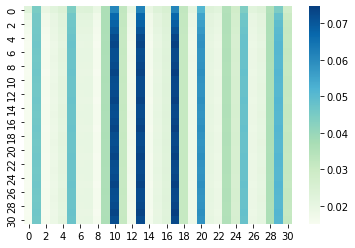

  9%|▉         | 2.6381322957198354/30 [01:36<28:54, 63.38s/it]

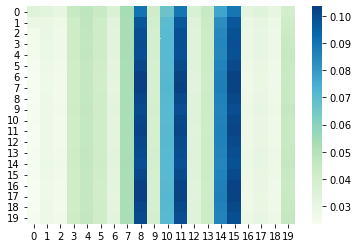

  9%|▉         | 2.642023346303493/30 [01:37<32:15, 70.75s/it] 

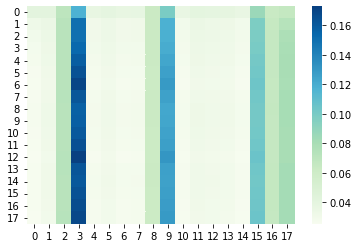

  9%|▉         | 2.6459143968871506/30 [01:37<33:41, 73.88s/it]

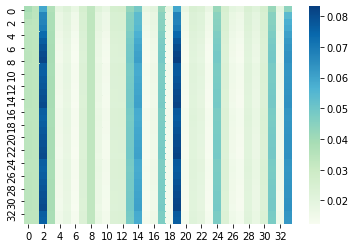

  9%|▉         | 2.649805447470808/30 [01:37<34:31, 75.76s/it] 

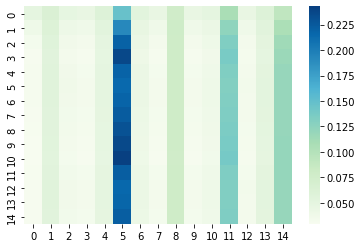

  9%|▉         | 2.6536964980544657/30 [01:38<34:01, 74.65s/it]

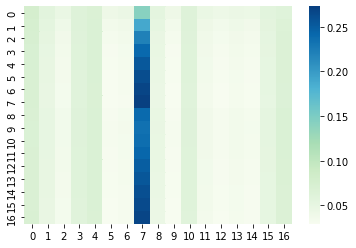

  9%|▉         | 2.6575875486381233/30 [01:38<34:37, 75.98s/it]

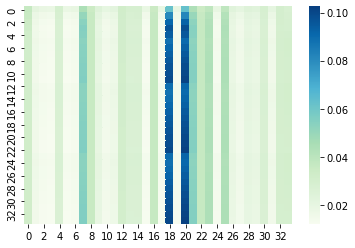

  9%|▉         | 2.661478599221781/30 [01:38<34:14, 75.16s/it] 

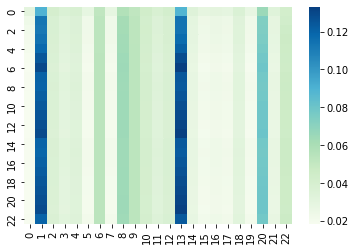

  9%|▉         | 2.6653696498054384/30 [01:39<35:01, 76.89s/it]

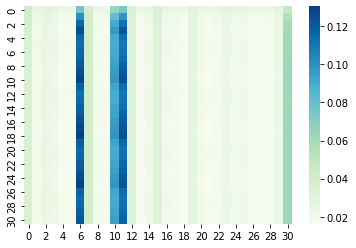

  9%|▉         | 2.669260700389096/30 [01:39<34:31, 75.78s/it] 

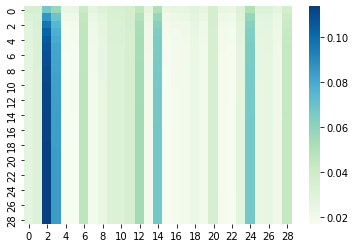

  9%|▉         | 2.6731517509727536/30 [01:39<33:37, 73.84s/it]

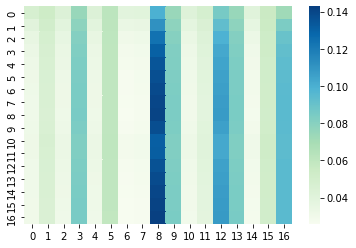

  9%|▉         | 2.677042801556411/30 [01:40<38:05, 83.65s/it] 

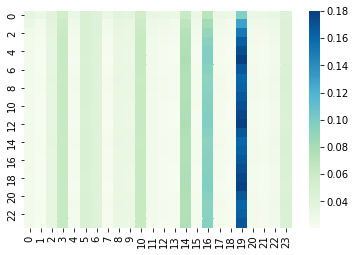

  9%|▉         | 2.6809338521400687/30 [01:40<37:37, 82.65s/it]

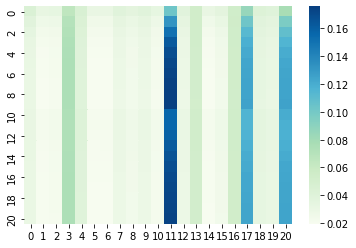

  9%|▉         | 2.6848249027237263/30 [01:40<36:55, 81.13s/it]

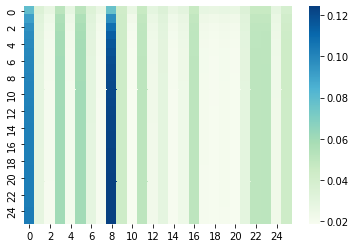

  9%|▉         | 2.688715953307384/30 [01:40<34:58, 76.84s/it] 

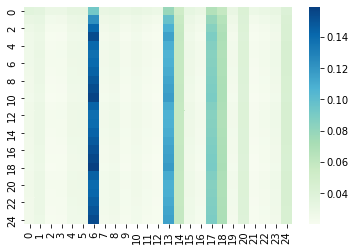

  9%|▉         | 2.6926070038910415/30 [01:41<35:54, 78.91s/it]

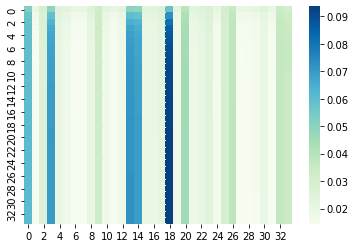

  9%|▉         | 2.696498054474699/30 [01:41<35:57, 79.02s/it] 

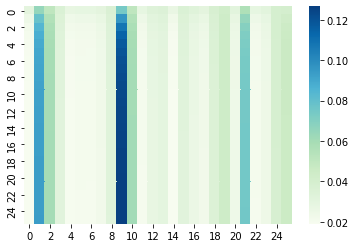

  9%|▉         | 2.7003891050583566/30 [01:41<35:22, 77.74s/it]

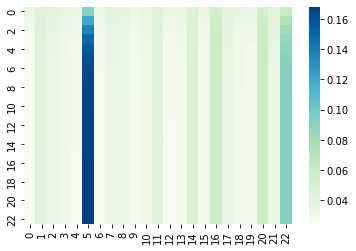

  9%|▉         | 2.704280155642014/30 [01:42<35:59, 79.13s/it] 

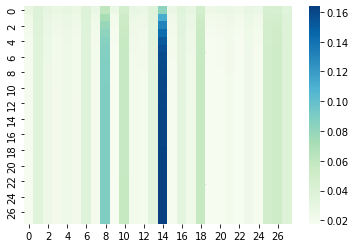

  9%|▉         | 2.7081712062256718/30 [01:42<34:47, 76.48s/it]

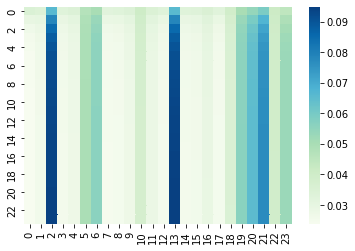

  9%|▉         | 2.7120622568093293/30 [01:42<34:58, 76.91s/it]

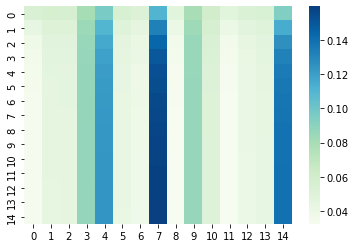

  9%|▉         | 2.715953307392987/30 [01:42<33:42, 74.13s/it] 

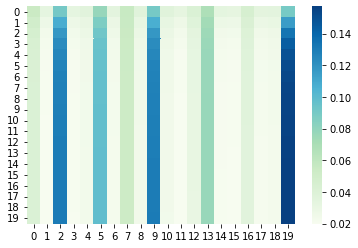

  9%|▉         | 2.7198443579766445/30 [01:43<38:49, 85.40s/it]

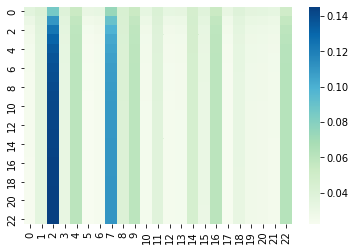

  9%|▉         | 2.723735408560302/30 [01:43<38:13, 84.07s/it] 

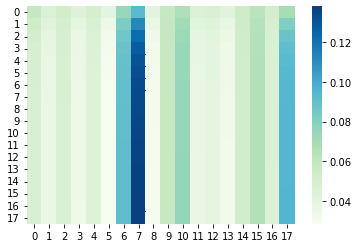

  9%|▉         | 2.7276264591439596/30 [01:44<38:02, 83.68s/it]

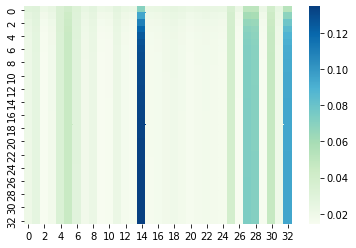

  9%|▉         | 2.731517509727617/30 [01:44<36:49, 81.02s/it] 

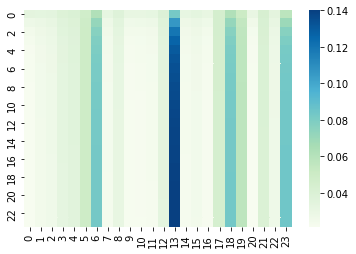

  9%|▉         | 2.7354085603112748/30 [01:44<36:33, 80.46s/it]

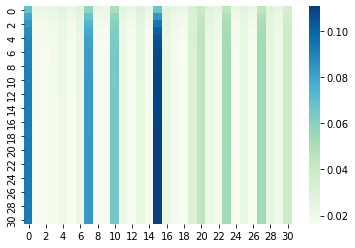

  9%|▉         | 2.7392996108949323/30 [01:44<35:30, 78.14s/it]

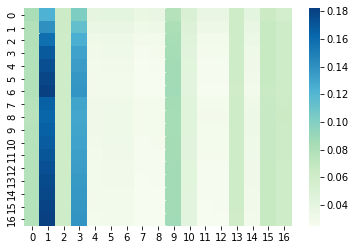

  9%|▉         | 2.74319066147859/30 [01:45<35:03, 77.16s/it]  

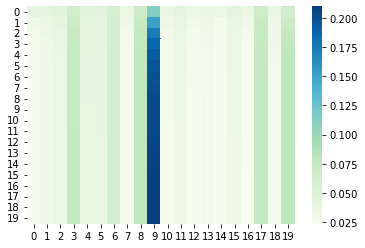

  9%|▉         | 2.7470817120622475/30 [01:45<36:01, 79.30s/it]

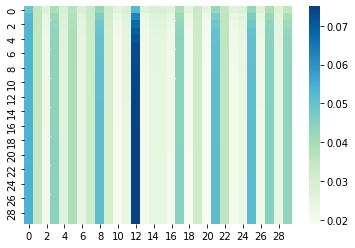

  9%|▉         | 2.750972762645905/30 [01:45<34:57, 76.97s/it] 

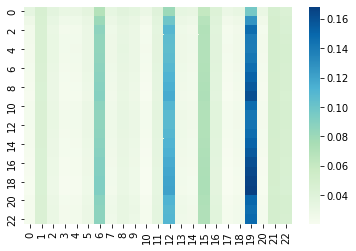

  9%|▉         | 2.7548638132295626/30 [01:46<35:46, 78.78s/it]

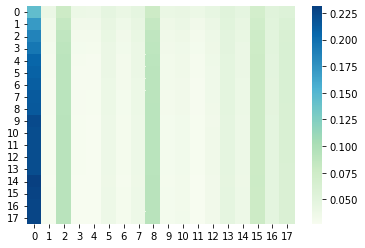

  9%|▉         | 2.75875486381322/30 [01:46<36:01, 79.34s/it]  

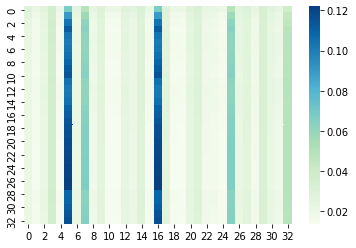

  9%|▉         | 2.762645914396878/30 [01:46<39:24, 86.81s/it]

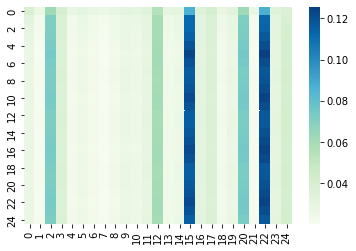

  9%|▉         | 2.7665369649805354/30 [01:47<38:59, 85.92s/it]

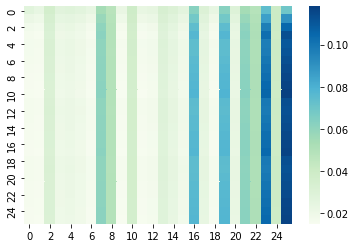

  9%|▉         | 2.770428015564193/30 [01:47<36:30, 80.43s/it] 

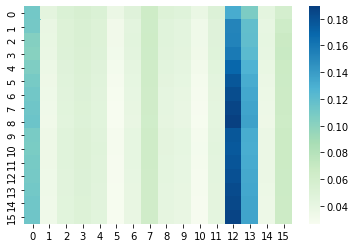

  9%|▉         | 2.7743190661478505/30 [01:47<36:12, 79.79s/it]

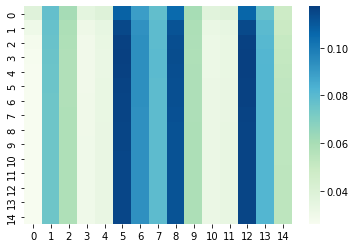

  9%|▉         | 2.778210116731508/30 [01:48<35:20, 77.89s/it] 

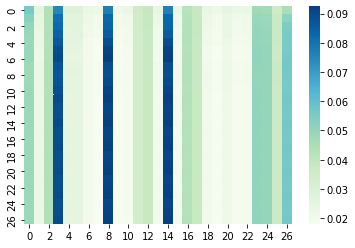

  9%|▉         | 2.7821011673151657/30 [01:48<34:28, 75.99s/it]

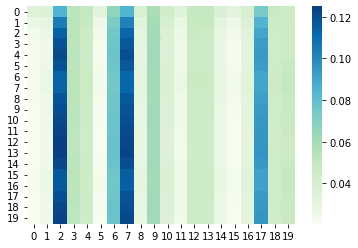

  9%|▉         | 2.7859922178988232/30 [01:48<35:56, 79.25s/it]

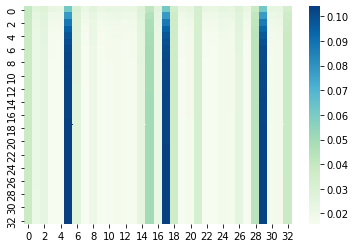

  9%|▉         | 2.789883268482481/30 [01:48<36:04, 79.56s/it] 

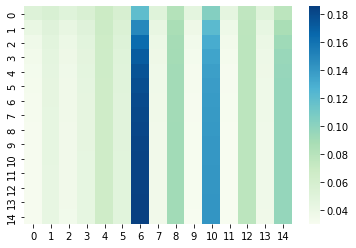

  9%|▉         | 2.7937743190661384/30 [01:49<35:24, 78.10s/it]

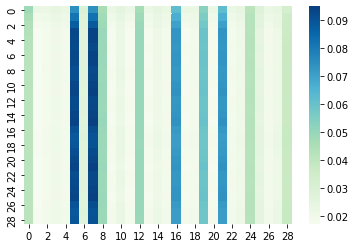

  9%|▉         | 2.797665369649796/30 [01:49<34:30, 76.11s/it] 

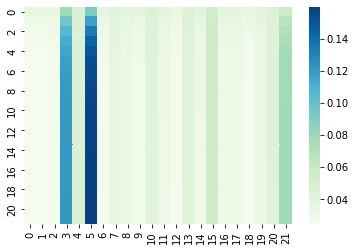

  9%|▉         | 2.8015564202334535/30 [01:49<34:50, 76.86s/it]

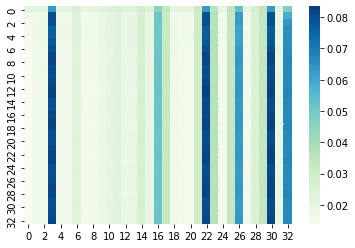

  9%|▉         | 2.805447470817111/30 [01:50<38:54, 85.85s/it] 

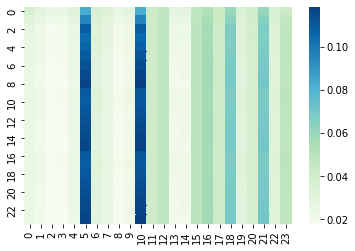

  9%|▉         | 2.8093385214007687/30 [01:50<38:23, 84.73s/it]

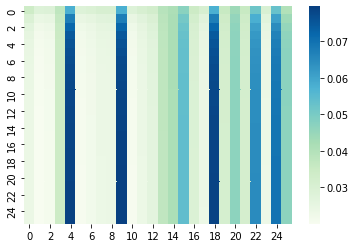

  9%|▉         | 2.8132295719844262/30 [01:50<36:31, 80.62s/it]

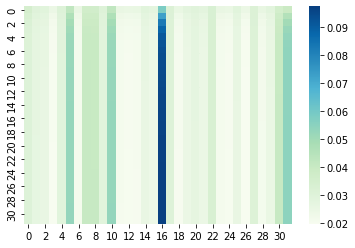

  9%|▉         | 2.817120622568084/30 [01:51<36:28, 80.52s/it] 

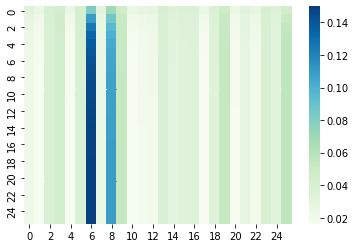

  9%|▉         | 2.8210116731517414/30 [01:51<34:36, 76.39s/it]

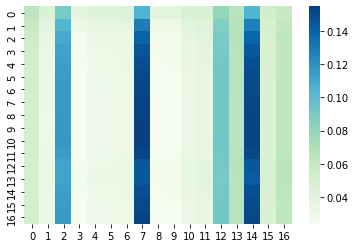

  9%|▉         | 2.824902723735399/30 [01:51<35:19, 77.99s/it] 

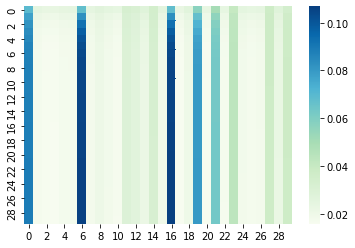

  9%|▉         | 2.8287937743190565/30 [01:52<34:18, 75.76s/it]

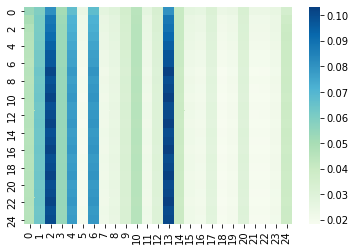

  9%|▉         | 2.832684824902714/30 [01:52<35:36, 78.64s/it] 

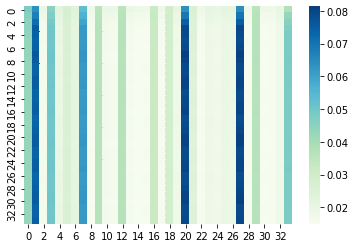

  9%|▉         | 2.8365758754863717/30 [01:52<35:10, 77.68s/it]

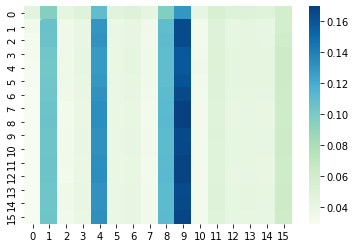

  9%|▉         | 2.8404669260700293/30 [01:52<35:06, 77.58s/it]

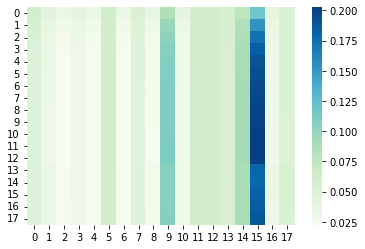

  9%|▉         | 2.844357976653687/30 [01:53<35:42, 78.91s/it] 

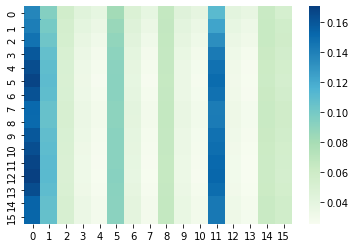

  9%|▉         | 2.8482490272373444/30 [01:53<39:04, 86.33s/it]

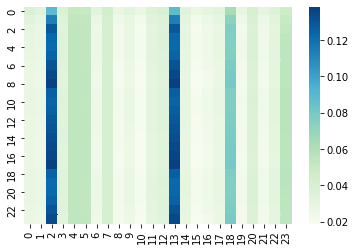

 10%|▉         | 2.852140077821002/30 [01:54<39:01, 86.26s/it] 

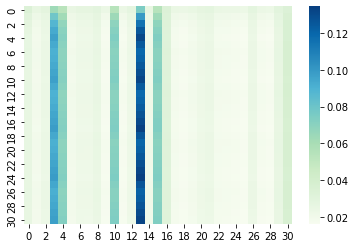

 10%|▉         | 2.8560311284046596/30 [01:54<37:25, 82.72s/it]

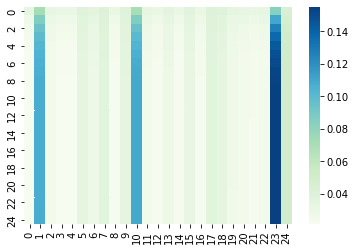

 10%|▉         | 2.859922178988317/30 [01:54<36:38, 80.99s/it] 

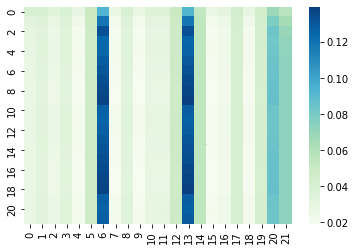

 10%|▉         | 2.8638132295719747/30 [01:54<36:00, 79.62s/it]

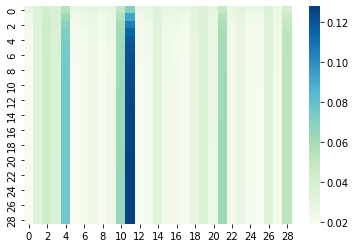

 10%|▉         | 2.8677042801556323/30 [01:55<34:29, 76.26s/it]

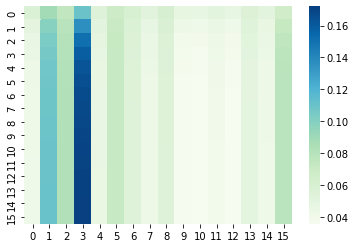

 10%|▉         | 2.87159533073929/30 [01:55<33:52, 74.94s/it]  

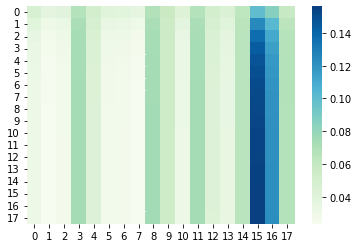

 10%|▉         | 2.8754863813229474/30 [01:55<34:29, 76.30s/it]

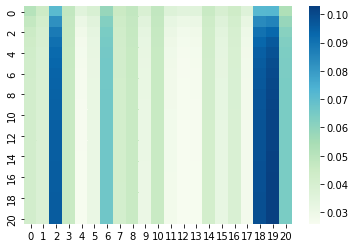

 10%|▉         | 2.879377431906605/30 [01:56<34:50, 77.07s/it] 

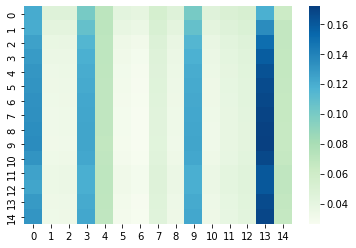

 10%|▉         | 2.8832684824902626/30 [01:56<34:03, 75.36s/it]

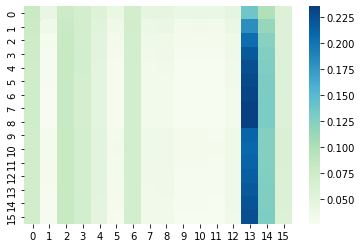

 10%|▉         | 2.88715953307392/30 [01:56<33:57, 75.15s/it]  

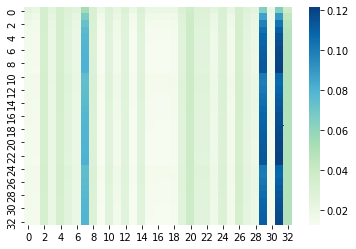

 10%|▉         | 2.8910505836575777/30 [01:57<37:55, 83.95s/it]

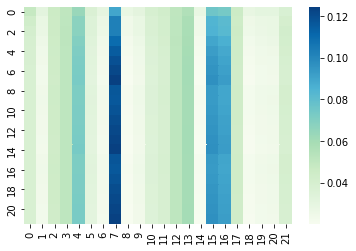

 10%|▉         | 2.8949416342412353/30 [01:57<37:11, 82.31s/it]

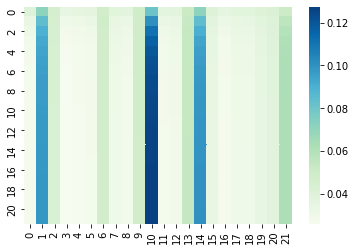

 10%|▉         | 2.898832684824893/30 [01:57<36:19, 80.43s/it] 

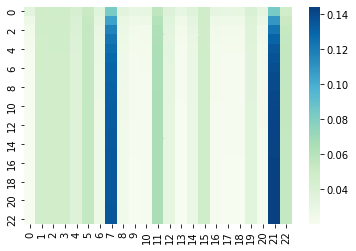

 10%|▉         | 2.9027237354085504/30 [01:57<37:07, 82.19s/it]

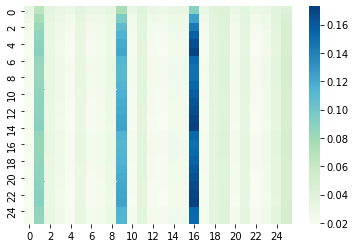

 10%|▉         | 2.906614785992208/30 [01:58<35:48, 79.29s/it] 

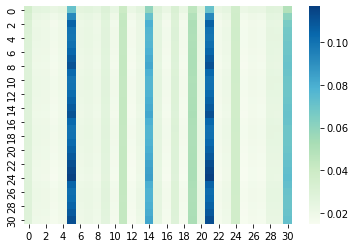

 10%|▉         | 2.9105058365758656/30 [01:58<35:08, 77.84s/it]

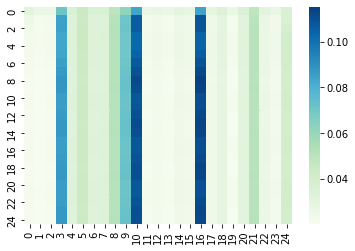

 10%|▉         | 2.914396887159523/30 [01:58<35:27, 78.54s/it] 

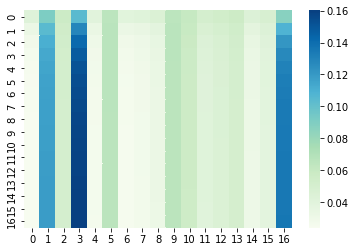

 10%|▉         | 2.9182879377431807/30 [01:59<35:40, 79.04s/it]

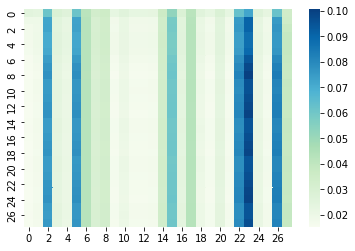

 10%|▉         | 2.9221789883268383/30 [01:59<34:43, 76.93s/it]

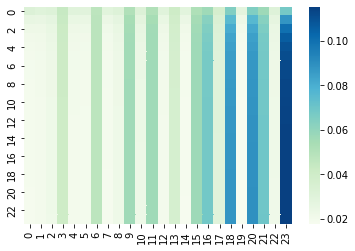

 10%|▉         | 2.926070038910496/30 [01:59<34:33, 76.60s/it] 

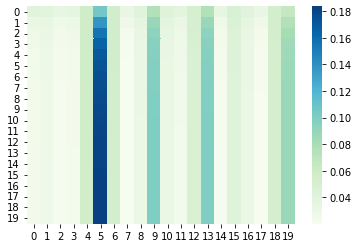

 10%|▉         | 2.9299610894941535/30 [02:00<35:33, 78.80s/it]

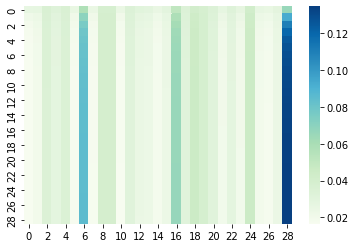

 10%|▉         | 2.933852140077811/30 [02:00<39:06, 86.71s/it] 

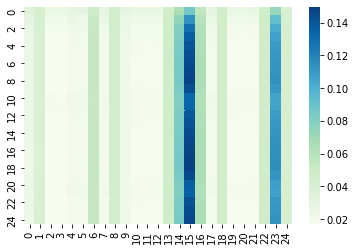

 10%|▉         | 2.9377431906614686/30 [02:00<38:16, 84.86s/it]

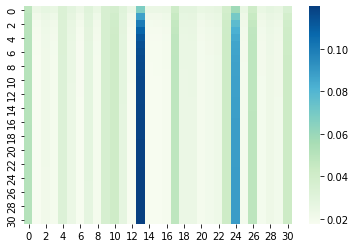

 10%|▉         | 2.941634241245126/30 [02:01<37:18, 82.74s/it] 

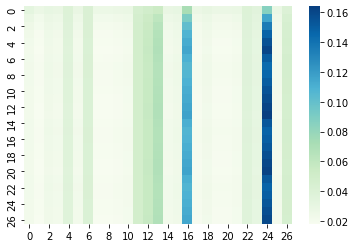

 10%|▉         | 2.9455252918287838/30 [02:01<36:08, 80.16s/it]

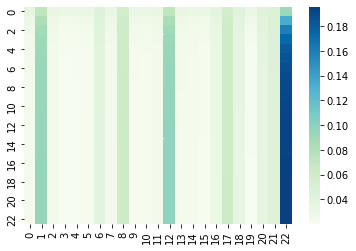

 10%|▉         | 2.9494163424124413/30 [02:01<35:56, 79.73s/it]

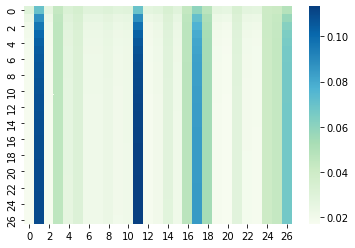

 10%|▉         | 2.953307392996099/30 [02:01<34:41, 76.95s/it] 

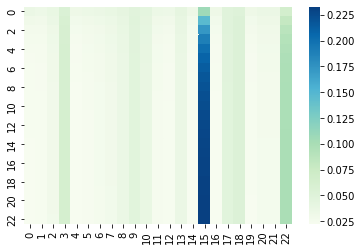

 10%|▉         | 2.9571984435797565/30 [02:02<35:51, 79.55s/it]

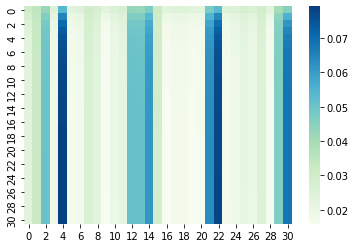

 10%|▉         | 2.961089494163414/30 [02:02<35:00, 77.68s/it] 

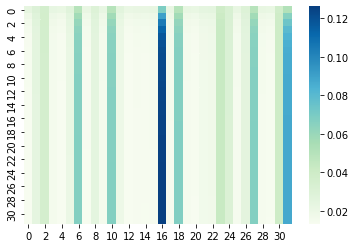

 10%|▉         | 2.9649805447470716/30 [02:02<34:41, 77.00s/it]

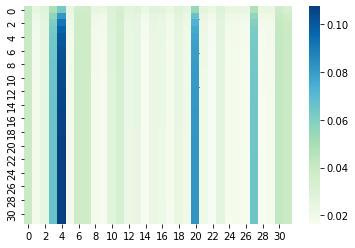

 10%|▉         | 2.968871595330729/30 [02:03<33:56, 75.33s/it] 

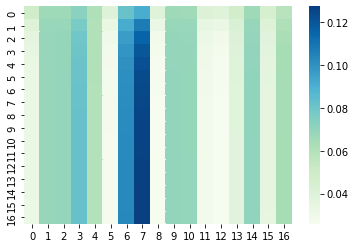

 10%|▉         | 2.9727626459143868/30 [02:03<34:06, 75.72s/it]

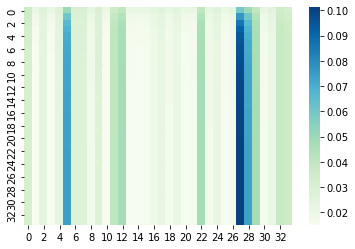

 10%|▉         | 2.9766536964980443/30 [02:03<39:00, 86.61s/it]

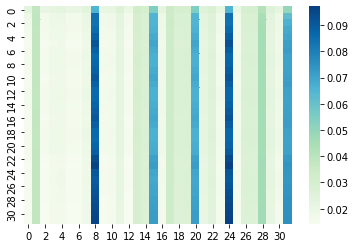

 10%|▉         | 2.980544747081702/30 [02:04<39:55, 88.64s/it] 

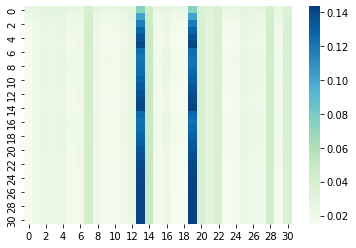

 10%|▉         | 2.9844357976653595/30 [02:04<43:28, 96.54s/it]

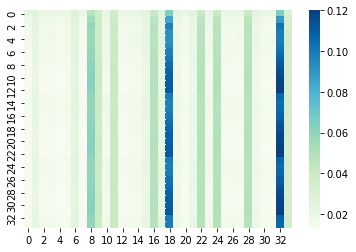

 10%|▉         | 2.988326848249017/30 [02:05<43:56, 97.62s/it] 

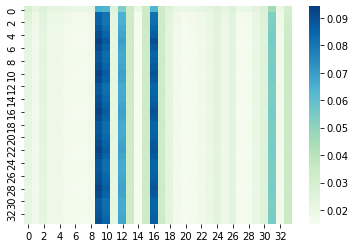

 10%|▉         | 2.9922178988326746/30 [02:05<44:53, 99.74s/it]

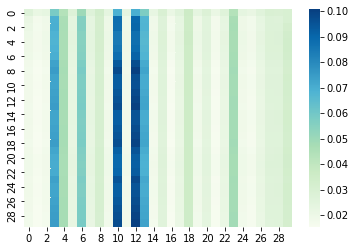

 10%|▉         | 2.996108949416332/30 [02:05<45:31, 101.15s/it]

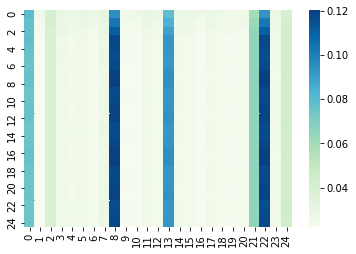

 10%|▉         | 2.99999999999999/30 [02:06<45:54, 102.02s/it] 

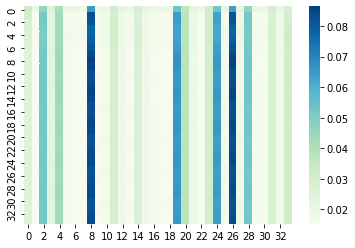

 12%|█▏        | 3.6147859922178864/30 [02:18<09:15, 21.04s/it]

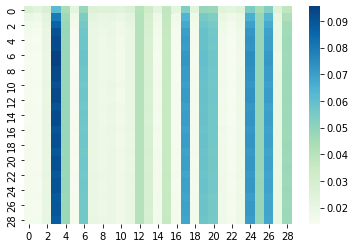

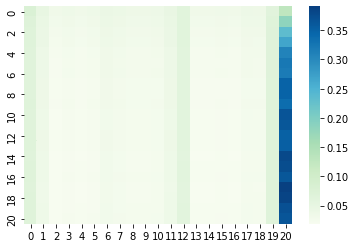

 12%|█▏        | 3.6225680933852016/30 [02:19<16:42, 38.01s/it]

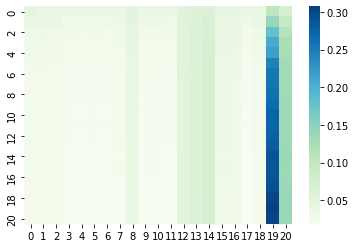

 12%|█▏        | 3.626459143968859/30 [02:19<20:00, 45.52s/it] 

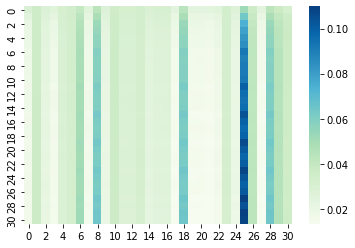

 12%|█▏        | 3.6303501945525167/30 [02:20<26:13, 59.68s/it]

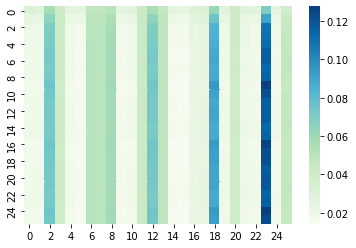

 12%|█▏        | 3.6342412451361743/30 [02:20<27:37, 62.87s/it]

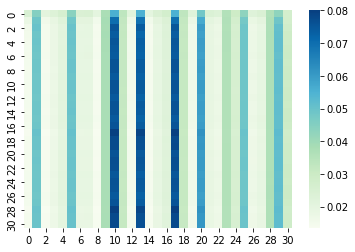

 12%|█▏        | 3.638132295719832/30 [02:20<28:36, 65.11s/it] 

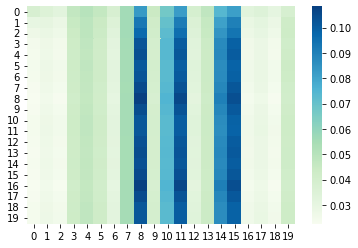

 12%|█▏        | 3.6420233463034895/30 [02:21<30:48, 70.12s/it]

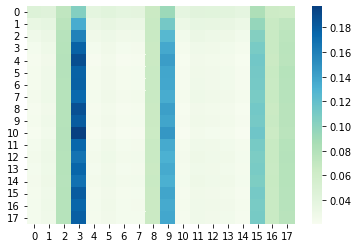

 12%|█▏        | 3.645914396887147/30 [02:21<32:10, 73.25s/it] 

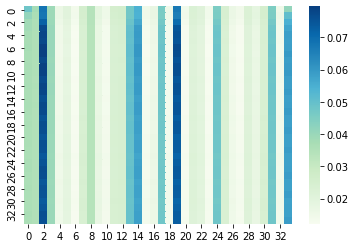

 12%|█▏        | 3.6498054474708046/30 [02:21<32:46, 74.62s/it]

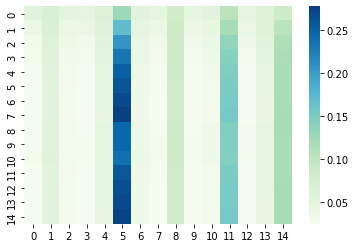

 12%|█▏        | 3.653696498054462/30 [02:22<32:30, 74.02s/it] 

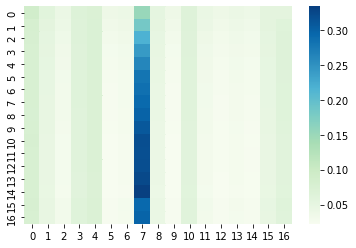

 12%|█▏        | 3.6575875486381197/30 [02:22<33:03, 75.28s/it]

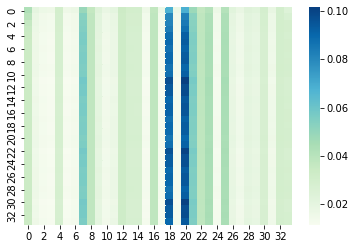

 12%|█▏        | 3.6614785992217773/30 [02:22<33:06, 75.42s/it]

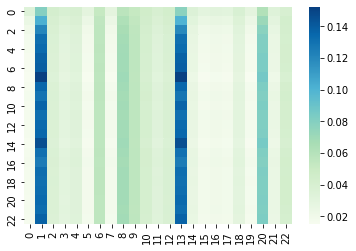

 12%|█▏        | 3.665369649805435/30 [02:23<33:35, 76.55s/it] 

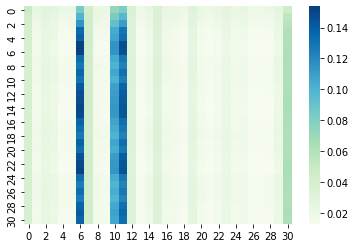

 12%|█▏        | 3.6692607003890925/30 [02:23<33:30, 76.35s/it]

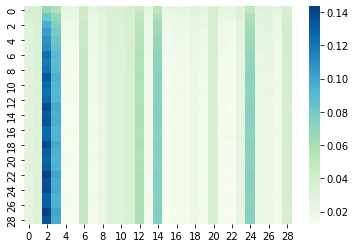

 12%|█▏        | 3.67315175097275/30 [02:23<36:39, 83.55s/it]  

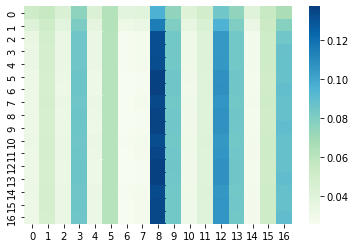

 12%|█▏        | 3.6770428015564076/30 [02:24<35:08, 80.11s/it]

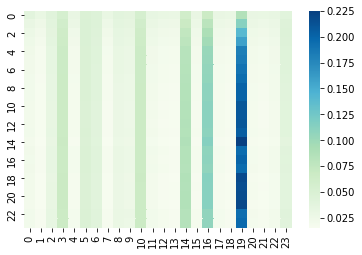

 12%|█▏        | 3.680933852140065/30 [02:24<35:48, 81.63s/it] 

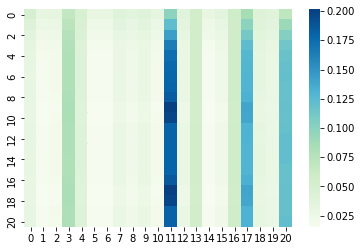

 12%|█▏        | 3.6848249027237228/30 [02:24<35:30, 80.97s/it]

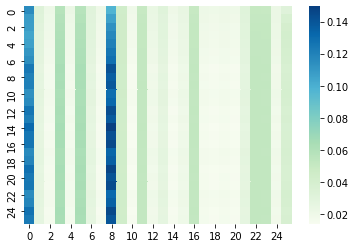

 12%|█▏        | 3.6887159533073803/30 [02:24<34:30, 78.70s/it]

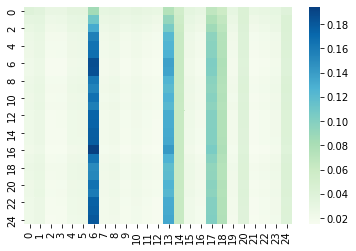

 12%|█▏        | 3.692607003891038/30 [02:25<36:10, 82.51s/it] 

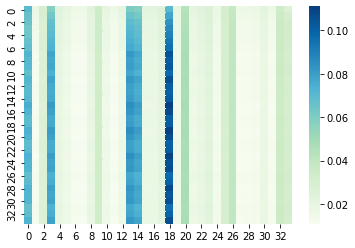

 12%|█▏        | 3.6964980544746955/30 [02:25<35:02, 79.93s/it]

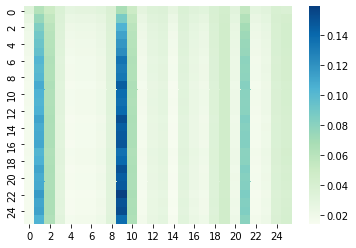

 12%|█▏        | 3.700389105058353/30 [02:25<33:55, 77.41s/it] 

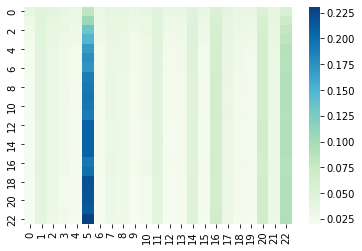

 12%|█▏        | 3.7042801556420106/30 [02:26<34:15, 78.18s/it]

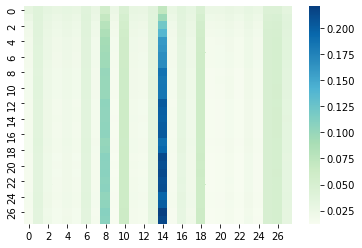

 12%|█▏        | 3.708171206225668/30 [02:26<33:35, 76.65s/it] 

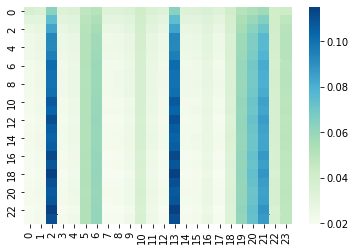

 12%|█▏        | 3.7120622568093258/30 [02:26<34:10, 77.99s/it]

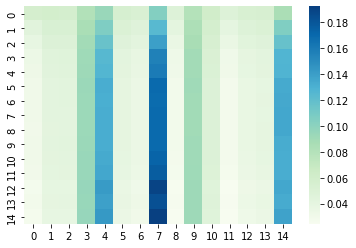

 12%|█▏        | 3.7159533073929834/30 [02:27<37:34, 85.76s/it]

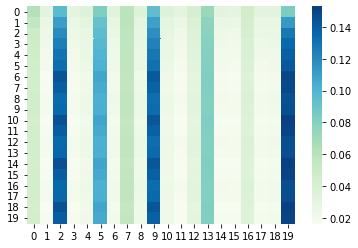

 12%|█▏        | 3.719844357976641/30 [02:27<37:45, 86.21s/it] 

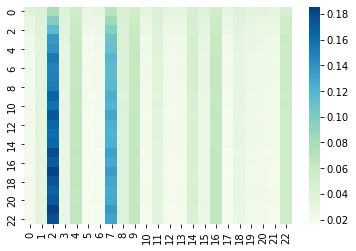

 12%|█▏        | 3.7237354085602985/30 [02:27<37:25, 85.46s/it]

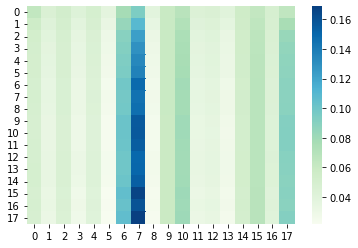

 12%|█▏        | 3.727626459143956/30 [02:28<36:57, 84.42s/it] 

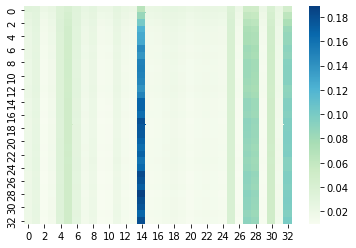

 12%|█▏        | 3.7315175097276136/30 [02:28<40:21, 92.17s/it]

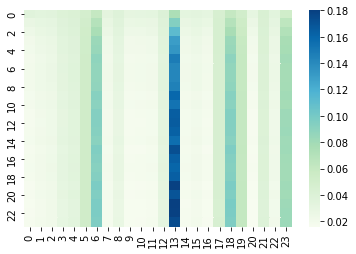

 12%|█▏        | 3.735408560311271/30 [02:29<43:55, 100.34s/it]

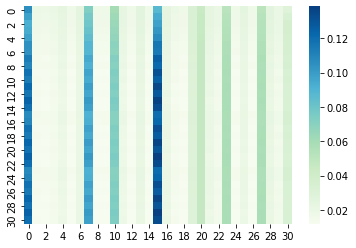

 12%|█▏        | 3.739299610894929/30 [02:29<43:13, 98.77s/it] 

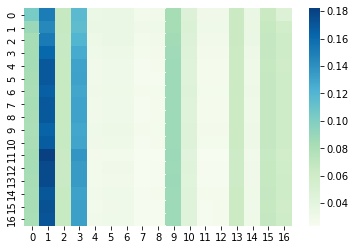

 12%|█▏        | 3.7431906614785864/30 [02:29<42:38, 97.45s/it]

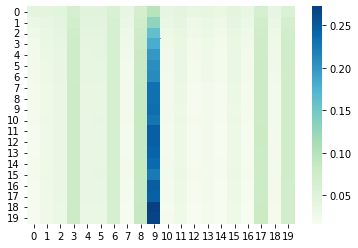

 12%|█▏        | 3.747081712062244/30 [02:30<43:52, 100.27s/it]

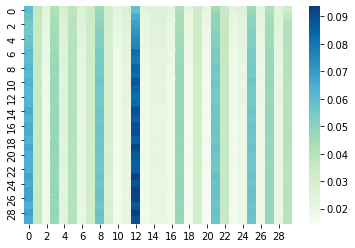

 13%|█▎        | 3.7509727626459015/30 [02:30<43:03, 98.41s/it]

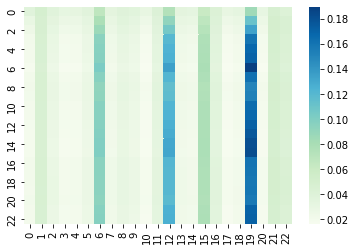

 13%|█▎        | 3.754863813229559/30 [02:31<44:28, 101.68s/it]

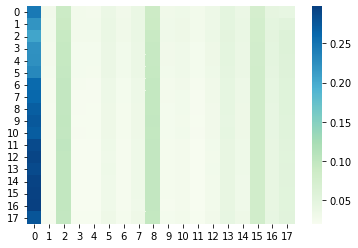

 13%|█▎        | 3.7587548638132167/30 [02:31<48:51, 111.70s/it]

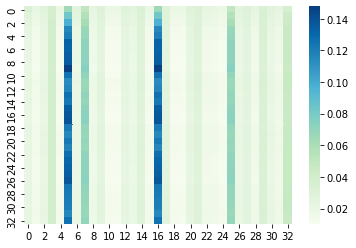

 13%|█▎        | 3.7626459143968742/30 [02:31<48:16, 110.41s/it]

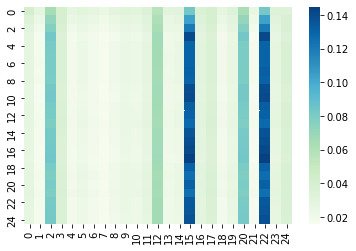

 13%|█▎        | 3.766536964980532/30 [02:32<47:36, 108.88s/it] 

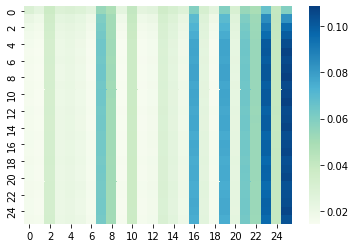

 13%|█▎        | 3.7704280155641894/30 [02:32<45:59, 105.20s/it]

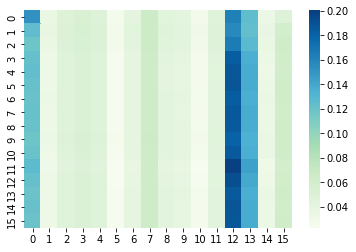

 13%|█▎        | 3.774319066147847/30 [02:33<43:58, 100.60s/it] 

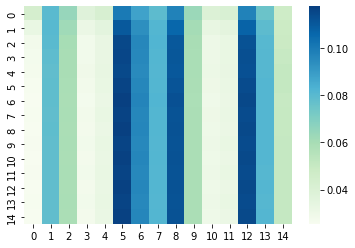

 13%|█▎        | 3.7782101167315045/30 [02:33<40:13, 92.06s/it]

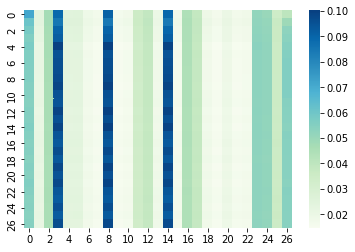

 13%|█▎        | 3.782101167315162/30 [02:33<37:36, 86.07s/it] 

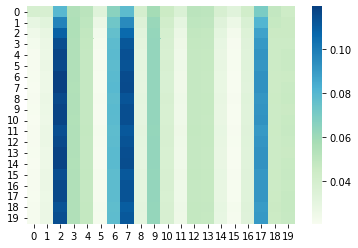

 13%|█▎        | 3.7859922178988197/30 [02:33<37:02, 84.80s/it]

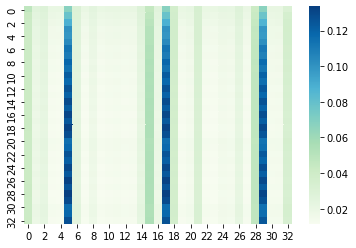

 13%|█▎        | 3.7898832684824773/30 [02:34<36:07, 82.72s/it]

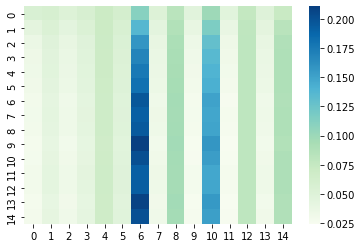

 13%|█▎        | 3.793774319066135/30 [02:34<35:15, 80.71s/it] 

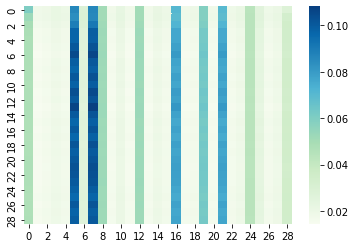

 13%|█▎        | 3.7976653696497924/30 [02:34<34:38, 79.32s/it]

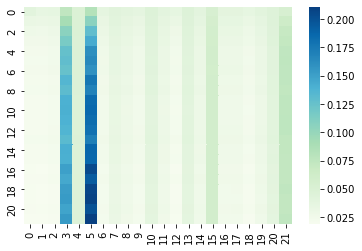

 13%|█▎        | 3.80155642023345/30 [02:35<39:05, 89.54s/it]  

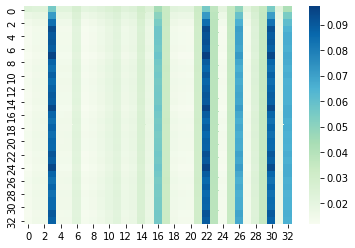

 13%|█▎        | 3.8054474708171075/30 [02:35<37:29, 85.89s/it]

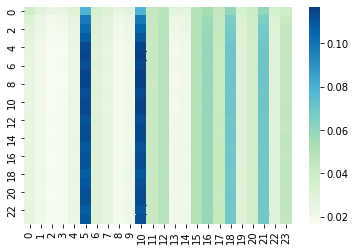

 13%|█▎        | 3.809338521400765/30 [02:35<36:21, 83.29s/it] 

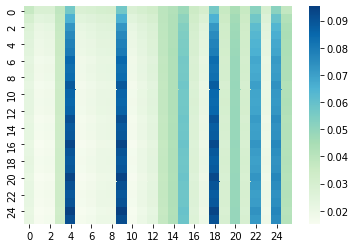

 13%|█▎        | 3.8132295719844227/30 [02:36<34:59, 80.16s/it]

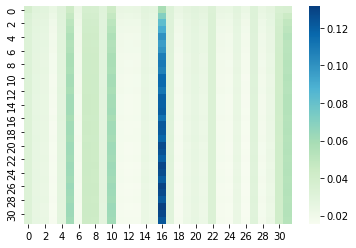

 13%|█▎        | 3.8171206225680803/30 [02:36<34:05, 78.12s/it]

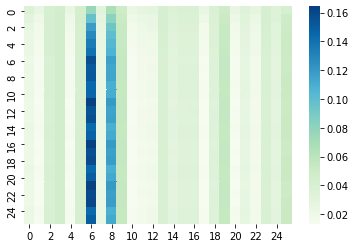

 13%|█▎        | 3.821011673151738/30 [02:36<33:58, 77.86s/it] 

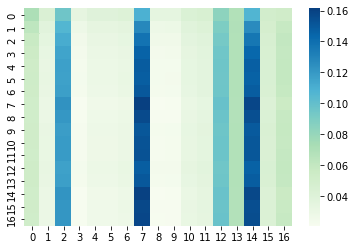

 13%|█▎        | 3.8249027237353954/30 [02:37<34:21, 78.76s/it]

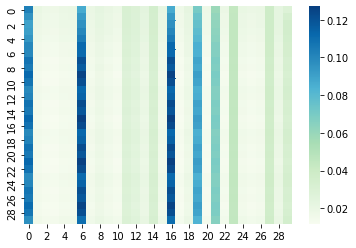

 13%|█▎        | 3.828793774319053/30 [02:37<34:29, 79.06s/it] 

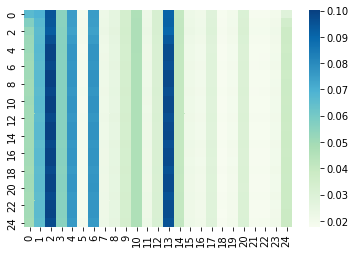

 13%|█▎        | 3.8326848249027106/30 [02:37<35:20, 81.05s/it]

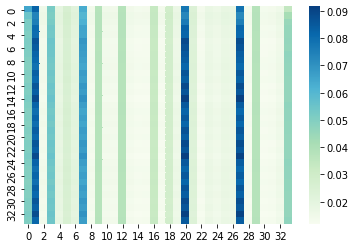

 13%|█▎        | 3.836575875486368/30 [02:38<34:17, 78.62s/it] 

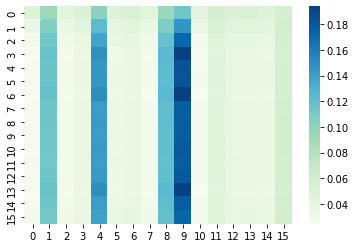

 13%|█▎        | 3.8404669260700257/30 [02:38<34:46, 79.75s/it]

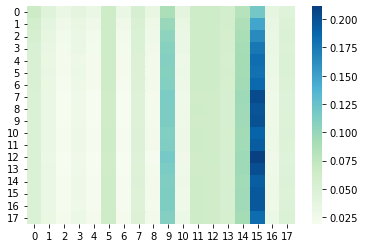

 13%|█▎        | 3.8443579766536833/30 [02:38<38:41, 88.75s/it]

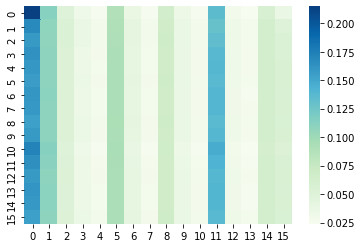

 13%|█▎        | 3.848249027237341/30 [02:39<36:54, 84.66s/it] 

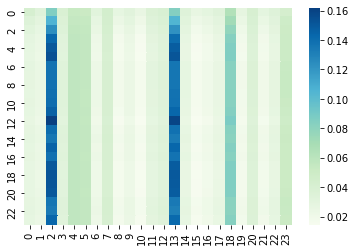

 13%|█▎        | 3.8521400778209984/30 [02:39<37:12, 85.37s/it]

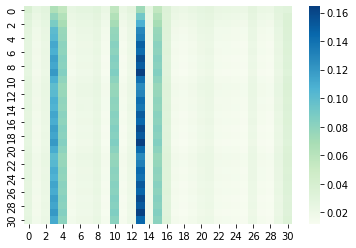

 13%|█▎        | 3.856031128404656/30 [02:39<35:48, 82.17s/it] 

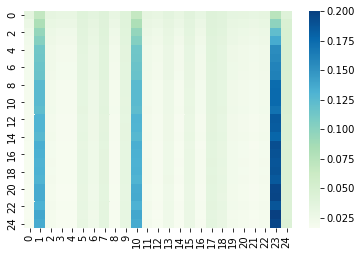

 13%|█▎        | 3.8599221789883136/30 [02:40<36:09, 82.99s/it]

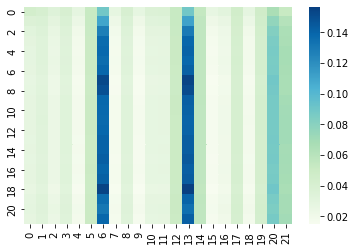

 13%|█▎        | 3.863813229571971/30 [02:40<36:01, 82.70s/it] 

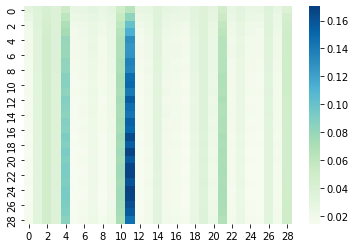

 13%|█▎        | 3.8677042801556287/30 [02:40<35:05, 80.56s/it]

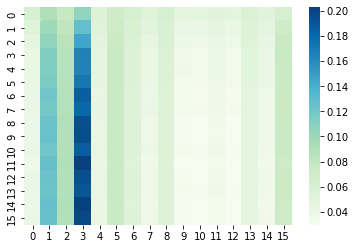

 13%|█▎        | 3.8715953307392863/30 [02:40<35:30, 81.53s/it]

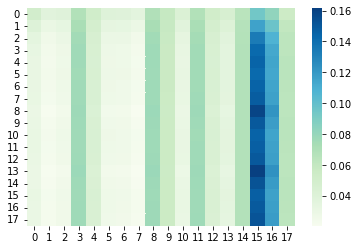

 13%|█▎        | 3.875486381322944/30 [02:41<35:10, 80.78s/it] 

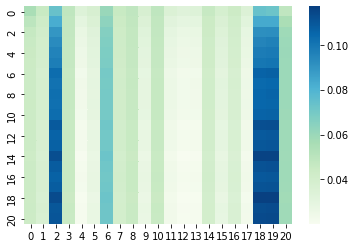

 13%|█▎        | 3.8793774319066014/30 [02:41<34:10, 78.49s/it]

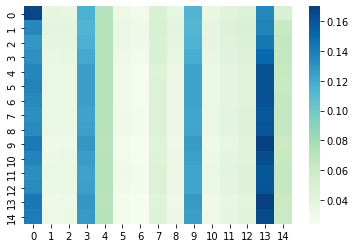

 13%|█▎        | 3.883268482490259/30 [02:41<33:40, 77.35s/it] 

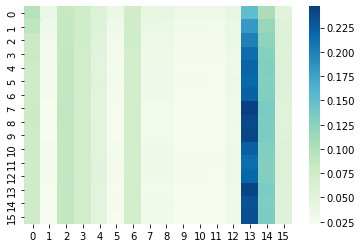

 13%|█▎        | 3.8871595330739166/30 [02:42<38:33, 88.59s/it]

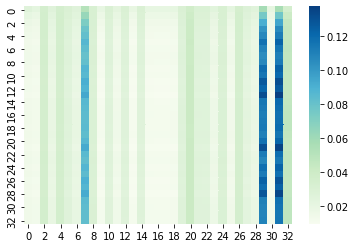

 13%|█▎        | 3.891050583657574/30 [02:42<36:48, 84.58s/it] 

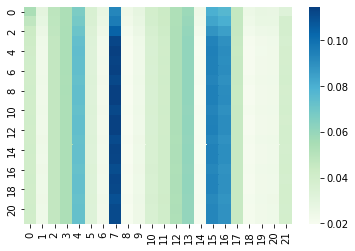

 13%|█▎        | 3.8949416342412317/30 [02:42<36:02, 82.82s/it]

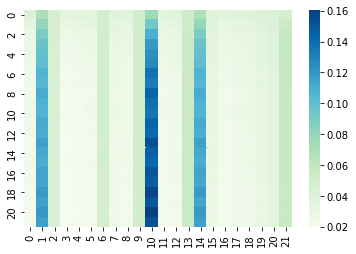

 13%|█▎        | 3.8988326848248893/30 [02:43<36:07, 83.04s/it]

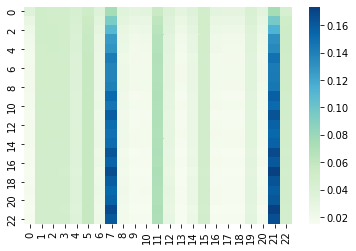

 13%|█▎        | 3.902723735408547/30 [02:43<36:29, 83.91s/it] 

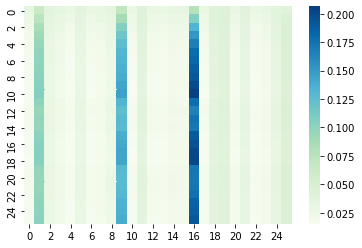

 13%|█▎        | 3.9066147859922045/30 [02:43<35:17, 81.17s/it]

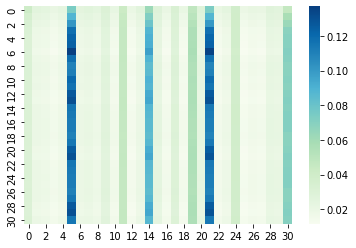

 13%|█▎        | 3.910505836575862/30 [02:44<34:30, 79.37s/it] 

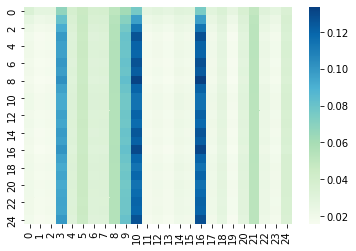

 13%|█▎        | 3.9143968871595196/30 [02:44<34:56, 80.37s/it]

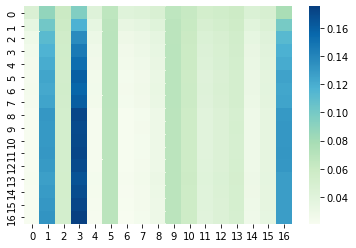

 13%|█▎        | 3.918287937743177/30 [02:44<34:39, 79.73s/it] 

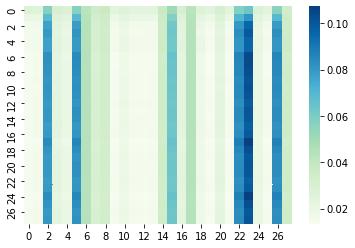

 13%|█▎        | 3.9221789883268348/30 [02:45<33:06, 76.18s/it]

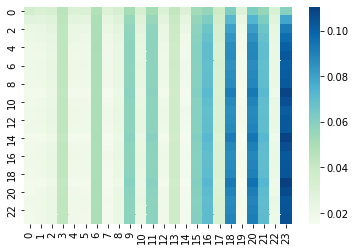

 13%|█▎        | 3.9260700389104923/30 [02:45<33:29, 77.07s/it]

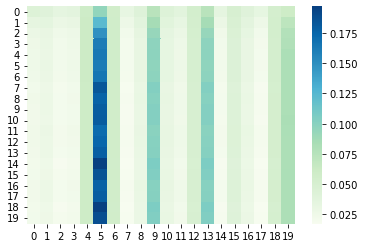

 13%|█▎        | 3.92996108949415/30 [02:45<38:44, 89.16s/it]  

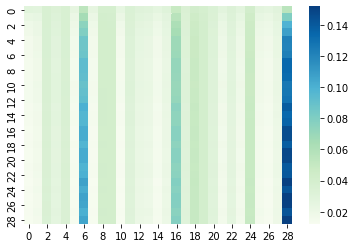

 13%|█▎        | 3.9338521400778075/30 [02:46<36:46, 84.65s/it]

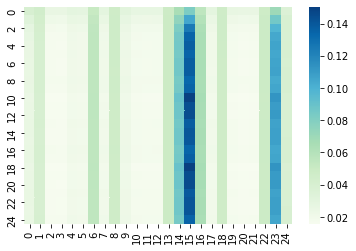

 13%|█▎        | 3.937743190661465/30 [02:46<37:24, 86.12s/it] 

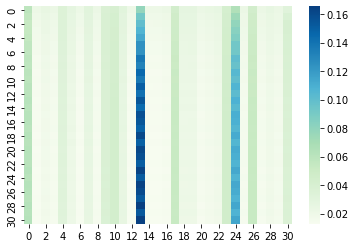

 13%|█▎        | 3.9416342412451226/30 [02:46<36:47, 84.70s/it]

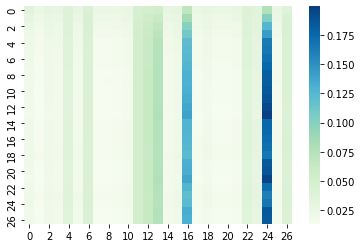

 13%|█▎        | 3.94552529182878/30 [02:47<35:18, 81.31s/it]  

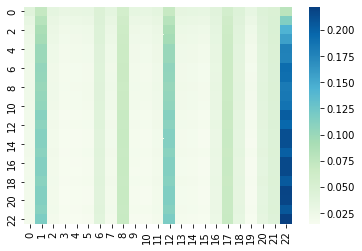

 13%|█▎        | 3.9494163424124378/30 [02:47<35:41, 82.20s/it]

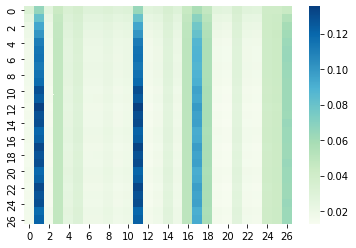

 13%|█▎        | 3.9533073929960953/30 [02:47<35:22, 81.49s/it]

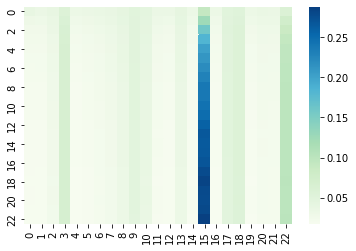

 13%|█▎        | 3.957198443579753/30 [02:48<36:10, 83.34s/it] 

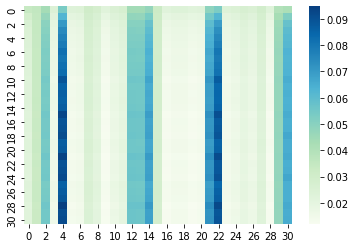

 13%|█▎        | 3.9610894941634105/30 [02:48<35:37, 82.10s/it]

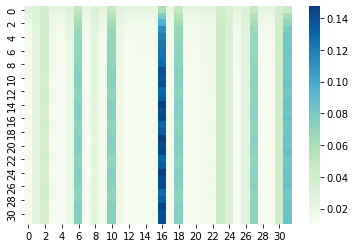

 13%|█▎        | 3.964980544747068/30 [02:48<34:50, 80.31s/it] 

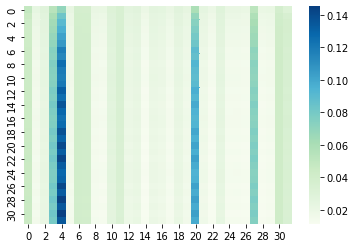

 13%|█▎        | 3.9688715953307256/30 [02:48<35:17, 81.36s/it]

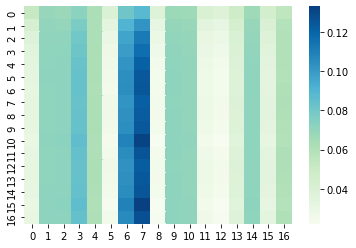

 13%|█▎        | 3.972762645914383/30 [02:49<38:35, 88.98s/it] 

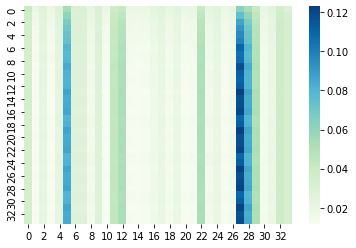

 13%|█▎        | 3.976653696498041/30 [02:49<37:18, 86.03s/it]

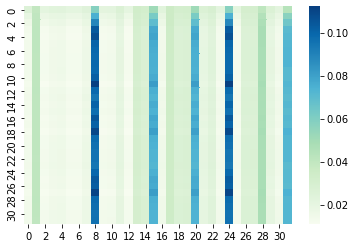

 13%|█▎        | 3.9805447470816984/30 [02:49<36:37, 84.47s/it]

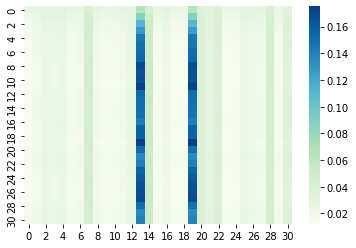

 13%|█▎        | 3.984435797665356/30 [02:50<35:52, 82.73s/it] 

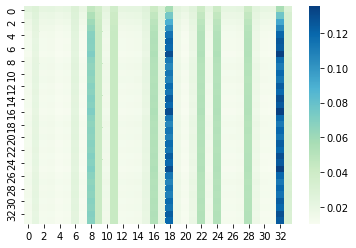

 13%|█▎        | 3.9883268482490135/30 [02:50<35:37, 82.18s/it]

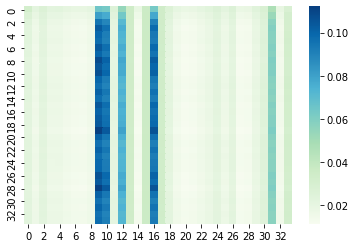

 13%|█▎        | 3.992217898832671/30 [02:50<34:35, 79.79s/it] 

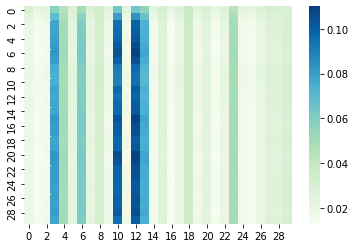

 13%|█▎        | 3.9961089494163287/30 [02:51<34:04, 78.64s/it]

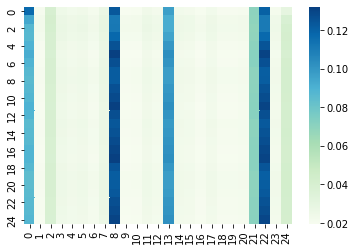

 13%|█▎        | 3.9999999999999862/30 [02:51<35:09, 81.12s/it]

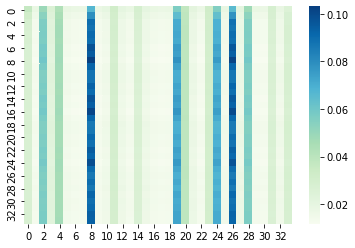

 15%|█▌        | 4.610894941634226/30 [03:03<07:42, 18.22s/it]

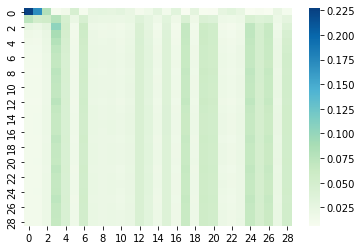

 15%|█▌        | 4.618677042801541/30 [03:04<13:02, 30.84s/it]

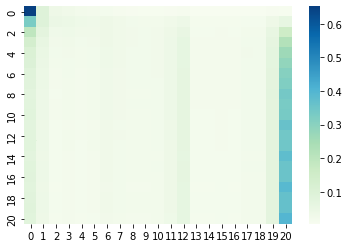

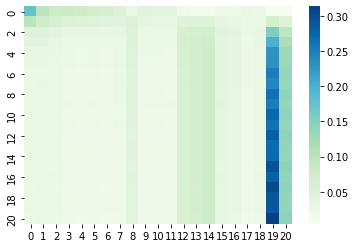

 15%|█▌        | 4.626459143968856/30 [03:04<21:08, 49.98s/it]

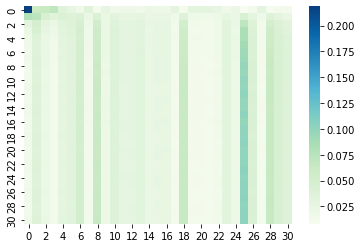

 15%|█▌        | 4.630350194552514/30 [03:05<23:15, 55.01s/it]

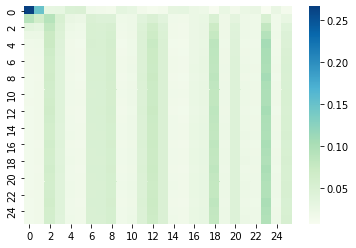

 15%|█▌        | 4.634241245136171/30 [03:05<24:45, 58.58s/it]

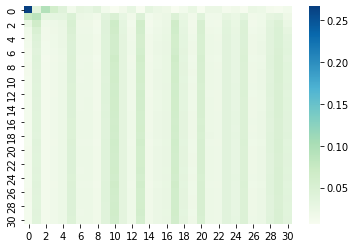

 15%|█▌        | 4.638132295719829/30 [03:05<25:57, 61.39s/it]

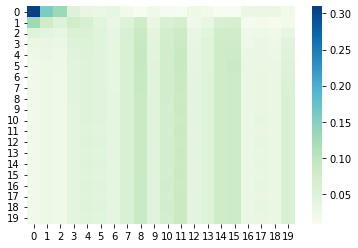

 15%|█▌        | 4.642023346303486/30 [03:06<28:20, 67.05s/it]

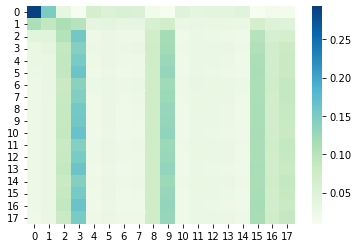

 15%|█▌        | 4.645914396887144/30 [03:06<30:06, 71.25s/it]

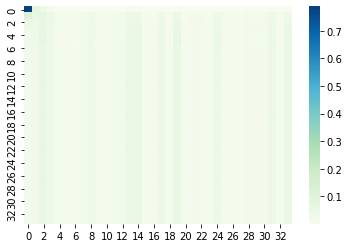

 15%|█▌        | 4.6498054474708015/30 [03:06<30:45, 72.79s/it]

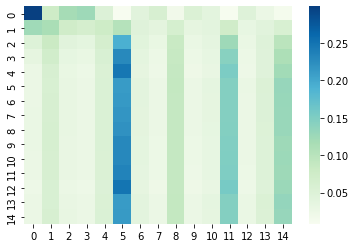

 16%|█▌        | 4.653696498054459/30 [03:07<30:46, 72.85s/it] 

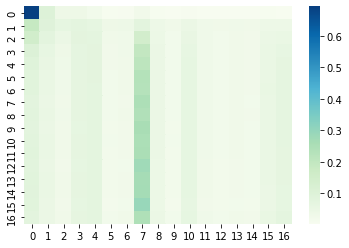

 16%|█▌        | 4.657587548638117/30 [03:07<32:07, 76.07s/it]

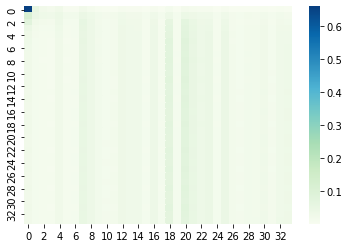

 16%|█▌        | 4.661478599221774/30 [03:07<32:15, 76.38s/it]

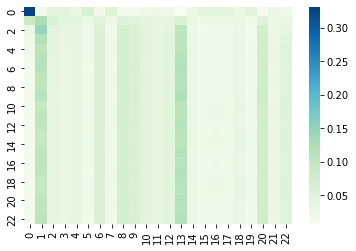

 16%|█▌        | 4.665369649805432/30 [03:07<33:03, 78.29s/it]

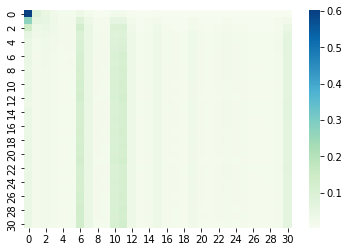

 16%|█▌        | 4.669260700389089/30 [03:08<36:49, 87.23s/it]

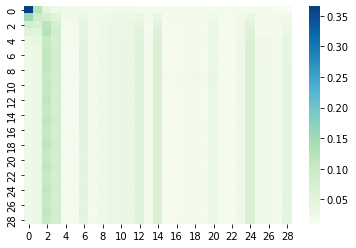

 16%|█▌        | 4.673151750972747/30 [03:08<35:55, 85.11s/it]

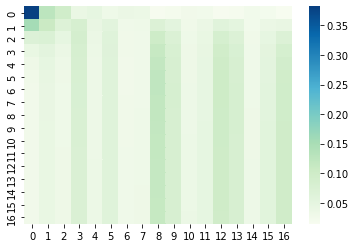

 16%|█▌        | 4.6770428015564045/30 [03:09<35:05, 83.16s/it]

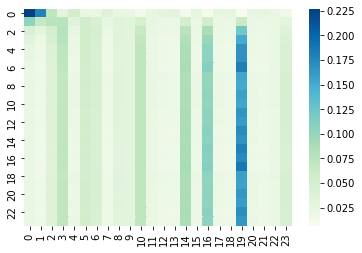

 16%|█▌        | 4.680933852140062/30 [03:09<35:43, 84.67s/it] 

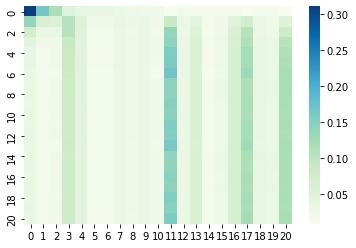

 16%|█▌        | 4.68482490272372/30 [03:09<35:09, 83.31s/it] 

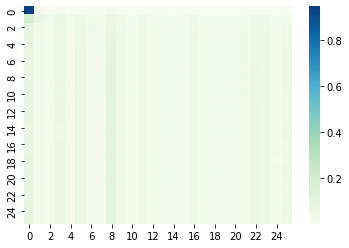

 16%|█▌        | 4.688715953307377/30 [03:09<34:17, 81.29s/it]

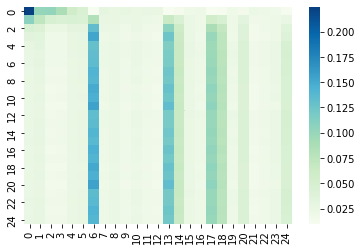

 16%|█▌        | 4.692607003891035/30 [03:10<35:31, 84.23s/it]

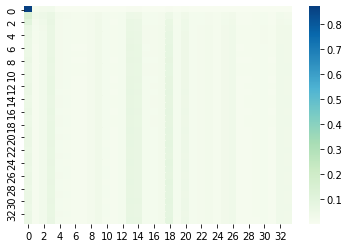

 16%|█▌        | 4.696498054474692/30 [03:10<35:48, 84.91s/it]

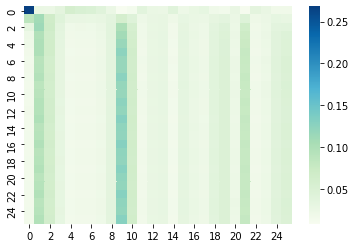

 16%|█▌        | 4.70038910505835/30 [03:10<34:56, 82.86s/it] 

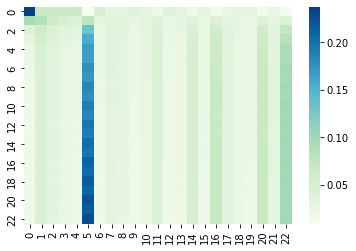

 16%|█▌        | 4.7042801556420075/30 [03:11<34:49, 82.62s/it]

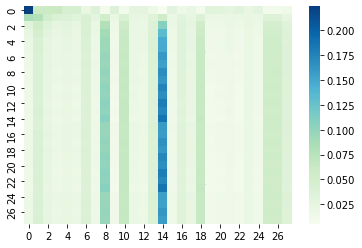

 16%|█▌        | 4.708171206225665/30 [03:11<34:49, 82.61s/it] 

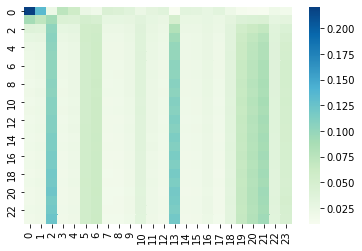

 16%|█▌        | 4.712062256809323/30 [03:12<38:44, 91.93s/it]

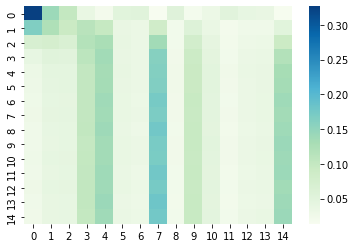

 16%|█▌        | 4.71595330739298/30 [03:12<36:52, 87.52s/it] 

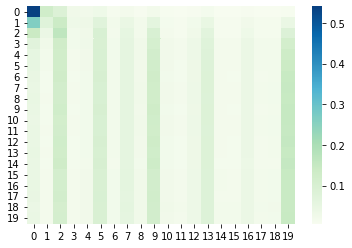

 16%|█▌        | 4.719844357976638/30 [03:12<36:42, 87.12s/it]

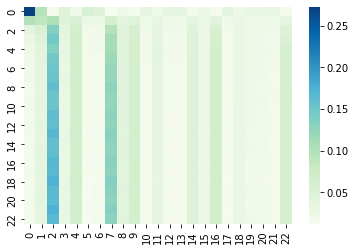

 16%|█▌        | 4.723735408560295/30 [03:13<36:05, 85.67s/it]

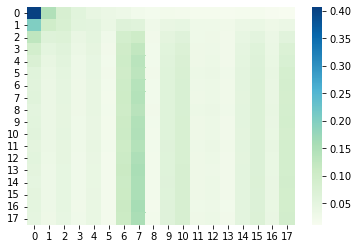

 16%|█▌        | 4.727626459143953/30 [03:13<36:43, 87.20s/it]

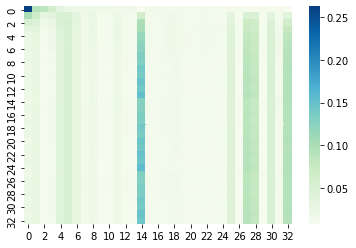

 16%|█▌        | 4.7315175097276105/30 [03:13<36:06, 85.75s/it]

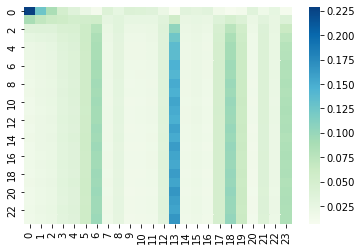

 16%|█▌        | 4.735408560311268/30 [03:14<36:55, 87.70s/it] 

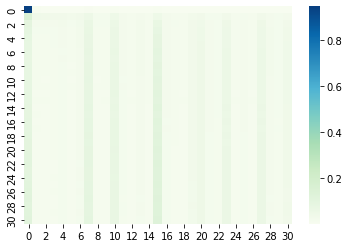

 16%|█▌        | 4.739299610894926/30 [03:14<34:56, 83.01s/it]

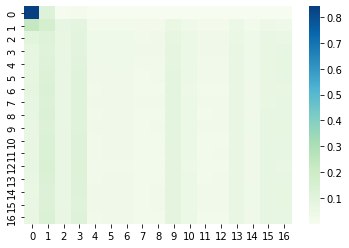

 16%|█▌        | 4.743190661478583/30 [03:14<34:39, 82.35s/it]

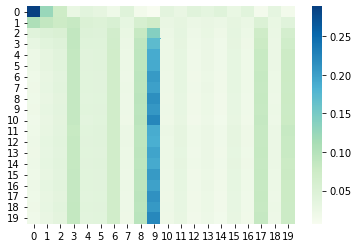

 16%|█▌        | 4.747081712062241/30 [03:15<35:51, 85.19s/it]

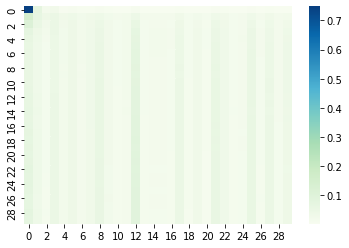

 16%|█▌        | 4.750972762645898/30 [03:15<35:00, 83.20s/it]

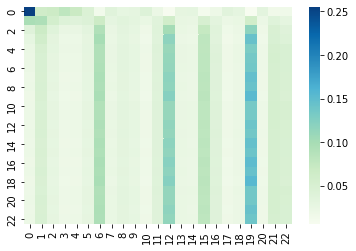

 16%|█▌        | 4.754863813229556/30 [03:15<37:57, 90.21s/it]

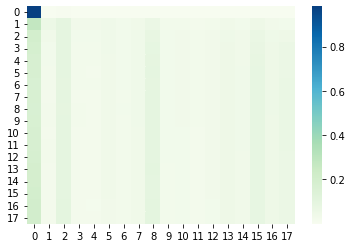

 16%|█▌        | 4.7587548638132136/30 [03:16<37:04, 88.12s/it]

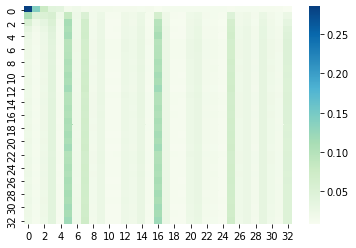

 16%|█▌        | 4.762645914396871/30 [03:16<36:05, 85.79s/it] 

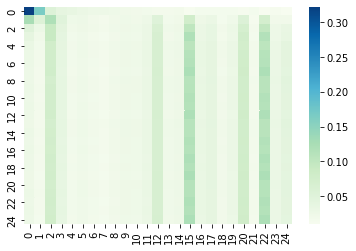

 16%|█▌        | 4.766536964980529/30 [03:16<35:19, 83.98s/it]

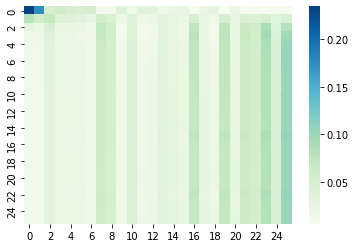

 16%|█▌        | 4.770428015564186/30 [03:16<33:02, 78.58s/it]

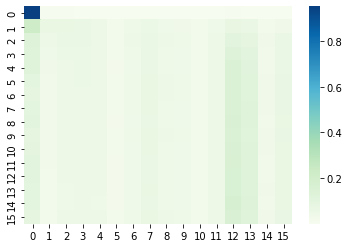

 16%|█▌        | 4.774319066147844/30 [03:17<32:02, 76.22s/it]

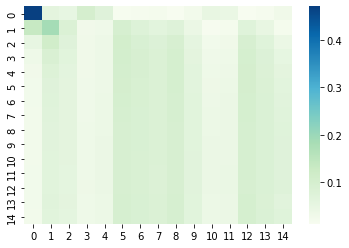

 16%|█▌        | 4.778210116731501/30 [03:17<32:26, 77.16s/it]

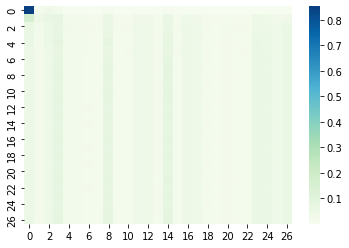

 16%|█▌        | 4.782101167315159/30 [03:17<31:58, 76.08s/it]

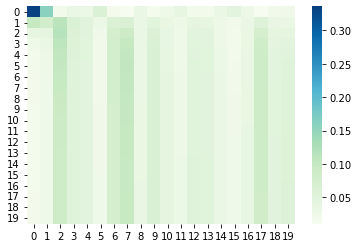

 16%|█▌        | 4.785992217898817/30 [03:18<33:36, 79.98s/it]

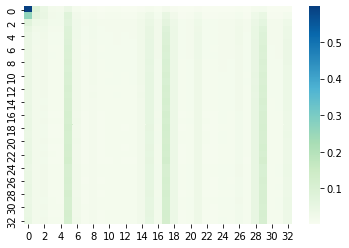

 16%|█▌        | 4.789883268482474/30 [03:18<32:59, 78.53s/it]

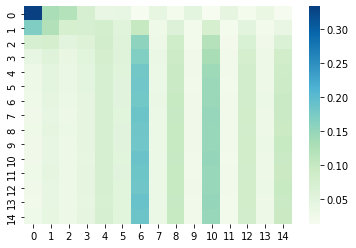

 16%|█▌        | 4.793774319066132/30 [03:18<32:05, 76.41s/it]

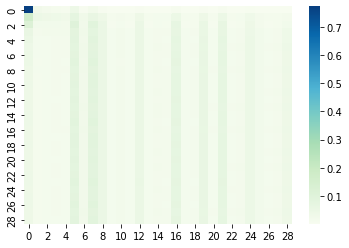

 16%|█▌        | 4.797665369649789/30 [03:19<36:04, 85.90s/it]

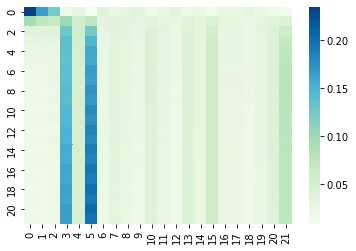

 16%|█▌        | 4.801556420233447/30 [03:19<35:29, 84.50s/it]

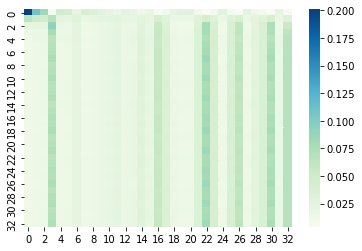

 16%|█▌        | 4.805447470817104/30 [03:19<35:11, 83.80s/it]

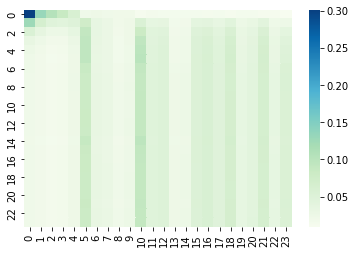

 16%|█▌        | 4.809338521400762/30 [03:20<35:44, 85.13s/it]

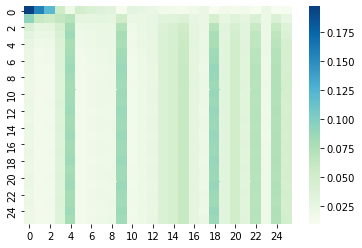

 16%|█▌        | 4.81322957198442/30 [03:20<34:52, 83.07s/it] 

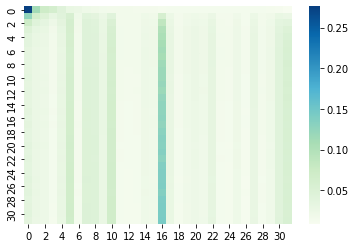

 16%|█▌        | 4.817120622568077/30 [03:20<34:08, 81.36s/it]

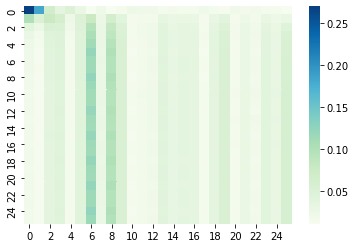

 16%|█▌        | 4.821011673151735/30 [03:21<32:53, 78.37s/it]

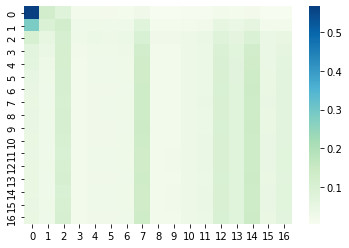

 16%|█▌        | 4.824902723735392/30 [03:21<33:01, 78.72s/it]

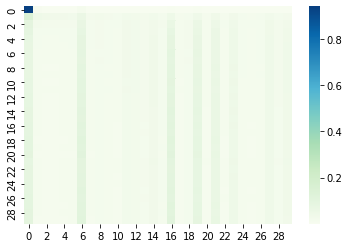

 16%|█▌        | 4.82879377431905/30 [03:21<32:28, 77.42s/it] 

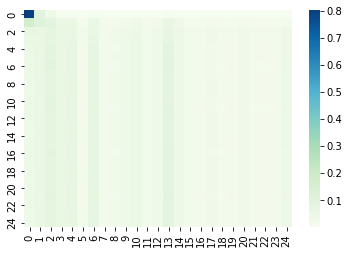

 16%|█▌        | 4.8326848249027075/30 [03:21<33:41, 80.33s/it]

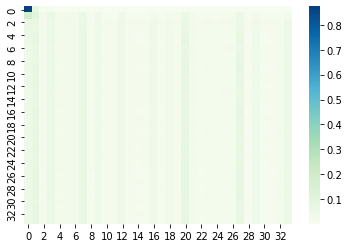

 16%|█▌        | 4.836575875486365/30 [03:22<34:04, 81.24s/it] 

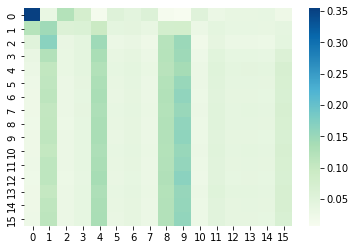

 16%|█▌        | 4.840466926070023/30 [03:22<37:25, 89.27s/it]

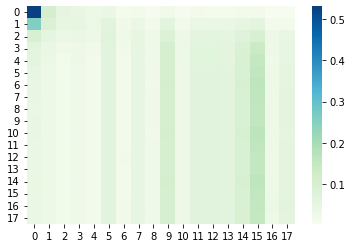

 16%|█▌        | 4.84435797665368/30 [03:23<36:51, 87.91s/it] 

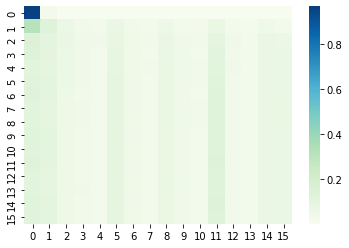

 16%|█▌        | 4.848249027237338/30 [03:23<36:01, 85.93s/it]

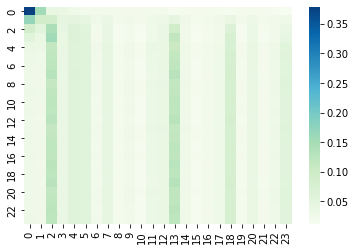

 16%|█▌        | 4.852140077820995/30 [03:23<35:35, 84.92s/it]

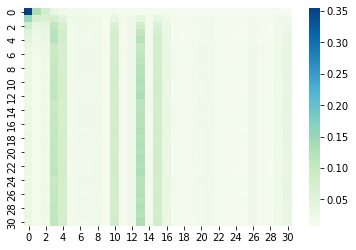

 16%|█▌        | 4.856031128404653/30 [03:23<34:57, 83.43s/it]

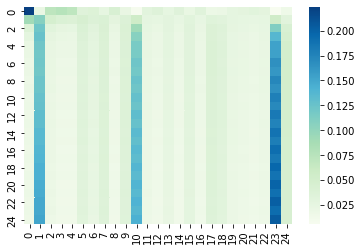

 16%|█▌        | 4.8599221789883105/30 [03:24<35:48, 85.47s/it]

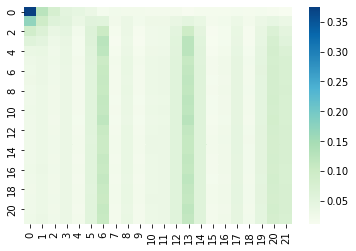

 16%|█▌        | 4.863813229571968/30 [03:24<35:23, 84.50s/it] 

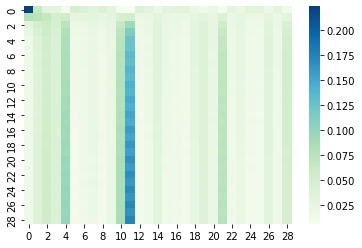

 16%|█▌        | 4.867704280155626/30 [03:24<34:31, 82.42s/it]

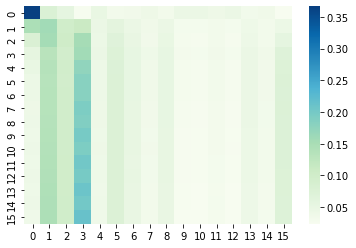

 16%|█▌        | 4.871595330739283/30 [03:25<33:32, 80.08s/it]

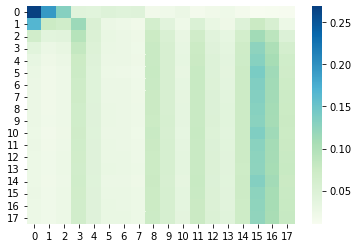

 16%|█▋        | 4.875486381322941/30 [03:25<33:43, 80.53s/it]

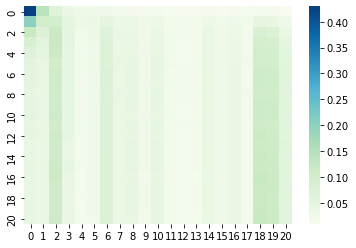

 16%|█▋        | 4.879377431906598/30 [03:25<32:57, 78.72s/it]

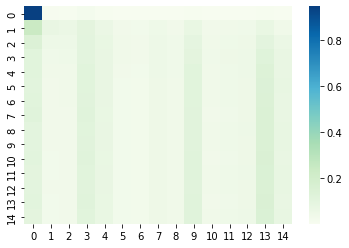

 16%|█▋        | 4.883268482490256/30 [03:26<35:57, 85.91s/it]

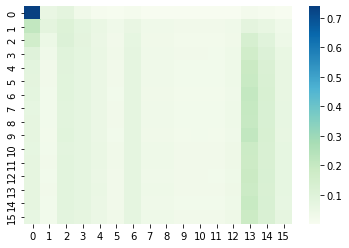

 16%|█▋        | 4.8871595330739135/30 [03:26<34:59, 83.61s/it]

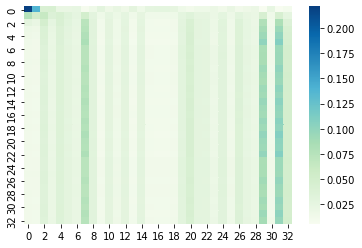

 16%|█▋        | 4.891050583657571/30 [03:26<35:17, 84.33s/it] 

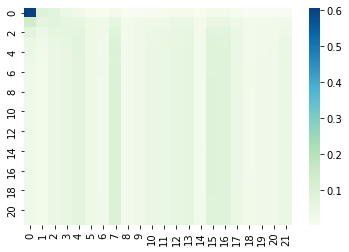

 16%|█▋        | 4.894941634241229/30 [03:27<34:57, 83.54s/it]

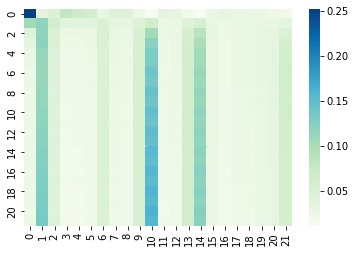

 16%|█▋        | 4.898832684824886/30 [03:27<35:00, 83.69s/it]

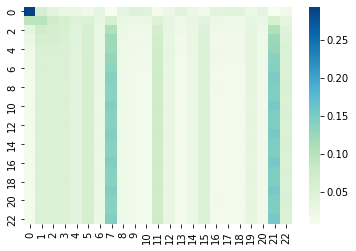

 16%|█▋        | 4.902723735408544/30 [03:27<34:23, 82.21s/it]

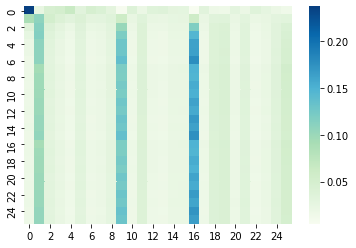

 16%|█▋        | 4.906614785992201/30 [03:28<33:38, 80.45s/it]

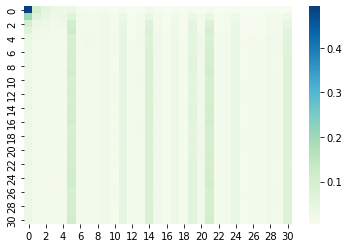

 16%|█▋        | 4.910505836575859/30 [03:28<33:33, 80.25s/it]

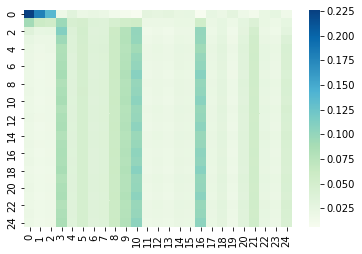

 16%|█▋        | 4.9143968871595165/30 [03:28<34:12, 81.83s/it]

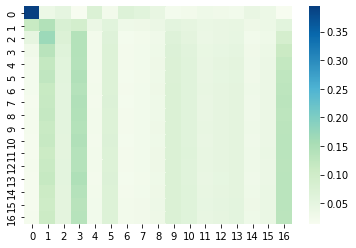

 16%|█▋        | 4.918287937743174/30 [03:29<33:59, 81.30s/it] 

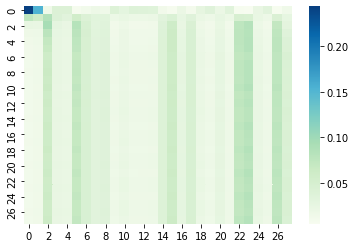

 16%|█▋        | 4.922178988326832/30 [03:29<33:40, 80.55s/it]

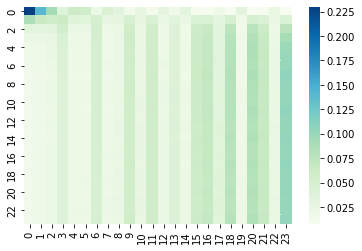

 16%|█▋        | 4.926070038910489/30 [03:29<38:12, 91.41s/it]

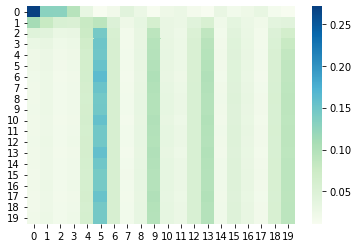

 16%|█▋        | 4.929961089494147/30 [03:30<37:51, 90.60s/it]

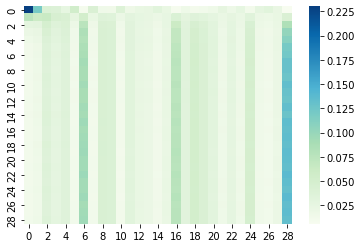

 16%|█▋        | 4.933852140077804/30 [03:30<36:07, 86.47s/it]

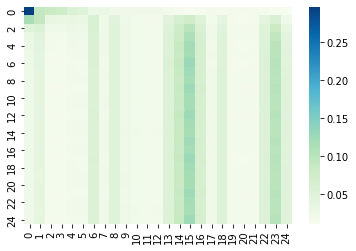

 16%|█▋        | 4.937743190661462/30 [03:30<36:12, 86.68s/it]

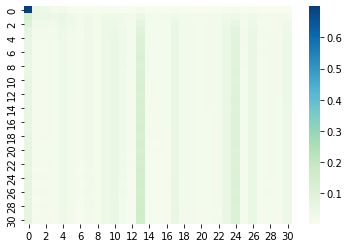

 16%|█▋        | 4.9416342412451195/30 [03:31<35:40, 85.43s/it]

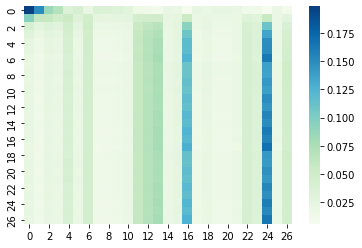

 16%|█▋        | 4.945525291828777/30 [03:31<34:12, 81.90s/it] 

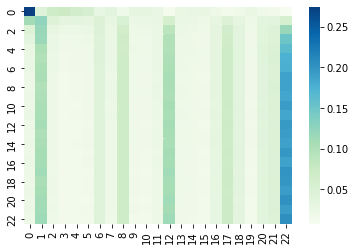

 16%|█▋        | 4.949416342412435/30 [03:31<34:37, 82.94s/it]

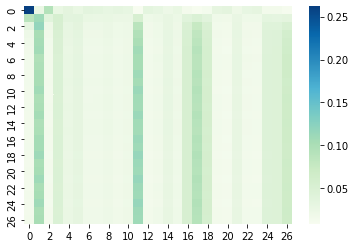

 17%|█▋        | 4.953307392996092/30 [03:32<34:11, 81.92s/it]

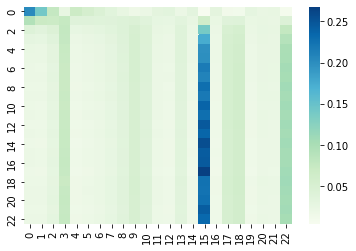

 17%|█▋        | 4.95719844357975/30 [03:32<34:41, 83.13s/it] 

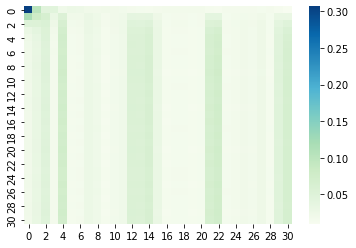

 17%|█▋        | 4.961089494163407/30 [03:32<34:07, 81.77s/it]

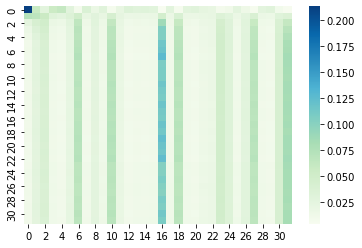

 17%|█▋        | 4.964980544747065/30 [03:33<33:43, 80.81s/it]

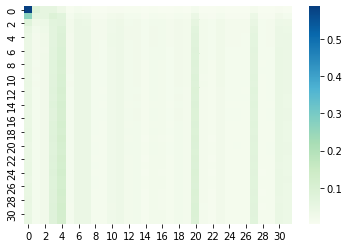

 17%|█▋        | 4.9688715953307225/30 [03:33<36:18, 87.03s/it]

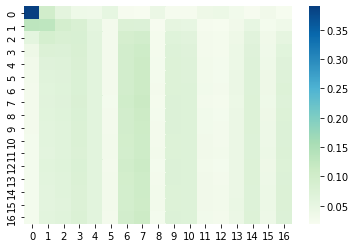

 17%|█▋        | 4.97276264591438/30 [03:33<36:55, 88.52s/it]  

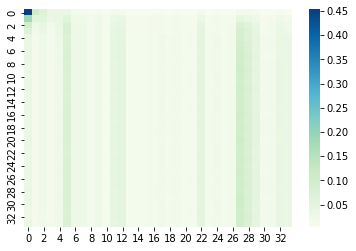

 17%|█▋        | 4.976653696498038/30 [03:34<36:58, 88.64s/it]

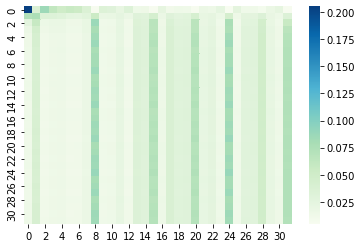

 17%|█▋        | 4.980544747081695/30 [03:34<38:21, 91.99s/it]

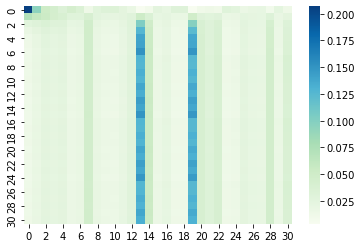

 17%|█▋        | 4.984435797665353/30 [03:34<42:47, 102.64s/it]

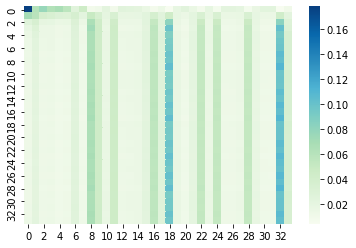

 17%|█▋        | 4.98832684824901/30 [03:35<44:34, 106.95s/it] 

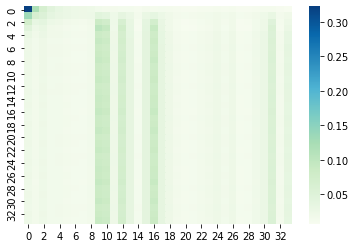

 17%|█▋        | 4.992217898832668/30 [03:35<45:07, 108.27s/it]

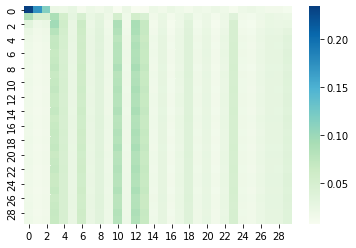

 17%|█▋        | 4.9961089494163256/30 [03:36<44:21, 106.46s/it]

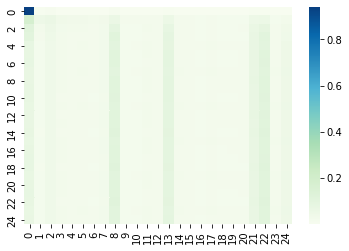

 17%|█▋        | 4.999999999999983/30 [03:36<44:51, 107.68s/it] 

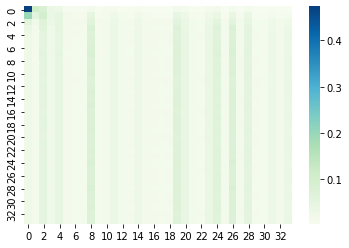

 19%|█▊        | 5.61478599221788/30 [03:50<09:10, 22.55s/it] 

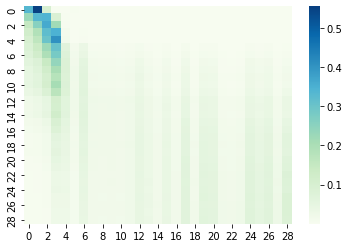

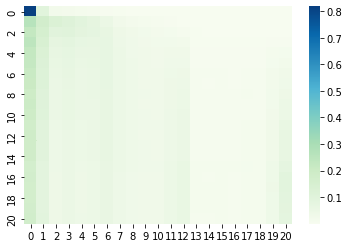

 19%|█▊        | 5.622568093385195/30 [03:51<18:04, 44.47s/it]

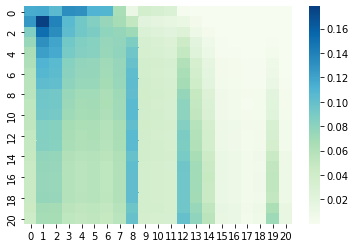

 19%|█▉        | 5.6264591439688525/30 [03:51<20:51, 51.36s/it]

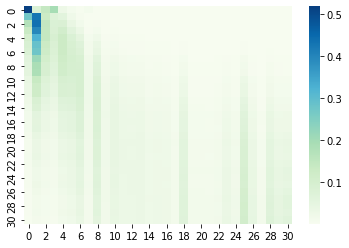

 19%|█▉        | 5.63035019455251/30 [03:51<22:44, 56.00s/it]  

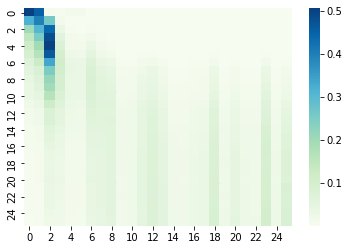

 19%|█▉        | 5.634241245136168/30 [03:52<24:33, 60.48s/it]

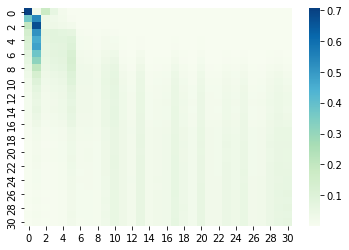

 19%|█▉        | 5.638132295719825/30 [03:52<26:04, 64.22s/it]

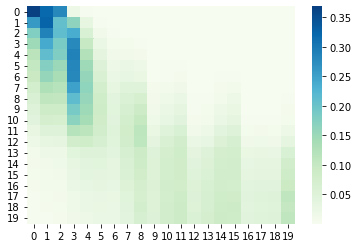

 19%|█▉        | 5.642023346303483/30 [03:52<28:58, 71.36s/it]

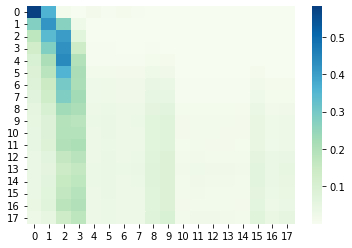

 19%|█▉        | 5.64591439688714/30 [03:53<30:23, 74.86s/it] 

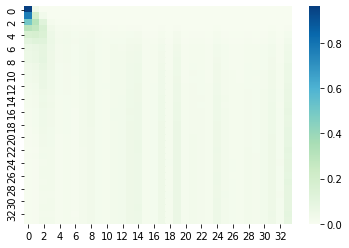

 19%|█▉        | 5.649805447470798/30 [03:53<30:36, 75.41s/it]

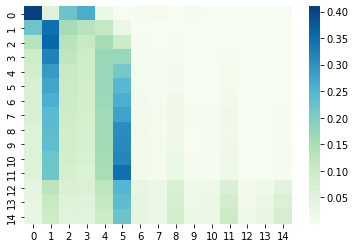

 19%|█▉        | 5.6536964980544555/30 [03:53<31:09, 76.78s/it]

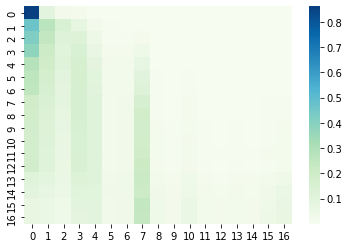

 19%|█▉        | 5.657587548638113/30 [03:54<33:01, 81.38s/it] 

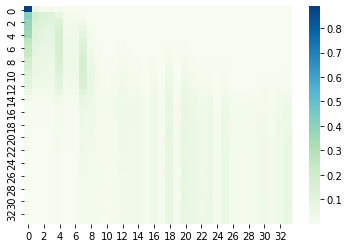

 19%|█▉        | 5.661478599221771/30 [03:54<33:10, 81.79s/it]

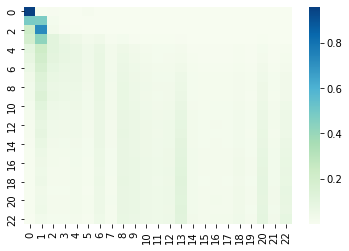

 19%|█▉        | 5.665369649805428/30 [03:54<36:33, 90.15s/it]

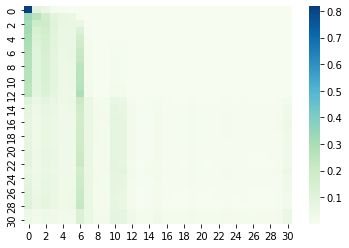

 19%|█▉        | 5.669260700389086/30 [03:55<35:32, 87.64s/it]

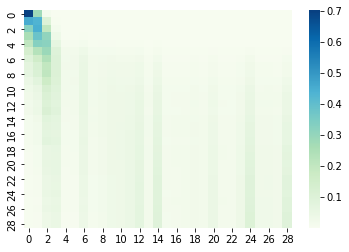

 19%|█▉        | 5.673151750972743/30 [03:55<34:17, 84.56s/it]

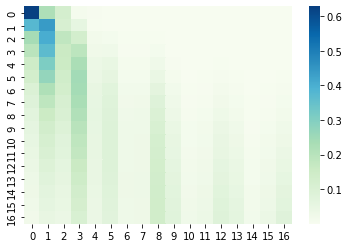

 19%|█▉        | 5.677042801556401/30 [03:55<33:58, 83.82s/it]

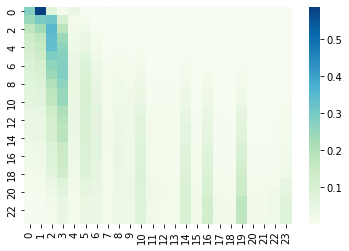

 19%|█▉        | 5.6809338521400585/30 [03:56<34:11, 84.36s/it]

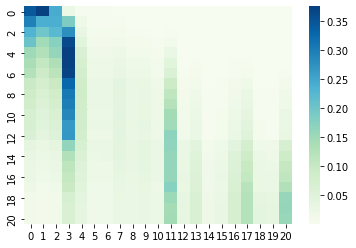

 19%|█▉        | 5.684824902723716/30 [03:56<33:33, 82.81s/it] 

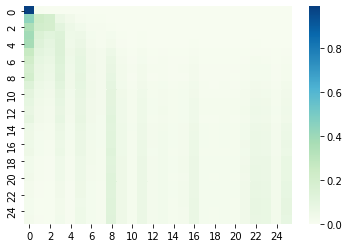

 19%|█▉        | 5.688715953307374/30 [03:56<32:55, 81.27s/it]

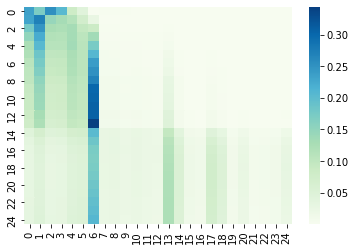

 19%|█▉        | 5.692607003891031/30 [03:56<33:26, 82.56s/it]

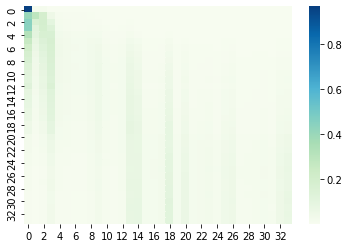

 19%|█▉        | 5.696498054474689/30 [03:57<33:36, 82.98s/it]

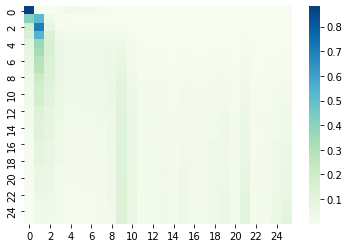

 19%|█▉        | 5.700389105058346/30 [03:57<33:08, 81.82s/it]

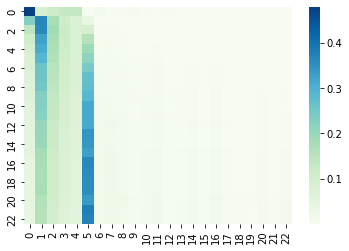

 19%|█▉        | 5.704280155642004/30 [03:57<33:22, 82.41s/it]

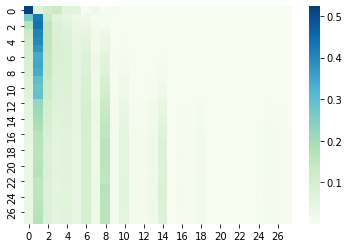

 19%|█▉        | 5.7081712062256615/30 [03:58<35:30, 87.72s/it]

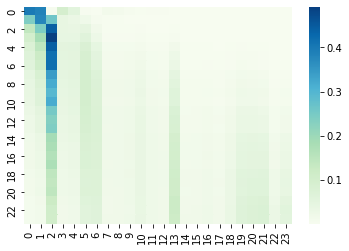

 19%|█▉        | 5.712062256809319/30 [03:58<35:00, 86.48s/it] 

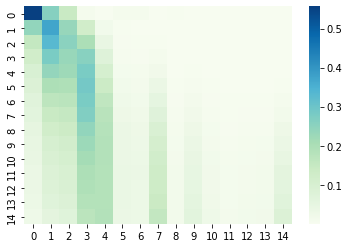

 19%|█▉        | 5.715953307392977/30 [03:58<34:22, 84.94s/it]

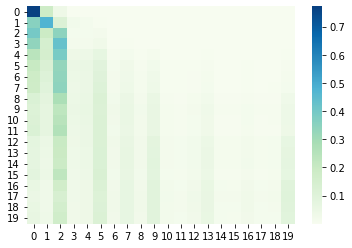

 19%|█▉        | 5.719844357976634/30 [03:59<35:17, 87.23s/it]

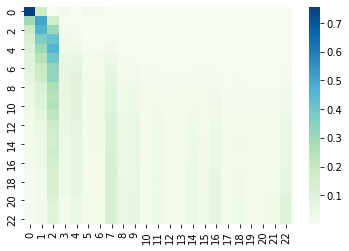

 19%|█▉        | 5.723735408560292/30 [03:59<34:43, 85.81s/it]

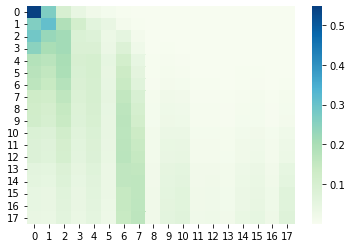

 19%|█▉        | 5.727626459143949/30 [03:59<34:32, 85.39s/it]

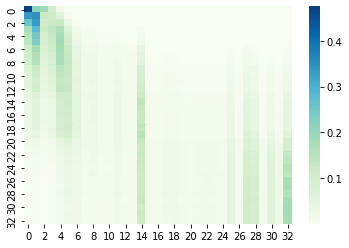

 19%|█▉        | 5.731517509727607/30 [04:00<34:28, 85.24s/it]

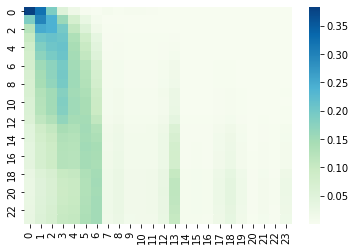

 19%|█▉        | 5.735408560311265/30 [04:00<35:11, 87.04s/it]

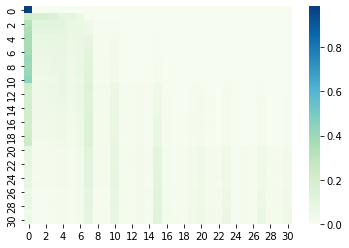

 19%|█▉        | 5.739299610894922/30 [04:01<34:39, 85.73s/it]

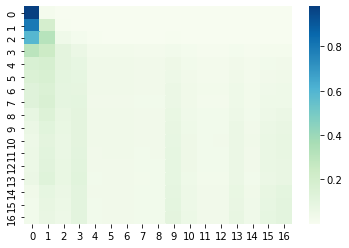

 19%|█▉        | 5.74319066147858/30 [04:01<34:01, 84.15s/it] 

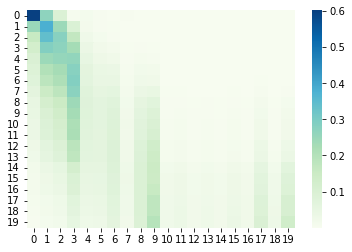

 19%|█▉        | 5.747081712062237/30 [04:01<34:56, 86.45s/it]

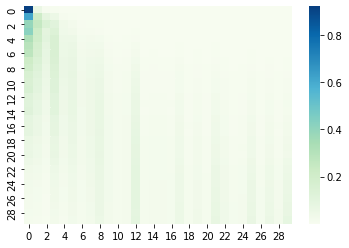

 19%|█▉        | 5.750972762645895/30 [04:02<37:14, 92.16s/it]

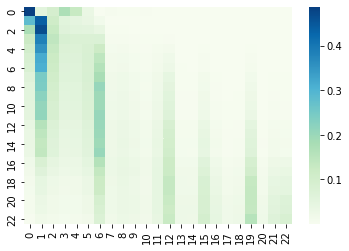

 19%|█▉        | 5.754863813229552/30 [04:02<36:13, 89.66s/it]

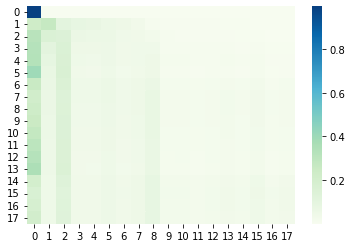

 19%|█▉        | 5.75875486381321/30 [04:02<36:27, 90.25s/it] 

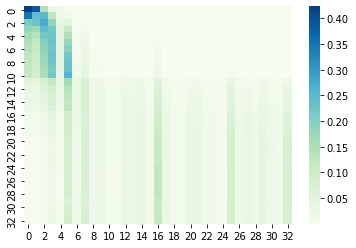

 19%|█▉        | 5.762645914396868/30 [04:03<35:29, 87.87s/it]

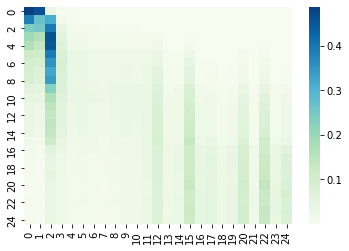

 19%|█▉        | 5.766536964980525/30 [04:03<35:21, 87.53s/it]

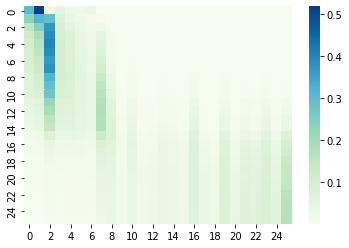

 19%|█▉        | 5.770428015564183/30 [04:03<34:08, 84.54s/it]

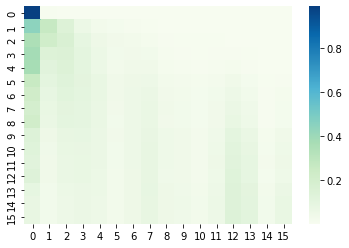

 19%|█▉        | 5.77431906614784/30 [04:04<33:28, 82.89s/it] 

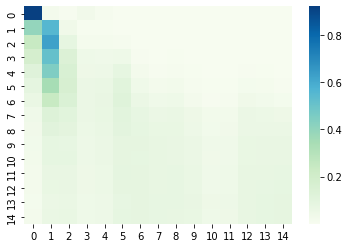

 19%|█▉        | 5.778210116731498/30 [04:04<33:06, 82.03s/it]

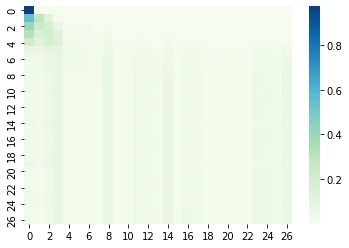

 19%|█▉        | 5.782101167315155/30 [04:04<32:24, 80.30s/it]

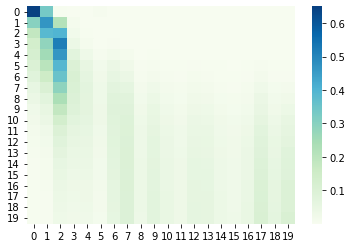

 19%|█▉        | 5.785992217898813/30 [04:05<34:25, 85.32s/it]

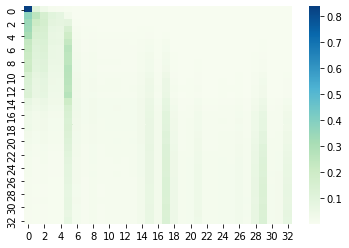

 19%|█▉        | 5.789883268482471/30 [04:05<34:17, 84.98s/it]

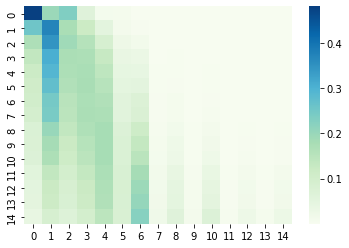

 19%|█▉        | 5.793774319066128/30 [04:05<37:16, 92.39s/it]

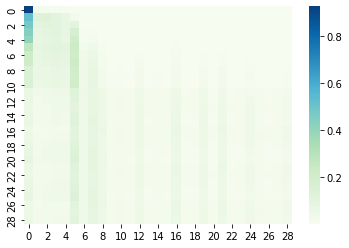

 19%|█▉        | 5.797665369649786/30 [04:06<34:50, 86.39s/it]

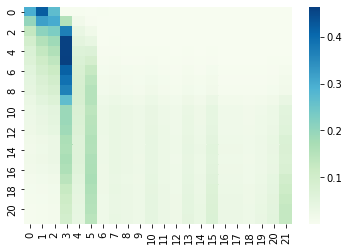

 19%|█▉        | 5.801556420233443/30 [04:06<34:51, 86.41s/it]

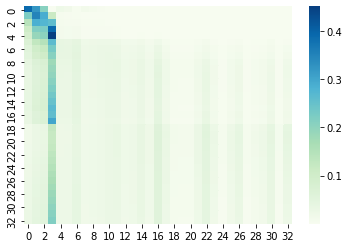

 19%|█▉        | 5.805447470817101/30 [04:06<34:12, 84.85s/it]

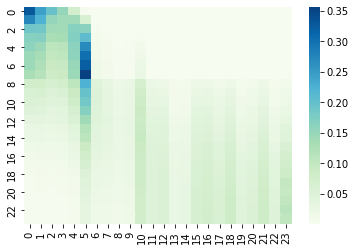

 19%|█▉        | 5.8093385214007585/30 [04:07<34:59, 86.79s/it]

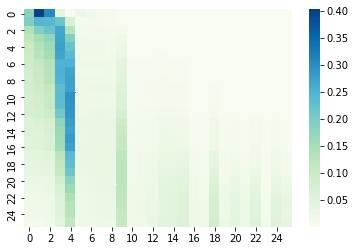

 19%|█▉        | 5.813229571984416/30 [04:07<34:12, 84.84s/it] 

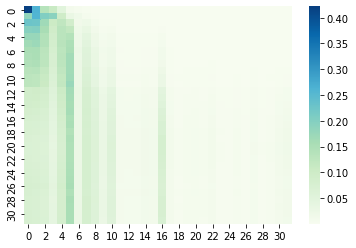

 19%|█▉        | 5.817120622568074/30 [04:07<34:12, 84.88s/it]

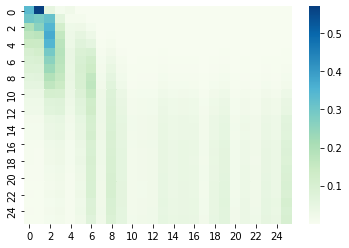

 19%|█▉        | 5.821011673151731/30 [04:07<32:42, 81.15s/it]

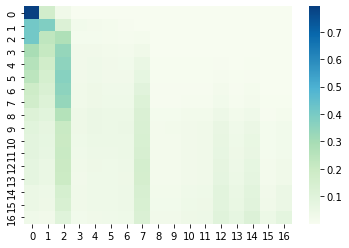

 19%|█▉        | 5.824902723735389/30 [04:08<33:19, 82.70s/it]

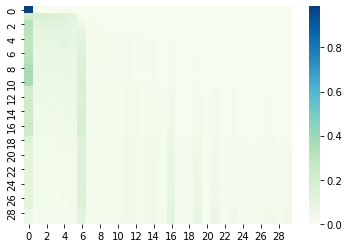

 19%|█▉        | 5.828793774319046/30 [04:08<32:24, 80.45s/it]

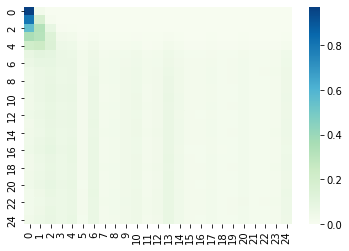

 19%|█▉        | 5.832684824902704/30 [04:09<34:33, 85.81s/it]

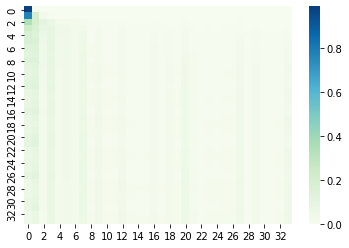

 19%|█▉        | 5.8365758754863615/30 [04:09<37:02, 91.98s/it]

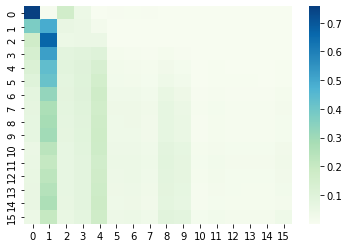

 19%|█▉        | 5.840466926070019/30 [04:09<35:42, 88.68s/it] 

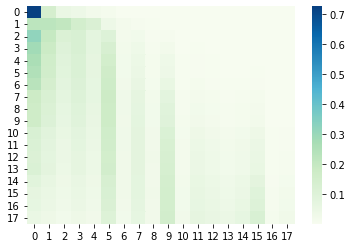

 19%|█▉        | 5.844357976653677/30 [04:10<35:10, 87.38s/it]

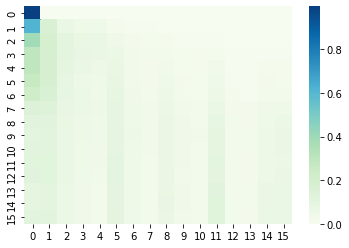

 19%|█▉        | 5.848249027237334/30 [04:10<34:47, 86.44s/it]

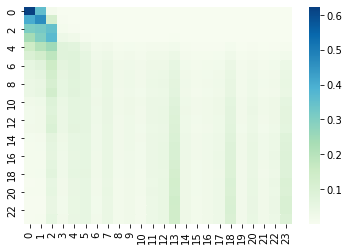

 20%|█▉        | 5.852140077820992/30 [04:10<35:24, 88.00s/it]

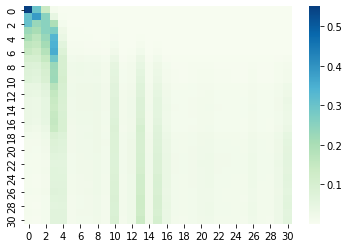

 20%|█▉        | 5.856031128404649/30 [04:11<35:38, 88.59s/it]

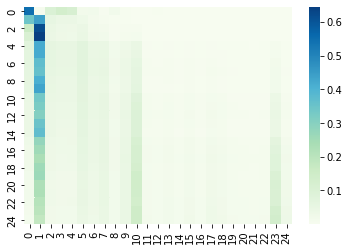

 20%|█▉        | 5.859922178988307/30 [04:11<35:31, 88.30s/it]

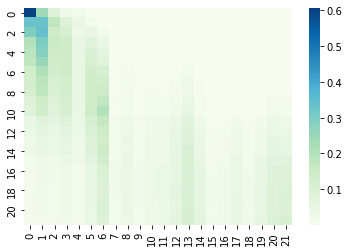

 20%|█▉        | 5.8638132295719645/30 [04:11<35:03, 87.17s/it]

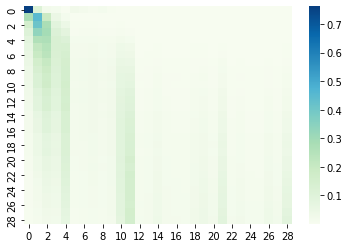

 20%|█▉        | 5.867704280155622/30 [04:12<35:16, 87.72s/it] 

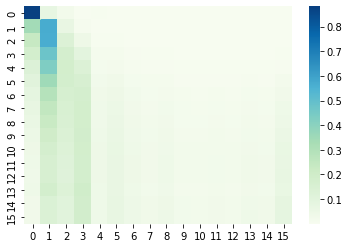

 20%|█▉        | 5.87159533073928/30 [04:12<34:01, 84.62s/it] 

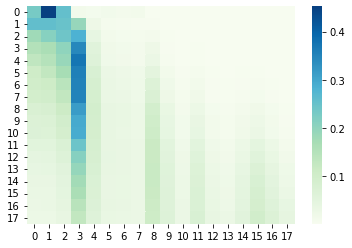

 20%|█▉        | 5.875486381322937/30 [04:12<33:25, 83.11s/it]

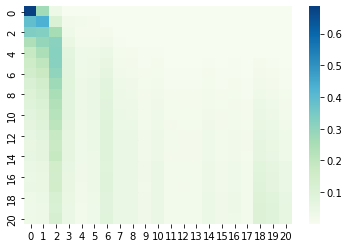

 20%|█▉        | 5.879377431906595/30 [04:13<36:42, 91.31s/it]

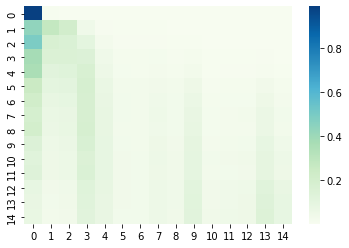

 20%|█▉        | 5.883268482490252/30 [04:13<35:00, 87.11s/it]

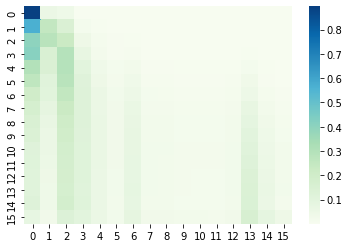

 20%|█▉        | 5.88715953307391/30 [04:13<34:50, 86.71s/it] 

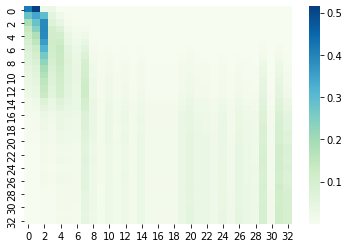

 20%|█▉        | 5.8910505836575675/30 [04:14<34:45, 86.51s/it]

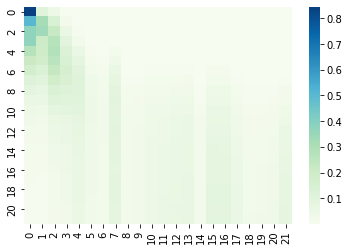

 20%|█▉        | 5.894941634241225/30 [04:14<34:44, 86.46s/it] 

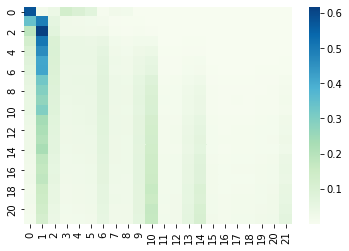

 20%|█▉        | 5.898832684824883/30 [04:14<34:47, 86.62s/it]

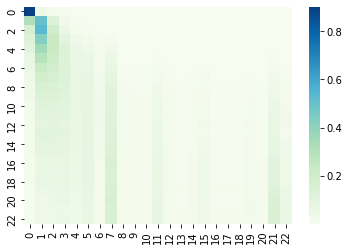

 20%|█▉        | 5.90272373540854/30 [04:15<35:40, 88.81s/it] 

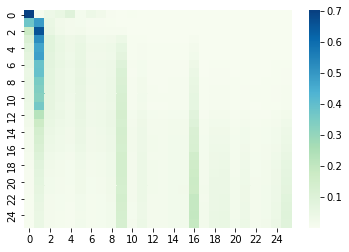

 20%|█▉        | 5.906614785992198/30 [04:15<34:36, 86.19s/it]

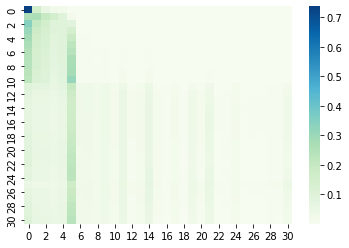

 20%|█▉        | 5.910505836575855/30 [04:15<34:22, 85.60s/it]

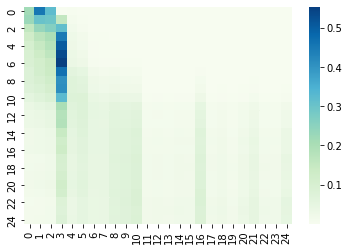

 20%|█▉        | 5.914396887159513/30 [04:16<34:18, 85.47s/it]

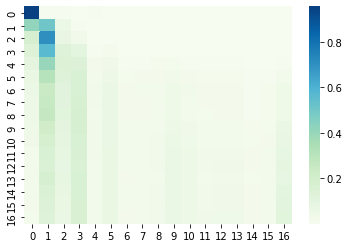

 20%|█▉        | 5.9182879377431705/30 [04:16<33:22, 83.14s/it]

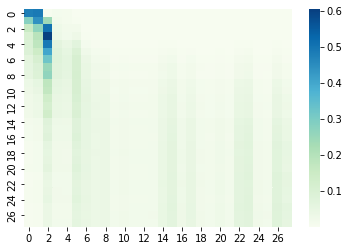

 20%|█▉        | 5.922178988326828/30 [04:16<35:40, 88.91s/it] 

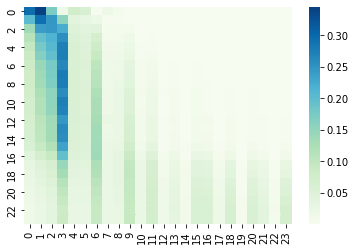

 20%|█▉        | 5.926070038910486/30 [04:17<36:10, 90.17s/it]

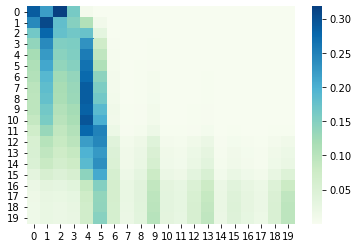

 20%|█▉        | 5.929961089494143/30 [04:17<35:55, 89.57s/it]

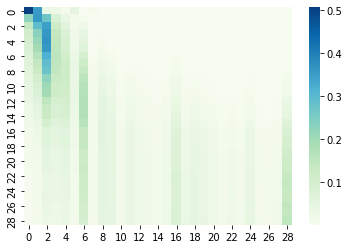

 20%|█▉        | 5.933852140077801/30 [04:17<34:22, 85.69s/it]

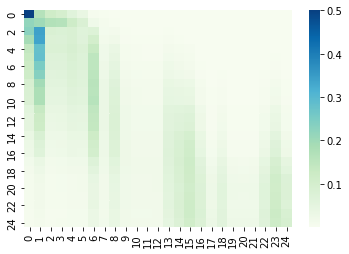

 20%|█▉        | 5.937743190661458/30 [04:18<35:21, 88.15s/it]

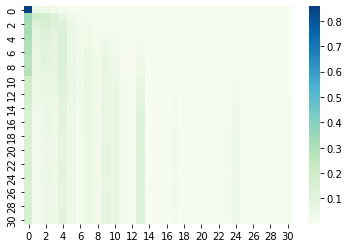

 20%|█▉        | 5.941634241245116/30 [04:18<35:06, 87.56s/it]

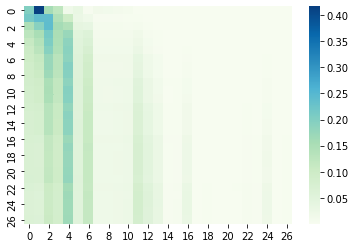

 20%|█▉        | 5.9455252918287735/30 [04:18<34:28, 86.00s/it]

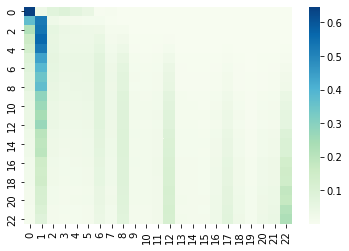

 20%|█▉        | 5.949416342412431/30 [04:19<35:25, 88.39s/it] 

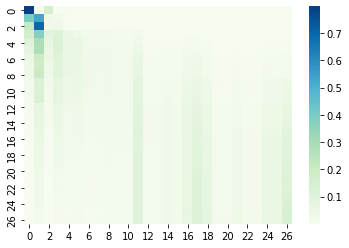

 20%|█▉        | 5.953307392996089/30 [04:19<33:35, 83.83s/it]

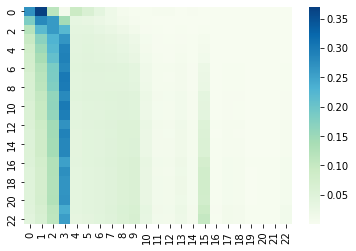

 20%|█▉        | 5.957198443579746/30 [04:19<34:10, 85.29s/it]

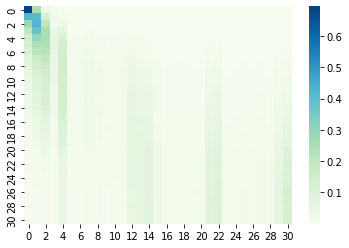

 20%|█▉        | 5.961089494163404/30 [04:20<34:22, 85.81s/it]

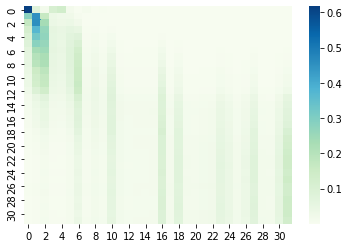

 20%|█▉        | 5.964980544747061/30 [04:20<37:41, 94.09s/it]

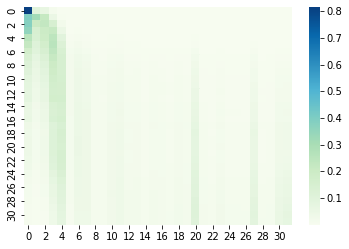

 20%|█▉        | 5.968871595330719/30 [04:20<36:11, 90.36s/it]

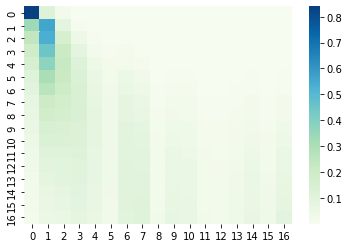

 20%|█▉        | 5.9727626459143766/30 [04:21<36:16, 90.58s/it]

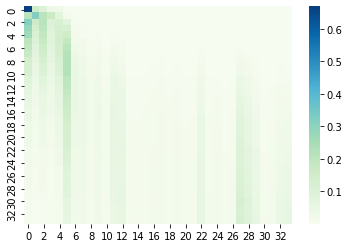

 20%|█▉        | 5.976653696498034/30 [04:21<35:32, 88.78s/it] 

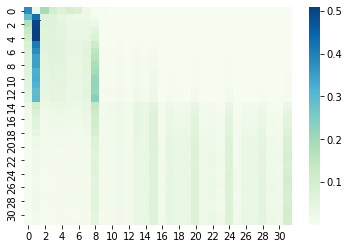

 20%|█▉        | 5.980544747081692/30 [04:21<35:07, 87.75s/it]

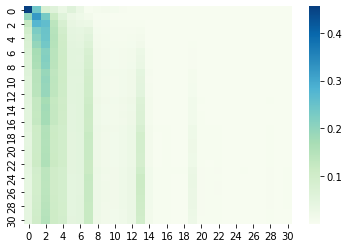

 20%|█▉        | 5.984435797665349/30 [04:22<34:18, 85.71s/it]

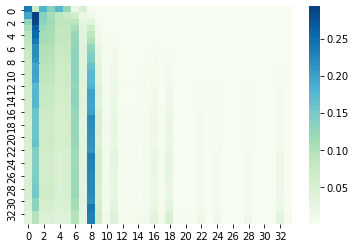

 20%|█▉        | 5.988326848249007/30 [04:22<34:16, 85.66s/it]

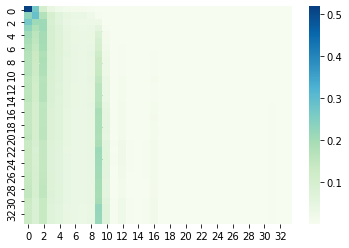

 20%|█▉        | 5.992217898832664/30 [04:22<34:29, 86.20s/it]

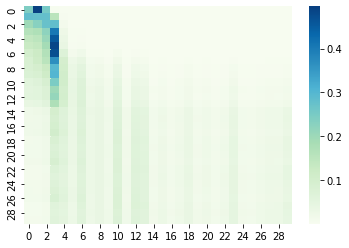

 20%|█▉        | 5.996108949416322/30 [04:23<33:56, 84.85s/it]

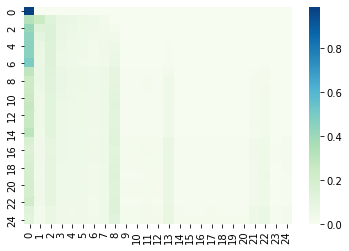

 20%|█▉        | 5.99999999999998/30 [04:23<34:20, 85.85s/it] 

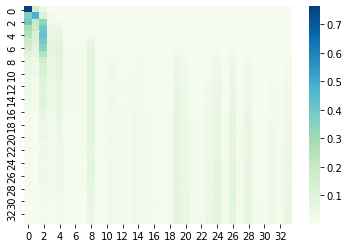

 22%|██▏       | 6.610894941634219/30 [04:36<07:31, 19.29s/it] 

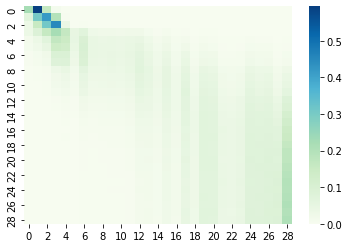

 22%|██▏       | 6.618677042801534/30 [04:37<12:19, 31.63s/it]

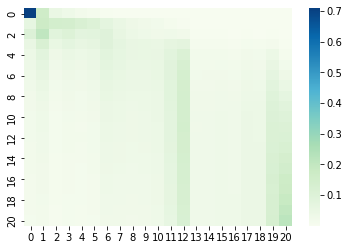

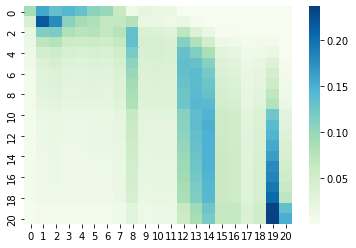

 22%|██▏       | 6.626459143968849/30 [04:37<17:51, 45.85s/it]

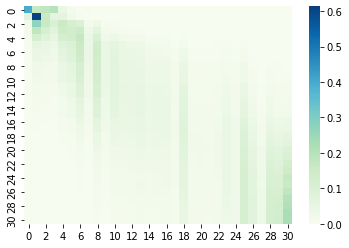

 22%|██▏       | 6.6303501945525065/30 [04:38<21:48, 55.99s/it]

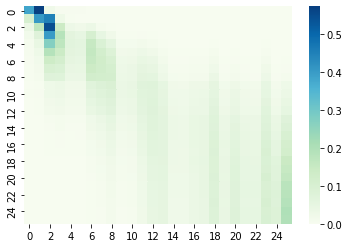

 22%|██▏       | 6.634241245136164/30 [04:38<25:48, 66.26s/it] 

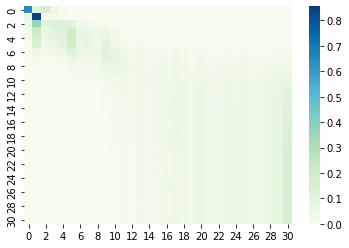

 22%|██▏       | 6.638132295719822/30 [04:39<29:32, 75.88s/it]

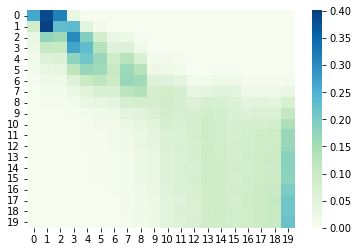

 22%|██▏       | 6.642023346303479/30 [04:39<33:43, 86.63s/it]

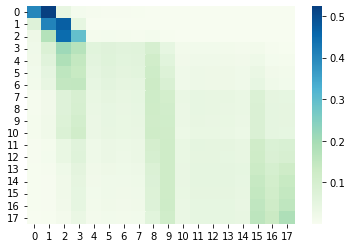

 22%|██▏       | 6.645914396887137/30 [04:39<36:55, 94.87s/it]

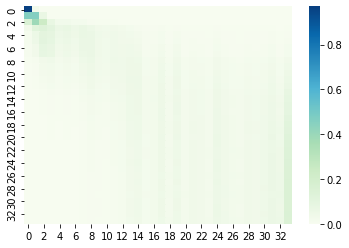

 22%|██▏       | 6.649805447470794/30 [04:40<37:46, 97.08s/it]

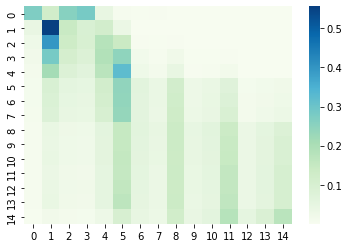

 22%|██▏       | 6.653696498054452/30 [04:40<36:56, 94.95s/it]

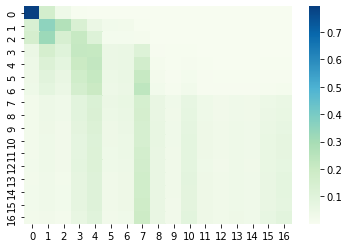

 22%|██▏       | 6.6575875486381095/30 [04:41<39:09, 100.63s/it]

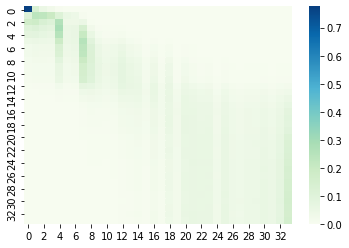

 22%|██▏       | 6.661478599221767/30 [04:41<45:58, 118.19s/it] 

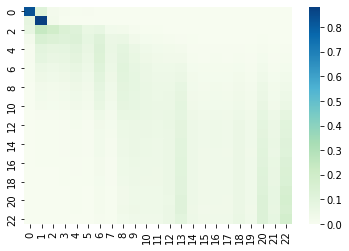

 22%|██▏       | 6.665369649805425/30 [04:42<45:22, 116.68s/it]

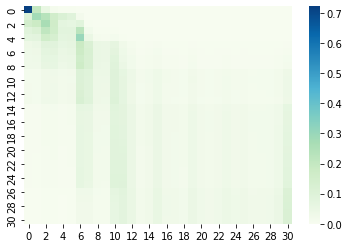

 22%|██▏       | 6.669260700389082/30 [04:42<45:31, 117.08s/it]

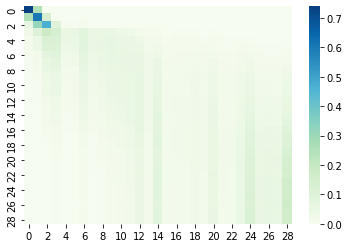

 22%|██▏       | 6.67315175097274/30 [04:43<44:28, 114.39s/it] 

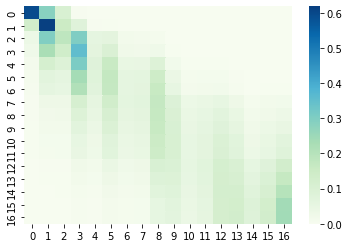

 22%|██▏       | 6.677042801556397/30 [04:43<44:54, 115.55s/it]

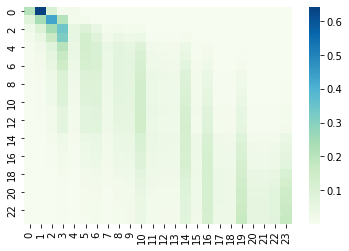

 22%|██▏       | 6.680933852140055/30 [04:43<42:44, 109.98s/it]

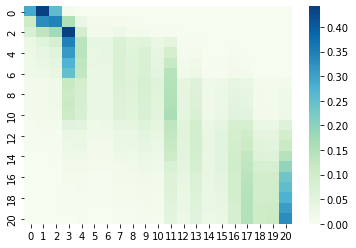

 22%|██▏       | 6.6848249027237125/30 [04:44<39:51, 102.58s/it]

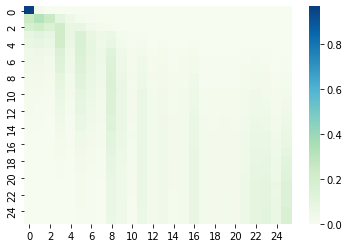

 22%|██▏       | 6.68871595330737/30 [04:44<36:19, 93.49s/it]   

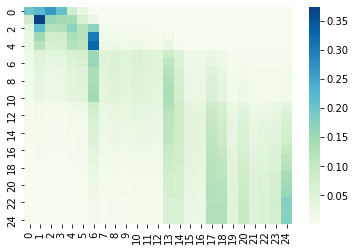

 22%|██▏       | 6.692607003891028/30 [04:44<37:22, 96.20s/it]

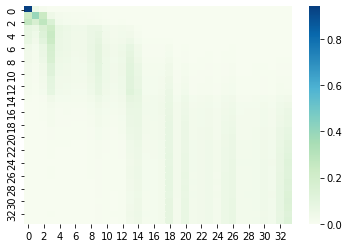

 22%|██▏       | 6.696498054474685/30 [04:45<36:37, 94.29s/it]

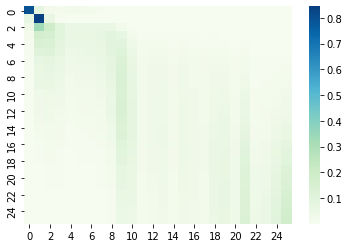

 22%|██▏       | 6.700389105058343/30 [04:45<34:53, 89.86s/it]

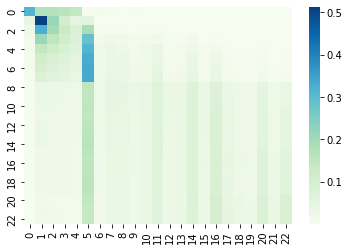

 22%|██▏       | 6.704280155642/30 [04:46<37:52, 97.57s/it]   

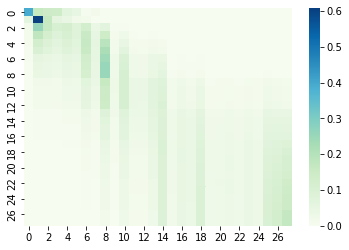

 22%|██▏       | 6.708171206225658/30 [04:46<35:58, 92.68s/it]

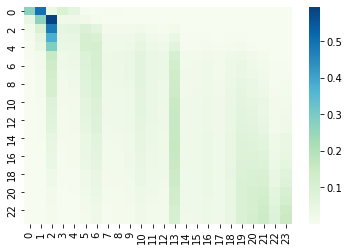

 22%|██▏       | 6.712062256809316/30 [04:46<35:21, 91.10s/it]

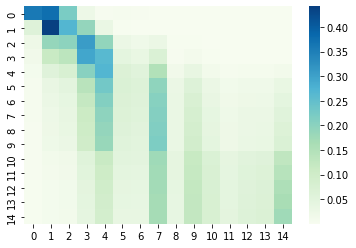

 22%|██▏       | 6.715953307392973/30 [04:47<33:59, 87.58s/it]

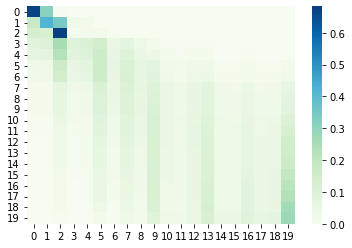

 22%|██▏       | 6.719844357976631/30 [04:47<35:27, 91.39s/it]

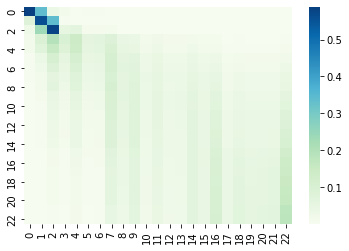

 22%|██▏       | 6.723735408560288/30 [04:47<34:17, 88.39s/it]

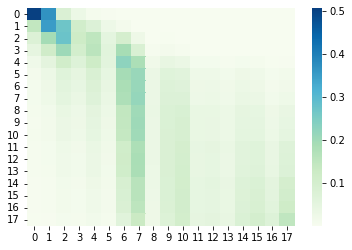

 22%|██▏       | 6.727626459143946/30 [04:48<34:44, 89.55s/it]

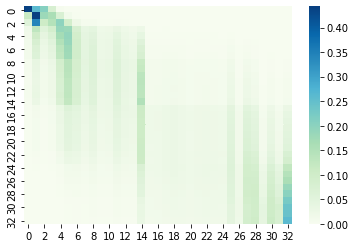

 22%|██▏       | 6.731517509727603/30 [04:48<35:07, 90.57s/it]

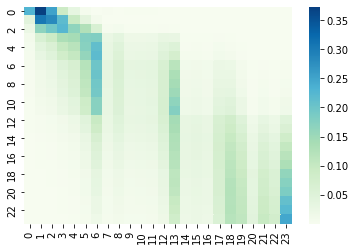

 22%|██▏       | 6.735408560311261/30 [04:48<35:05, 90.52s/it]

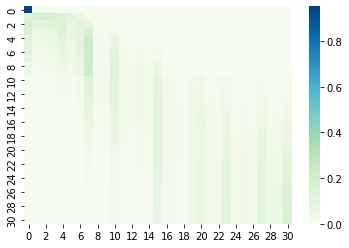

 22%|██▏       | 6.739299610894919/30 [04:49<34:12, 88.25s/it]

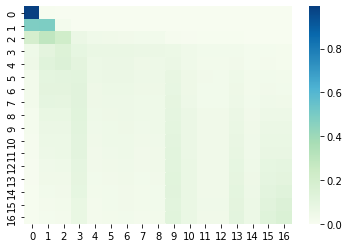

 22%|██▏       | 6.743190661478576/30 [04:49<33:41, 86.93s/it]

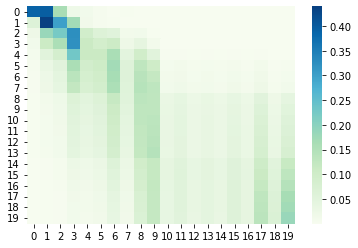

 22%|██▏       | 6.747081712062234/30 [04:49<37:02, 95.57s/it]

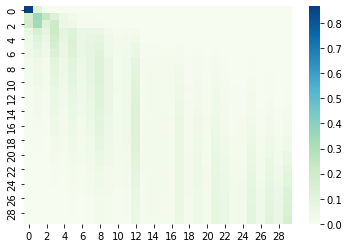

 23%|██▎       | 6.750972762645891/30 [04:50<35:35, 91.87s/it]

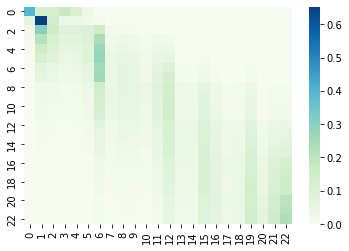

 23%|██▎       | 6.754863813229549/30 [04:50<35:00, 90.35s/it]

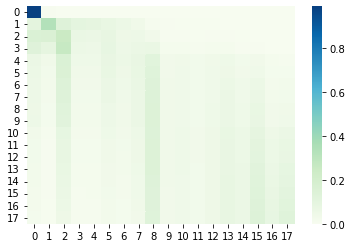

 23%|██▎       | 6.7587548638132064/30 [04:50<34:17, 88.52s/it]

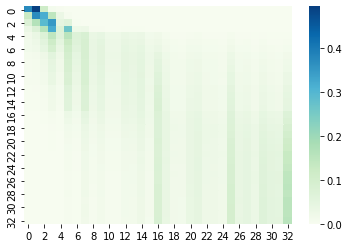

 23%|██▎       | 6.762645914396864/30 [04:51<34:35, 89.30s/it] 

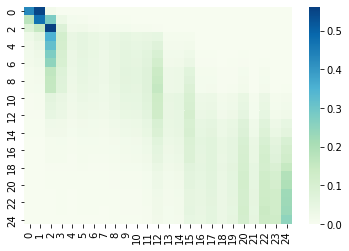

 23%|██▎       | 6.766536964980522/30 [04:51<34:38, 89.46s/it]

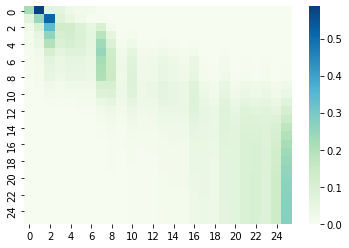

 23%|██▎       | 6.770428015564179/30 [04:51<33:05, 85.47s/it]

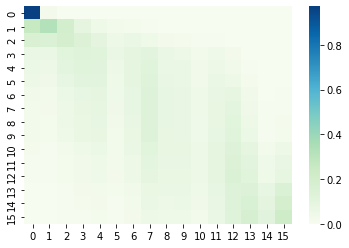

 23%|██▎       | 6.774319066147837/30 [04:52<32:20, 83.54s/it]

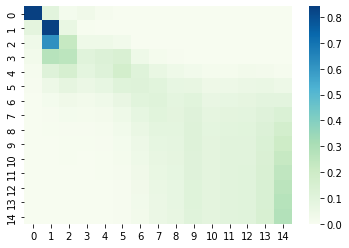

 23%|██▎       | 6.778210116731494/30 [04:52<32:53, 84.97s/it]

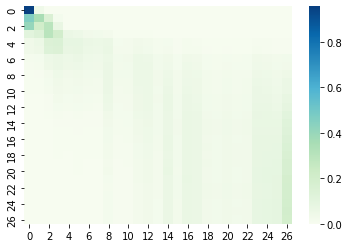

 23%|██▎       | 6.782101167315152/30 [04:52<32:47, 84.73s/it]

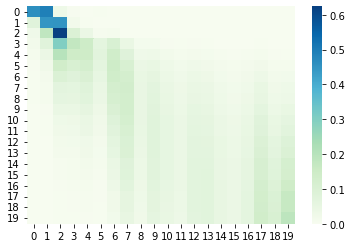

 23%|██▎       | 6.7859922178988095/30 [04:53<34:05, 88.12s/it]

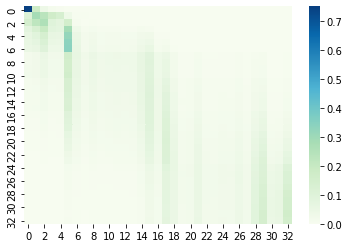

 23%|██▎       | 6.789883268482467/30 [04:53<36:52, 95.32s/it] 

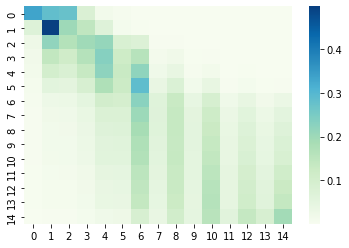

 23%|██▎       | 6.793774319066125/30 [04:54<35:16, 91.19s/it]

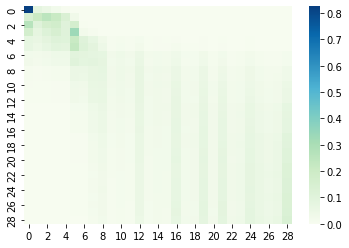

 23%|██▎       | 6.797665369649782/30 [04:54<34:18, 88.70s/it]

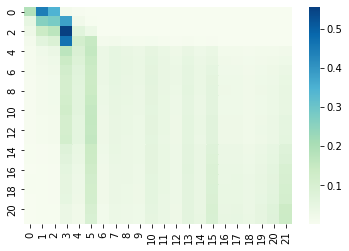

 23%|██▎       | 6.80155642023344/30 [04:54<33:57, 87.83s/it] 

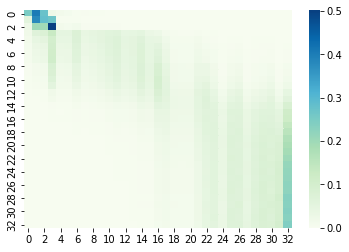

 23%|██▎       | 6.805447470817097/30 [04:54<32:54, 85.15s/it]

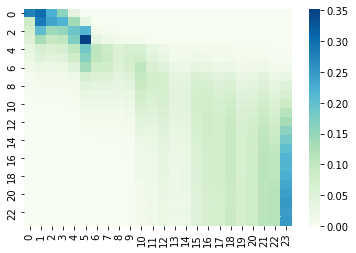

 23%|██▎       | 6.809338521400755/30 [04:55<33:22, 86.35s/it]

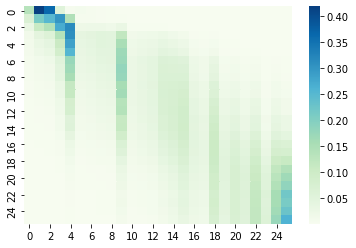

 23%|██▎       | 6.8132295719844125/30 [04:55<32:45, 84.76s/it]

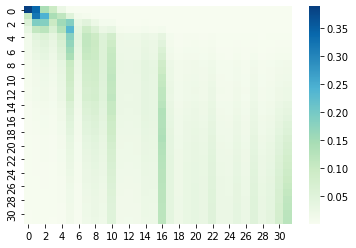

 23%|██▎       | 6.81712062256807/30 [04:55<32:25, 83.92s/it]  

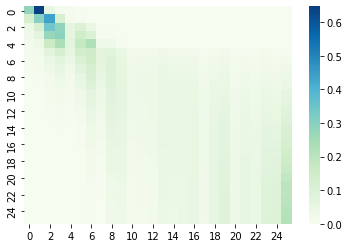

 23%|██▎       | 6.821011673151728/30 [04:56<31:15, 80.90s/it]

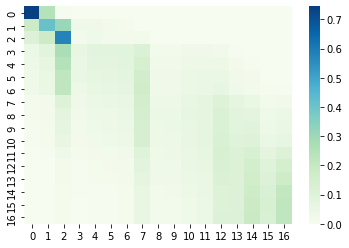

 23%|██▎       | 6.824902723735385/30 [04:56<32:12, 83.39s/it]

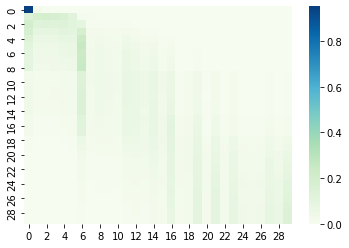

 23%|██▎       | 6.828793774319043/30 [04:56<32:30, 84.18s/it]

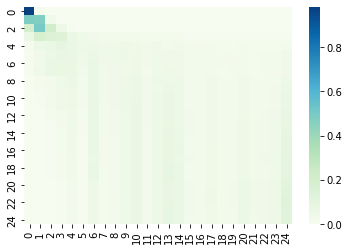

 23%|██▎       | 6.8326848249027/30 [04:57<36:03, 93.40s/it]  

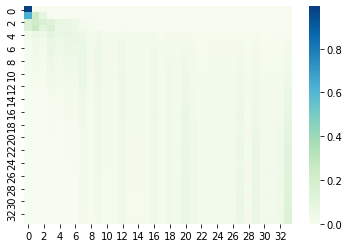

 23%|██▎       | 6.836575875486358/30 [04:57<34:35, 89.61s/it]

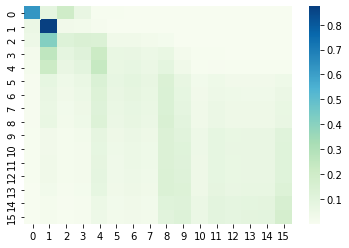

 23%|██▎       | 6.8404669260700155/30 [04:58<33:54, 87.86s/it]

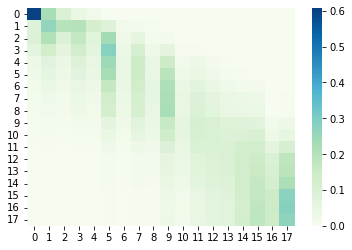

 23%|██▎       | 6.844357976653673/30 [04:58<34:12, 88.62s/it] 

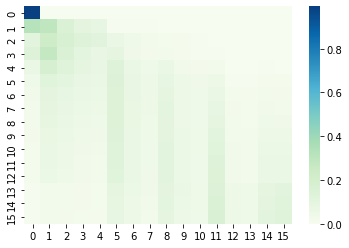

 23%|██▎       | 6.848249027237331/30 [04:58<33:42, 87.37s/it]

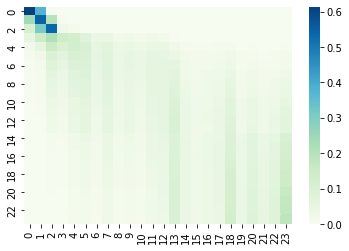

 23%|██▎       | 6.852140077820988/30 [04:59<34:38, 89.79s/it]

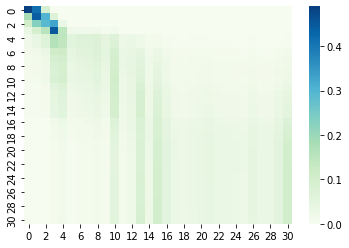

 23%|██▎       | 6.856031128404646/30 [04:59<34:10, 88.61s/it]

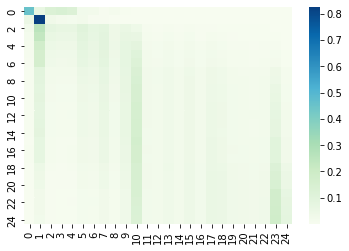

 23%|██▎       | 6.859922178988303/30 [04:59<35:10, 91.18s/it]

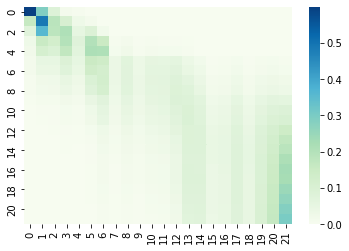

 23%|██▎       | 6.863813229571961/30 [05:00<34:16, 88.91s/it]

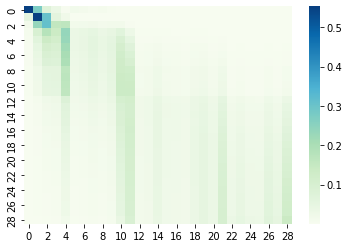

 23%|██▎       | 6.8677042801556185/30 [05:00<32:30, 84.34s/it]

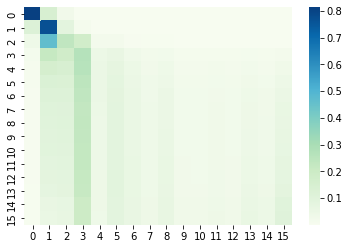

 23%|██▎       | 6.871595330739276/30 [05:00<32:51, 85.26s/it] 

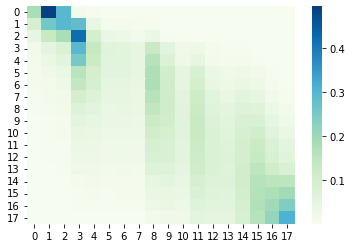

 23%|██▎       | 6.875486381322934/30 [05:01<36:07, 93.73s/it]

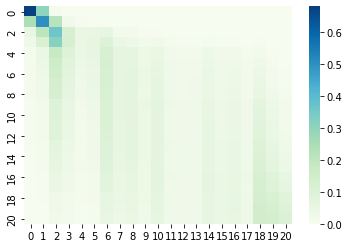

 23%|██▎       | 6.879377431906591/30 [05:01<35:02, 90.96s/it]

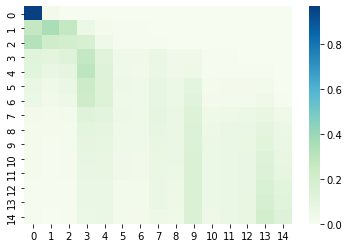

 23%|██▎       | 6.883268482490249/30 [05:01<34:52, 90.50s/it]

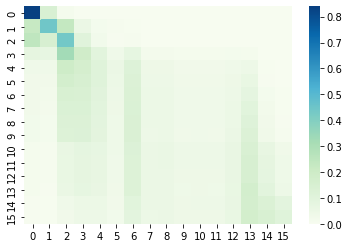

 23%|██▎       | 6.887159533073906/30 [05:02<34:38, 89.93s/it]

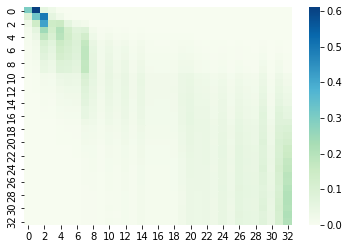

 23%|██▎       | 6.891050583657564/30 [05:02<34:05, 88.53s/it]

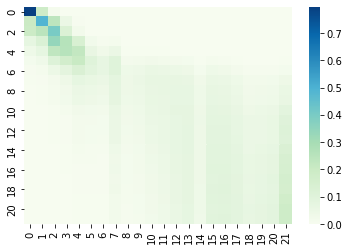

 23%|██▎       | 6.8949416342412215/30 [05:02<34:23, 89.32s/it]

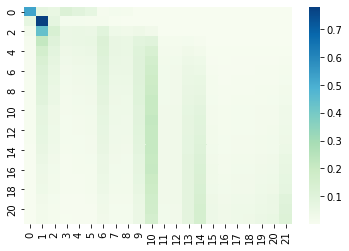

 23%|██▎       | 6.898832684824879/30 [05:03<34:58, 90.84s/it] 

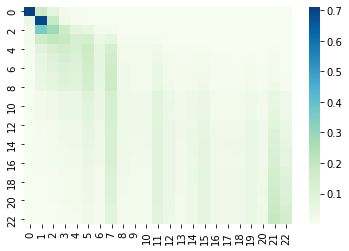

 23%|██▎       | 6.902723735408537/30 [05:03<34:18, 89.11s/it]

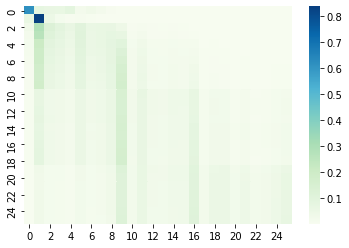

 23%|██▎       | 6.906614785992194/30 [05:03<33:36, 87.30s/it]

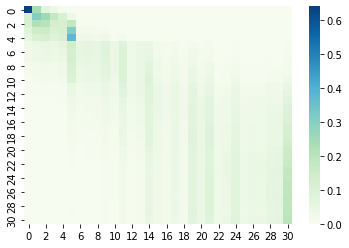

 23%|██▎       | 6.910505836575852/30 [05:04<33:17, 86.50s/it]

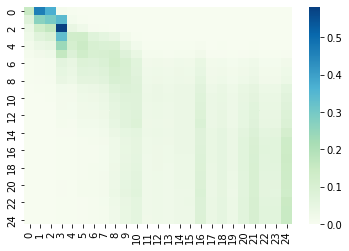

 23%|██▎       | 6.914396887159509/30 [05:04<33:43, 87.64s/it]

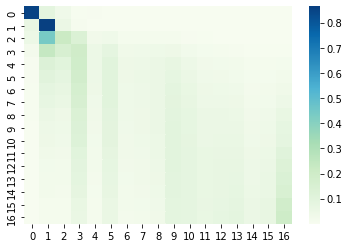

 23%|██▎       | 6.918287937743167/30 [05:05<36:47, 95.63s/it]

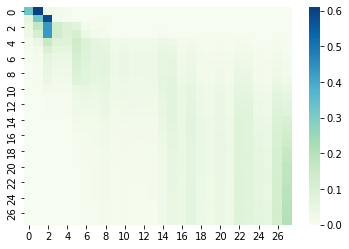

 23%|██▎       | 6.9221789883268245/30 [05:05<35:14, 91.64s/it]

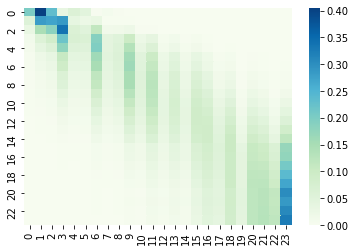

 23%|██▎       | 6.926070038910482/30 [05:05<35:34, 92.50s/it] 

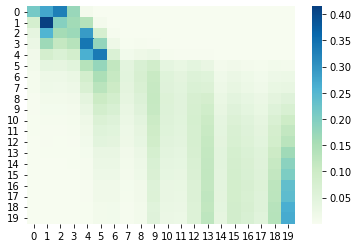

 23%|██▎       | 6.92996108949414/30 [05:06<36:06, 93.92s/it] 

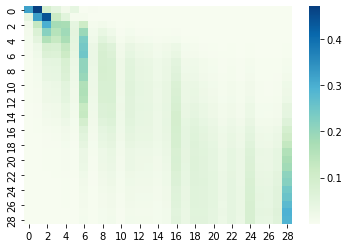

 23%|██▎       | 6.933852140077797/30 [05:06<34:44, 90.38s/it]

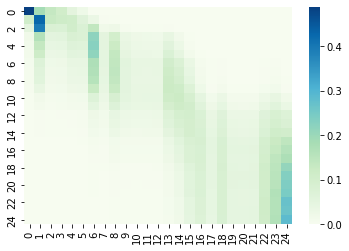

 23%|██▎       | 6.937743190661455/30 [05:06<34:45, 90.42s/it]

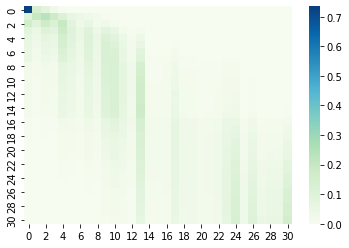

 23%|██▎       | 6.941634241245112/30 [05:07<34:10, 88.93s/it]

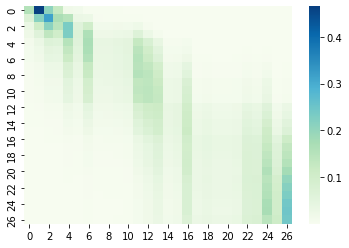

 23%|██▎       | 6.94552529182877/30 [05:07<33:17, 86.65s/it] 

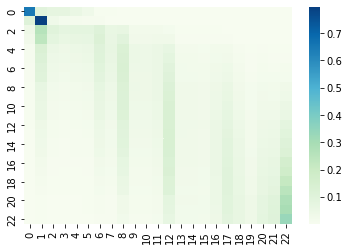

 23%|██▎       | 6.949416342412428/30 [05:07<33:55, 88.30s/it]

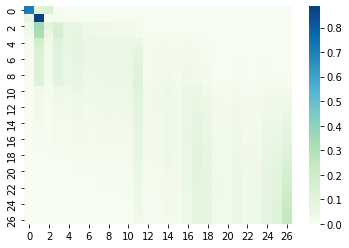

 23%|██▎       | 6.953307392996085/30 [05:08<33:29, 87.19s/it]

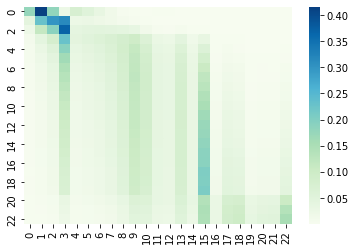

 23%|██▎       | 6.957198443579743/30 [05:08<34:17, 89.30s/it]

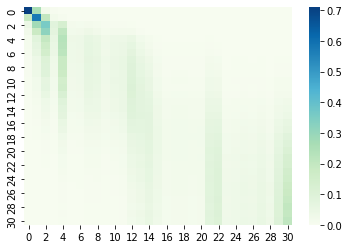

 23%|██▎       | 6.9610894941634/30 [05:08<37:04, 96.54s/it]  

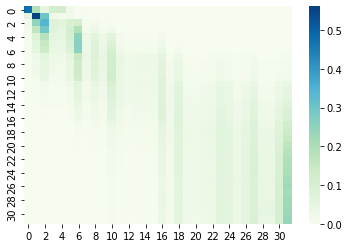

 23%|██▎       | 6.964980544747058/30 [05:09<36:02, 93.89s/it]

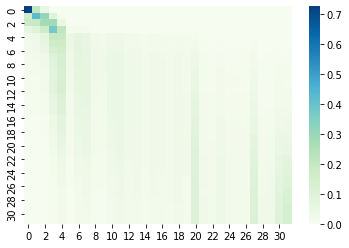

 23%|██▎       | 6.968871595330715/30 [05:09<36:00, 93.83s/it]

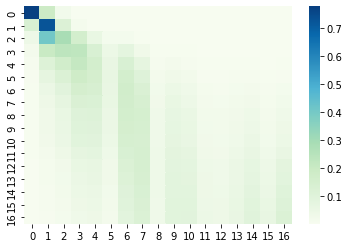

 23%|██▎       | 6.972762645914373/30 [05:09<35:38, 92.86s/it]

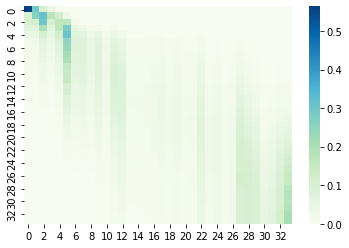

 23%|██▎       | 6.976653696498031/30 [05:10<35:09, 91.61s/it]

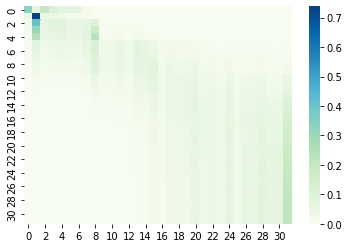

 23%|██▎       | 6.980544747081688/30 [05:10<35:06, 91.53s/it]

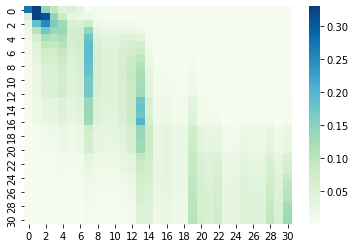

 23%|██▎       | 6.984435797665346/30 [05:11<35:39, 92.96s/it]

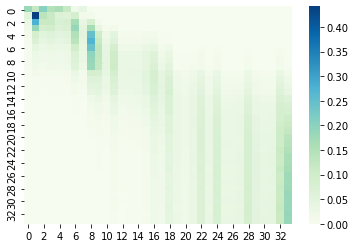

 23%|██▎       | 6.988326848249003/30 [05:11<35:46, 93.29s/it]

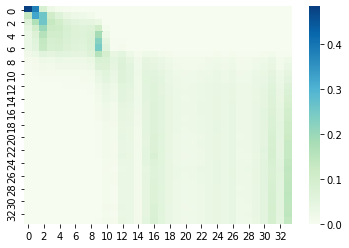

 23%|██▎       | 6.992217898832661/30 [05:11<35:34, 92.78s/it]

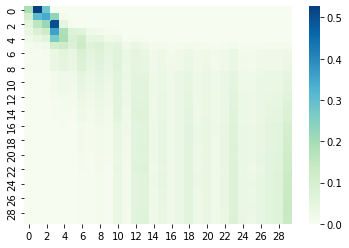

 23%|██▎       | 6.9961089494163184/30 [05:12<35:33, 92.74s/it]

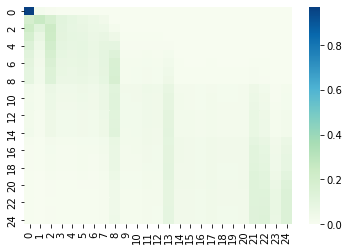

 23%|██▎       | 6.999999999999976/30 [05:12<35:16, 92.01s/it] 

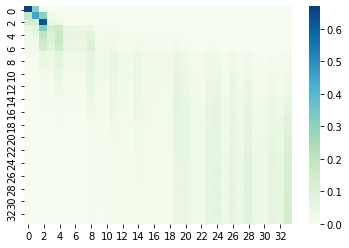

 25%|██▌       | 7.610894941634215/30 [05:25<07:28, 20.02s/it]

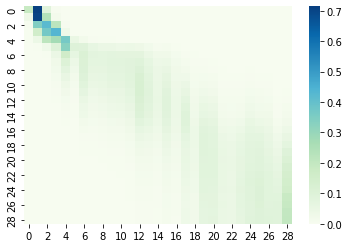

 25%|██▌       | 7.61867704280153/30 [05:26<11:57, 32.05s/it] 

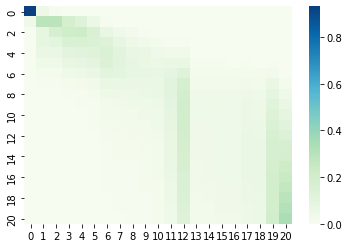

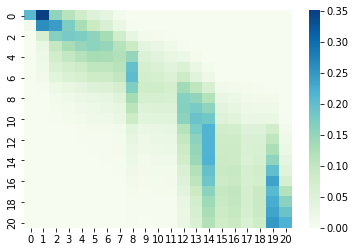

 25%|██▌       | 7.626459143968845/30 [05:26<17:52, 47.92s/it]

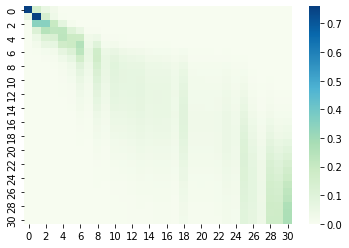

 25%|██▌       | 7.630350194552503/30 [05:27<20:40, 55.46s/it]

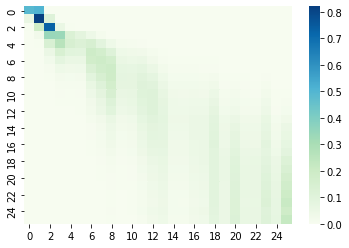

 25%|██▌       | 7.6342412451361605/30 [05:27<22:59, 61.68s/it]

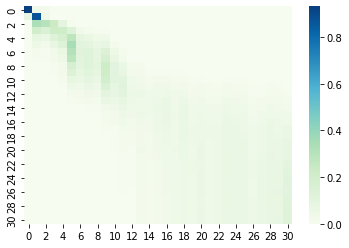

 25%|██▌       | 7.638132295719818/30 [05:27<24:27, 65.61s/it] 

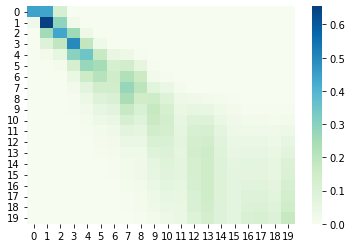

 25%|██▌       | 7.642023346303476/30 [05:28<27:02, 72.55s/it]

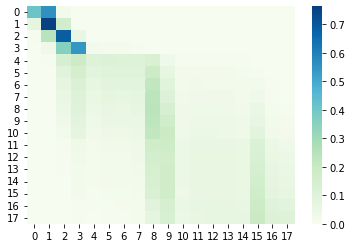

 25%|██▌       | 7.645914396887133/30 [05:28<29:32, 79.31s/it]

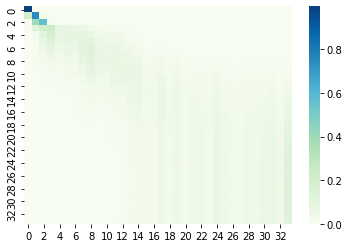

 25%|██▌       | 7.649805447470791/30 [05:29<29:42, 79.74s/it]

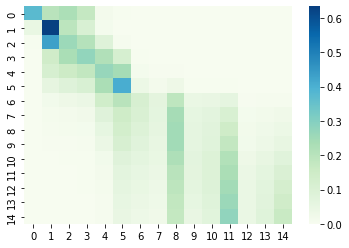

 26%|██▌       | 7.653696498054448/30 [05:29<29:37, 79.53s/it]

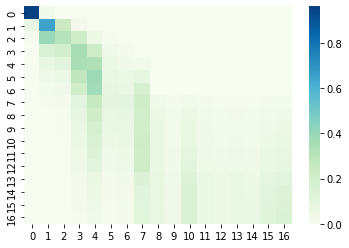

 26%|██▌       | 7.657587548638106/30 [05:29<34:29, 92.61s/it]

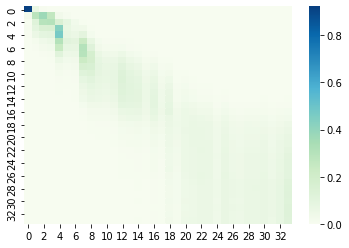

 26%|██▌       | 7.6614785992217636/30 [05:30<33:17, 89.44s/it]

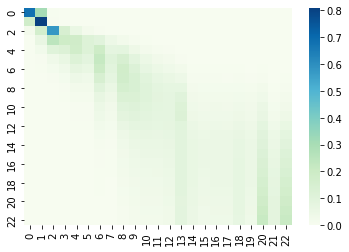

 26%|██▌       | 7.665369649805421/30 [05:30<33:56, 91.16s/it] 

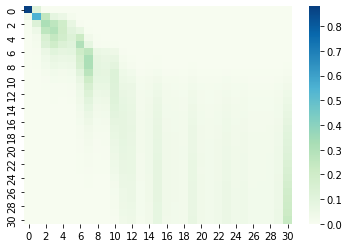

 26%|██▌       | 7.669260700389079/30 [05:30<34:16, 92.07s/it]

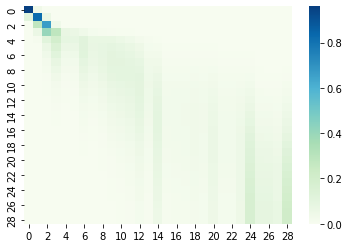

 26%|██▌       | 7.673151750972736/30 [05:31<33:19, 89.55s/it]

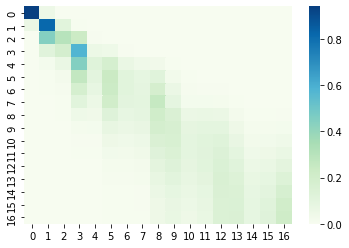

 26%|██▌       | 7.677042801556394/30 [05:31<32:18, 86.83s/it]

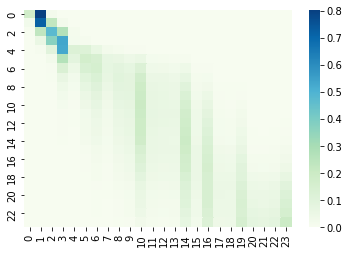

 26%|██▌       | 7.680933852140051/30 [05:31<33:49, 90.94s/it]

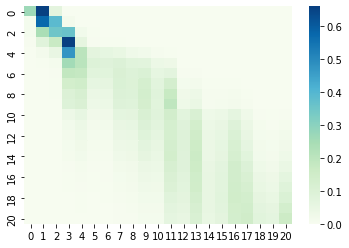

 26%|██▌       | 7.684824902723709/30 [05:32<33:36, 90.35s/it]

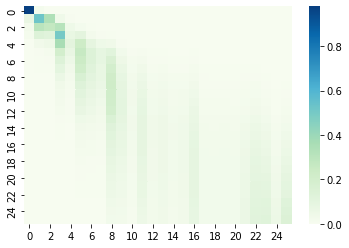

 26%|██▌       | 7.688715953307367/30 [05:32<32:29, 87.39s/it]

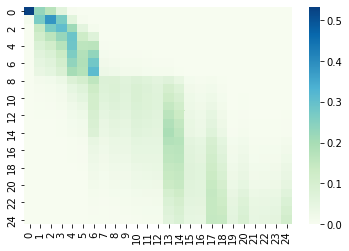

 26%|██▌       | 7.692607003891024/30 [05:32<33:22, 89.75s/it]

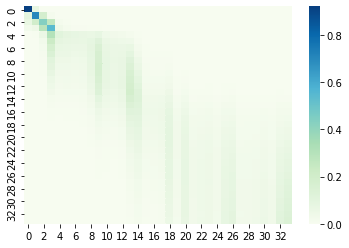

 26%|██▌       | 7.696498054474682/30 [05:33<33:19, 89.63s/it]

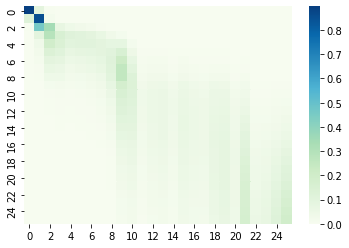

 26%|██▌       | 7.700389105058339/30 [05:33<35:32, 95.63s/it]

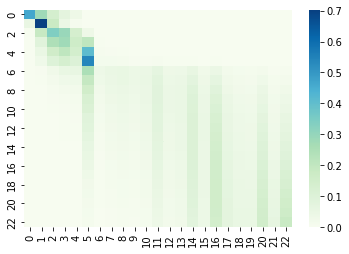

 26%|██▌       | 7.704280155641997/30 [05:34<34:51, 93.81s/it]

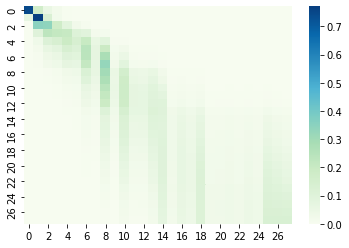

 26%|██▌       | 7.708171206225654/30 [05:34<33:56, 91.34s/it]

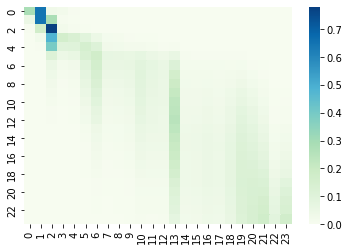

 26%|██▌       | 7.712062256809312/30 [05:34<34:43, 93.48s/it]

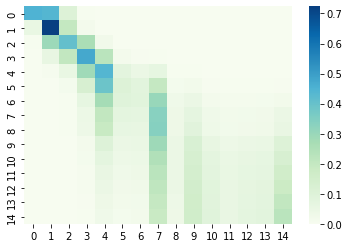

 26%|██▌       | 7.71595330739297/30 [05:35<34:01, 91.62s/it] 

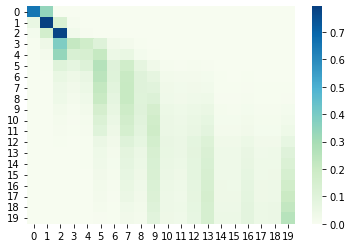

 26%|██▌       | 7.719844357976627/30 [05:35<34:34, 93.10s/it]

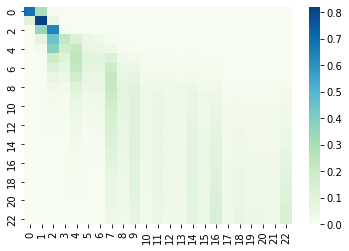

 26%|██▌       | 7.723735408560285/30 [05:35<34:41, 93.46s/it]

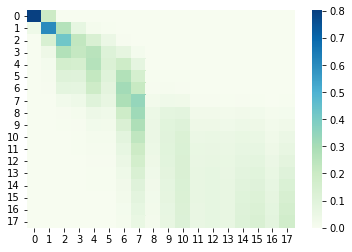

 26%|██▌       | 7.727626459143942/30 [05:36<35:01, 94.37s/it]

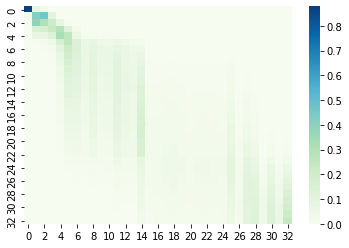

 26%|██▌       | 7.7315175097276/30 [05:36<34:45, 93.65s/it]  

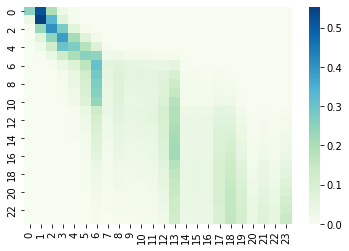

 26%|██▌       | 7.7354085603112575/30 [05:37<35:36, 95.95s/it]

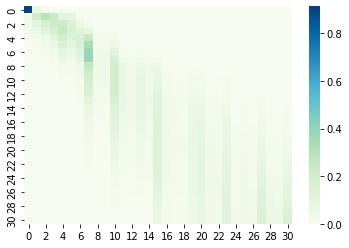

 26%|██▌       | 7.739299610894915/30 [05:37<34:35, 93.22s/it] 

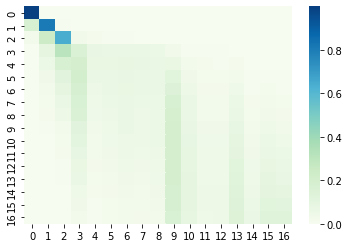

 26%|██▌       | 7.743190661478573/30 [05:37<36:54, 99.51s/it]

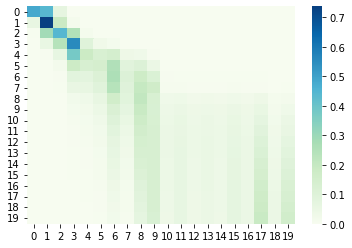

 26%|██▌       | 7.74708171206223/30 [05:38<36:31, 98.47s/it] 

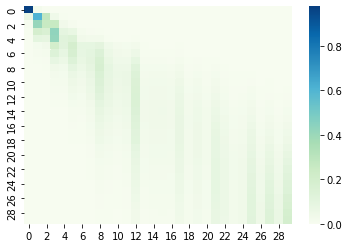

 26%|██▌       | 7.750972762645888/30 [05:38<35:19, 95.26s/it]

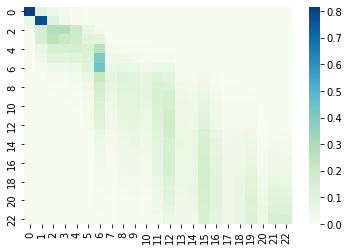

 26%|██▌       | 7.754863813229545/30 [05:38<34:57, 94.29s/it]

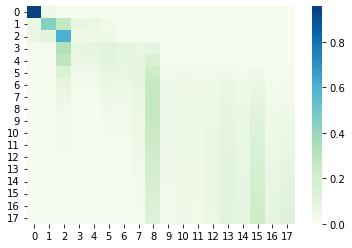

 26%|██▌       | 7.758754863813203/30 [05:39<34:44, 93.74s/it]

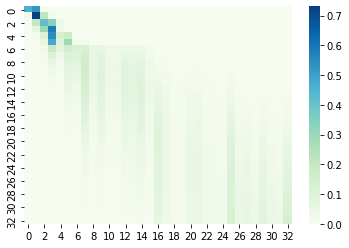

 26%|██▌       | 7.7626459143968605/30 [05:39<34:09, 92.17s/it]

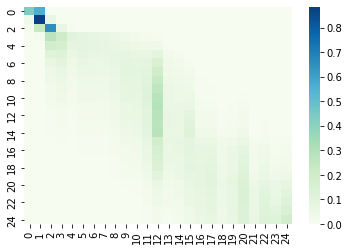

 26%|██▌       | 7.766536964980518/30 [05:39<34:00, 91.79s/it] 

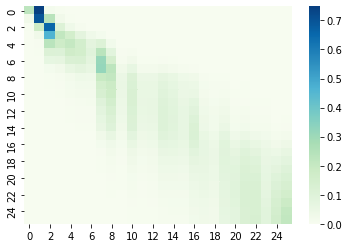

 26%|██▌       | 7.770428015564176/30 [05:40<33:11, 89.60s/it]

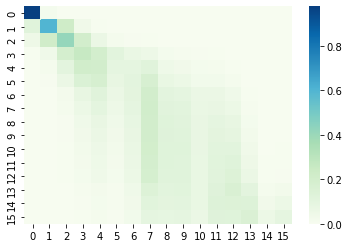

 26%|██▌       | 7.774319066147833/30 [05:40<32:08, 86.75s/it]

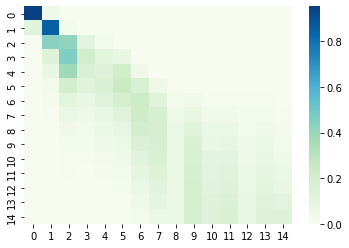

 26%|██▌       | 7.778210116731491/30 [05:40<32:18, 87.22s/it]

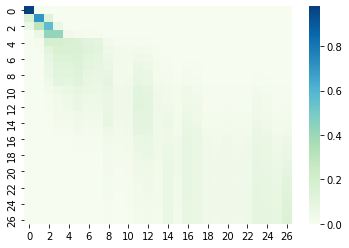

 26%|██▌       | 7.782101167315148/30 [05:41<31:59, 86.38s/it]

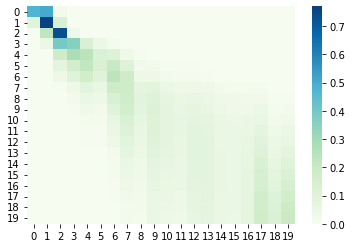

 26%|██▌       | 7.785992217898806/30 [05:41<36:06, 97.53s/it]

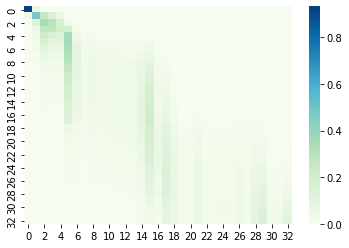

 26%|██▌       | 7.7898832684824635/30 [05:42<35:31, 95.97s/it]

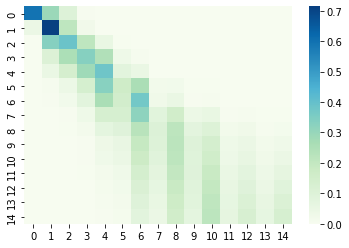

 26%|██▌       | 7.793774319066121/30 [05:42<34:14, 92.54s/it] 

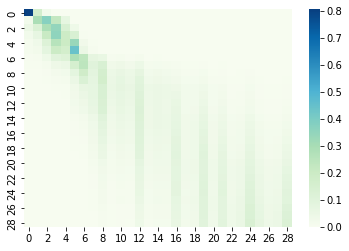

 26%|██▌       | 7.797665369649779/30 [05:42<33:18, 90.02s/it]

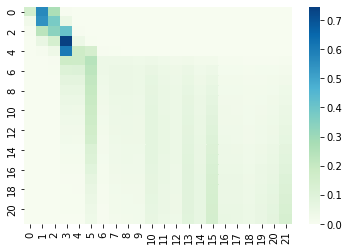

 26%|██▌       | 7.801556420233436/30 [05:43<34:39, 93.69s/it]

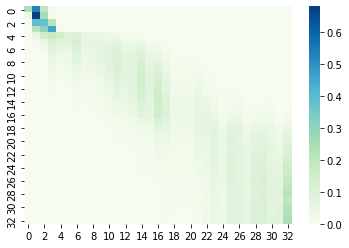

 26%|██▌       | 7.805447470817094/30 [05:43<34:45, 93.98s/it]

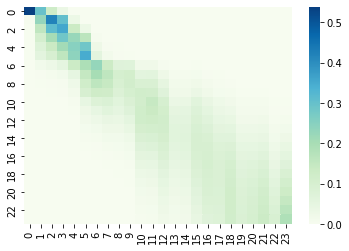

 26%|██▌       | 7.809338521400751/30 [05:43<34:04, 92.15s/it]

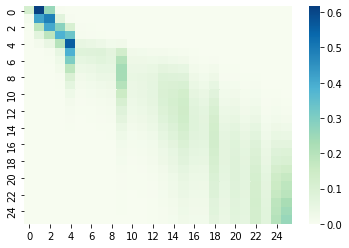

 26%|██▌       | 7.813229571984409/30 [05:44<35:00, 94.66s/it]

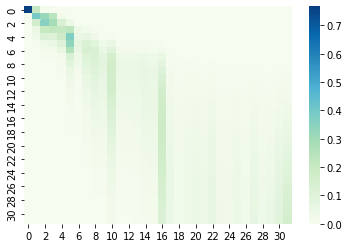

 26%|██▌       | 7.8171206225680665/30 [05:44<36:26, 98.59s/it]

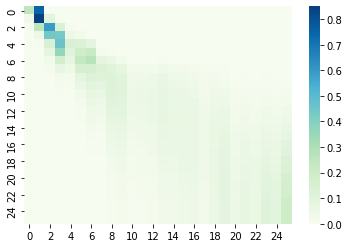

 26%|██▌       | 7.821011673151724/30 [05:45<37:56, 102.63s/it]

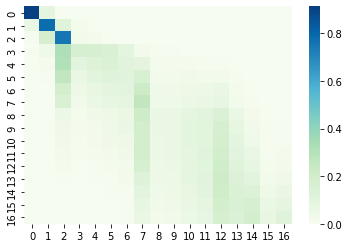

 26%|██▌       | 7.824902723735382/30 [05:45<39:50, 107.81s/it]

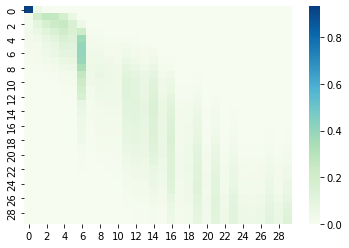

 26%|██▌       | 7.828793774319039/30 [05:46<44:22, 120.10s/it]

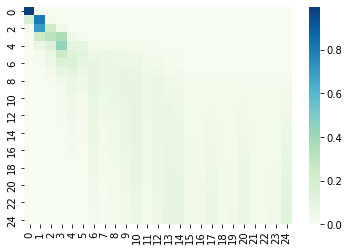

 26%|██▌       | 7.832684824902697/30 [05:46<44:42, 121.02s/it]

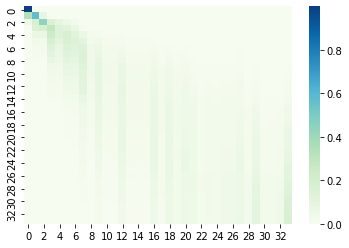

 26%|██▌       | 7.836575875486354/30 [05:47<43:42, 118.31s/it]

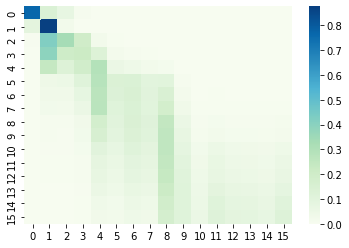

 26%|██▌       | 7.840466926070012/30 [05:47<42:20, 114.66s/it]

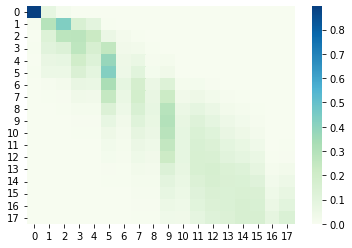

 26%|██▌       | 7.8443579766536695/30 [05:47<43:20, 117.39s/it]

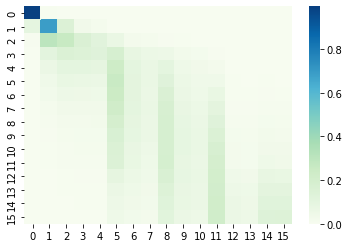

 26%|██▌       | 7.848249027237327/30 [05:48<43:47, 118.60s/it] 

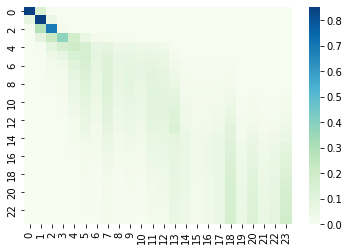

 26%|██▌       | 7.852140077820985/30 [05:48<45:37, 123.60s/it]

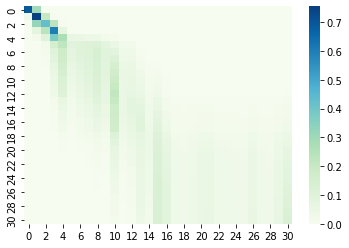

 26%|██▌       | 7.856031128404642/30 [05:49<46:03, 124.78s/it]

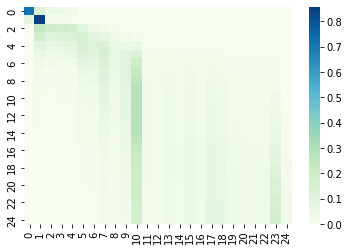

 26%|██▌       | 7.8599221789883/30 [05:49<43:08, 116.93s/it]  

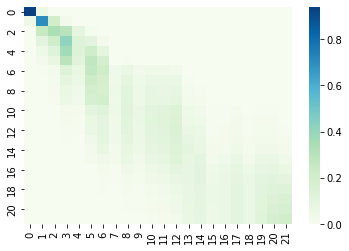

 26%|██▌       | 7.863813229571957/30 [05:50<40:01, 108.47s/it]

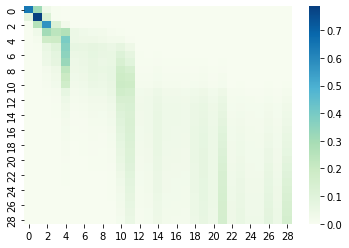

 26%|██▌       | 7.867704280155615/30 [05:50<37:54, 102.79s/it]

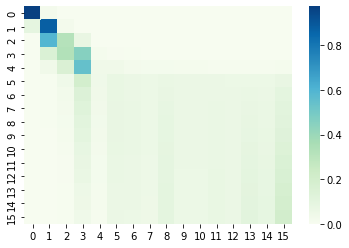

 26%|██▌       | 7.8715953307392725/30 [05:50<38:41, 104.89s/it]

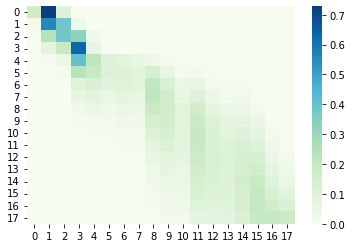

 26%|██▋       | 7.87548638132293/30 [05:51<38:07, 103.38s/it]  

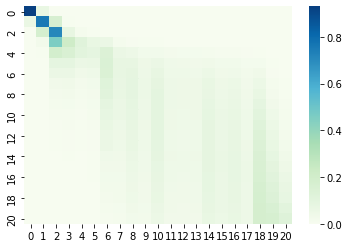

 26%|██▋       | 7.879377431906588/30 [05:51<36:03, 97.79s/it]

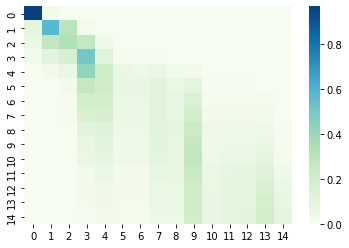

 26%|██▋       | 7.883268482490245/30 [05:52<34:54, 94.71s/it]

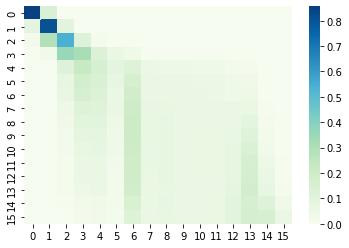

 26%|██▋       | 7.887159533073903/30 [05:52<35:04, 95.18s/it]

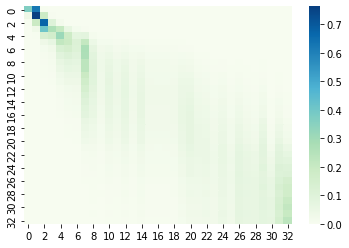

 26%|██▋       | 7.89105058365756/30 [05:52<34:36, 93.92s/it] 

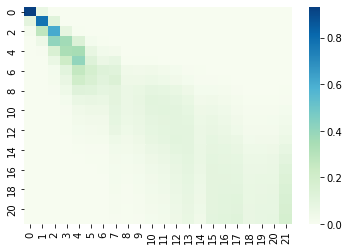

 26%|██▋       | 7.894941634241218/30 [05:53<33:57, 92.19s/it]

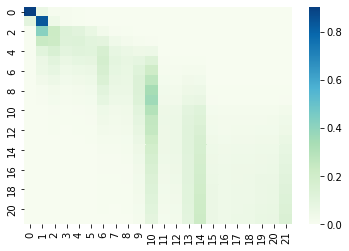

 26%|██▋       | 7.8988326848248755/30 [05:53<34:06, 92.61s/it]

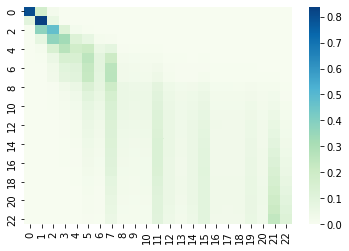

 26%|██▋       | 7.902723735408533/30 [05:53<34:13, 92.92s/it] 

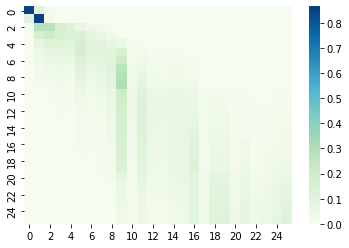

 26%|██▋       | 7.906614785992191/30 [05:54<33:32, 91.07s/it]

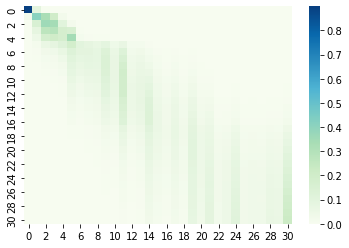

 26%|██▋       | 7.910505836575848/30 [05:54<33:50, 91.92s/it]

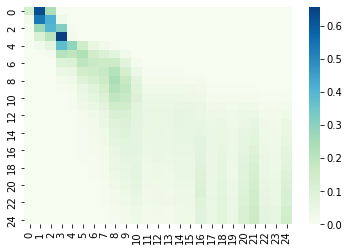

 26%|██▋       | 7.914396887159506/30 [05:54<36:30, 99.20s/it]

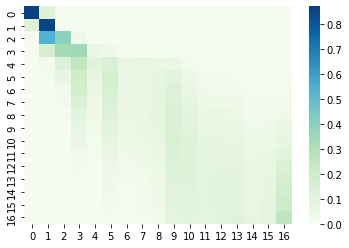

 26%|██▋       | 7.918287937743163/30 [05:55<35:53, 97.52s/it]

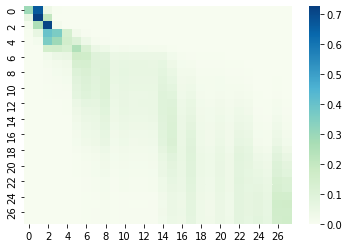

 26%|██▋       | 7.922178988326821/30 [05:55<35:06, 95.41s/it]

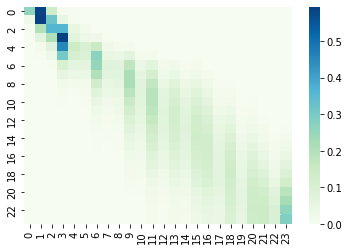

 26%|██▋       | 7.926070038910479/30 [05:56<34:18, 93.26s/it]

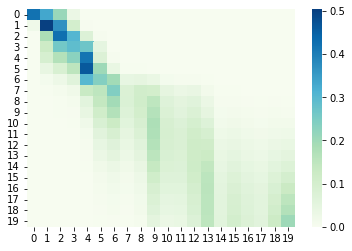

 26%|██▋       | 7.929961089494136/30 [05:56<33:52, 92.11s/it]

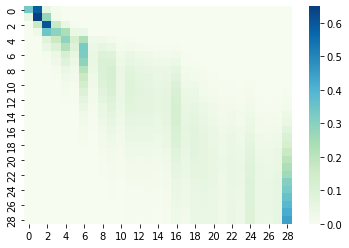

 26%|██▋       | 7.933852140077794/30 [05:56<33:16, 90.46s/it]

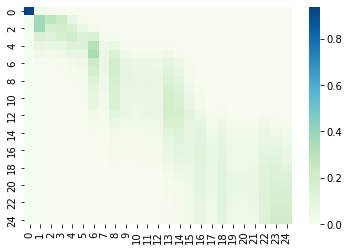

 26%|██▋       | 7.937743190661451/30 [05:57<34:05, 92.71s/it]

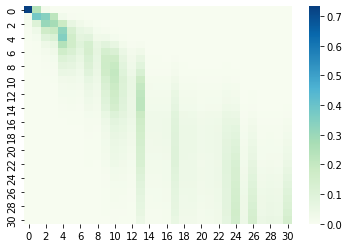

 26%|██▋       | 7.941634241245109/30 [05:57<33:25, 90.90s/it]

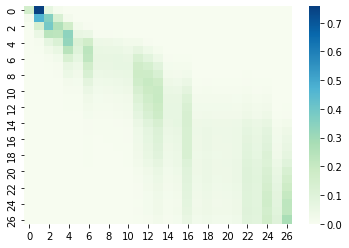

 26%|██▋       | 7.945525291828766/30 [05:57<32:09, 87.48s/it]

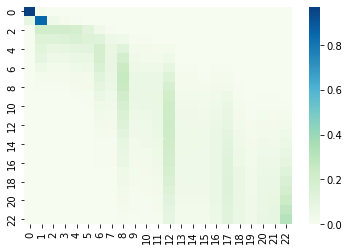

 26%|██▋       | 7.949416342412424/30 [05:58<32:45, 89.15s/it]

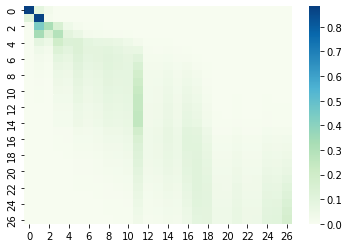

 27%|██▋       | 7.953307392996082/30 [05:58<32:17, 87.86s/it]

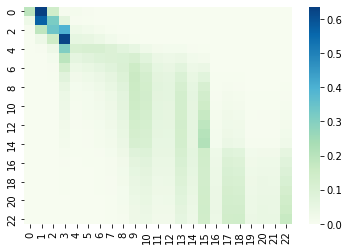

 27%|██▋       | 7.957198443579739/30 [05:58<36:13, 98.61s/it]

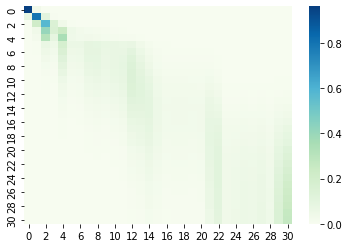

 27%|██▋       | 7.961089494163397/30 [05:59<34:34, 94.13s/it]

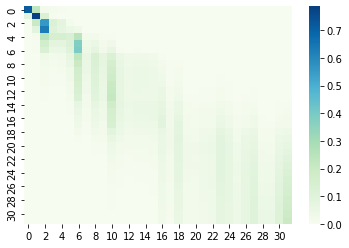

 27%|██▋       | 7.964980544747054/30 [05:59<34:42, 94.51s/it]

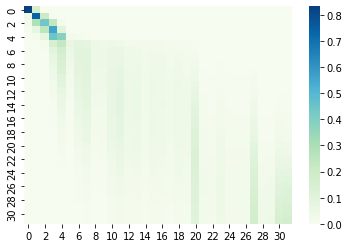

 27%|██▋       | 7.968871595330712/30 [05:59<34:37, 94.28s/it]

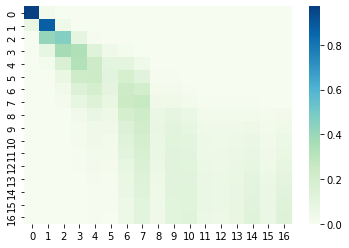

 27%|██▋       | 7.9727626459143695/30 [06:00<34:44, 94.62s/it]

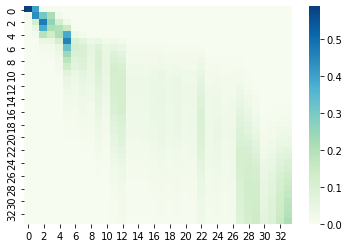

 27%|██▋       | 7.976653696498027/30 [06:00<34:17, 93.43s/it] 

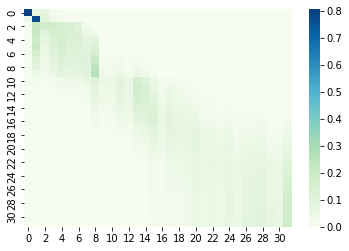

 27%|██▋       | 7.980544747081685/30 [06:01<34:24, 93.74s/it]

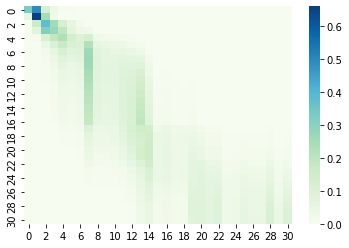

 27%|██▋       | 7.984435797665342/30 [06:01<33:36, 91.59s/it]

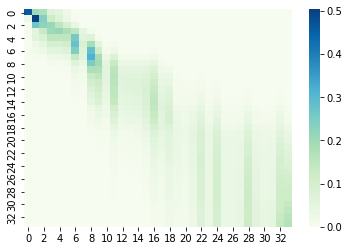

 27%|██▋       | 7.988326848249/30 [06:01<33:38, 91.72s/it]   

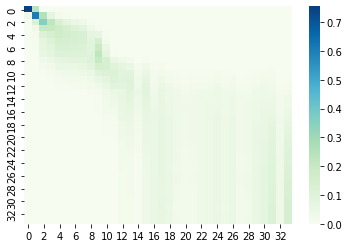

 27%|██▋       | 7.992217898832657/30 [06:02<34:27, 93.92s/it]

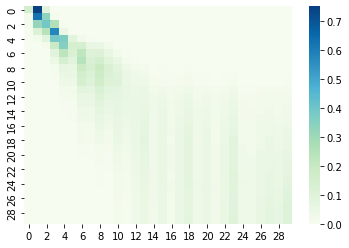

 27%|██▋       | 7.996108949416315/30 [06:02<34:14, 93.35s/it]

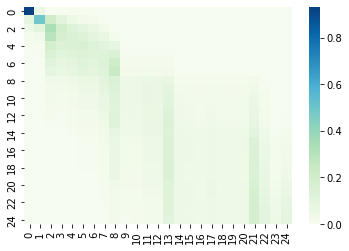

 27%|██▋       | 7.9999999999999725/30 [06:02<37:17, 101.71s/it]

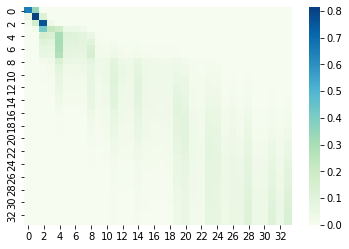

 29%|██▊       | 8.61478599221787/30 [06:16<08:44, 24.54s/it] 

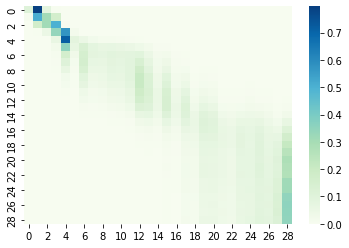

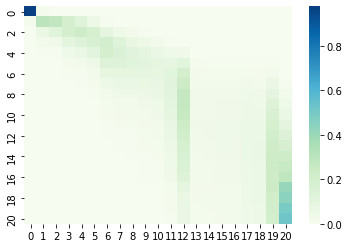

 29%|██▊       | 8.622568093385185/30 [06:17<14:59, 42.08s/it]

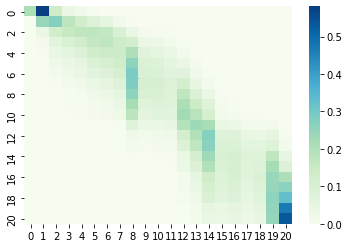

 29%|██▉       | 8.626459143968843/30 [06:17<18:00, 50.54s/it]

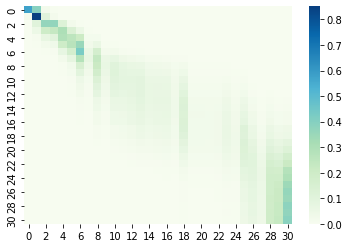

 29%|██▉       | 8.6303501945525/30 [06:18<21:26, 60.21s/it]  

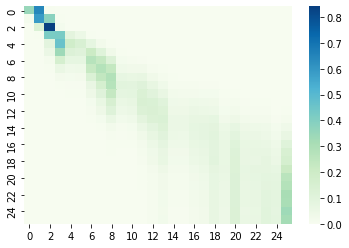

 29%|██▉       | 8.634241245136158/30 [06:18<23:07, 64.92s/it]

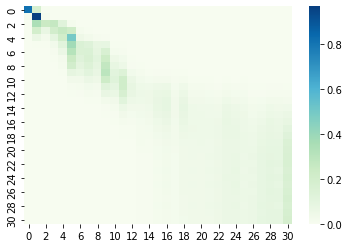

 29%|██▉       | 8.638132295719815/30 [06:18<24:43, 69.45s/it]

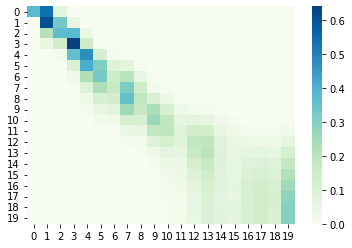

 29%|██▉       | 8.642023346303473/30 [06:19<27:41, 77.78s/it]

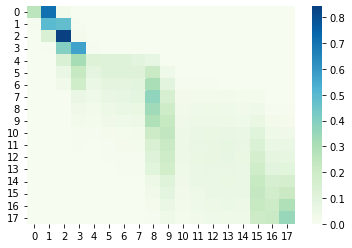

 29%|██▉       | 8.64591439688713/30 [06:19<29:22, 82.53s/it] 

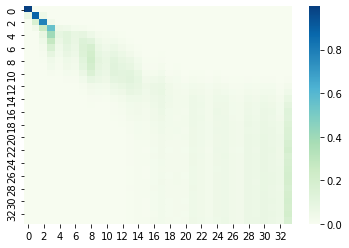

 29%|██▉       | 8.649805447470788/30 [06:20<30:03, 84.49s/it]

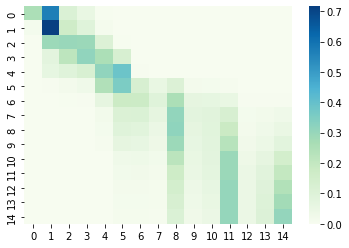

 29%|██▉       | 8.653696498054446/30 [06:20<33:58, 95.50s/it]

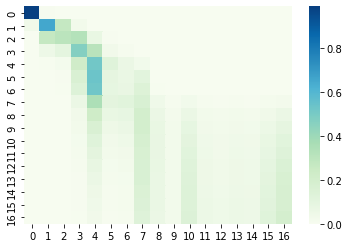

 29%|██▉       | 8.657587548638103/30 [06:20<33:47, 95.00s/it]

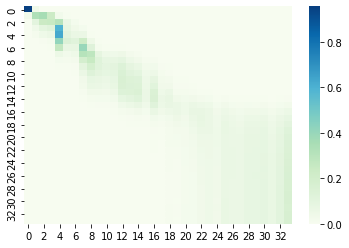

 29%|██▉       | 8.66147859922176/30 [06:21<33:43, 94.82s/it] 

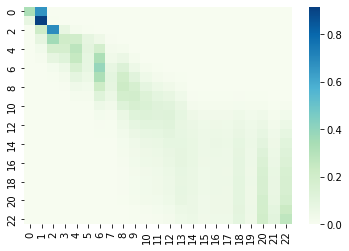

 29%|██▉       | 8.665369649805418/30 [06:21<33:22, 93.86s/it]

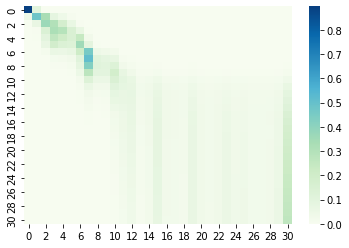

 29%|██▉       | 8.669260700389076/30 [06:22<33:23, 93.92s/it]

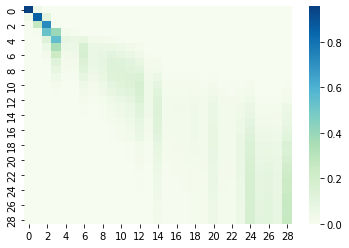

 29%|██▉       | 8.673151750972734/30 [06:22<32:30, 91.47s/it]

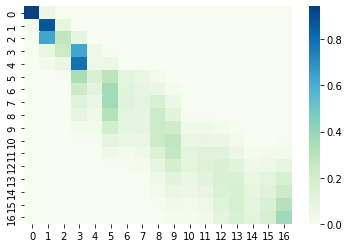

 29%|██▉       | 8.677042801556391/30 [06:22<31:41, 89.16s/it]

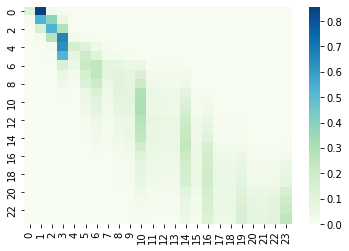

 29%|██▉       | 8.680933852140049/30 [06:23<33:19, 93.78s/it]

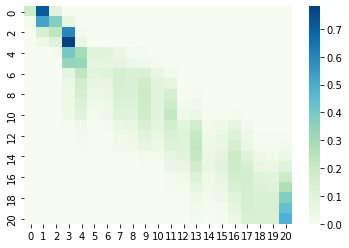

 29%|██▉       | 8.684824902723706/30 [06:23<32:47, 92.29s/it]

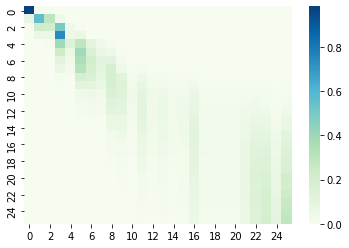

 29%|██▉       | 8.688715953307364/30 [06:23<31:54, 89.84s/it]

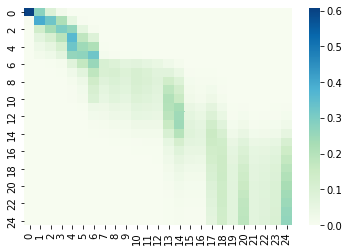

 29%|██▉       | 8.692607003891021/30 [06:24<32:19, 91.02s/it]

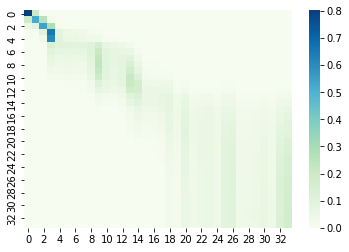

 29%|██▉       | 8.696498054474679/30 [06:24<34:48, 98.03s/it]

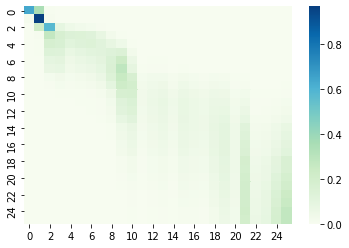

 29%|██▉       | 8.700389105058337/30 [06:24<32:25, 91.32s/it]

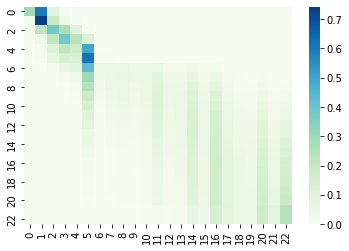

 29%|██▉       | 8.704280155641994/30 [06:25<32:31, 91.65s/it]

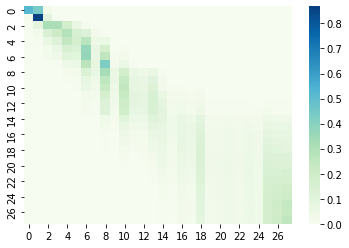

 29%|██▉       | 8.708171206225652/30 [06:25<31:55, 89.96s/it]

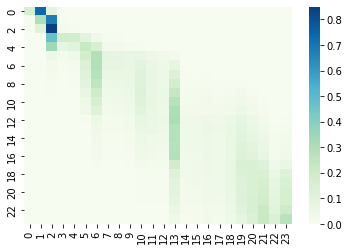

 29%|██▉       | 8.71206225680931/30 [06:25<32:51, 92.61s/it] 

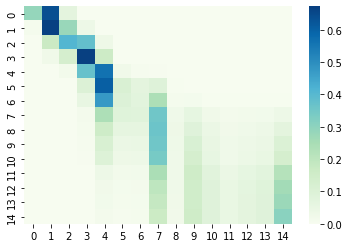

 29%|██▉       | 8.715953307392967/30 [06:26<32:06, 90.50s/it]

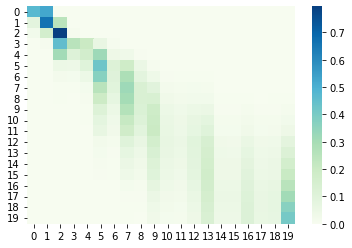

 29%|██▉       | 8.719844357976624/30 [06:26<32:25, 91.42s/it]

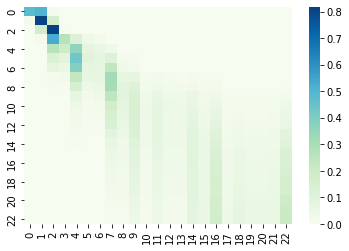

 29%|██▉       | 8.723735408560282/30 [06:27<32:36, 91.97s/it]

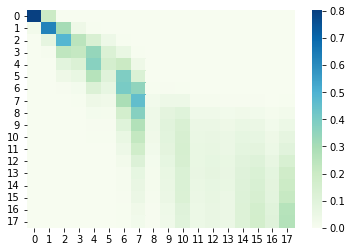

 29%|██▉       | 8.72762645914394/30 [06:27<32:31, 91.72s/it] 

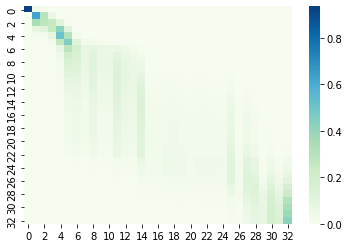

 29%|██▉       | 8.731517509727597/30 [06:27<32:19, 91.20s/it]

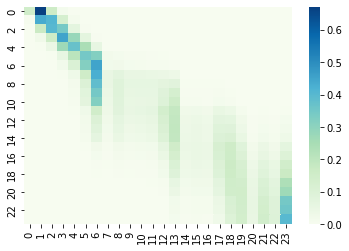

 29%|██▉       | 8.735408560311255/30 [06:28<33:05, 93.36s/it]

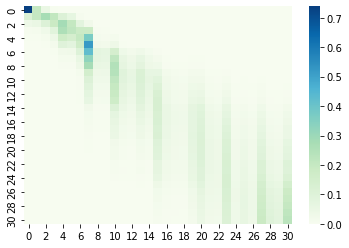

 29%|██▉       | 8.739299610894912/30 [06:28<34:48, 98.22s/it]

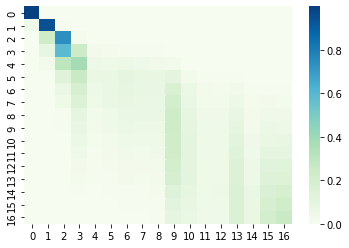

 29%|██▉       | 8.74319066147857/30 [06:28<33:22, 94.19s/it] 

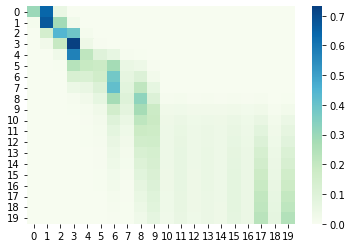

 29%|██▉       | 8.747081712062228/30 [06:29<34:06, 96.28s/it]

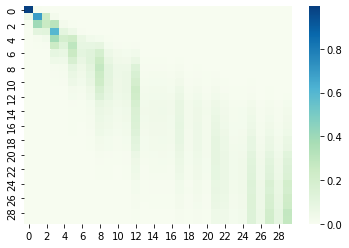

 29%|██▉       | 8.750972762645885/30 [06:29<33:11, 93.73s/it]

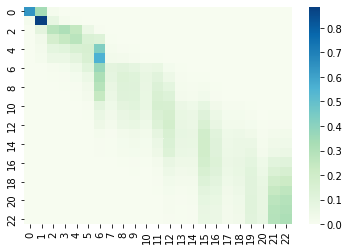

 29%|██▉       | 8.754863813229543/30 [06:29<33:38, 95.03s/it]

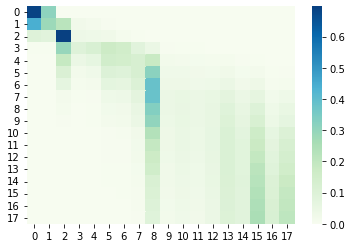

 29%|██▉       | 8.7587548638132/30 [06:30<34:07, 96.40s/it]  

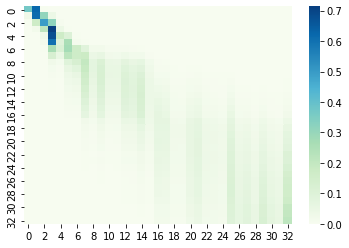

 29%|██▉       | 8.762645914396858/30 [06:30<34:05, 96.32s/it]

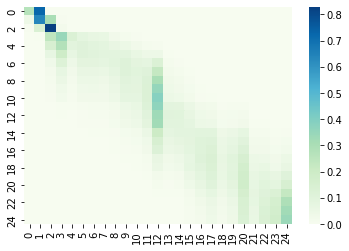

 29%|██▉       | 8.766536964980515/30 [06:31<35:09, 99.33s/it]

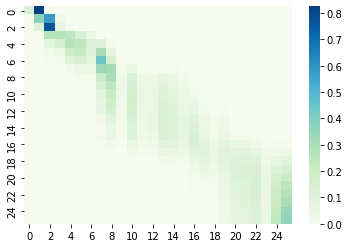

 29%|██▉       | 8.770428015564173/30 [06:31<33:36, 95.01s/it]

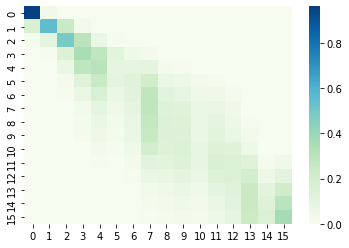

 29%|██▉       | 8.77431906614783/30 [06:31<33:02, 93.39s/it] 

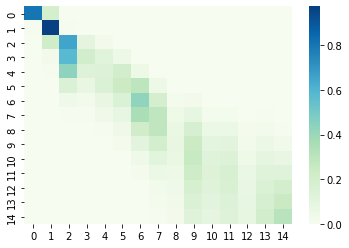

 29%|██▉       | 8.778210116731488/30 [06:32<32:31, 91.95s/it]

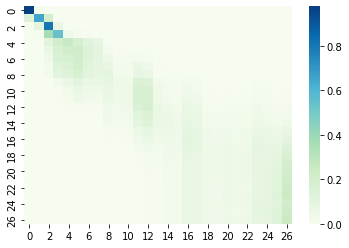

 29%|██▉       | 8.782101167315146/30 [06:32<33:58, 96.07s/it]

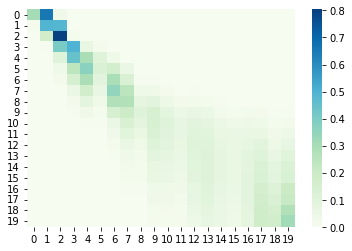

 29%|██▉       | 8.785992217898803/30 [06:32<34:36, 97.87s/it]

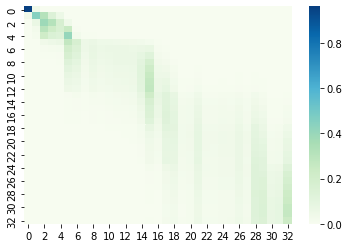

 29%|██▉       | 8.78988326848246/30 [06:33<34:11, 96.70s/it] 

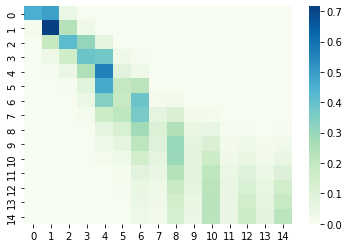

 29%|██▉       | 8.793774319066118/30 [06:33<33:29, 94.76s/it]

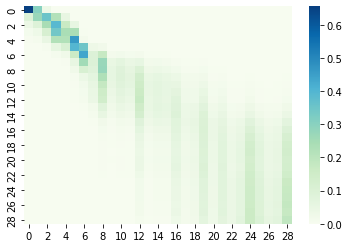

 29%|██▉       | 8.797665369649776/30 [06:34<32:45, 92.70s/it]

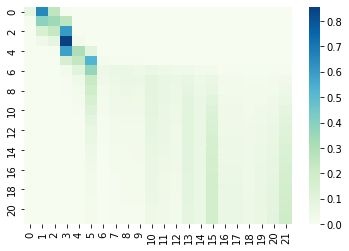

 29%|██▉       | 8.801556420233434/30 [06:34<33:58, 96.15s/it]

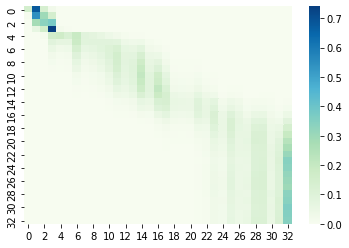

 29%|██▉       | 8.805447470817091/30 [06:34<33:53, 95.94s/it]

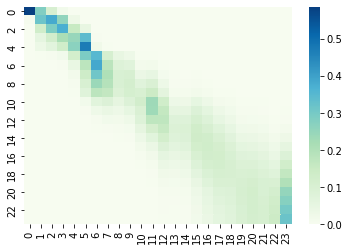

 29%|██▉       | 8.809338521400749/30 [06:35<33:39, 95.28s/it]

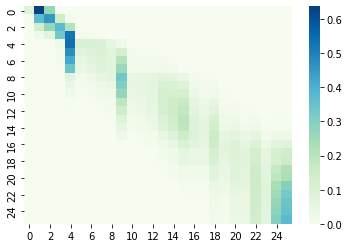

 29%|██▉       | 8.813229571984406/30 [06:35<33:08, 93.84s/it]

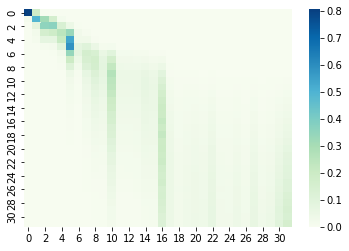

 29%|██▉       | 8.817120622568064/30 [06:35<32:19, 91.58s/it]

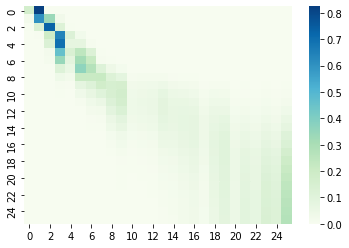

 29%|██▉       | 8.821011673151721/30 [06:36<31:55, 90.43s/it]

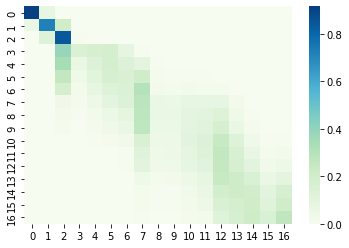

 29%|██▉       | 8.824902723735379/30 [06:36<34:07, 96.70s/it]

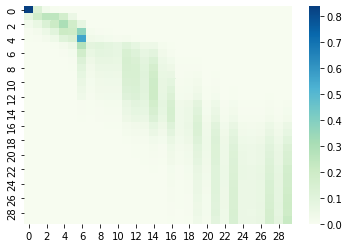

 29%|██▉       | 8.828793774319037/30 [06:36<33:23, 94.66s/it]

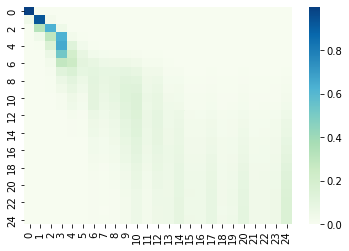

 29%|██▉       | 8.832684824902694/30 [06:37<34:44, 98.46s/it]

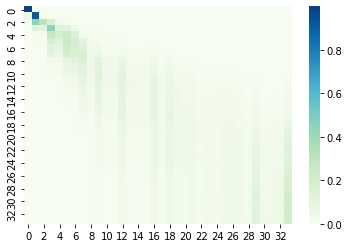

 29%|██▉       | 8.836575875486352/30 [06:37<33:01, 93.64s/it]

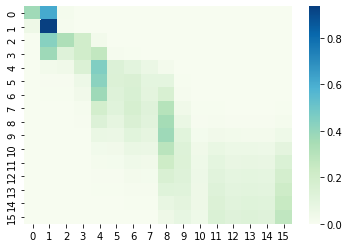

 29%|██▉       | 8.84046692607001/30 [06:38<32:04, 90.97s/it] 

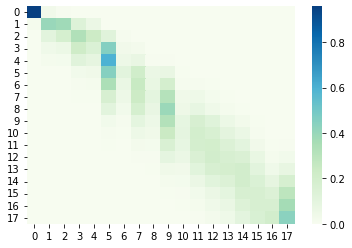

 29%|██▉       | 8.844357976653667/30 [06:38<33:18, 94.47s/it]

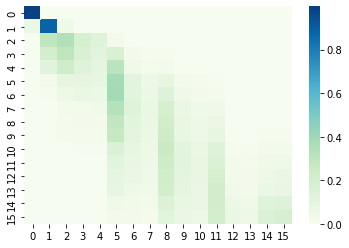

 29%|██▉       | 8.848249027237324/30 [06:38<32:58, 93.54s/it]

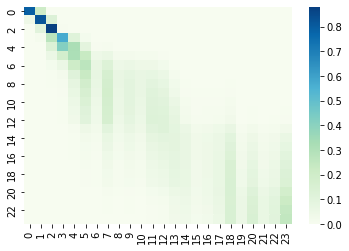

 30%|██▉       | 8.852140077820982/30 [06:39<33:32, 95.16s/it]

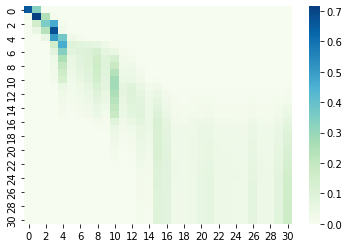

 30%|██▉       | 8.85603112840464/30 [06:39<33:05, 93.91s/it] 

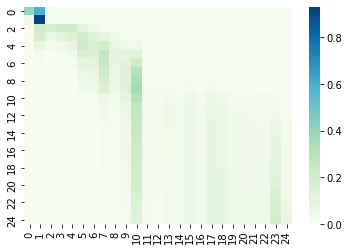

 30%|██▉       | 8.859922178988297/30 [06:39<32:44, 92.94s/it]

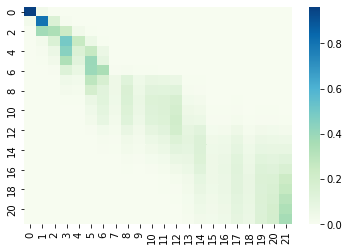

 30%|██▉       | 8.863813229571955/30 [06:40<32:38, 92.66s/it]

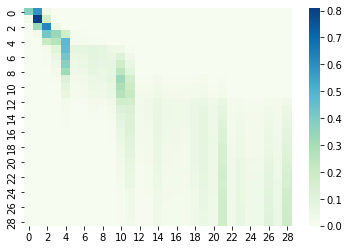

 30%|██▉       | 8.867704280155612/30 [06:40<34:26, 97.81s/it]

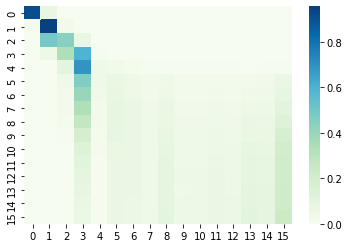

 30%|██▉       | 8.87159533073927/30 [06:41<34:35, 98.22s/it] 

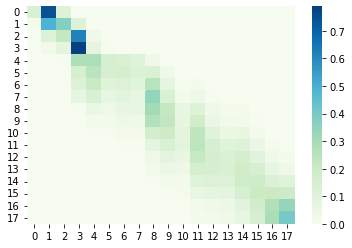

 30%|██▉       | 8.875486381322927/30 [06:41<34:24, 97.72s/it]

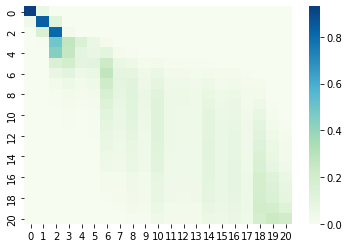

 30%|██▉       | 8.879377431906585/30 [06:41<33:20, 94.72s/it]

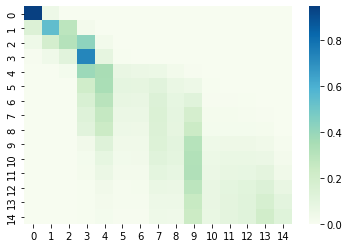

 30%|██▉       | 8.883268482490243/30 [06:42<33:41, 95.72s/it]

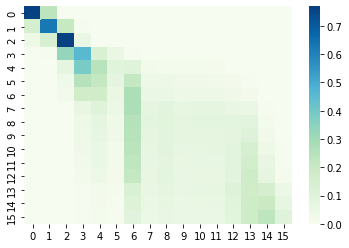

 30%|██▉       | 8.8871595330739/30 [06:42<33:21, 94.79s/it]  

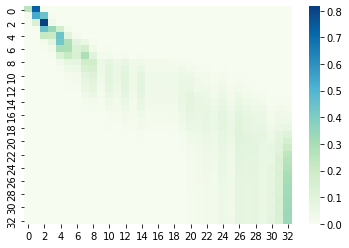

 30%|██▉       | 8.891050583657558/30 [06:42<33:28, 95.14s/it]

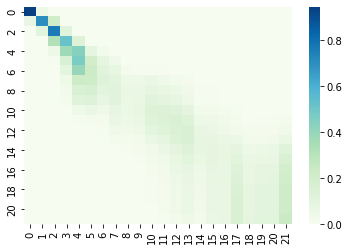

 30%|██▉       | 8.894941634241215/30 [06:43<33:51, 96.26s/it]

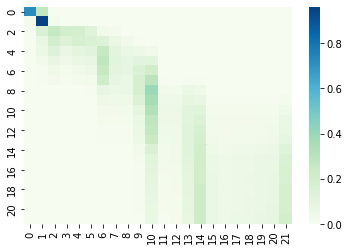

 30%|██▉       | 8.898832684824873/30 [06:43<33:16, 94.62s/it]

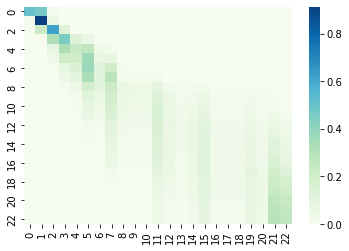

 30%|██▉       | 8.90272373540853/30 [06:44<34:32, 98.23s/it] 

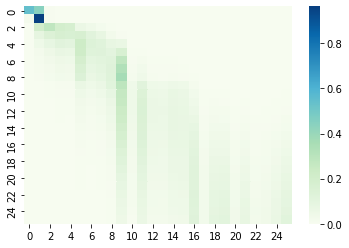

 30%|██▉       | 8.906614785992188/30 [06:44<36:21, 103.43s/it]

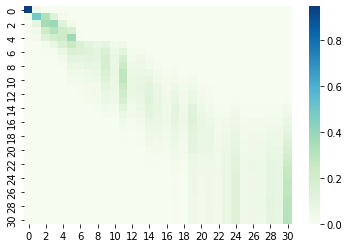

 30%|██▉       | 8.910505836575846/30 [06:45<40:36, 115.51s/it]

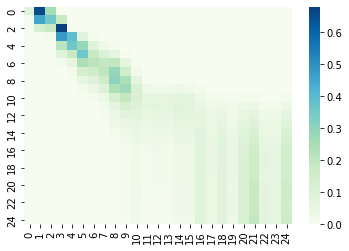

 30%|██▉       | 8.914396887159503/30 [06:45<40:46, 116.04s/it]

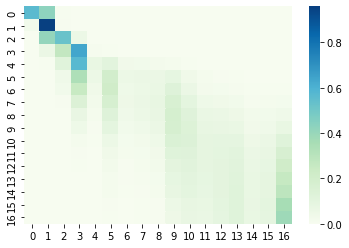

 30%|██▉       | 8.91828793774316/30 [06:45<40:24, 115.00s/it] 

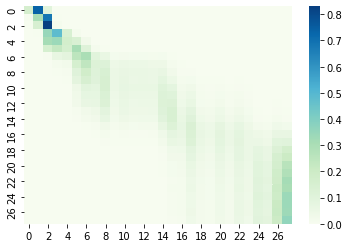

 30%|██▉       | 8.922178988326818/30 [06:46<39:23, 112.14s/it]

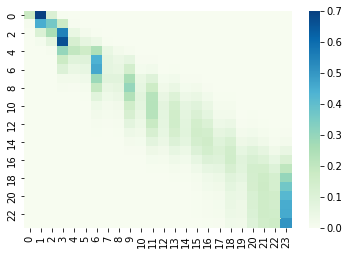

 30%|██▉       | 8.926070038910476/30 [06:46<40:28, 115.23s/it]

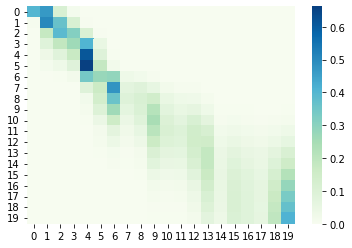

 30%|██▉       | 8.929961089494133/30 [06:47<41:30, 118.19s/it]

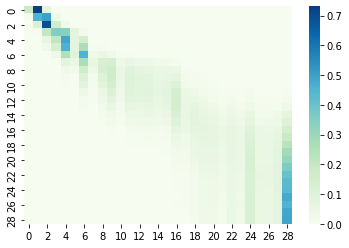

 30%|██▉       | 8.933852140077791/30 [06:47<42:51, 122.06s/it]

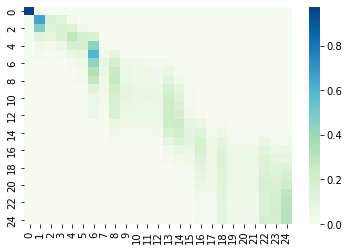

 30%|██▉       | 8.937743190661449/30 [06:48<43:17, 123.34s/it]

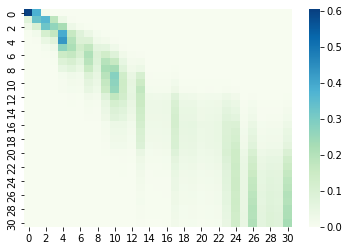

 30%|██▉       | 8.941634241245106/30 [06:48<42:33, 121.27s/it]

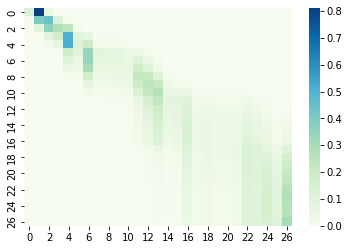

 30%|██▉       | 8.945525291828764/30 [06:49<41:35, 118.54s/it]

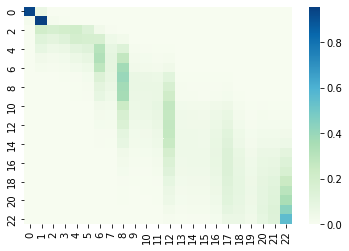

 30%|██▉       | 8.949416342412421/30 [06:49<41:55, 119.50s/it]

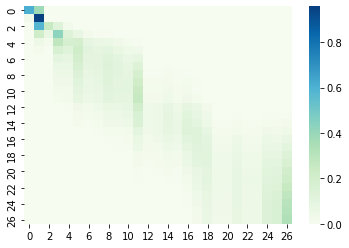

 30%|██▉       | 8.953307392996079/30 [06:50<42:37, 121.52s/it]

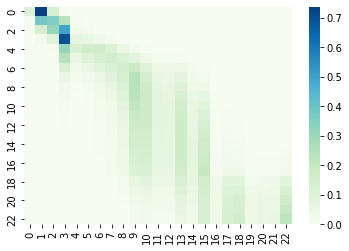

 30%|██▉       | 8.957198443579736/30 [06:50<39:54, 113.80s/it]

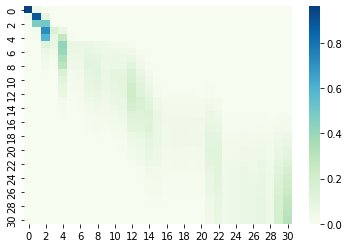

 30%|██▉       | 8.961089494163394/30 [06:50<38:27, 109.65s/it]

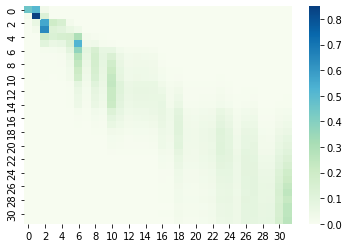

 30%|██▉       | 8.964980544747052/30 [06:51<38:12, 108.98s/it]

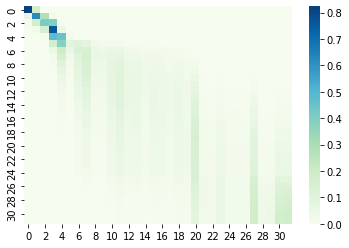

 30%|██▉       | 8.96887159533071/30 [06:51<37:07, 105.89s/it] 

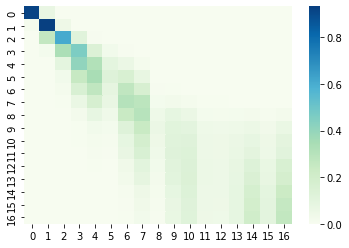

 30%|██▉       | 8.972762645914367/30 [06:52<35:37, 101.64s/it]

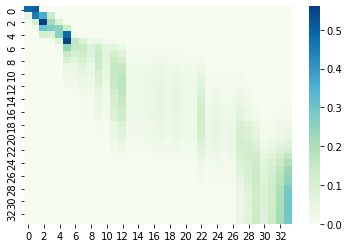

 30%|██▉       | 8.976653696498024/30 [06:52<35:13, 100.52s/it]

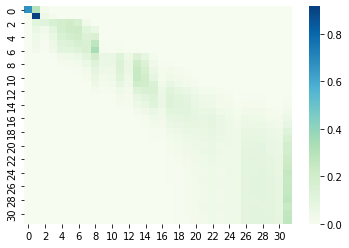

 30%|██▉       | 8.980544747081682/30 [06:52<33:55, 96.85s/it] 

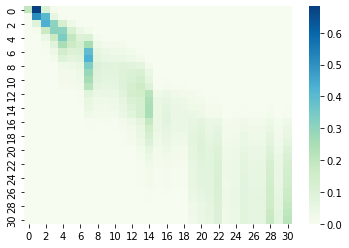

 30%|██▉       | 8.98443579766534/30 [06:53<34:08, 97.50s/it] 

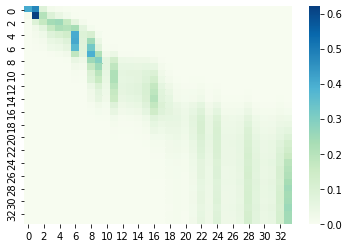

 30%|██▉       | 8.988326848248997/30 [06:53<34:16, 97.88s/it]

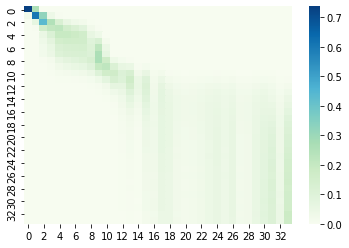

 30%|██▉       | 8.992217898832655/30 [06:54<35:41, 101.96s/it]

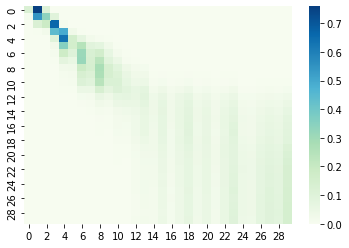

 30%|██▉       | 8.996108949416312/30 [06:54<41:09, 117.56s/it]

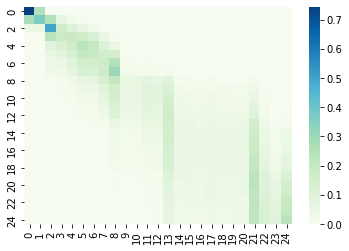

 30%|██▉       | 8.99999999999997/30 [06:55<41:02, 117.27s/it] 

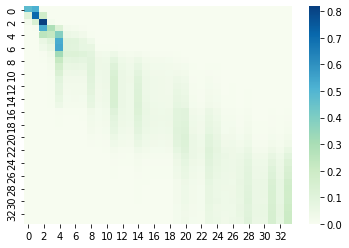

 32%|███▏      | 9.614785992217866/30 [07:10<08:26, 24.85s/it]

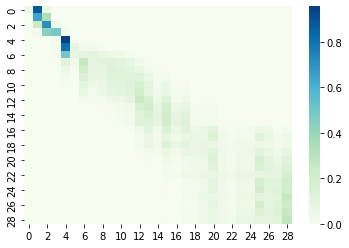

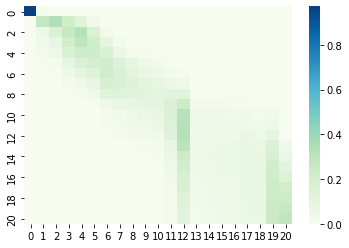

 32%|███▏      | 9.622568093385182/30 [07:11<14:38, 43.10s/it]

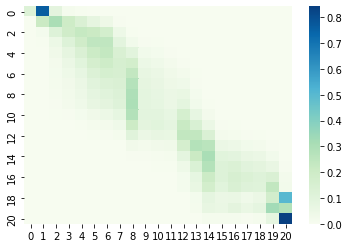

 32%|███▏      | 9.62645914396884/30 [07:12<17:37, 51.92s/it] 

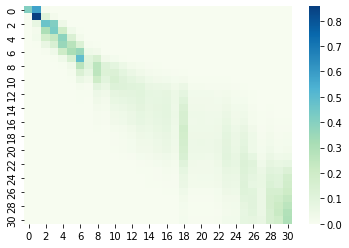

 32%|███▏      | 9.630350194552497/30 [07:12<20:53, 61.55s/it]

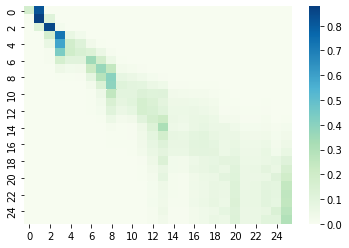

 32%|███▏      | 9.634241245136154/30 [07:12<23:10, 68.26s/it]

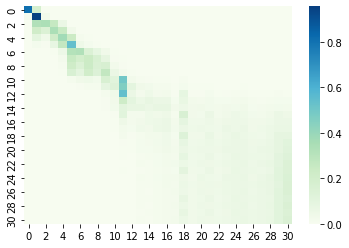

 32%|███▏      | 9.638132295719812/30 [07:13<24:59, 73.67s/it]

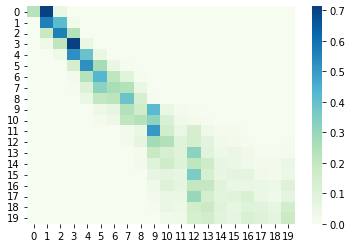

 32%|███▏      | 9.64202334630347/30 [07:13<27:38, 81.48s/it] 

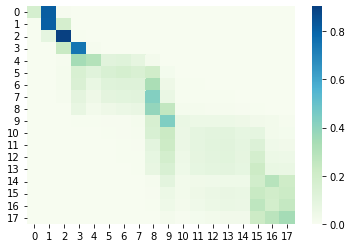

 32%|███▏      | 9.645914396887127/30 [07:13<29:54, 88.17s/it]

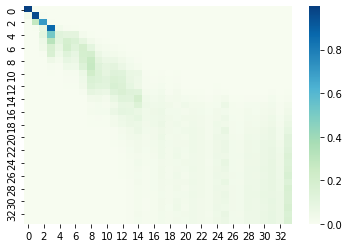

 32%|███▏      | 9.649805447470785/30 [07:14<33:06, 97.60s/it]

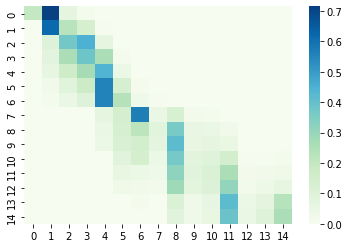

 32%|███▏      | 9.653696498054442/30 [07:14<32:11, 94.93s/it]

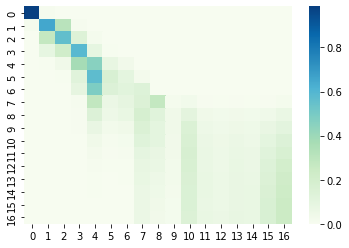

 32%|███▏      | 9.6575875486381/30 [07:15<32:06, 94.71s/it]  

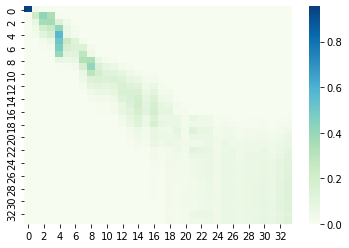

 32%|███▏      | 9.661478599221757/30 [07:15<32:13, 95.06s/it]

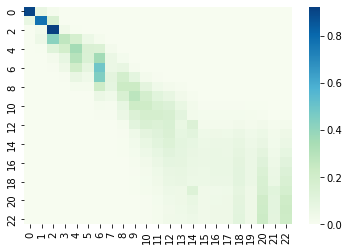

 32%|███▏      | 9.665369649805415/30 [07:15<32:36, 96.24s/it]

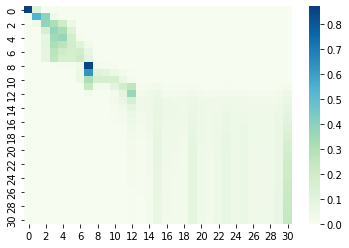

 32%|███▏      | 9.669260700389072/30 [07:16<32:16, 95.23s/it]

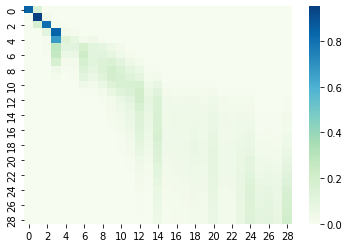

 32%|███▏      | 9.67315175097273/30 [07:16<31:41, 93.56s/it] 

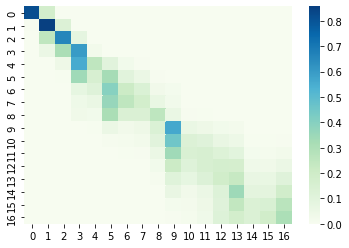

 32%|███▏      | 9.677042801556388/30 [07:16<31:47, 93.85s/it]

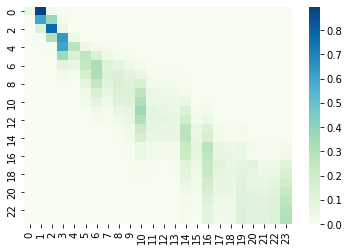

 32%|███▏      | 9.680933852140045/30 [07:17<31:32, 93.16s/it]

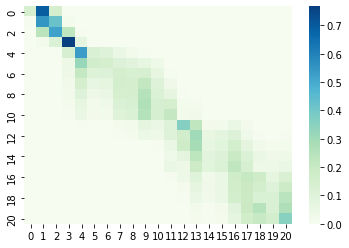

 32%|███▏      | 9.684824902723703/30 [07:17<31:56, 94.33s/it]

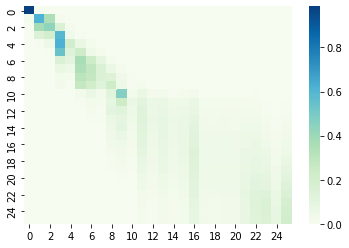

 32%|███▏      | 9.68871595330736/30 [07:17<30:33, 90.25s/it] 

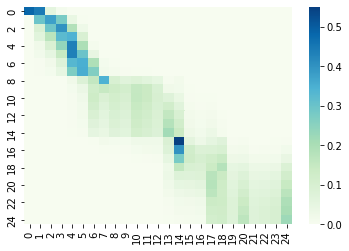

 32%|███▏      | 9.692607003891018/30 [07:18<34:00, 100.47s/it]

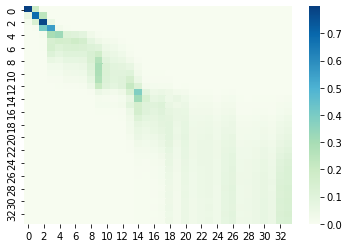

 32%|███▏      | 9.696498054474675/30 [07:18<33:36, 99.30s/it] 

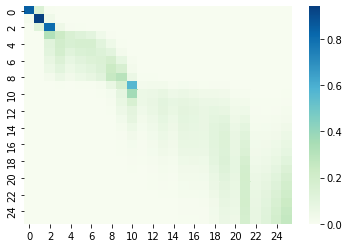

 32%|███▏      | 9.700389105058333/30 [07:19<32:18, 95.52s/it]

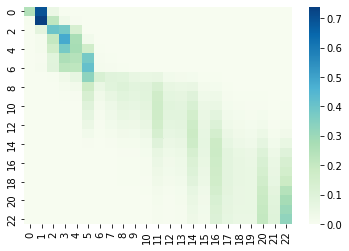

 32%|███▏      | 9.70428015564199/30 [07:19<31:58, 94.51s/it] 

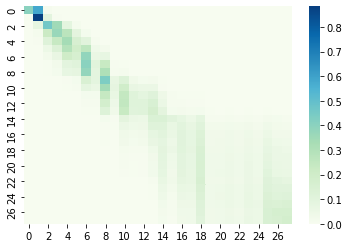

 32%|███▏      | 9.708171206225648/30 [07:19<31:17, 92.52s/it]

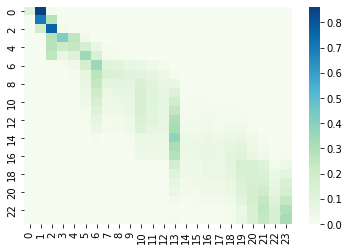

 32%|███▏      | 9.712062256809306/30 [07:20<31:51, 94.21s/it]

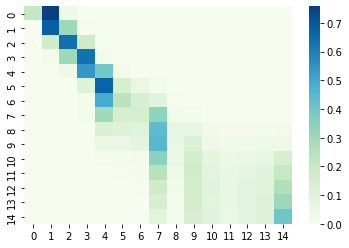

 32%|███▏      | 9.715953307392963/30 [07:20<31:19, 92.65s/it]

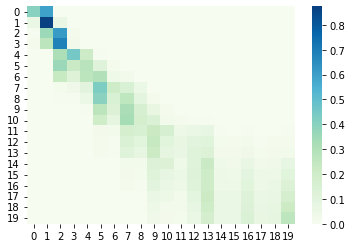

 32%|███▏      | 9.719844357976621/30 [07:21<33:00, 97.67s/it]

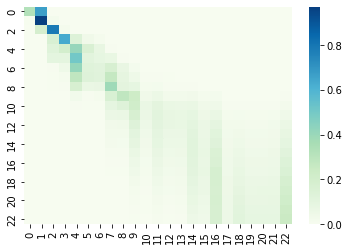

 32%|███▏      | 9.723735408560279/30 [07:21<32:28, 96.07s/it]

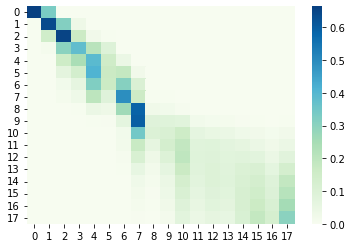

 32%|███▏      | 9.727626459143936/30 [07:21<32:56, 97.47s/it]

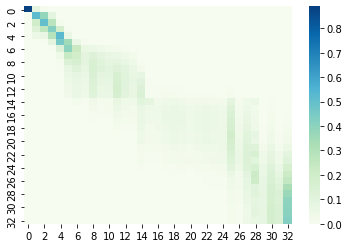

 32%|███▏      | 9.731517509727594/30 [07:22<32:34, 96.42s/it]

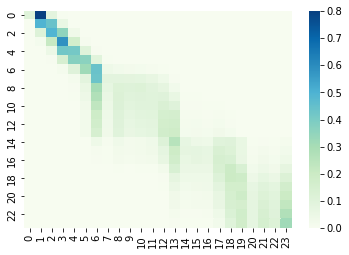

 32%|███▏      | 9.735408560311251/30 [07:22<35:37, 105.48s/it]

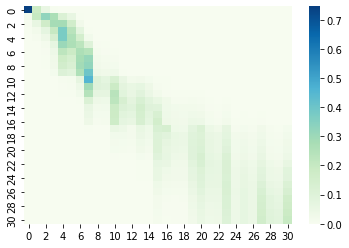

 32%|███▏      | 9.739299610894909/30 [07:23<34:45, 102.94s/it]

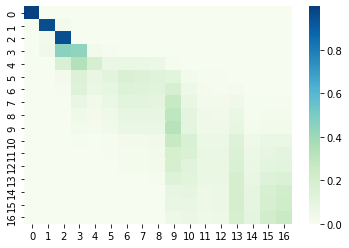

 32%|███▏      | 9.743190661478566/30 [07:23<32:50, 97.29s/it] 

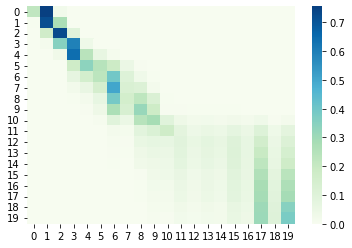

 32%|███▏      | 9.747081712062224/30 [07:23<33:47, 100.13s/it]

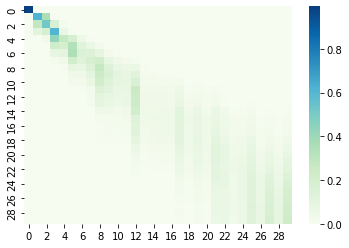

 33%|███▎      | 9.750972762645882/30 [07:24<32:20, 95.83s/it] 

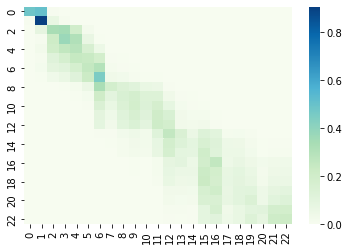

 33%|███▎      | 9.754863813229539/30 [07:24<32:12, 95.44s/it]

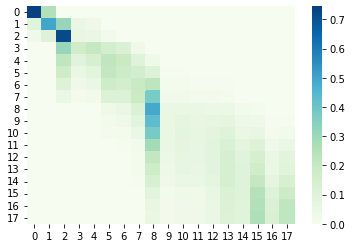

 33%|███▎      | 9.758754863813197/30 [07:24<32:39, 96.81s/it]

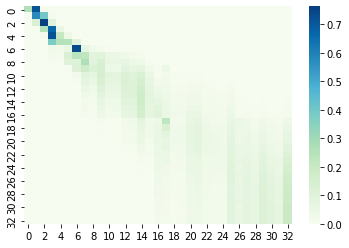

 33%|███▎      | 9.762645914396854/30 [07:25<32:22, 95.97s/it]

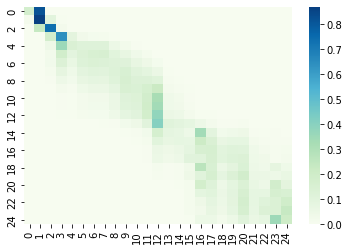

 33%|███▎      | 9.766536964980512/30 [07:25<33:18, 98.79s/it]

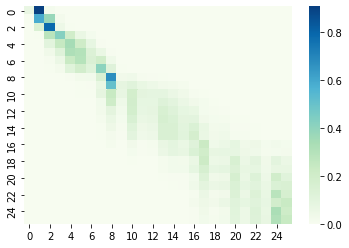

 33%|███▎      | 9.77042801556417/30 [07:25<31:16, 92.77s/it] 

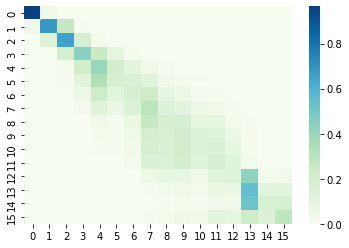

 33%|███▎      | 9.774319066147827/30 [07:26<31:18, 92.87s/it]

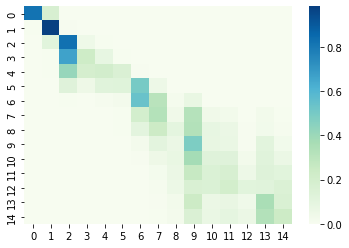

 33%|███▎      | 9.778210116731485/30 [07:26<33:24, 99.15s/it]

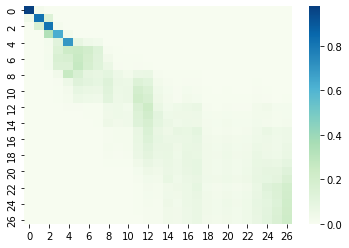

 33%|███▎      | 9.782101167315142/30 [07:27<32:34, 96.69s/it]

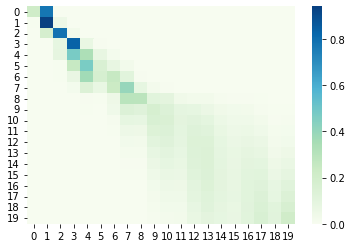

 33%|███▎      | 9.7859922178988/30 [07:27<32:16, 95.78s/it]  

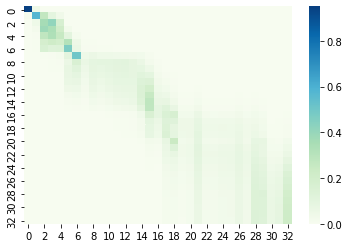

 33%|███▎      | 9.789883268482457/30 [07:27<32:02, 95.15s/it]

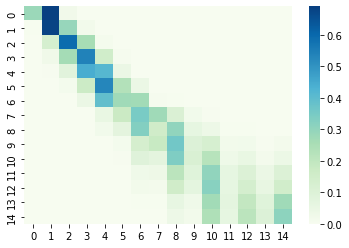

 33%|███▎      | 9.793774319066115/30 [07:28<31:38, 93.97s/it]

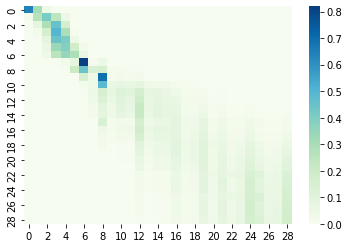

 33%|███▎      | 9.797665369649772/30 [07:28<31:36, 93.86s/it]

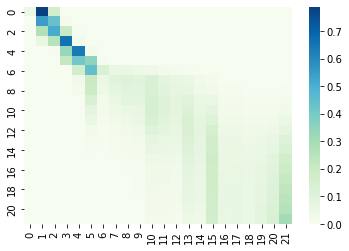

 33%|███▎      | 9.80155642023343/30 [07:28<31:39, 94.06s/it] 

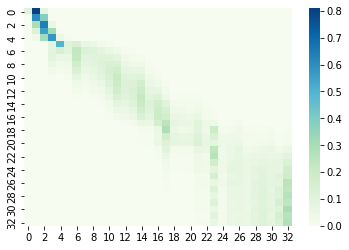

 33%|███▎      | 9.805447470817088/30 [07:29<31:52, 94.71s/it]

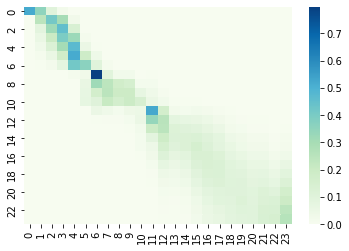

 33%|███▎      | 9.809338521400745/30 [07:29<32:23, 96.25s/it]

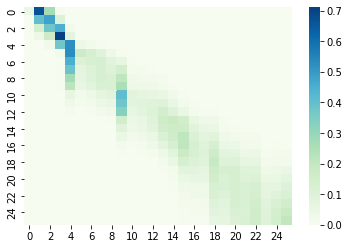

 33%|███▎      | 9.813229571984403/30 [07:30<32:19, 96.09s/it]

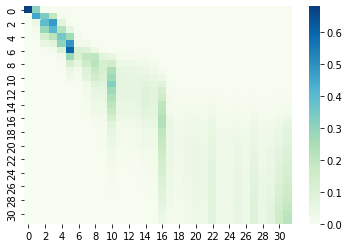

 33%|███▎      | 9.81712062256806/30 [07:30<31:42, 94.25s/it] 

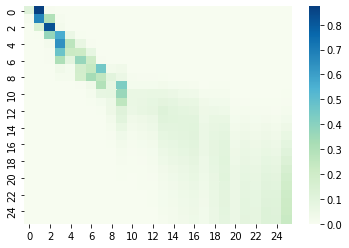

 33%|███▎      | 9.821011673151718/30 [07:30<33:12, 98.72s/it]

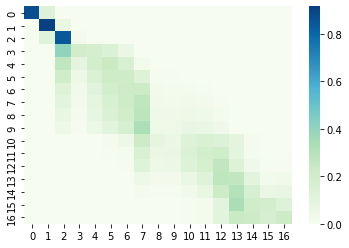

 33%|███▎      | 9.824902723735375/30 [07:31<33:36, 99.97s/it]

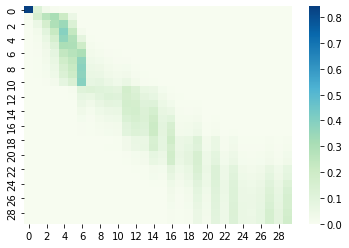

 33%|███▎      | 9.828793774319033/30 [07:31<32:47, 97.52s/it]

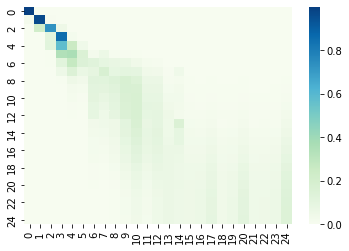

 33%|███▎      | 9.83268482490269/30 [07:31<33:06, 98.48s/it] 

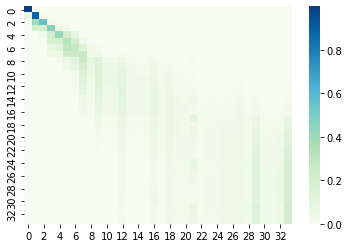

 33%|███▎      | 9.836575875486348/30 [07:32<32:18, 96.12s/it]

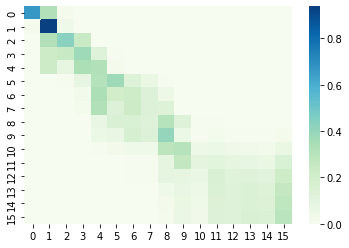

 33%|███▎      | 9.840466926070006/30 [07:32<31:50, 94.75s/it]

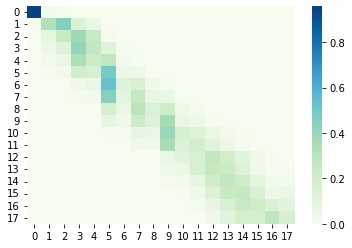

 33%|███▎      | 9.844357976653663/30 [07:33<32:40, 97.25s/it]

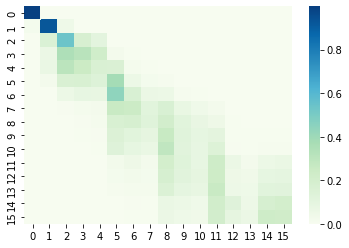

 33%|███▎      | 9.84824902723732/30 [07:33<32:24, 96.49s/it] 

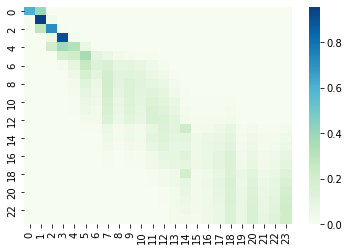

 33%|███▎      | 9.852140077820978/30 [07:33<32:37, 97.18s/it]

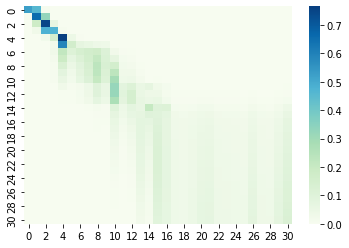

 33%|███▎      | 9.856031128404636/30 [07:34<33:17, 99.14s/it]

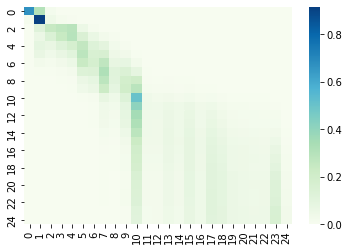

 33%|███▎      | 9.859922178988294/30 [07:34<33:38, 100.23s/it]

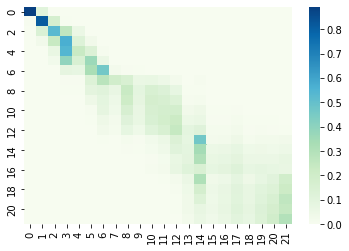

 33%|███▎      | 9.863813229571951/30 [07:35<36:02, 107.41s/it]

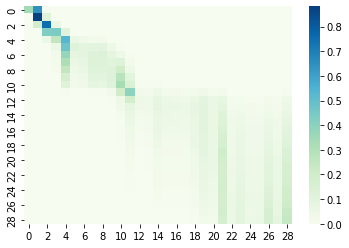

 33%|███▎      | 9.867704280155609/30 [07:35<34:34, 103.06s/it]

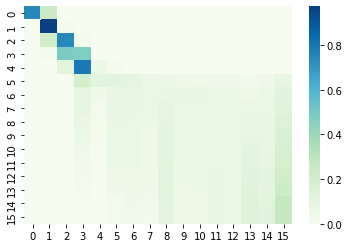

 33%|███▎      | 9.871595330739266/30 [07:35<32:43, 97.57s/it] 

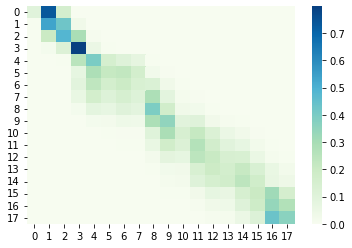

 33%|███▎      | 9.875486381322924/30 [07:36<33:15, 99.18s/it]

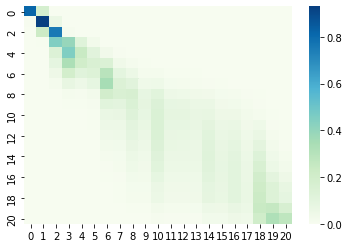

 33%|███▎      | 9.879377431906581/30 [07:36<32:11, 95.99s/it]

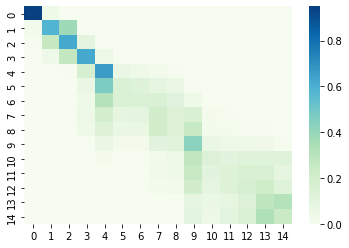

 33%|███▎      | 9.883268482490239/30 [07:36<31:13, 93.11s/it]

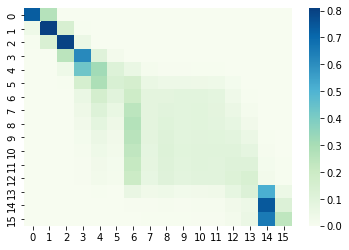

 33%|███▎      | 9.887159533073897/30 [07:37<31:50, 94.98s/it]

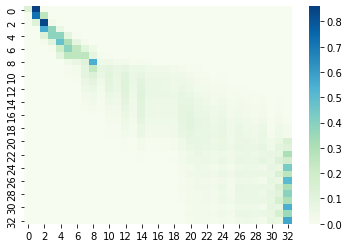

 33%|███▎      | 9.891050583657554/30 [07:37<31:49, 94.95s/it]

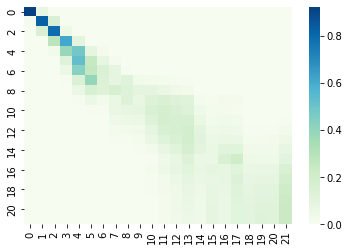

 33%|███▎      | 9.894941634241212/30 [07:38<31:45, 94.78s/it]

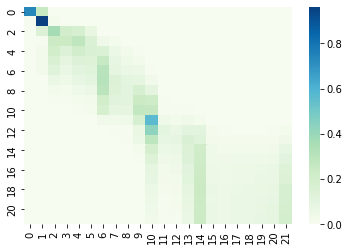

 33%|███▎      | 9.89883268482487/30 [07:38<31:55, 95.30s/it] 

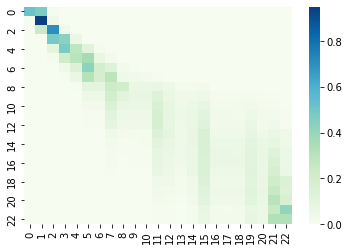

 33%|███▎      | 9.902723735408527/30 [07:38<32:03, 95.70s/it]

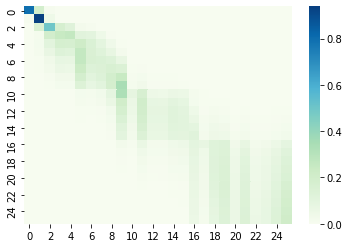

 33%|███▎      | 9.906614785992184/30 [07:39<33:15, 99.29s/it]

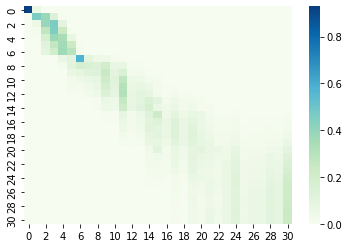

 33%|███▎      | 9.910505836575842/30 [07:39<31:57, 95.43s/it]

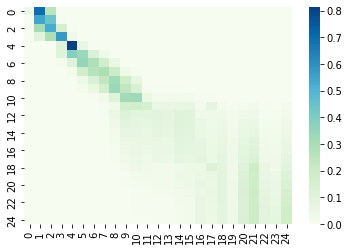

 33%|███▎      | 9.9143968871595/30 [07:39<32:34, 97.30s/it]  

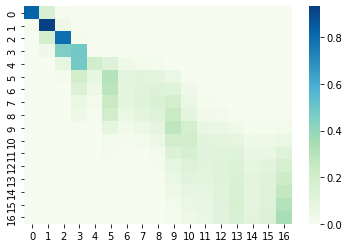

 33%|███▎      | 9.918287937743157/30 [07:40<33:11, 99.15s/it]

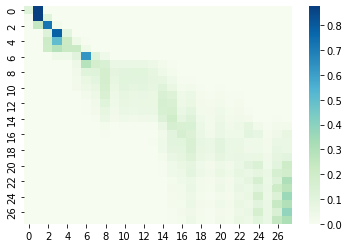

 33%|███▎      | 9.922178988326815/30 [07:40<32:12, 96.24s/it]

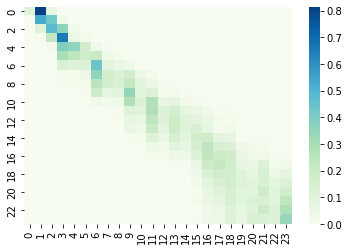

 33%|███▎      | 9.926070038910472/30 [07:41<32:36, 97.46s/it]

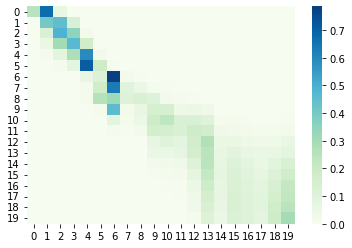

 33%|███▎      | 9.92996108949413/30 [07:41<32:51, 98.24s/it] 

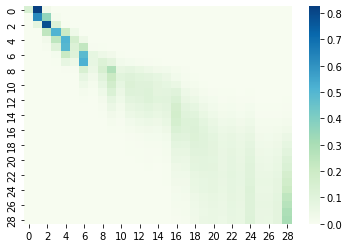

 33%|███▎      | 9.933852140077787/30 [07:41<32:48, 98.09s/it]

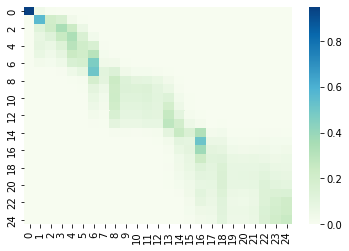

 33%|███▎      | 9.937743190661445/30 [07:42<33:20, 99.74s/it]

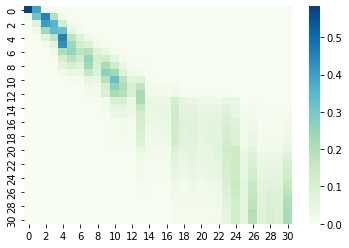

 33%|███▎      | 9.941634241245103/30 [07:42<32:38, 97.62s/it]

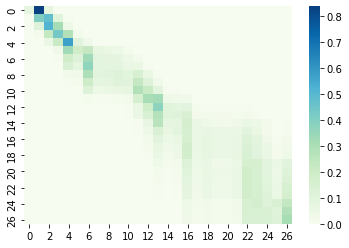

 33%|███▎      | 9.94552529182876/30 [07:42<32:14, 96.47s/it] 

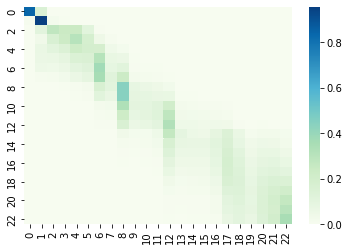

 33%|███▎      | 9.949416342412418/30 [07:43<35:44, 106.95s/it]

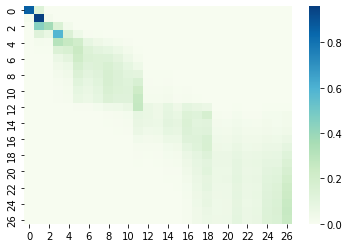

 33%|███▎      | 9.953307392996075/30 [07:43<32:43, 97.93s/it] 

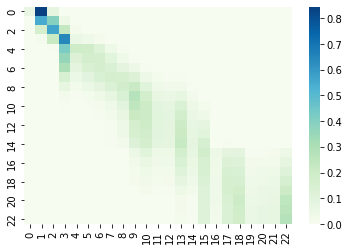

 33%|███▎      | 9.957198443579733/30 [07:44<32:45, 98.07s/it]

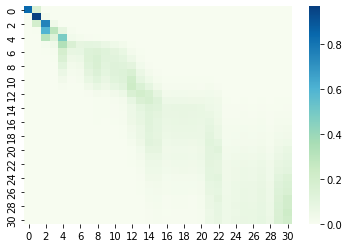

 33%|███▎      | 9.96108949416339/30 [07:44<32:19, 96.80s/it] 

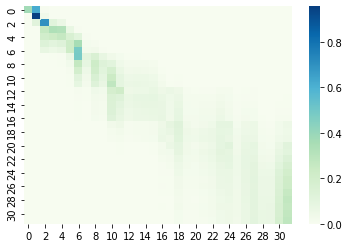

 33%|███▎      | 9.964980544747048/30 [07:44<31:44, 95.07s/it]

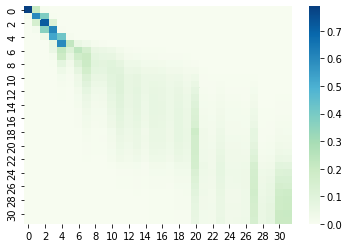

 33%|███▎      | 9.968871595330706/30 [07:45<31:57, 95.74s/it]

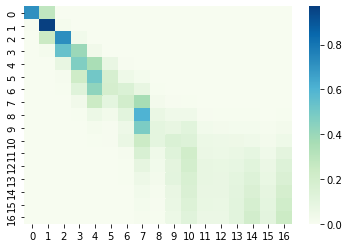

 33%|███▎      | 9.972762645914363/30 [07:45<32:14, 96.60s/it]

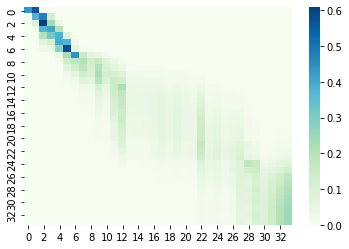

 33%|███▎      | 9.97665369649802/30 [07:46<32:13, 96.55s/it] 

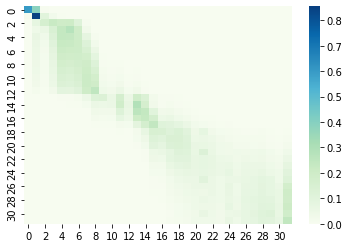

 33%|███▎      | 9.980544747081678/30 [07:46<32:20, 96.95s/it]

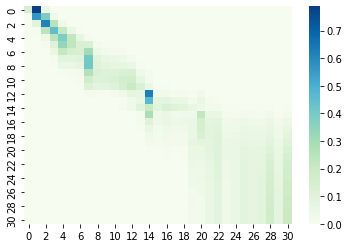

 33%|███▎      | 9.984435797665336/30 [07:46<32:26, 97.27s/it]

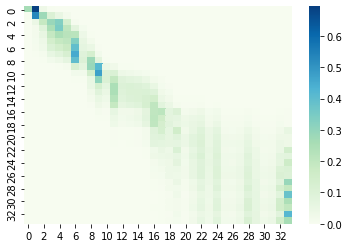

 33%|███▎      | 9.988326848248994/30 [07:47<32:34, 97.67s/it]

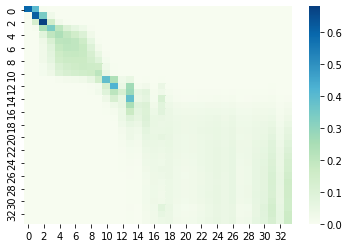

 33%|███▎      | 9.992217898832651/30 [07:47<35:34, 106.70s/it]

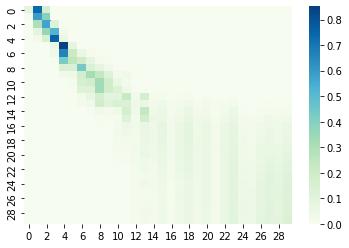

 33%|███▎      | 9.996108949416309/30 [07:48<35:04, 105.19s/it]

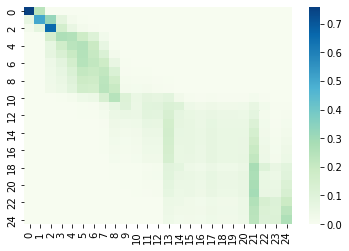

 33%|███▎      | 9.999999999999966/30 [07:48<36:59, 110.98s/it]

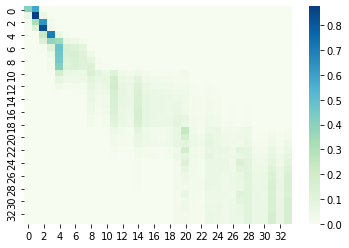

 35%|███▌      | 10.614785992217863/30 [08:04<08:38, 26.75s/it]

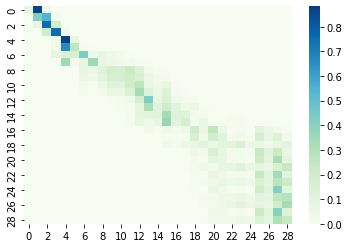

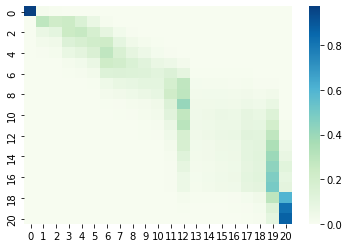

 35%|███▌      | 10.622568093385178/30 [08:05<16:26, 50.89s/it]

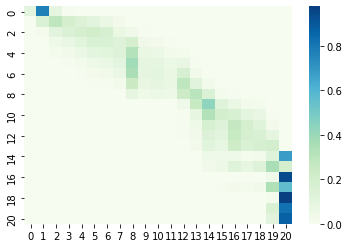

 35%|███▌      | 10.626459143968836/30 [08:05<19:01, 58.91s/it]

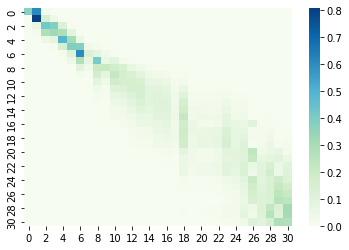

 35%|███▌      | 10.630350194552493/30 [08:05<22:01, 68.25s/it]

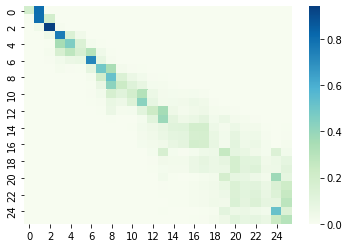

 35%|███▌      | 10.63424124513615/30 [08:06<23:05, 71.54s/it] 

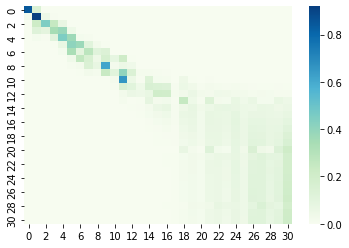

 35%|███▌      | 10.638132295719808/30 [08:06<24:42, 76.58s/it]

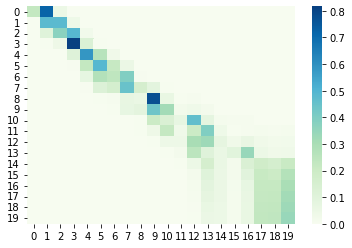

 35%|███▌      | 10.642023346303466/30 [08:07<28:13, 87.49s/it]

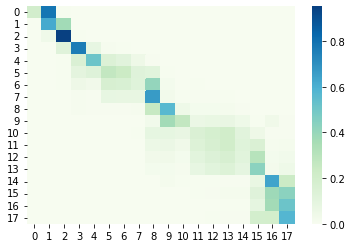

 35%|███▌      | 10.645914396887123/30 [08:07<33:31, 103.95s/it]

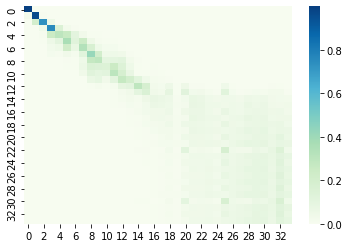

 35%|███▌      | 10.649805447470781/30 [08:08<33:21, 103.46s/it]

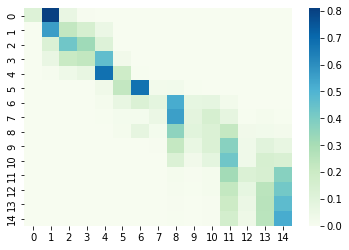

 36%|███▌      | 10.653696498054439/30 [08:08<31:40, 98.22s/it] 

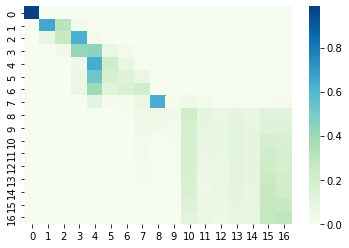

 36%|███▌      | 10.657587548638096/30 [08:08<31:07, 96.57s/it]

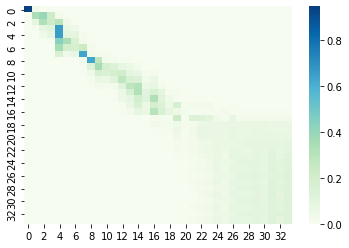

 36%|███▌      | 10.661478599221754/30 [08:09<31:10, 96.74s/it]

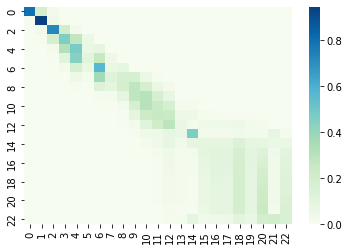

 36%|███▌      | 10.665369649805411/30 [08:09<32:06, 99.62s/it]

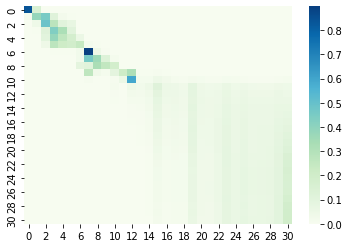

 36%|███▌      | 10.669260700389069/30 [08:09<31:51, 98.88s/it]

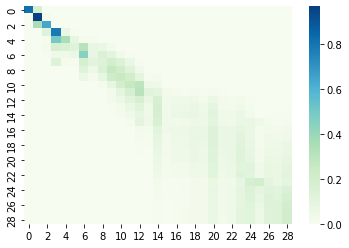

 36%|███▌      | 10.673151750972727/30 [08:10<30:07, 93.51s/it]

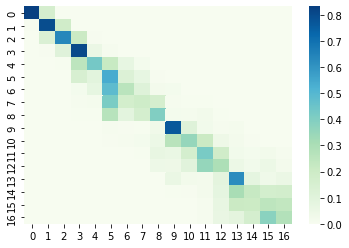

 36%|███▌      | 10.677042801556384/30 [08:10<30:50, 95.78s/it]

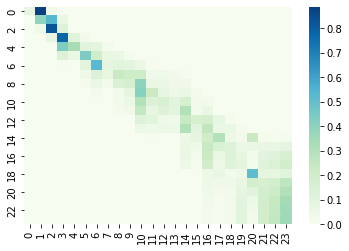

 36%|███▌      | 10.680933852140042/30 [08:11<31:40, 98.36s/it]

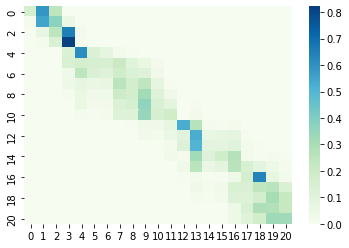

 36%|███▌      | 10.6848249027237/30 [08:11<32:25, 100.74s/it] 

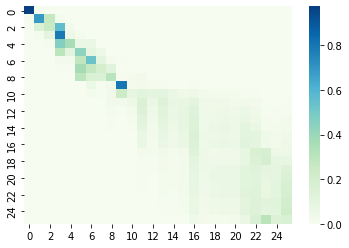

 36%|███▌      | 10.688715953307357/30 [08:11<34:54, 108.45s/it]

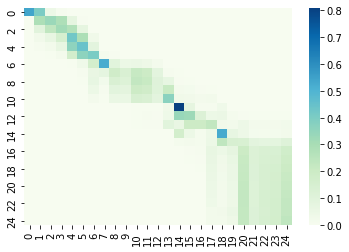

 36%|███▌      | 10.692607003891014/30 [08:12<34:48, 108.17s/it]

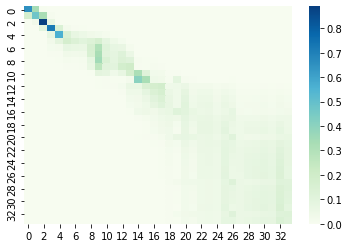

 36%|███▌      | 10.696498054474672/30 [08:12<33:53, 105.36s/it]

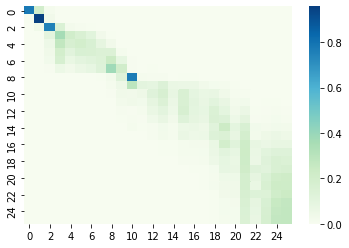

 36%|███▌      | 10.70038910505833/30 [08:13<32:31, 101.13s/it] 

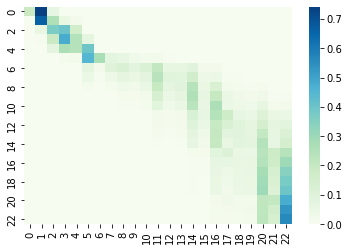

 36%|███▌      | 10.704280155641987/30 [08:13<31:56, 99.34s/it]

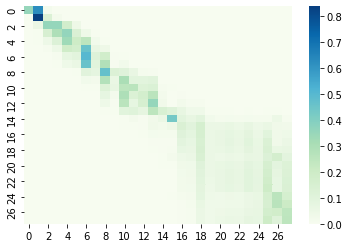

 36%|███▌      | 10.708171206225645/30 [08:13<32:03, 99.71s/it]

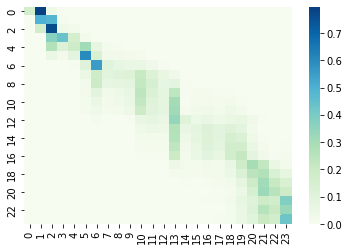

 36%|███▌      | 10.712062256809302/30 [08:14<32:19, 100.56s/it]

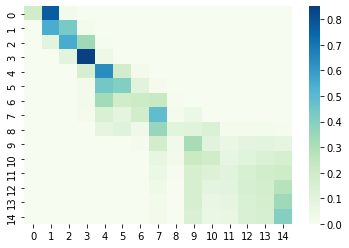

 36%|███▌      | 10.71595330739296/30 [08:14<31:03, 96.65s/it]  

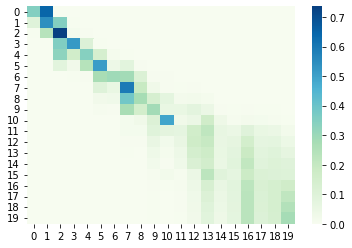

 36%|███▌      | 10.719844357976617/30 [08:15<33:18, 103.65s/it]

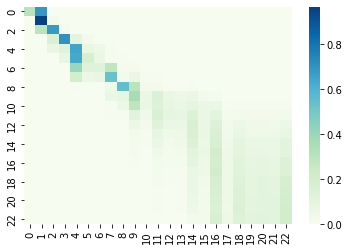

 36%|███▌      | 10.723735408560275/30 [08:15<32:25, 100.94s/it]

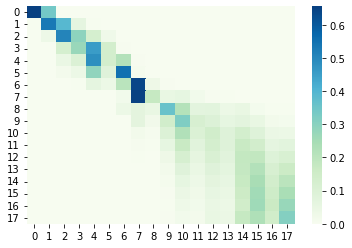

 36%|███▌      | 10.727626459143933/30 [08:15<32:27, 101.05s/it]

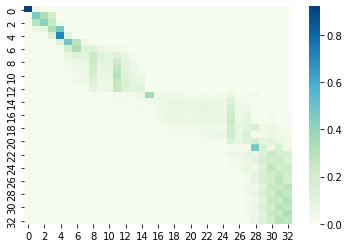

 36%|███▌      | 10.73151750972759/30 [08:16<34:38, 107.88s/it] 

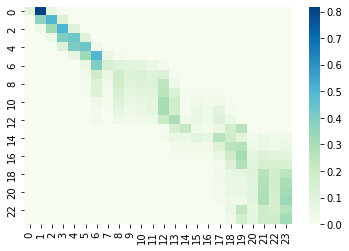

 36%|███▌      | 10.735408560311248/30 [08:16<34:08, 106.36s/it]

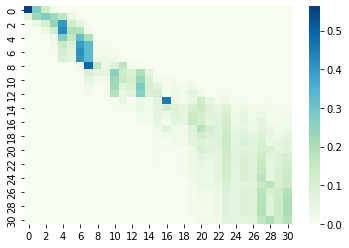

 36%|███▌      | 10.739299610894905/30 [08:17<33:04, 103.05s/it]

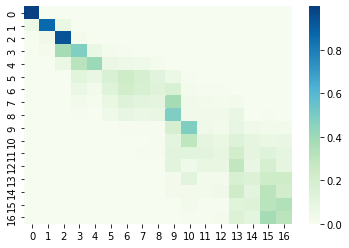

 36%|███▌      | 10.743190661478563/30 [08:17<32:08, 100.16s/it]

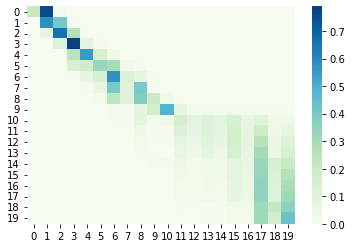

 36%|███▌      | 10.74708171206222/30 [08:17<32:48, 102.22s/it] 

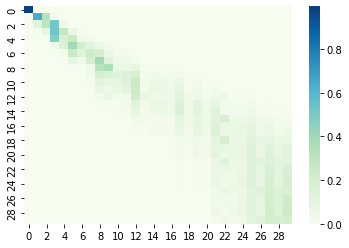

 36%|███▌      | 10.750972762645878/30 [08:18<31:00, 96.65s/it]

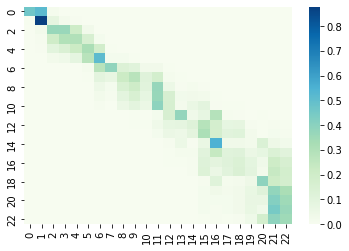

 36%|███▌      | 10.754863813229536/30 [08:18<31:20, 97.71s/it]

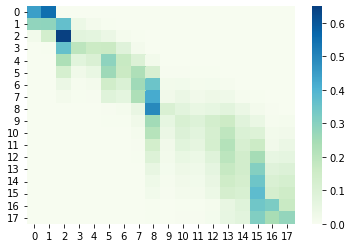

 36%|███▌      | 10.758754863813193/30 [08:19<32:24, 101.05s/it]

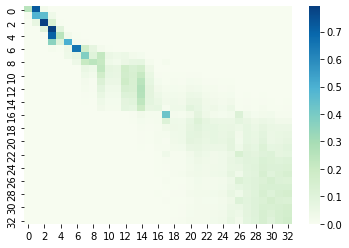

 36%|███▌      | 10.76264591439685/30 [08:19<32:16, 100.66s/it] 

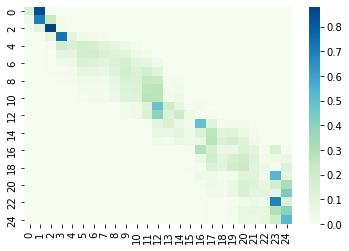

 36%|███▌      | 10.766536964980508/30 [08:19<32:02, 99.93s/it]

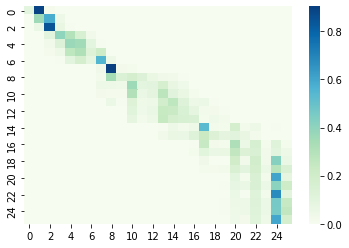

 36%|███▌      | 10.770428015564166/30 [08:20<30:46, 96.03s/it]

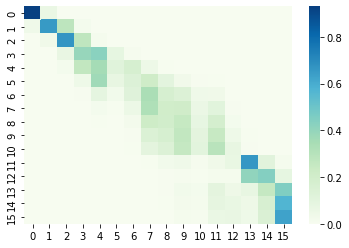

 36%|███▌      | 10.774319066147823/30 [08:20<32:58, 102.90s/it]

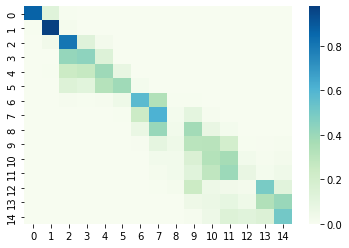

 36%|███▌      | 10.778210116731481/30 [08:20<32:20, 100.97s/it]

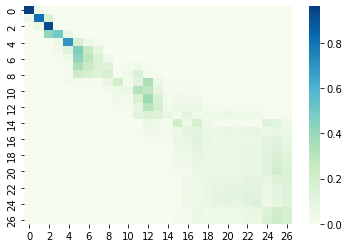

 36%|███▌      | 10.782101167315139/30 [08:21<30:16, 94.54s/it] 

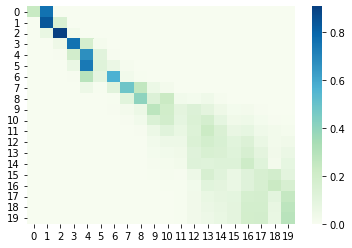

 36%|███▌      | 10.785992217898796/30 [08:21<31:28, 98.27s/it]

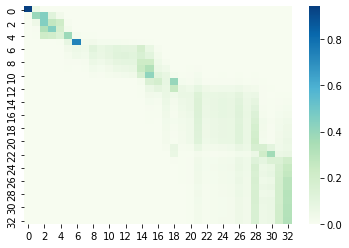

 36%|███▌      | 10.789883268482454/30 [08:22<31:15, 97.61s/it]

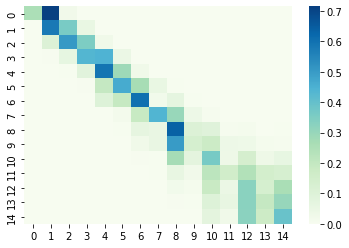

 36%|███▌      | 10.793774319066111/30 [08:22<29:54, 93.45s/it]

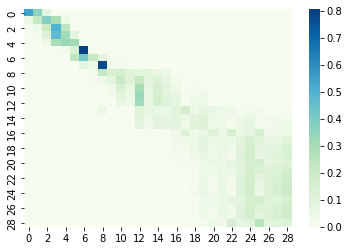

 36%|███▌      | 10.797665369649769/30 [08:22<30:27, 95.19s/it]

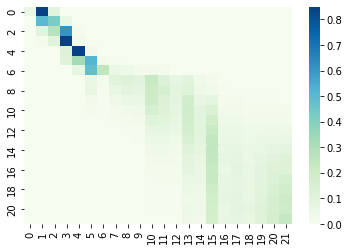

 36%|███▌      | 10.801556420233426/30 [08:23<31:35, 98.72s/it]

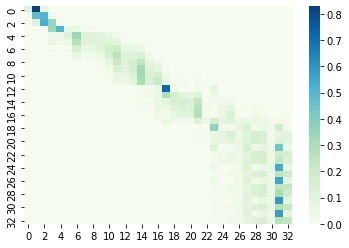

 36%|███▌      | 10.805447470817084/30 [08:23<31:35, 98.74s/it]

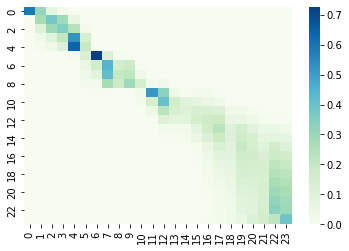

 36%|███▌      | 10.809338521400742/30 [08:23<31:44, 99.24s/it]

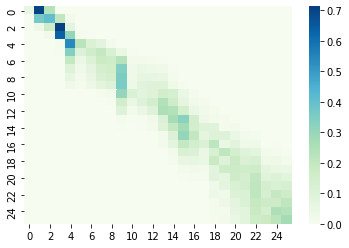

 36%|███▌      | 10.8132295719844/30 [08:24<30:53, 96.62s/it]  

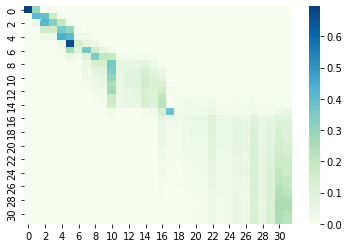

 36%|███▌      | 10.817120622568057/30 [08:24<33:08, 103.66s/it]

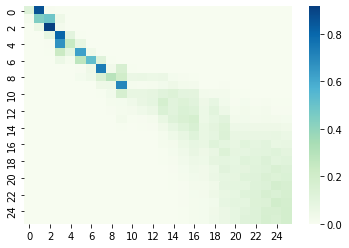

 36%|███▌      | 10.821011673151714/30 [08:25<31:40, 99.07s/it] 

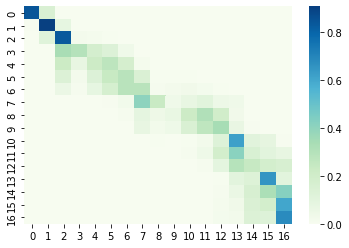

 36%|███▌      | 10.824902723735372/30 [08:25<31:23, 98.23s/it]

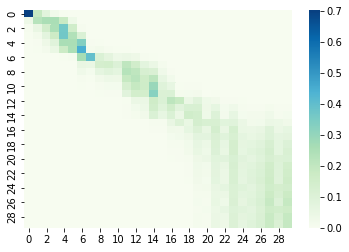

 36%|███▌      | 10.82879377431903/30 [08:25<31:33, 98.77s/it] 

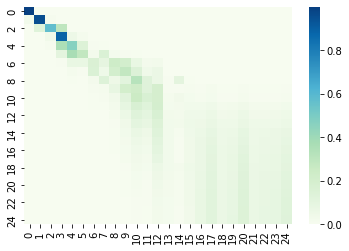

 36%|███▌      | 10.832684824902687/30 [08:26<32:11, 100.78s/it]

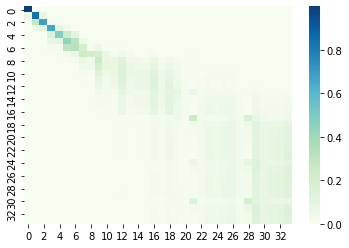

 36%|███▌      | 10.836575875486345/30 [08:26<31:15, 97.89s/it] 

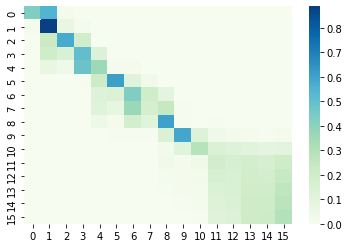

 36%|███▌      | 10.840466926070002/30 [08:27<30:25, 95.29s/it]

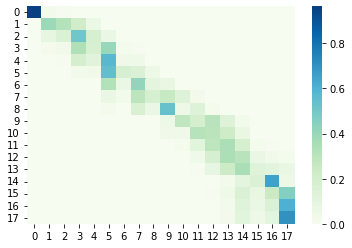

 36%|███▌      | 10.84435797665366/30 [08:27<31:01, 97.18s/it] 

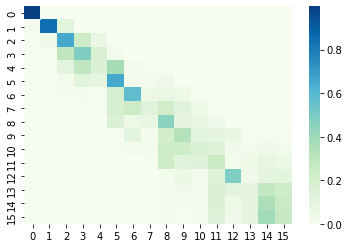

 36%|███▌      | 10.848249027237317/30 [08:27<30:28, 95.46s/it]

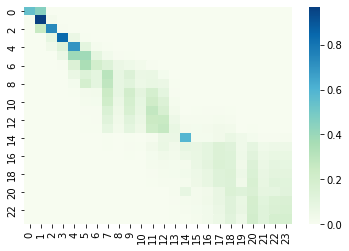

 36%|███▌      | 10.852140077820975/30 [08:28<31:07, 97.55s/it]

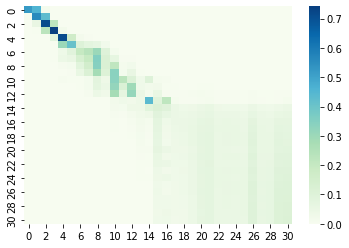

 36%|███▌      | 10.856031128404632/30 [08:28<30:01, 94.09s/it]

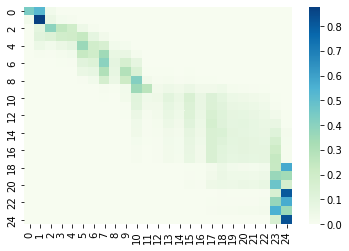

 36%|███▌      | 10.85992217898829/30 [08:28<32:57, 103.33s/it]

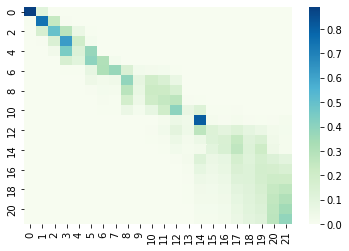

 36%|███▌      | 10.863813229571948/30 [08:29<33:02, 103.59s/it]

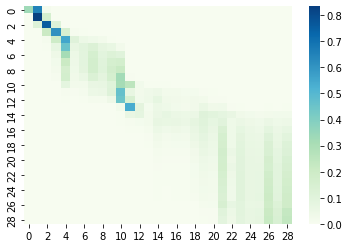

 36%|███▌      | 10.867704280155605/30 [08:29<31:23, 98.47s/it] 

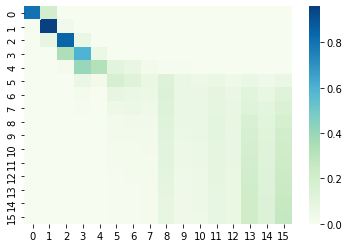

 36%|███▌      | 10.871595330739263/30 [08:30<30:31, 95.74s/it]

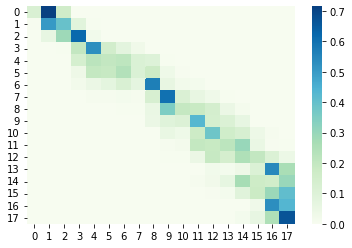

 36%|███▋      | 10.87548638132292/30 [08:30<31:36, 99.14s/it] 

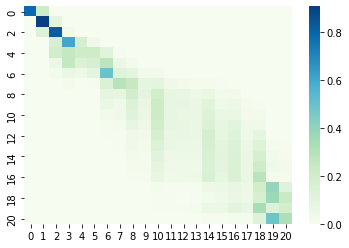

 36%|███▋      | 10.879377431906578/30 [08:30<30:37, 96.09s/it]

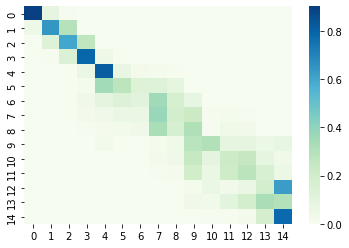

 36%|███▋      | 10.883268482490235/30 [08:31<29:49, 93.61s/it]

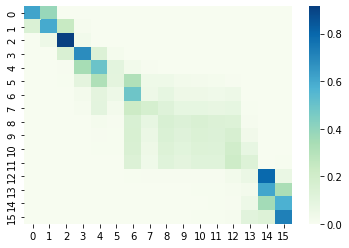

 36%|███▋      | 10.887159533073893/30 [08:31<29:18, 91.98s/it]

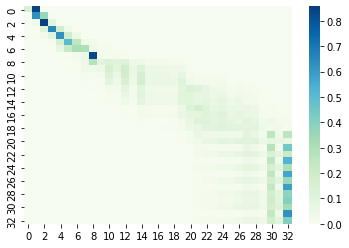

 36%|███▋      | 10.89105058365755/30 [08:31<30:21, 95.30s/it] 

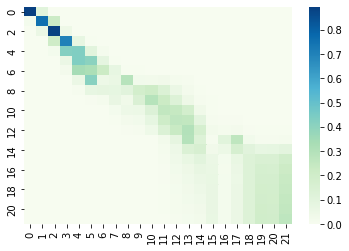

 36%|███▋      | 10.894941634241208/30 [08:32<30:43, 96.51s/it]

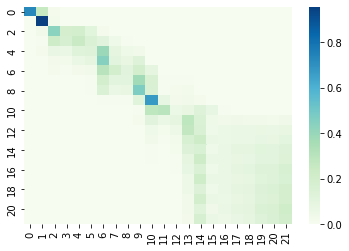

 36%|███▋      | 10.898832684824866/30 [08:32<30:02, 94.39s/it]

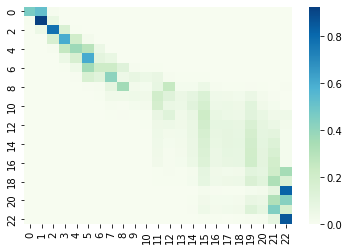

 36%|███▋      | 10.902723735408523/30 [08:33<33:54, 106.51s/it]

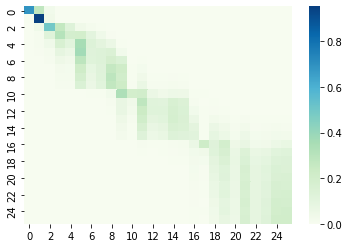

 36%|███▋      | 10.906614785992181/30 [08:33<31:07, 97.80s/it] 

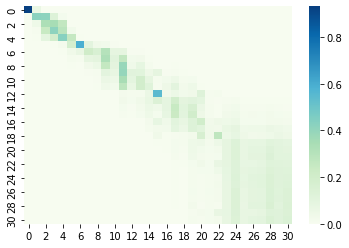

 36%|███▋      | 10.910505836575839/30 [08:33<30:33, 96.04s/it]

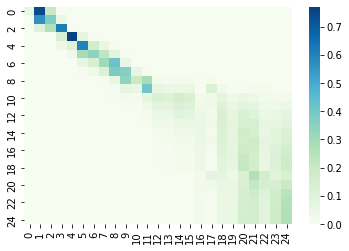

 36%|███▋      | 10.914396887159496/30 [08:34<30:50, 96.94s/it]

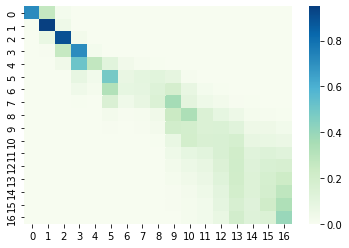

 36%|███▋      | 10.918287937743154/30 [08:34<30:38, 96.34s/it]

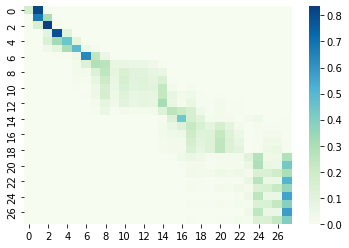

 36%|███▋      | 10.922178988326811/30 [08:34<30:23, 95.60s/it]

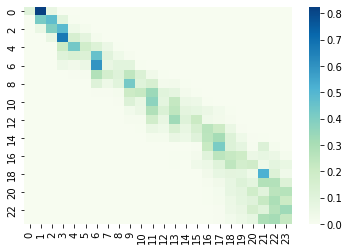

 36%|███▋      | 10.926070038910469/30 [08:35<31:23, 98.75s/it]

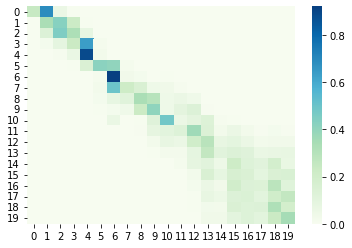

 36%|███▋      | 10.929961089494126/30 [08:35<31:48, 100.07s/it]

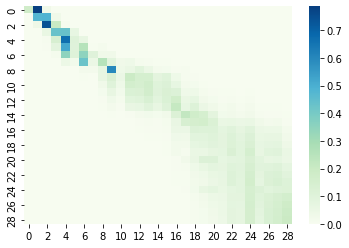

 36%|███▋      | 10.933852140077784/30 [08:36<30:33, 96.18s/it] 

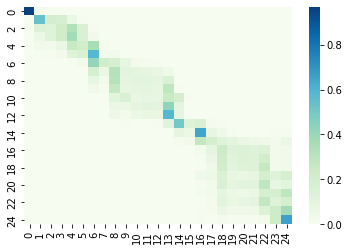

 36%|███▋      | 10.937743190661442/30 [08:36<30:53, 97.25s/it]

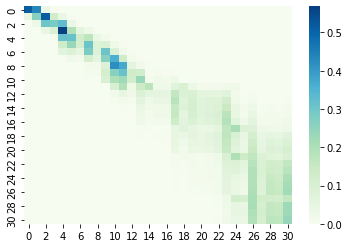

 36%|███▋      | 10.941634241245099/30 [08:36<30:04, 94.69s/it]

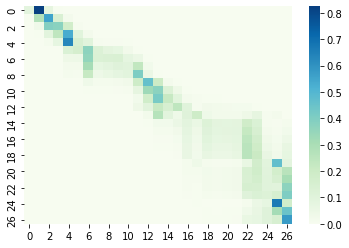

 36%|███▋      | 10.945525291828757/30 [08:37<32:32, 102.49s/it]

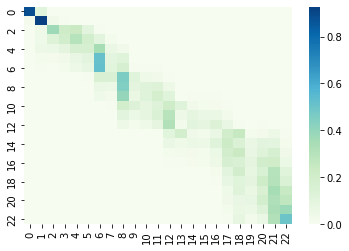

 36%|███▋      | 10.949416342412414/30 [08:37<31:34, 99.44s/it] 

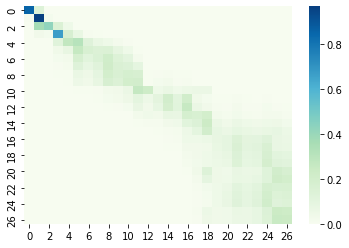

 37%|███▋      | 10.953307392996072/30 [08:38<29:49, 93.94s/it]

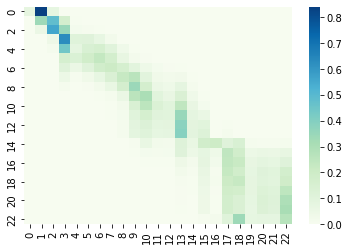

 37%|███▋      | 10.95719844357973/30 [08:38<29:55, 94.26s/it] 

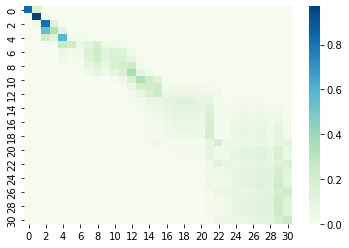

 37%|███▋      | 10.961089494163387/30 [08:38<29:46, 93.82s/it]

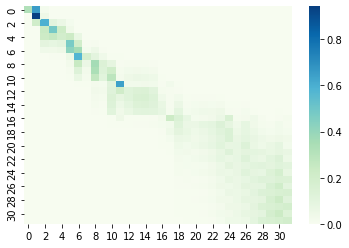

 37%|███▋      | 10.964980544747045/30 [08:39<30:16, 95.41s/it]

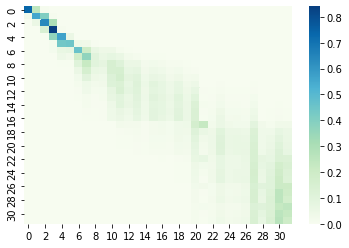

 37%|███▋      | 10.968871595330702/30 [08:39<30:44, 96.93s/it]

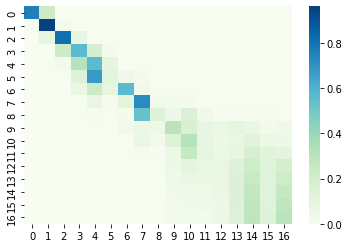

 37%|███▋      | 10.97276264591436/30 [08:39<31:10, 98.33s/it] 

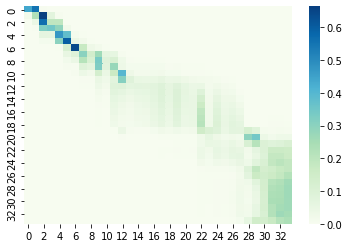

 37%|███▋      | 10.976653696498017/30 [08:40<31:13, 98.47s/it]

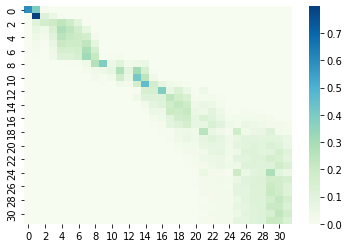

 37%|███▋      | 10.980544747081675/30 [08:40<30:25, 95.96s/it]

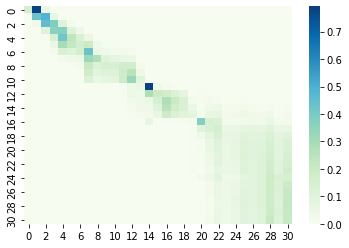

 37%|███▋      | 10.984435797665332/30 [08:41<30:43, 96.94s/it]

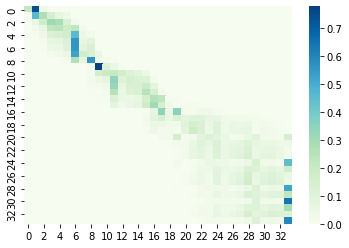

 37%|███▋      | 10.98832684824899/30 [08:41<33:23, 105.40s/it]

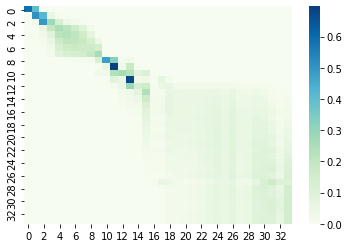

 37%|███▋      | 10.992217898832648/30 [08:41<33:21, 105.31s/it]

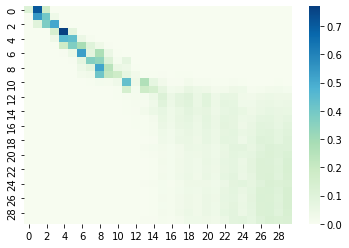

 37%|███▋      | 10.996108949416305/30 [08:42<31:00, 97.89s/it] 

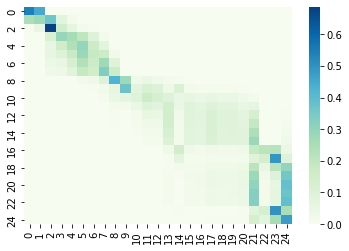

 37%|███▋      | 10.999999999999963/30 [08:42<32:27, 102.50s/it]

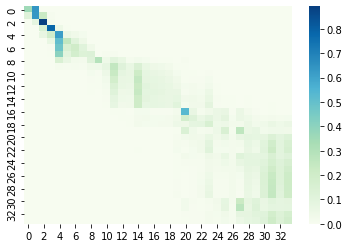

 39%|███▊      | 11.610894941634202/30 [08:58<06:44, 22.00s/it]

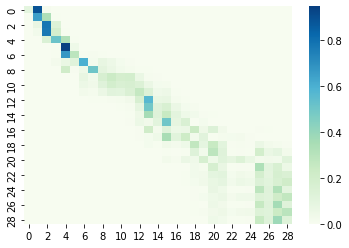

 39%|███▊      | 11.618677042801517/30 [08:59<12:02, 39.30s/it]

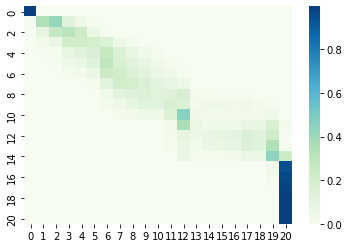

 39%|███▊      | 11.622568093385174/30 [08:59<15:11, 49.61s/it]

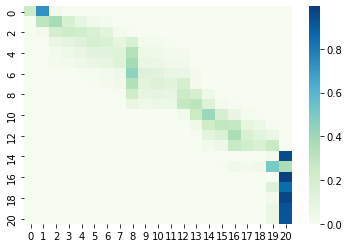

 39%|███▉      | 11.626459143968832/30 [08:59<18:00, 58.79s/it]

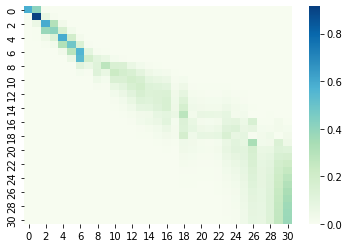

 39%|███▉      | 11.63035019455249/30 [09:00<20:56, 68.40s/it] 

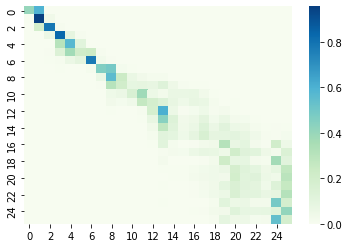

 39%|███▉      | 11.634241245136147/30 [09:00<23:10, 75.71s/it]

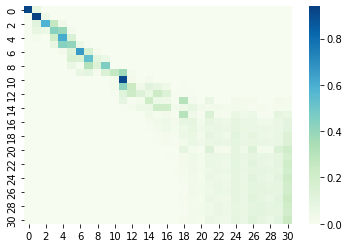

 39%|███▉      | 11.638132295719805/30 [09:01<25:13, 82.43s/it]

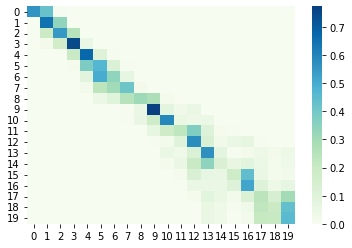

 39%|███▉      | 11.642023346303462/30 [09:01<31:48, 103.97s/it]

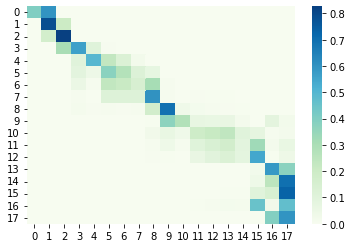

 39%|███▉      | 11.64591439688712/30 [09:02<32:02, 104.74s/it] 

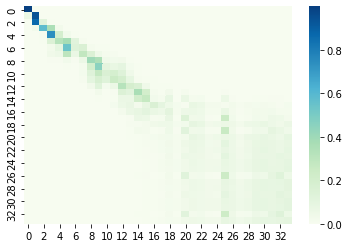

 39%|███▉      | 11.649805447470778/30 [09:02<31:35, 103.32s/it]

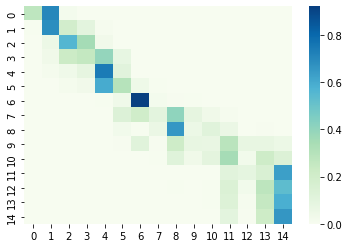

 39%|███▉      | 11.653696498054435/30 [09:02<29:38, 96.95s/it] 

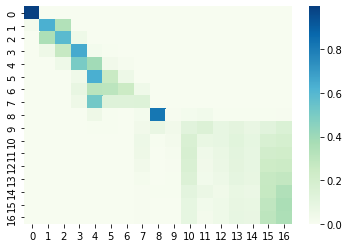

 39%|███▉      | 11.657587548638093/30 [09:03<29:52, 97.75s/it]

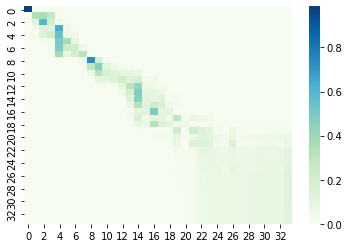

 39%|███▉      | 11.66147859922175/30 [09:03<30:04, 98.40s/it] 

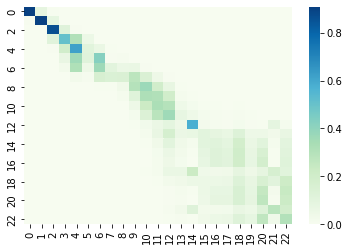

 39%|███▉      | 11.665369649805408/30 [09:03<30:14, 98.96s/it]

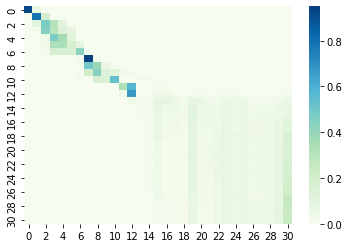

 39%|███▉      | 11.669260700389065/30 [09:04<29:09, 95.42s/it]

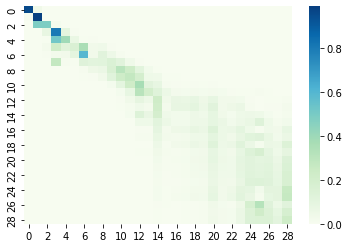

 39%|███▉      | 11.673151750972723/30 [09:04<29:20, 96.06s/it]

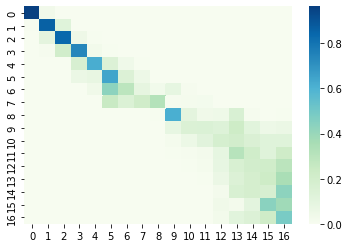

 39%|███▉      | 11.67704280155638/30 [09:05<30:03, 98.44s/it] 

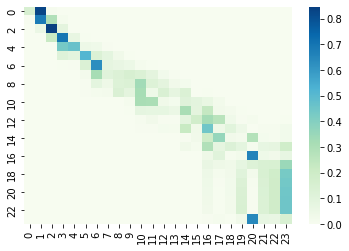

 39%|███▉      | 11.680933852140038/30 [09:05<29:45, 97.48s/it]

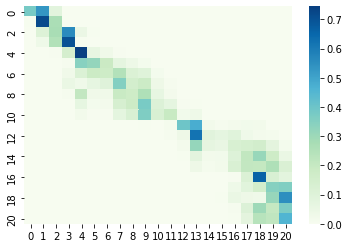

 39%|███▉      | 11.684824902723696/30 [09:06<33:38, 110.19s/it]

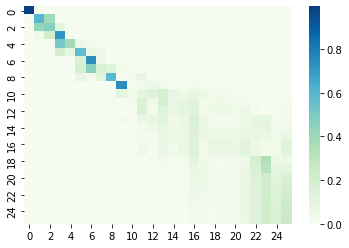

 39%|███▉      | 11.688715953307353/30 [09:06<31:13, 102.34s/it]

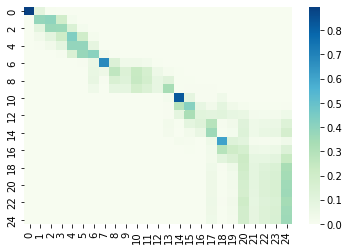

 39%|███▉      | 11.69260700389101/30 [09:06<32:45, 107.37s/it] 

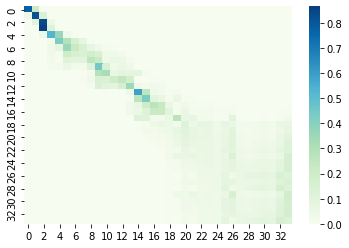

 39%|███▉      | 11.696498054474668/30 [09:07<32:54, 107.87s/it]

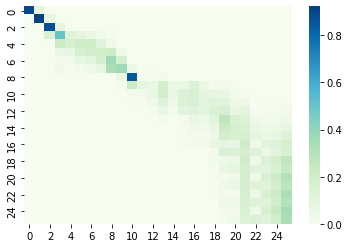

 39%|███▉      | 11.700389105058326/30 [09:07<30:07, 98.79s/it] 

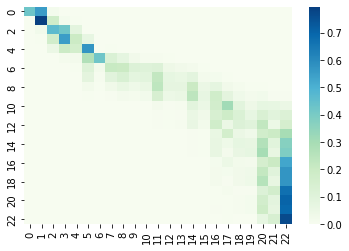

 39%|███▉      | 11.704280155641984/30 [09:07<30:00, 98.43s/it]

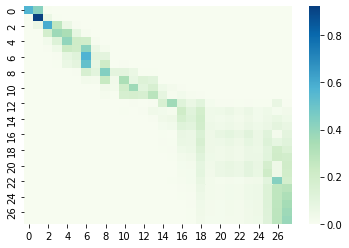

 39%|███▉      | 11.708171206225641/30 [09:08<28:48, 94.48s/it]

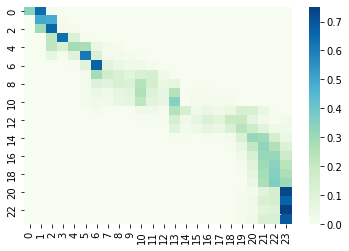

 39%|███▉      | 11.712062256809299/30 [09:08<28:53, 94.80s/it]

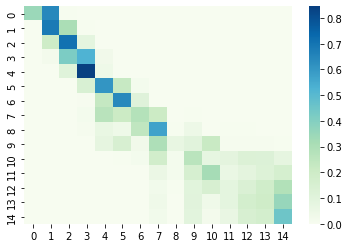

 39%|███▉      | 11.715953307392956/30 [09:08<28:22, 93.13s/it]

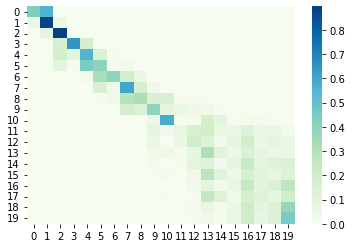

 39%|███▉      | 11.719844357976614/30 [09:09<29:06, 95.55s/it]

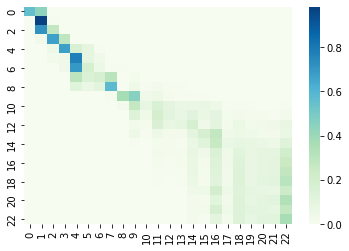

 39%|███▉      | 11.723735408560271/30 [09:09<30:09, 99.03s/it]

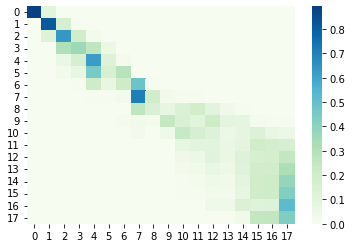

 39%|███▉      | 11.727626459143929/30 [09:10<35:04, 115.20s/it]

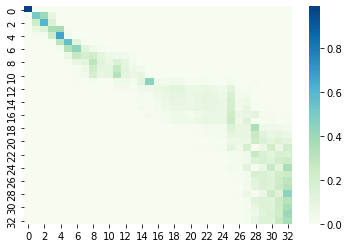

 39%|███▉      | 11.731517509727587/30 [09:10<32:51, 107.90s/it]

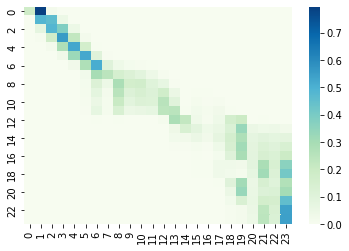

 39%|███▉      | 11.735408560311244/30 [09:11<32:17, 106.10s/it]

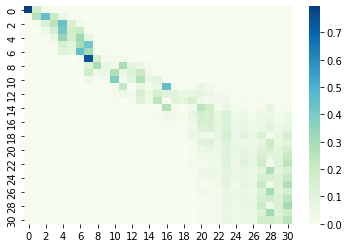

 39%|███▉      | 11.739299610894902/30 [09:11<31:47, 104.46s/it]

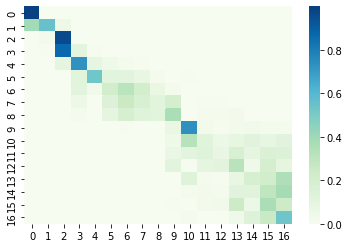

 39%|███▉      | 11.74319066147856/30 [09:11<31:09, 102.39s/it] 

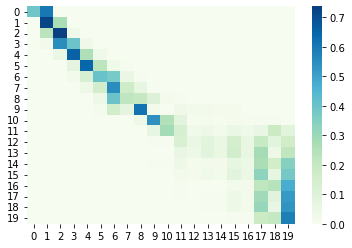

 39%|███▉      | 11.747081712062217/30 [09:12<32:22, 106.43s/it]

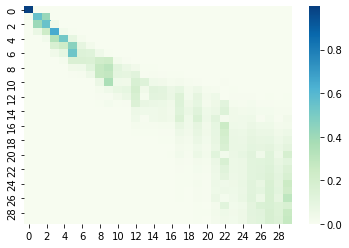

 39%|███▉      | 11.750972762645874/30 [09:12<30:36, 100.65s/it]

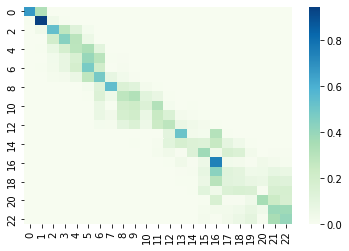

 39%|███▉      | 11.754863813229532/30 [09:13<31:15, 102.81s/it]

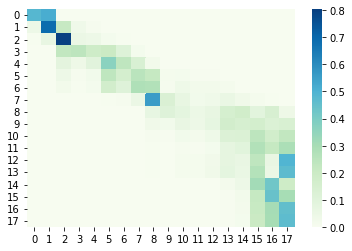

 39%|███▉      | 11.75875486381319/30 [09:13<32:21, 106.45s/it] 

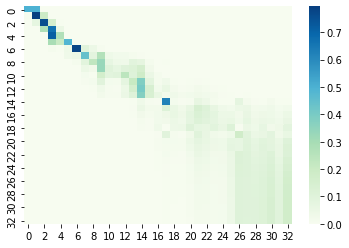

 39%|███▉      | 11.762645914396847/30 [09:13<32:36, 107.28s/it]

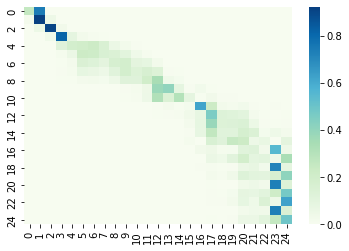

 39%|███▉      | 11.766536964980505/30 [09:14<33:02, 108.71s/it]

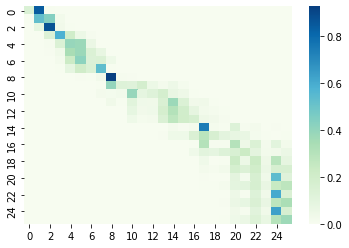

 39%|███▉      | 11.770428015564162/30 [09:14<34:45, 114.41s/it]

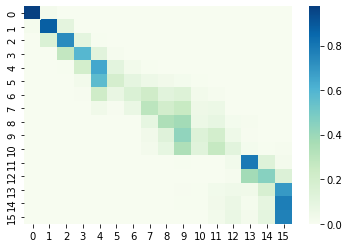

 39%|███▉      | 11.77431906614782/30 [09:15<32:06, 105.72s/it] 

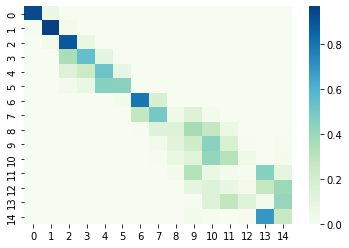

 39%|███▉      | 11.778210116731477/30 [09:15<29:44, 97.93s/it]

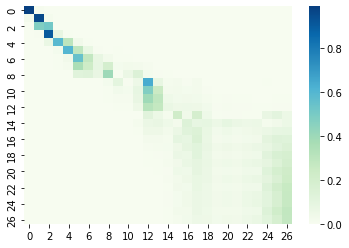

 39%|███▉      | 11.782101167315135/30 [09:15<28:46, 94.75s/it]

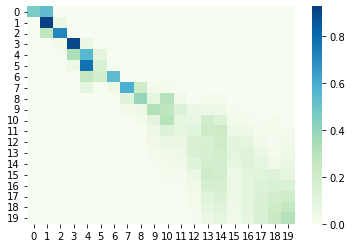

 39%|███▉      | 11.785992217898793/30 [09:16<30:56, 101.94s/it]

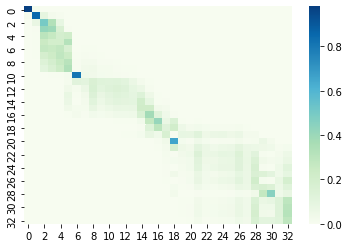

 39%|███▉      | 11.78988326848245/30 [09:16<30:56, 101.98s/it] 

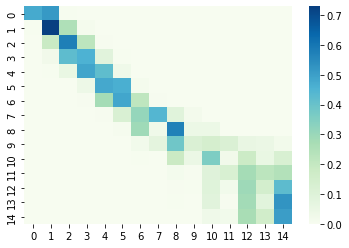

 39%|███▉      | 11.793774319066108/30 [09:17<30:15, 99.74s/it]

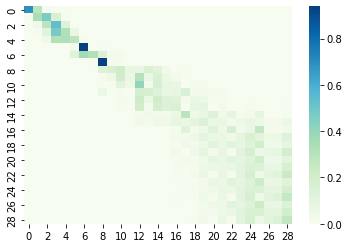

 39%|███▉      | 11.797665369649765/30 [09:17<30:35, 100.84s/it]

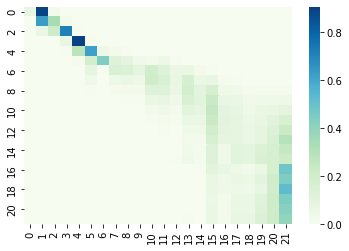

 39%|███▉      | 11.801556420233423/30 [09:17<30:49, 101.62s/it]

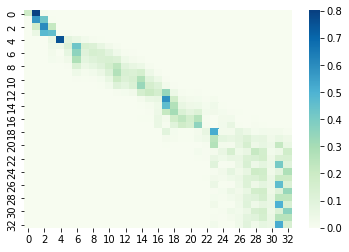

 39%|███▉      | 11.80544747081708/30 [09:18<31:42, 104.58s/it] 

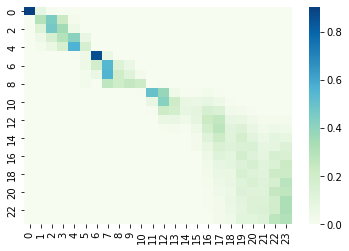

 39%|███▉      | 11.809338521400738/30 [09:18<31:28, 103.83s/it]

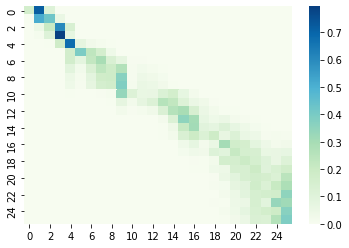

 39%|███▉      | 11.813229571984396/30 [09:19<34:24, 113.49s/it]

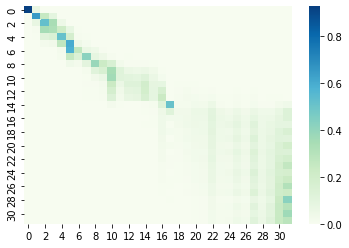

 39%|███▉      | 11.817120622568053/30 [09:19<31:40, 104.54s/it]

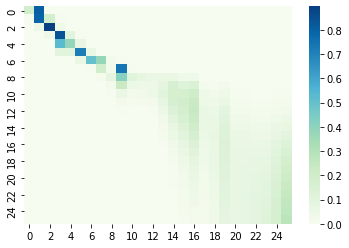

 39%|███▉      | 11.82101167315171/30 [09:19<31:16, 103.25s/it] 

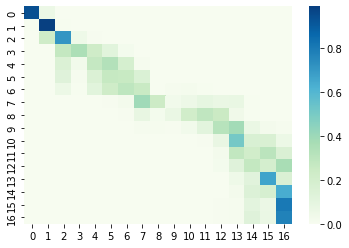

 39%|███▉      | 11.824902723735368/30 [09:20<31:20, 103.49s/it]

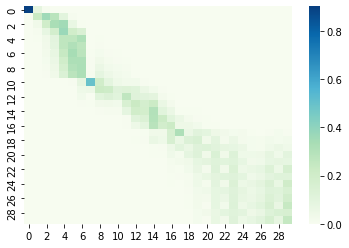

 39%|███▉      | 11.828793774319026/30 [09:20<30:34, 100.95s/it]

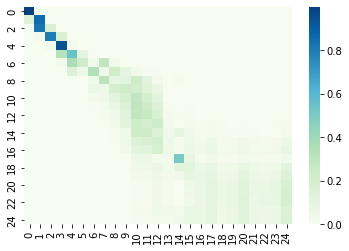

 39%|███▉      | 11.832684824902683/30 [09:21<31:29, 104.01s/it]

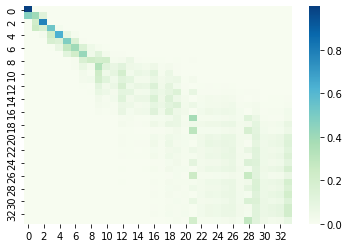

 39%|███▉      | 11.836575875486341/30 [09:21<30:56, 102.18s/it]

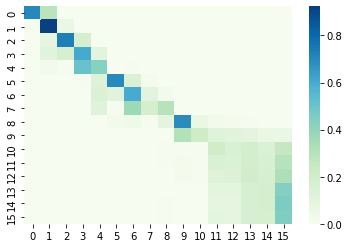

 39%|███▉      | 11.840466926069999/30 [09:21<30:40, 101.37s/it]

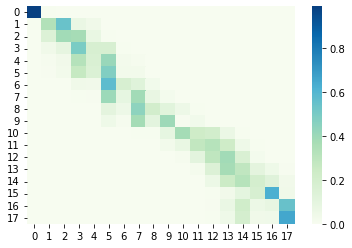

 39%|███▉      | 11.844357976653656/30 [09:22<31:17, 103.42s/it]

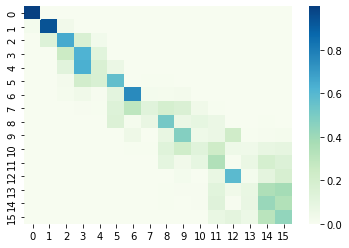

 39%|███▉      | 11.848249027237314/30 [09:22<29:54, 98.83s/it] 

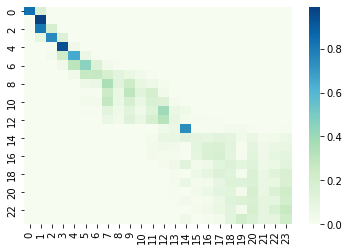

 40%|███▉      | 11.852140077820971/30 [09:23<31:01, 102.59s/it]

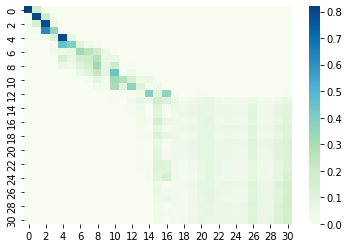

 40%|███▉      | 11.856031128404629/30 [09:23<34:52, 115.32s/it]

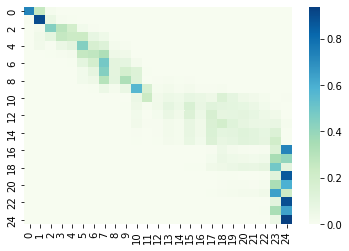

 40%|███▉      | 11.859922178988286/30 [09:24<34:26, 113.91s/it]

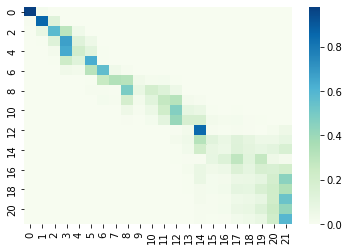

 40%|███▉      | 11.863813229571944/30 [09:24<33:42, 111.50s/it]

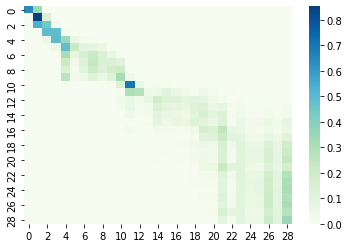

 40%|███▉      | 11.867704280155602/30 [09:24<31:19, 103.65s/it]

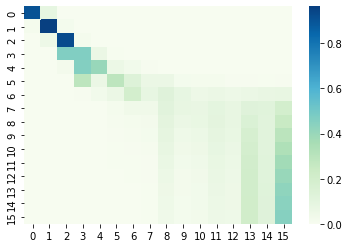

 40%|███▉      | 11.87159533073926/30 [09:25<29:36, 98.01s/it]  

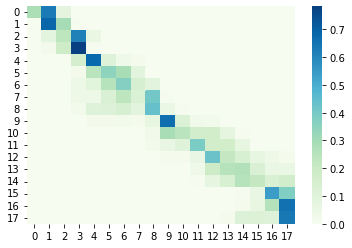

 40%|███▉      | 11.875486381322917/30 [09:25<31:02, 102.78s/it]

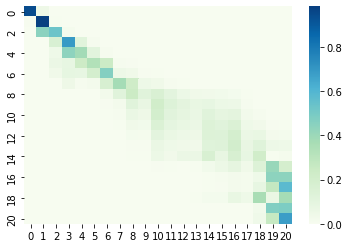

 40%|███▉      | 11.879377431906574/30 [09:26<29:39, 98.21s/it] 

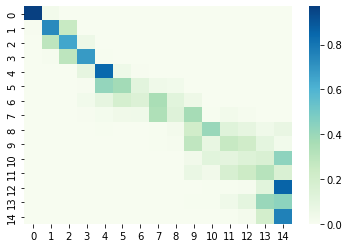

 40%|███▉      | 11.883268482490232/30 [09:26<28:15, 93.57s/it]

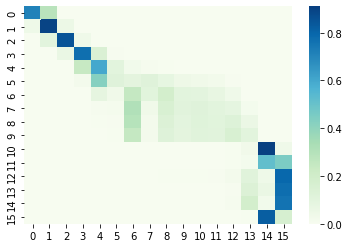

 40%|███▉      | 11.88715953307389/30 [09:26<28:05, 93.05s/it] 

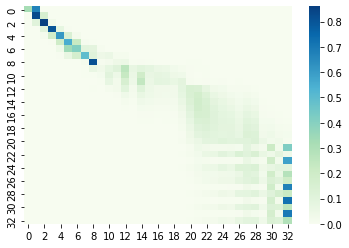

 40%|███▉      | 11.891050583657547/30 [09:27<29:20, 97.20s/it]

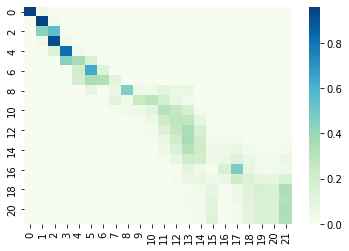

 40%|███▉      | 11.894941634241205/30 [09:27<29:17, 97.05s/it]

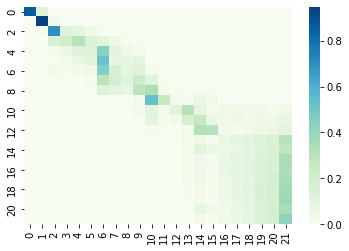

 40%|███▉      | 11.898832684824862/30 [09:28<33:06, 109.72s/it]

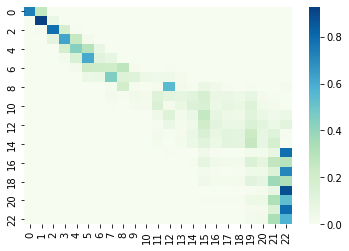

 40%|███▉      | 11.90272373540852/30 [09:28<32:31, 107.84s/it] 

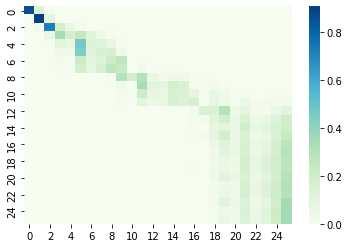

 40%|███▉      | 11.906614785992177/30 [09:28<30:50, 102.25s/it]

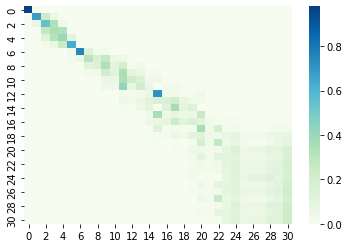

 40%|███▉      | 11.910505836575835/30 [09:29<30:26, 100.97s/it]

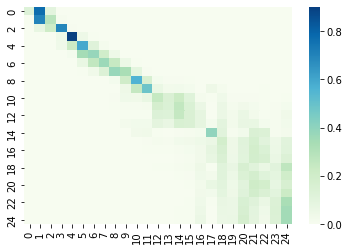

 40%|███▉      | 11.914396887159493/30 [09:29<30:57, 102.70s/it]

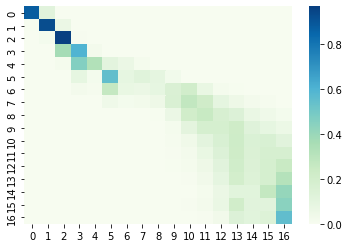

 40%|███▉      | 11.91828793774315/30 [09:29<29:34, 98.15s/it]  

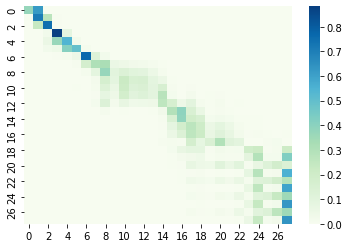

 40%|███▉      | 11.922178988326808/30 [09:30<28:47, 95.57s/it]

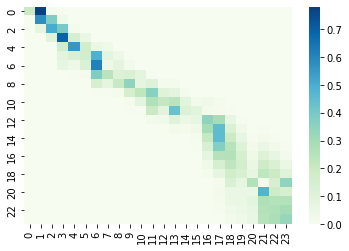

 40%|███▉      | 11.926070038910465/30 [09:30<29:45, 98.81s/it]

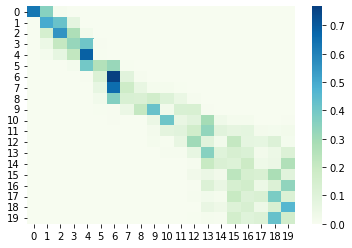

 40%|███▉      | 11.929961089494123/30 [09:31<30:13, 100.36s/it]

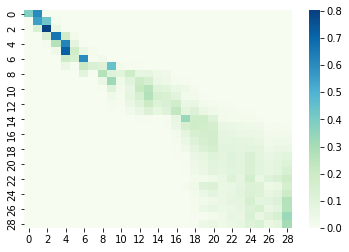

 40%|███▉      | 11.93385214007778/30 [09:31<28:58, 96.24s/it]  

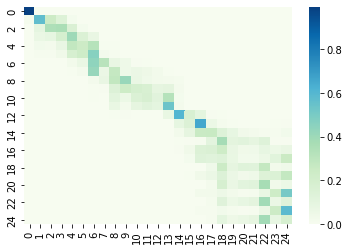

 40%|███▉      | 11.937743190661438/30 [09:31<30:33, 101.52s/it]

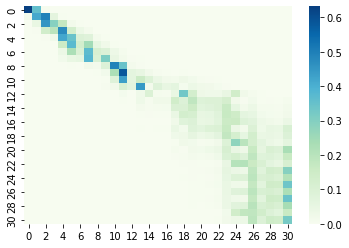

 40%|███▉      | 11.941634241245096/30 [09:32<34:09, 113.47s/it]

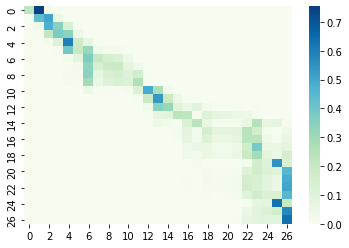

 40%|███▉      | 11.945525291828753/30 [09:32<31:51, 105.89s/it]

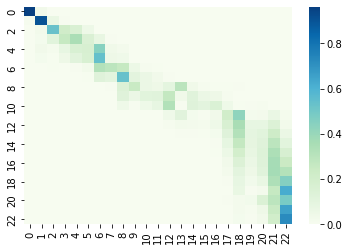

 40%|███▉      | 11.94941634241241/30 [09:33<31:18, 104.08s/it] 

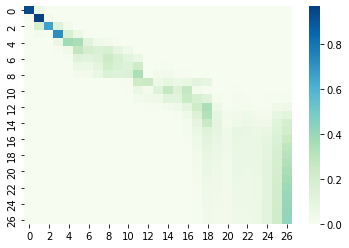

 40%|███▉      | 11.953307392996068/30 [09:33<29:35, 98.41s/it]

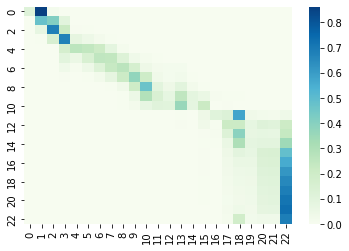

 40%|███▉      | 11.957198443579726/30 [09:33<29:50, 99.25s/it]

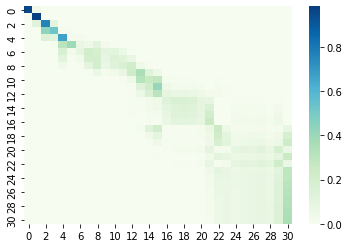

 40%|███▉      | 11.961089494163383/30 [09:34<29:16, 97.40s/it]

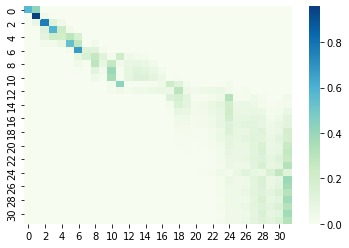

 40%|███▉      | 11.964980544747041/30 [09:34<28:37, 95.22s/it]

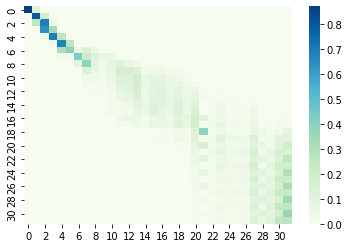

 40%|███▉      | 11.968871595330699/30 [09:34<28:57, 96.38s/it]

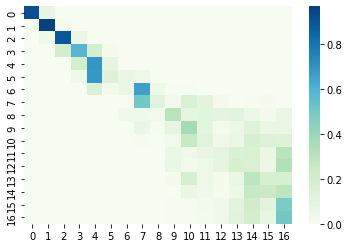

 40%|███▉      | 11.972762645914356/30 [09:35<29:00, 96.56s/it]

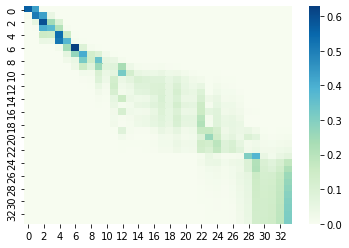

 40%|███▉      | 11.976653696498014/30 [09:35<30:11, 100.49s/it]

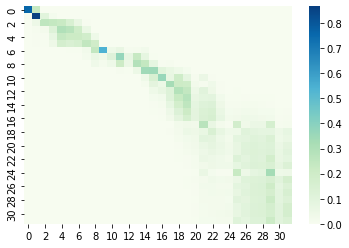

 40%|███▉      | 11.980544747081671/30 [09:36<29:44, 99.04s/it] 

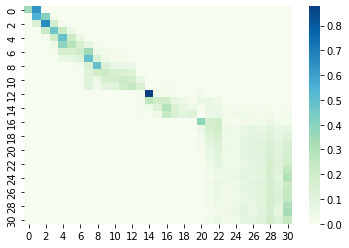

 40%|███▉      | 11.984435797665329/30 [09:36<34:03, 113.42s/it]

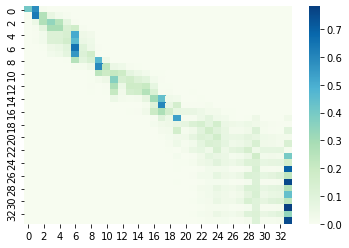

 40%|███▉      | 11.988326848248986/30 [09:37<32:47, 109.26s/it]

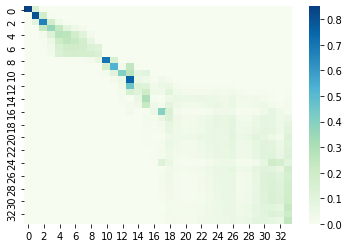

 40%|███▉      | 11.992217898832644/30 [09:37<31:44, 105.78s/it]

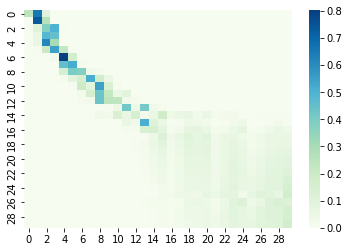

 40%|███▉      | 11.996108949416302/30 [09:37<30:03, 100.16s/it]

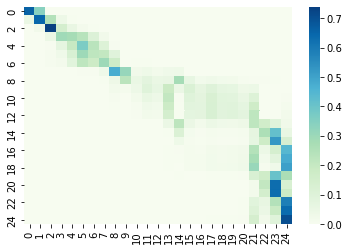

 40%|███▉      | 11.99999999999996/30 [09:38<31:09, 103.86s/it] 

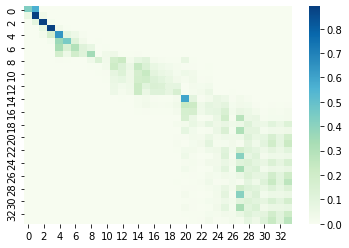

 42%|████▏     | 12.614785992217856/30 [09:53<07:48, 26.96s/it]

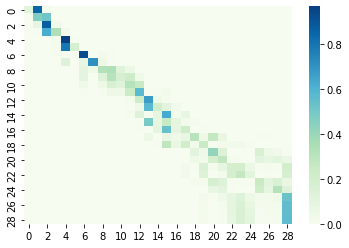

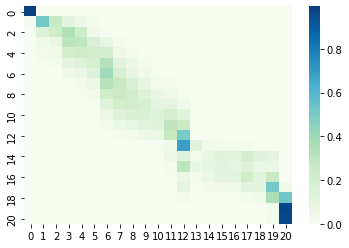

 42%|████▏     | 12.622568093385171/30 [09:53<13:51, 47.88s/it]

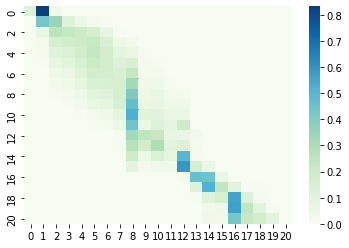

 42%|████▏     | 12.626459143968829/30 [09:54<15:55, 55.00s/it]

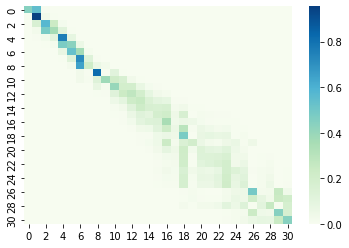

 42%|████▏     | 12.630350194552486/30 [09:54<17:57, 62.04s/it]

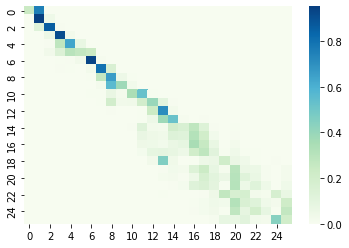

 42%|████▏     | 12.634241245136144/30 [09:54<18:52, 65.22s/it]

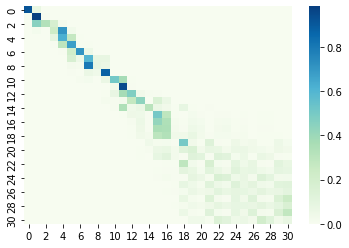

 42%|████▏     | 12.638132295719801/30 [09:55<24:47, 85.68s/it]

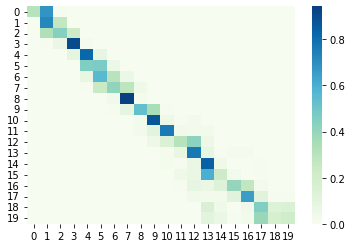

 42%|████▏     | 12.642023346303459/30 [09:55<25:28, 88.08s/it]

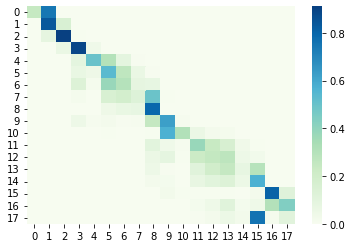

 42%|████▏     | 12.645914396887116/30 [09:56<26:04, 90.13s/it]

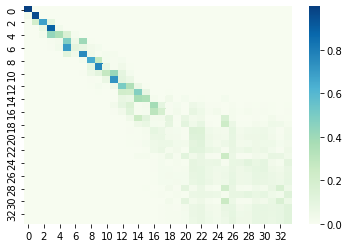

 42%|████▏     | 12.649805447470774/30 [09:56<26:33, 91.87s/it]

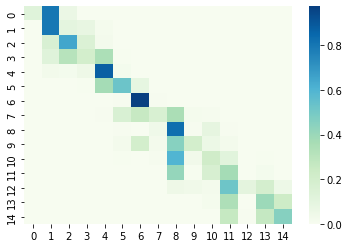

 42%|████▏     | 12.653696498054432/30 [09:56<26:56, 93.20s/it]

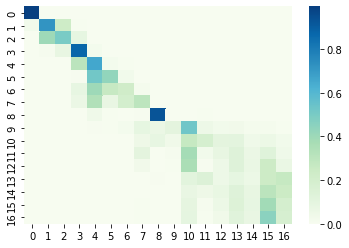

 42%|████▏     | 12.657587548638089/30 [09:57<27:57, 96.73s/it]

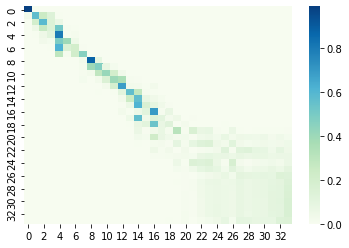

 42%|████▏     | 12.661478599221747/30 [09:57<27:50, 96.37s/it]

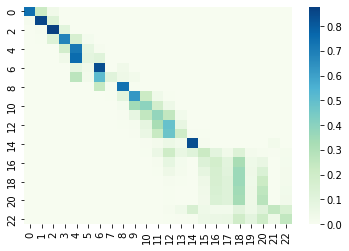

 42%|████▏     | 12.665369649805404/30 [09:58<29:31, 102.22s/it]

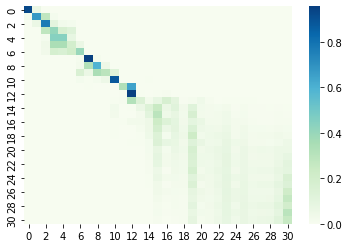

 42%|████▏     | 12.669260700389062/30 [09:58<30:28, 105.50s/it]

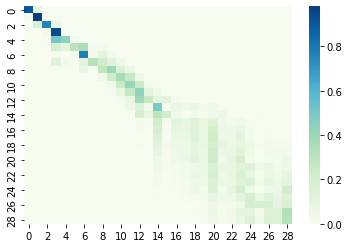

 42%|████▏     | 12.67315175097272/30 [09:59<29:23, 101.77s/it] 

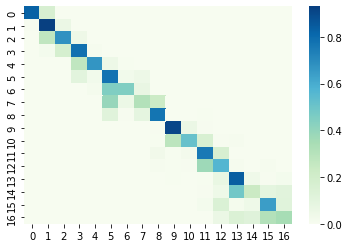

 42%|████▏     | 12.677042801556377/30 [09:59<29:49, 103.29s/it]

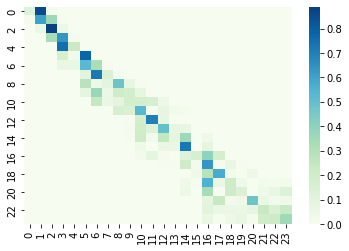

 42%|████▏     | 12.680933852140035/30 [10:00<35:08, 121.73s/it]

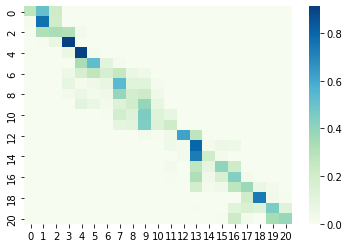

 42%|████▏     | 12.684824902723692/30 [10:00<34:27, 119.39s/it]

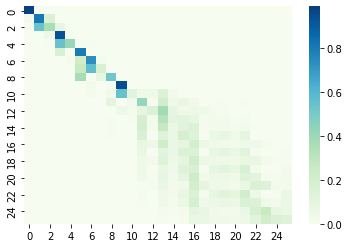

 42%|████▏     | 12.68871595330735/30 [10:00<33:17, 115.39s/it] 

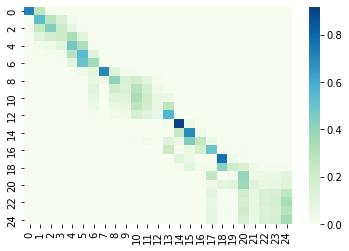

 42%|████▏     | 12.692607003891007/30 [10:01<35:10, 121.97s/it]

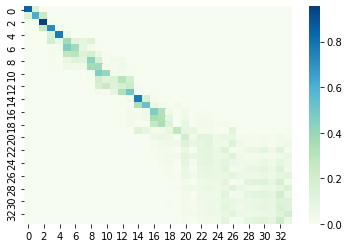

 42%|████▏     | 12.696498054474665/30 [10:01<35:14, 122.19s/it]

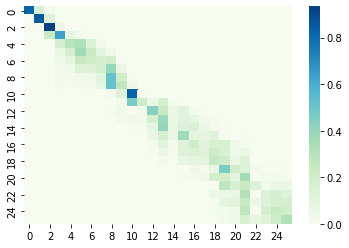

 42%|████▏     | 12.700389105058322/30 [10:02<32:59, 114.44s/it]

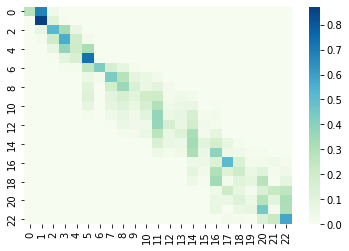

 42%|████▏     | 12.70428015564198/30 [10:02<33:13, 115.26s/it] 

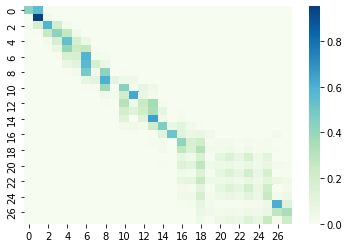

 42%|████▏     | 12.708171206225638/30 [10:03<33:09, 115.04s/it]

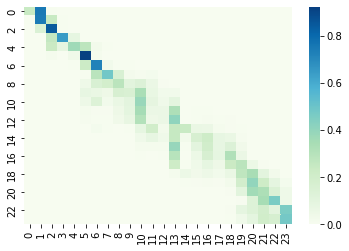

 42%|████▏     | 12.712062256809295/30 [10:03<31:57, 110.89s/it]

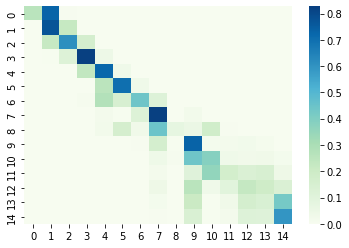

 42%|████▏     | 12.715953307392953/30 [10:04<31:55, 110.84s/it]

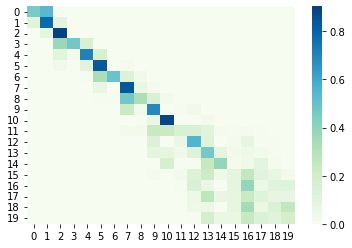

 42%|████▏     | 12.71984435797661/30 [10:04<31:49, 110.49s/it] 

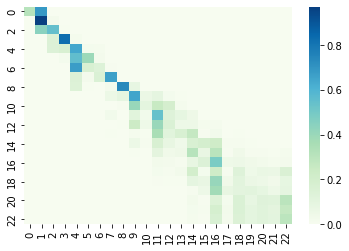

 42%|████▏     | 12.723735408560268/30 [10:05<34:36, 120.19s/it]

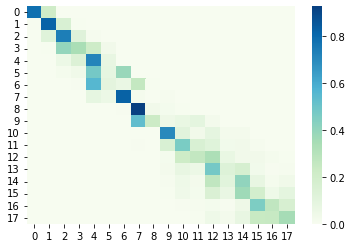

 42%|████▏     | 12.727626459143925/30 [10:05<32:40, 113.51s/it]

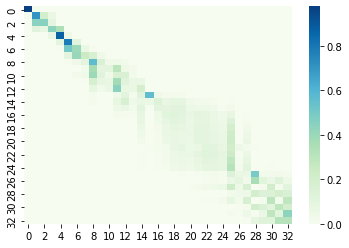

 42%|████▏     | 12.731517509727583/30 [10:05<30:34, 106.24s/it]

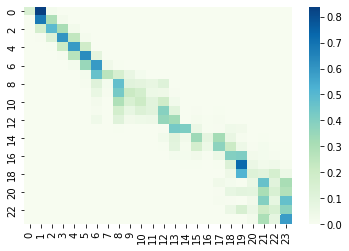

 42%|████▏     | 12.73540856031124/30 [10:06<31:28, 109.37s/it] 

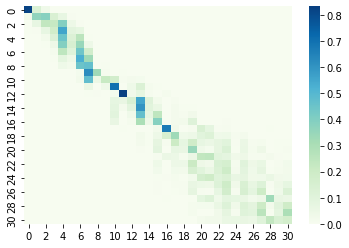

 42%|████▏     | 12.739299610894898/30 [10:06<30:58, 107.65s/it]

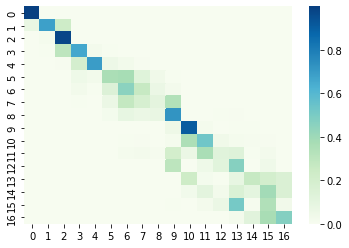

 42%|████▏     | 12.743190661478556/30 [10:07<30:51, 107.27s/it]

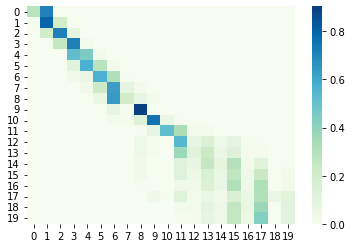

 42%|████▏     | 12.747081712062213/30 [10:07<31:33, 109.74s/it]

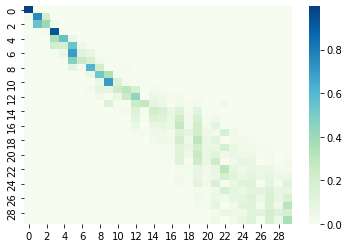

 43%|████▎     | 12.75097276264587/30 [10:07<29:54, 104.05s/it] 

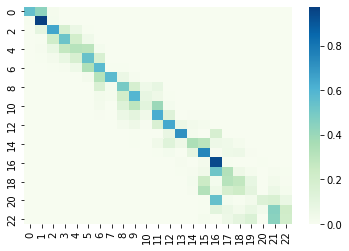

 43%|████▎     | 12.754863813229528/30 [10:08<29:17, 101.94s/it]

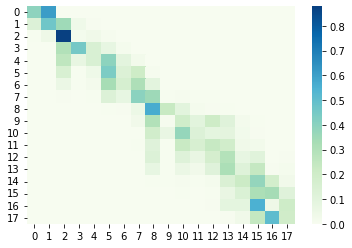

 43%|████▎     | 12.758754863813186/30 [10:08<29:59, 104.40s/it]

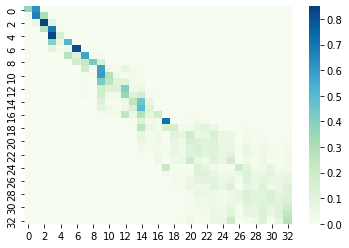

 43%|████▎     | 12.762645914396844/30 [10:08<29:14, 101.78s/it]

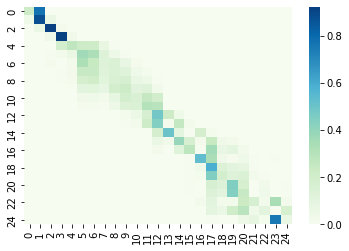

 43%|████▎     | 12.766536964980501/30 [10:09<33:19, 116.02s/it]

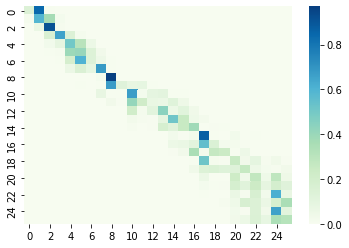

 43%|████▎     | 12.770428015564159/30 [10:09<31:15, 108.86s/it]

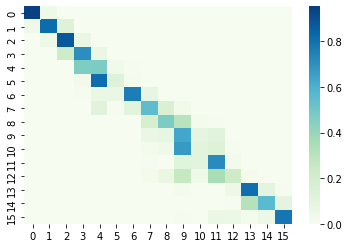

 43%|████▎     | 12.774319066147816/30 [10:10<29:42, 103.47s/it]

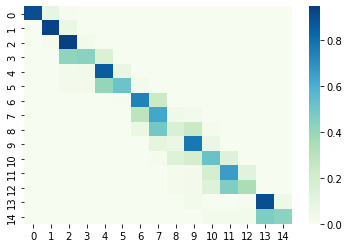

 43%|████▎     | 12.778210116731474/30 [10:10<27:46, 96.76s/it] 

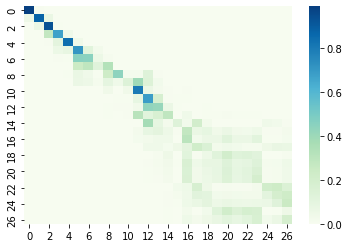

 43%|████▎     | 12.782101167315131/30 [10:10<27:46, 96.76s/it]

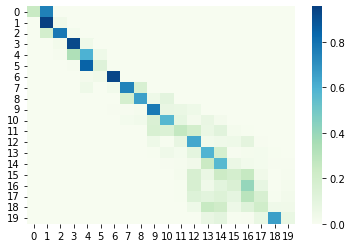

 43%|████▎     | 12.785992217898789/30 [10:11<28:49, 100.46s/it]

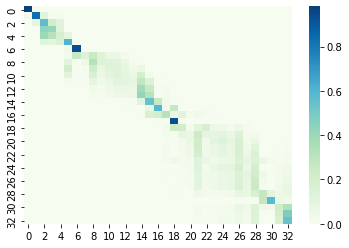

 43%|████▎     | 12.789883268482447/30 [10:11<28:11, 98.28s/it] 

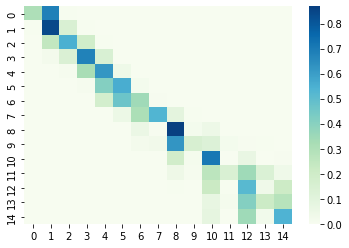

 43%|████▎     | 12.793774319066104/30 [10:12<28:47, 100.39s/it]

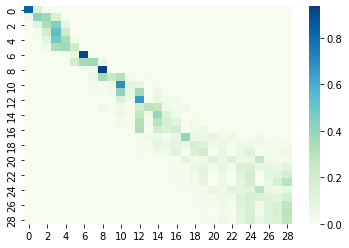

 43%|████▎     | 12.797665369649762/30 [10:12<27:23, 95.56s/it] 

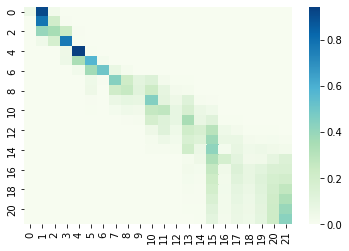

 43%|████▎     | 12.80155642023342/30 [10:12<27:38, 96.41s/it] 

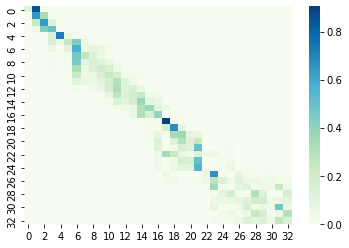

 43%|████▎     | 12.805447470817077/30 [10:13<26:58, 94.15s/it]

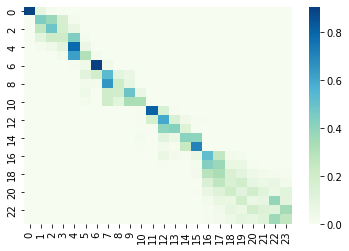

 43%|████▎     | 12.809338521400734/30 [10:13<30:15, 105.63s/it]

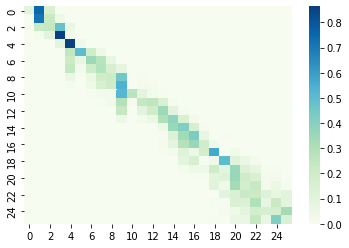

 43%|████▎     | 12.813229571984392/30 [10:14<29:59, 104.68s/it]

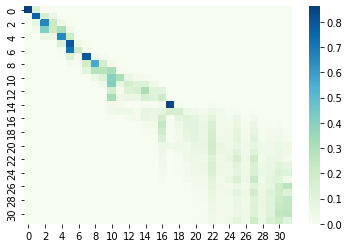

 43%|████▎     | 12.81712062256805/30 [10:14<29:06, 101.67s/it] 

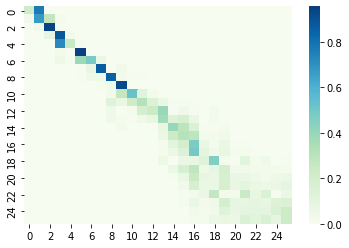

 43%|████▎     | 12.821011673151707/30 [10:14<28:24, 99.22s/it]

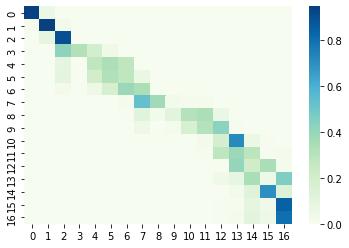

 43%|████▎     | 12.824902723735365/30 [10:15<28:45, 100.49s/it]

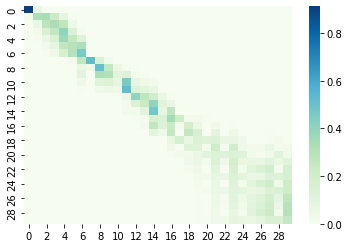

 43%|████▎     | 12.828793774319022/30 [10:15<28:34, 99.85s/it] 

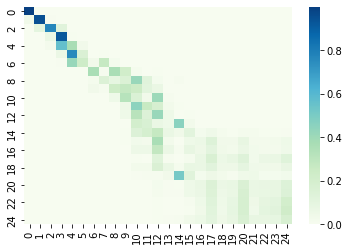

 43%|████▎     | 12.83268482490268/30 [10:16<29:01, 101.42s/it]

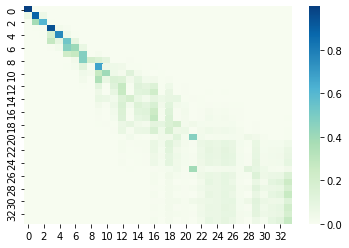

 43%|████▎     | 12.836575875486337/30 [10:16<29:00, 101.38s/it]

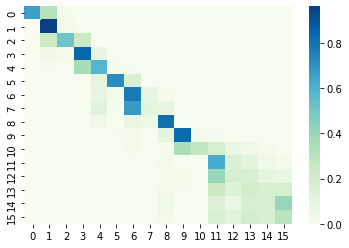

 43%|████▎     | 12.840466926069995/30 [10:16<29:02, 101.57s/it]

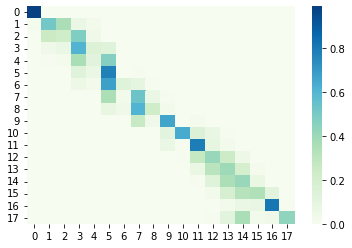

 43%|████▎     | 12.844357976653653/30 [10:17<28:23, 99.30s/it] 

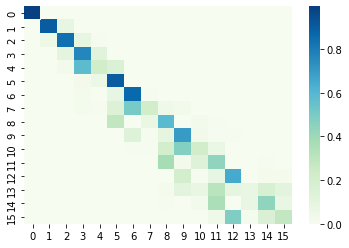

 43%|████▎     | 12.84824902723731/30 [10:17<27:22, 95.76s/it] 

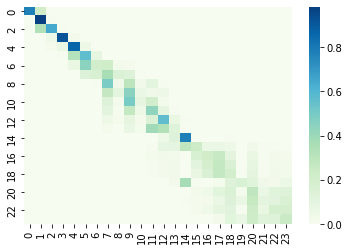

 43%|████▎     | 12.852140077820968/30 [10:18<31:15, 109.39s/it]

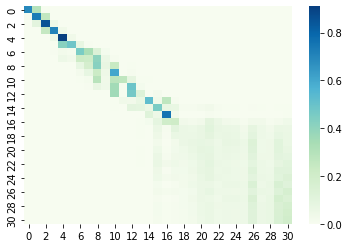

 43%|████▎     | 12.856031128404625/30 [10:18<30:18, 106.06s/it]

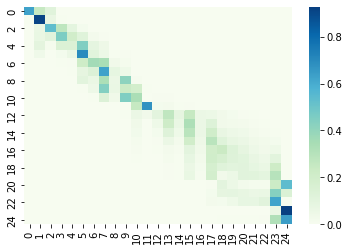

 43%|████▎     | 12.859922178988283/30 [10:18<30:21, 106.28s/it]

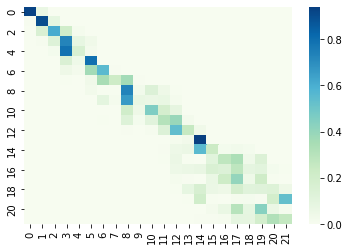

 43%|████▎     | 12.86381322957194/30 [10:19<29:23, 102.90s/it] 

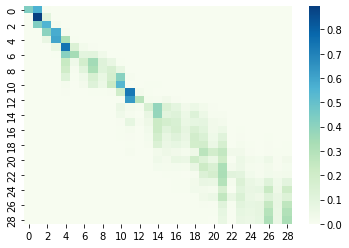

 43%|████▎     | 12.867704280155598/30 [10:19<28:55, 101.31s/it]

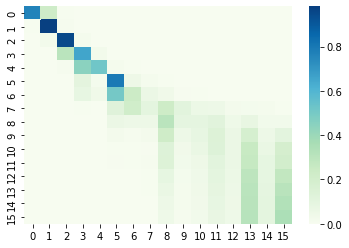

 43%|████▎     | 12.871595330739256/30 [10:20<27:46, 97.31s/it] 

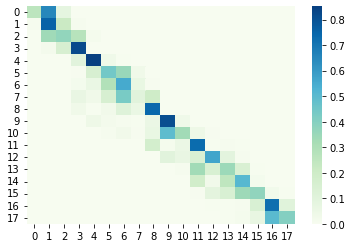

 43%|████▎     | 12.875486381322913/30 [10:20<29:09, 102.16s/it]

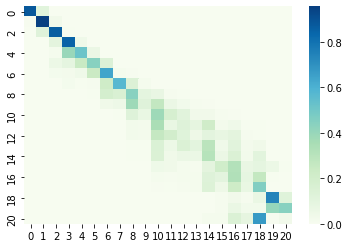

 43%|████▎     | 12.87937743190657/30 [10:20<29:09, 102.19s/it] 

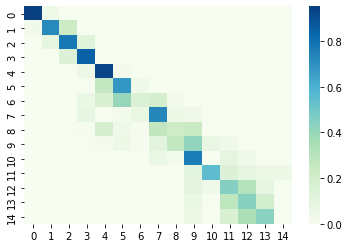

 43%|████▎     | 12.883268482490228/30 [10:21<27:38, 96.89s/it]

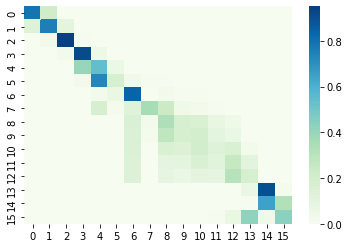

 43%|████▎     | 12.887159533073886/30 [10:21<28:01, 98.26s/it]

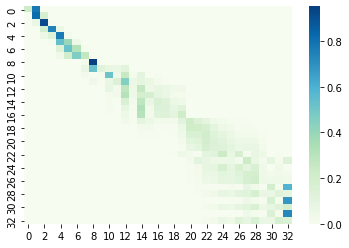

 43%|████▎     | 12.891050583657544/30 [10:21<27:06, 95.06s/it]

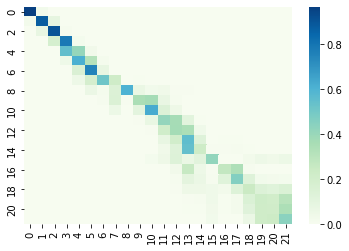

 43%|████▎     | 12.894941634241201/30 [10:22<30:04, 105.47s/it]

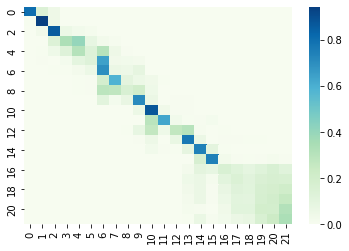

 43%|████▎     | 12.898832684824859/30 [10:22<29:24, 103.16s/it]

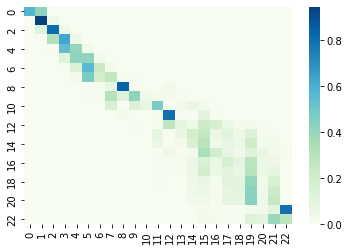

 43%|████▎     | 12.902723735408516/30 [10:23<29:28, 103.44s/it]

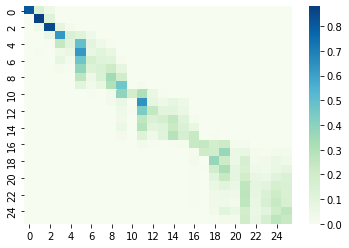

 43%|████▎     | 12.906614785992174/30 [10:23<27:28, 96.44s/it] 

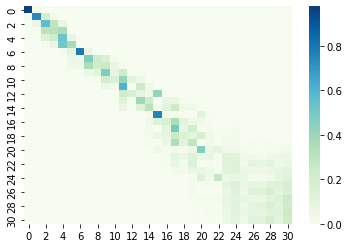

 43%|████▎     | 12.910505836575831/30 [10:23<26:15, 92.18s/it]

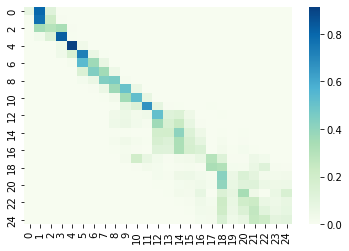

 43%|████▎     | 12.914396887159489/30 [10:24<26:32, 93.19s/it]

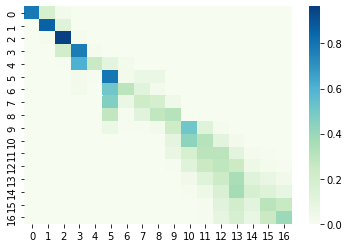

 43%|████▎     | 12.918287937743147/30 [10:24<27:02, 94.97s/it]

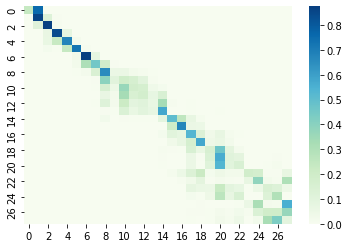

 43%|████▎     | 12.922178988326804/30 [10:24<26:30, 93.13s/it]

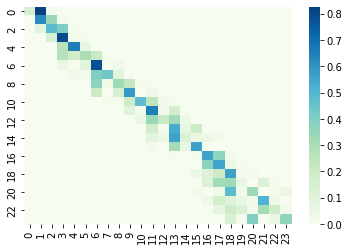

 43%|████▎     | 12.926070038910462/30 [10:25<28:03, 98.57s/it]

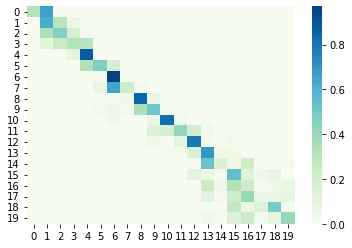

 43%|████▎     | 12.92996108949412/30 [10:25<29:16, 102.90s/it]

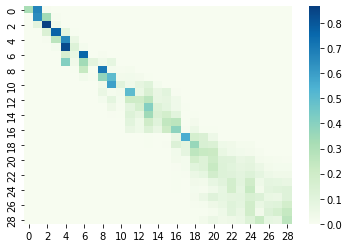

 43%|████▎     | 12.933852140077777/30 [10:26<29:23, 103.36s/it]

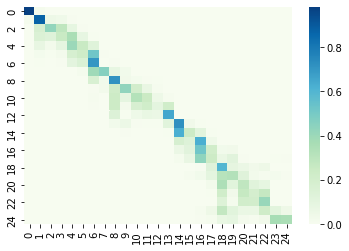

 43%|████▎     | 12.937743190661434/30 [10:26<33:18, 117.13s/it]

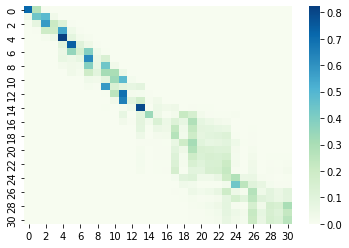

 43%|████▎     | 12.941634241245092/30 [10:27<32:20, 113.78s/it]

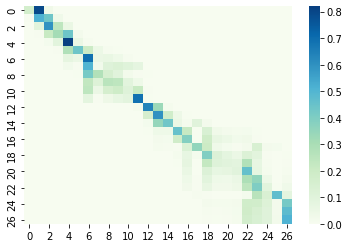

 43%|████▎     | 12.94552529182875/30 [10:27<31:04, 109.35s/it] 

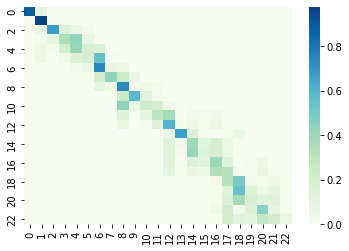

 43%|████▎     | 12.949416342412407/30 [10:28<31:29, 110.80s/it]

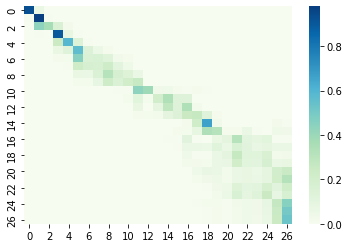

 43%|████▎     | 12.953307392996065/30 [10:28<29:59, 105.56s/it]

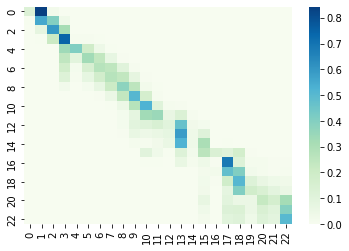

 43%|████▎     | 12.957198443579722/30 [10:28<30:34, 107.61s/it]

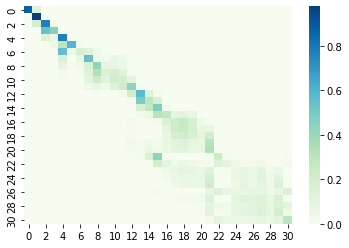

 43%|████▎     | 12.96108949416338/30 [10:29<29:49, 105.02s/it] 

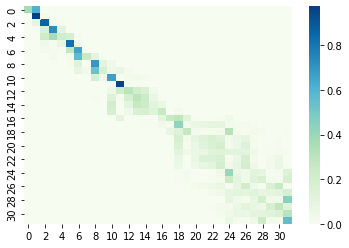

 43%|████▎     | 12.964980544747037/30 [10:29<29:21, 103.43s/it]

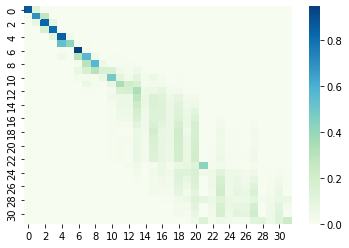

 43%|████▎     | 12.968871595330695/30 [10:29<28:53, 101.80s/it]

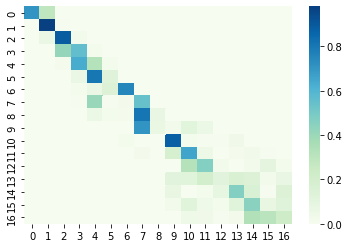

 43%|████▎     | 12.972762645914353/30 [10:30<29:01, 102.25s/it]

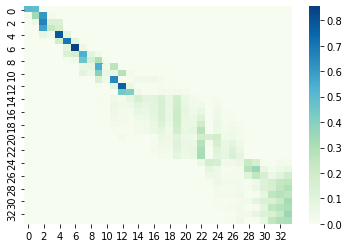

 43%|████▎     | 12.97665369649801/30 [10:30<29:19, 103.34s/it] 

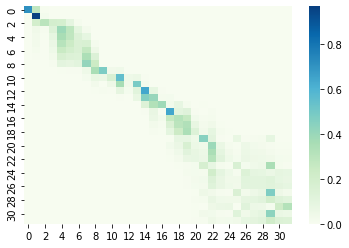

 43%|████▎     | 12.980544747081668/30 [10:31<31:36, 111.45s/it]

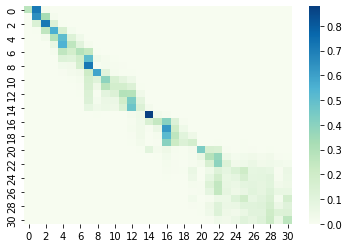

 43%|████▎     | 12.984435797665325/30 [10:31<31:09, 109.88s/it]

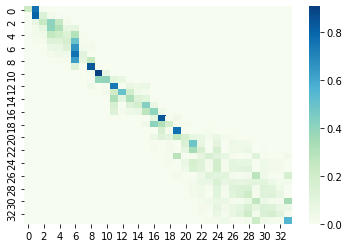

 43%|████▎     | 12.988326848248983/30 [10:32<30:42, 108.28s/it]

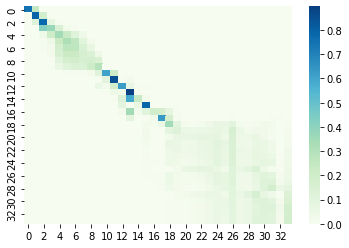

 43%|████▎     | 12.99221789883264/30 [10:32<30:24, 107.29s/it] 

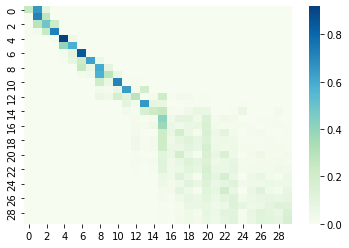

 43%|████▎     | 12.996108949416298/30 [10:32<29:33, 104.33s/it]

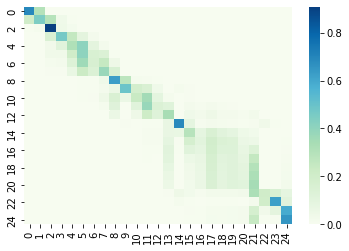

 43%|████▎     | 12.999999999999956/30 [10:33<30:15, 106.79s/it]

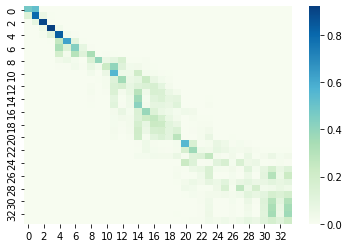

 45%|████▌     | 13.610894941634195/30 [10:48<06:02, 22.13s/it]

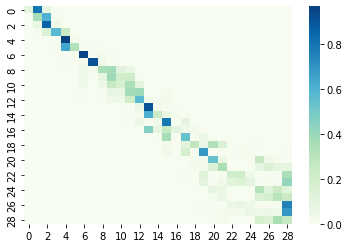

 45%|████▌     | 13.61867704280151/30 [10:48<11:01, 40.40s/it] 

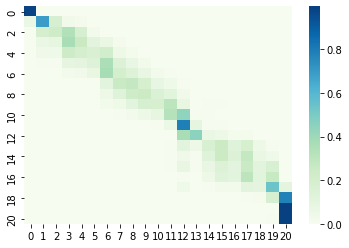

 45%|████▌     | 13.622568093385167/30 [10:49<14:04, 51.55s/it]

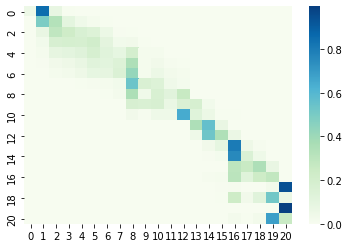

 45%|████▌     | 13.626459143968825/30 [10:49<16:48, 61.62s/it]

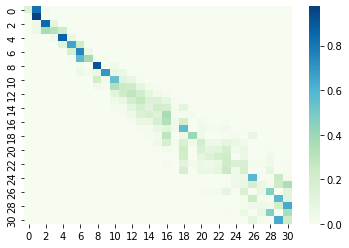

 45%|████▌     | 13.630350194552483/30 [10:49<19:36, 71.87s/it]

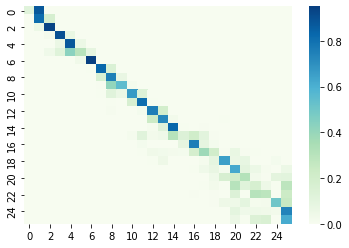

 45%|████▌     | 13.63424124513614/30 [10:50<24:25, 89.52s/it] 

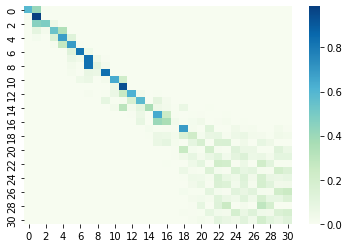

 45%|████▌     | 13.638132295719798/30 [10:50<25:06, 92.09s/it]

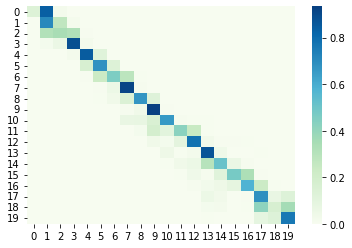

 45%|████▌     | 13.642023346303455/30 [10:51<25:44, 94.40s/it]

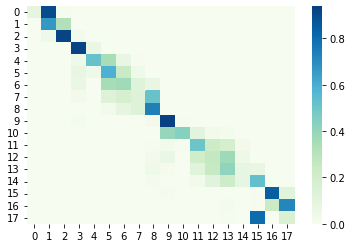

 45%|████▌     | 13.645914396887113/30 [10:51<26:29, 97.18s/it]

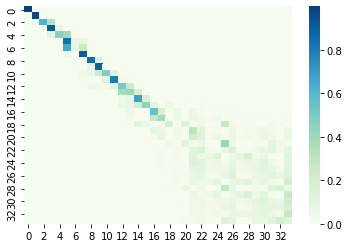

 45%|████▌     | 13.64980544747077/30 [10:52<26:47, 98.30s/it] 

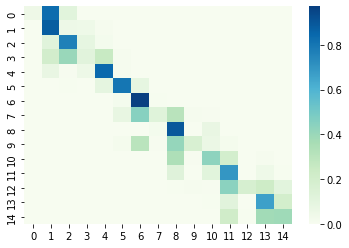

 46%|████▌     | 13.653696498054428/30 [10:52<26:27, 97.14s/it]

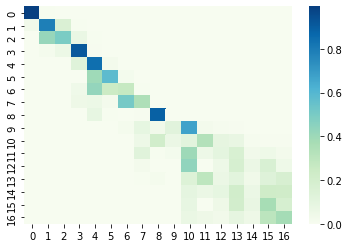

 46%|████▌     | 13.657587548638086/30 [10:52<26:11, 96.18s/it]

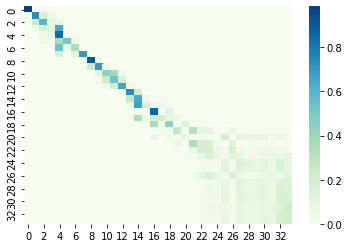

 46%|████▌     | 13.661478599221743/30 [10:53<26:43, 98.15s/it]

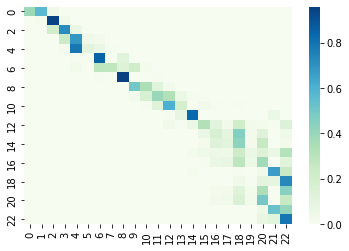

 46%|████▌     | 13.6653696498054/30 [10:53<27:27, 100.84s/it] 

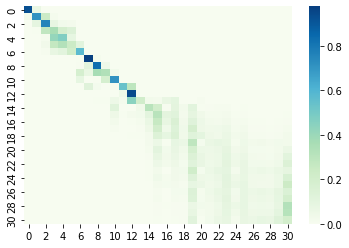

 46%|████▌     | 13.669260700389058/30 [10:54<27:34, 101.28s/it]

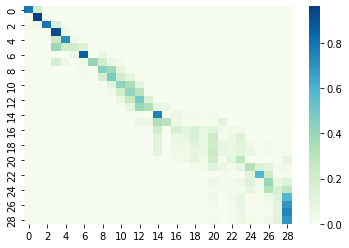

 46%|████▌     | 13.673151750972716/30 [10:54<27:01, 99.31s/it] 

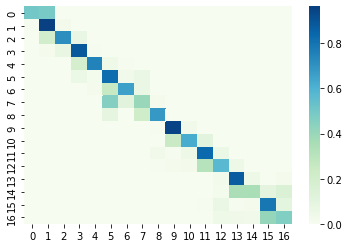

 46%|████▌     | 13.677042801556373/30 [10:54<30:09, 110.83s/it]

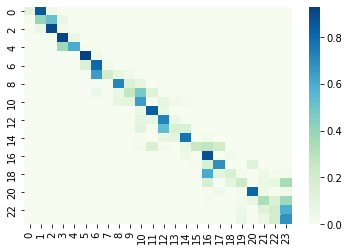

 46%|████▌     | 13.680933852140031/30 [10:55<29:12, 107.36s/it]

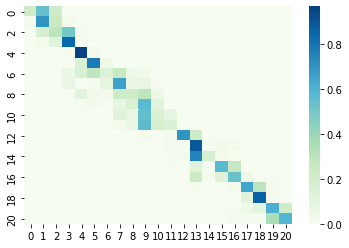

 46%|████▌     | 13.684824902723689/30 [10:55<28:22, 104.33s/it]

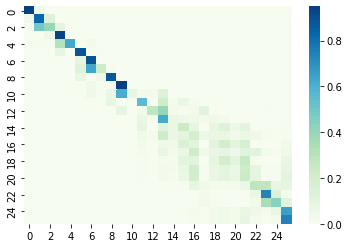

 46%|████▌     | 13.688715953307346/30 [10:56<27:16, 100.31s/it]

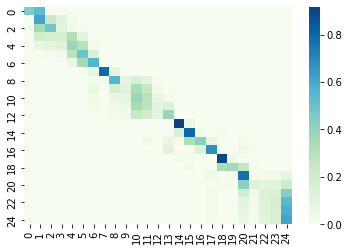

 46%|████▌     | 13.692607003891004/30 [10:56<28:36, 105.27s/it]

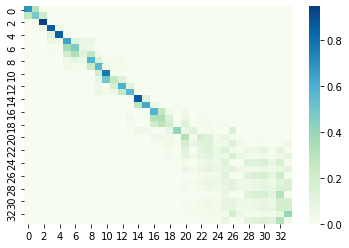

 46%|████▌     | 13.696498054474661/30 [10:56<28:29, 104.87s/it]

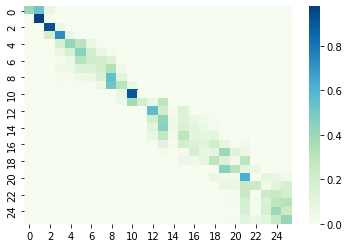

 46%|████▌     | 13.700389105058319/30 [10:57<27:44, 102.13s/it]

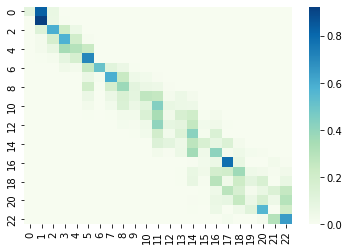

 46%|████▌     | 13.704280155641976/30 [10:57<27:32, 101.40s/it]

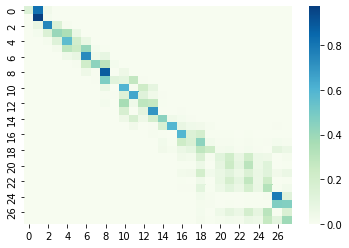

 46%|████▌     | 13.708171206225634/30 [10:57<26:19, 96.98s/it] 

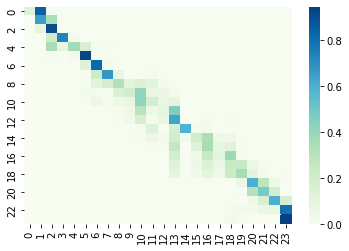

 46%|████▌     | 13.712062256809292/30 [10:58<29:22, 108.21s/it]

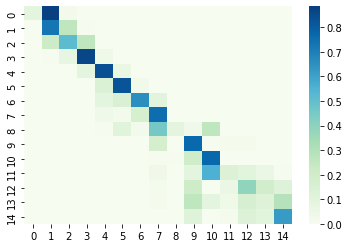

 46%|████▌     | 13.71595330739295/30 [10:58<29:10, 107.48s/it] 

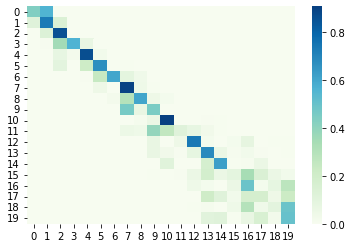

 46%|████▌     | 13.719844357976607/30 [10:59<34:21, 126.60s/it]

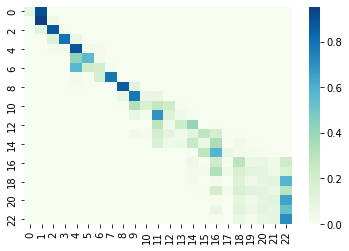

 46%|████▌     | 13.723735408560264/30 [11:00<33:06, 122.02s/it]

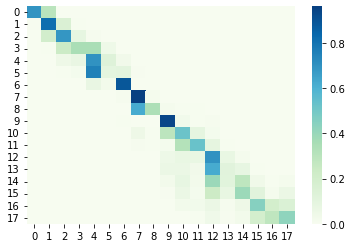

 46%|████▌     | 13.727626459143922/30 [11:00<32:10, 118.63s/it]

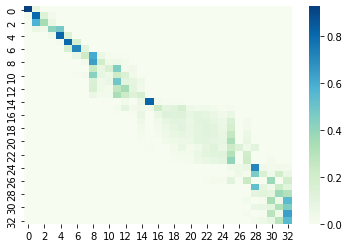

 46%|████▌     | 13.73151750972758/30 [11:00<31:10, 114.95s/it] 

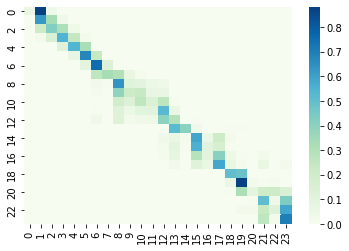

 46%|████▌     | 13.735408560311237/30 [11:01<32:17, 119.10s/it]

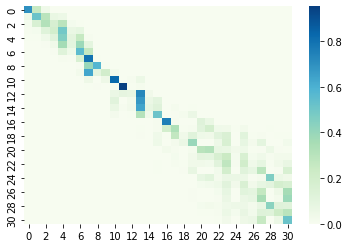

 46%|████▌     | 13.739299610894895/30 [11:01<31:05, 114.74s/it]

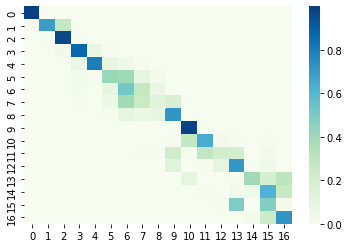

 46%|████▌     | 13.743190661478552/30 [11:02<30:41, 113.27s/it]

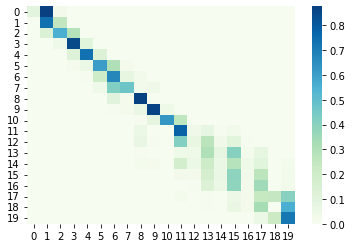

 46%|████▌     | 13.74708171206221/30 [11:02<31:26, 116.09s/it] 

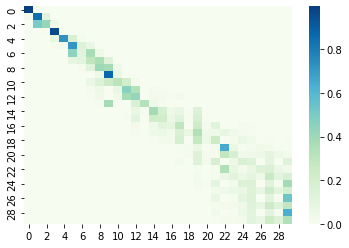

 46%|████▌     | 13.750972762645867/30 [11:03<30:10, 111.41s/it]

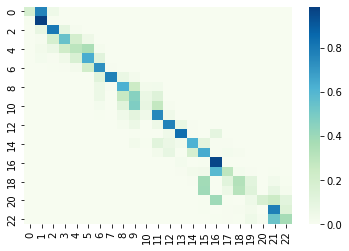

 46%|████▌     | 13.754863813229525/30 [11:03<29:50, 110.24s/it]

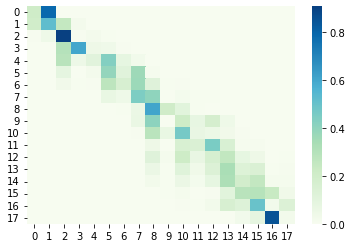

 46%|████▌     | 13.758754863813182/30 [11:03<28:57, 106.99s/it]

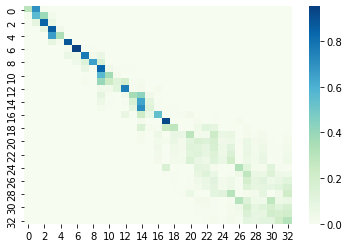

 46%|████▌     | 13.76264591439684/30 [11:04<31:36, 116.79s/it] 

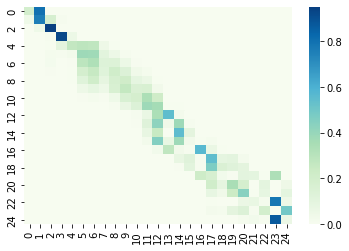

 46%|████▌     | 13.766536964980498/30 [11:04<30:01, 110.98s/it]

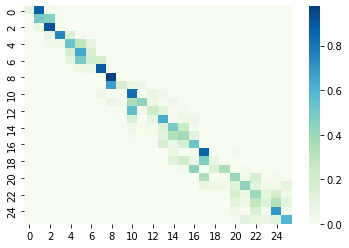

 46%|████▌     | 13.770428015564155/30 [11:05<28:08, 104.06s/it]

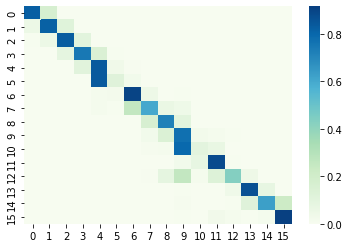

 46%|████▌     | 13.774319066147813/30 [11:05<26:25, 97.73s/it] 

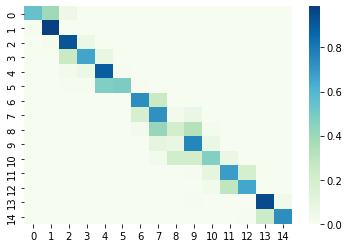

 46%|████▌     | 13.77821011673147/30 [11:05<26:31, 98.11s/it] 

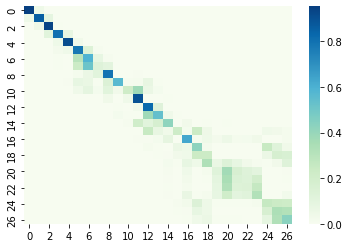

 46%|████▌     | 13.782101167315128/30 [11:06<25:48, 95.50s/it]

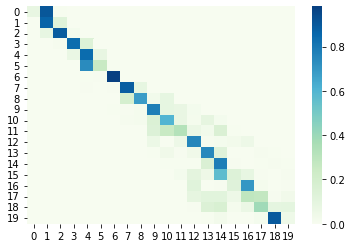

 46%|████▌     | 13.785992217898785/30 [11:06<26:36, 98.44s/it]

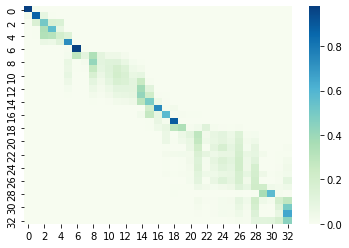

 46%|████▌     | 13.789883268482443/30 [11:06<26:38, 98.58s/it]

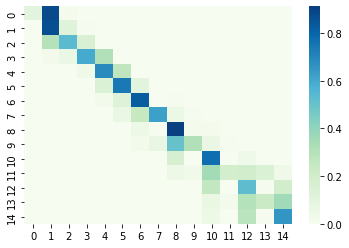

 46%|████▌     | 13.7937743190661/30 [11:07<26:15, 97.20s/it]  

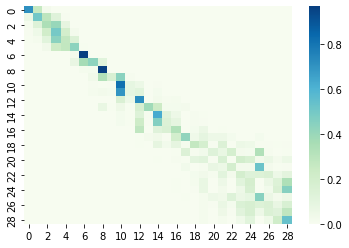

 46%|████▌     | 13.797665369649758/30 [11:07<26:18, 97.44s/it]

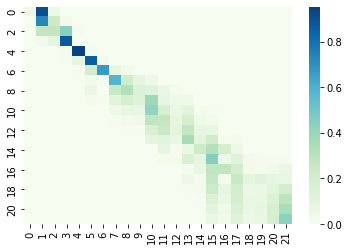

 46%|████▌     | 13.801556420233416/30 [11:08<26:58, 99.93s/it]

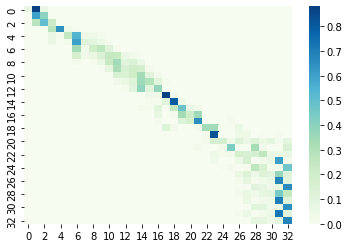

 46%|████▌     | 13.805447470817073/30 [11:08<30:52, 114.39s/it]

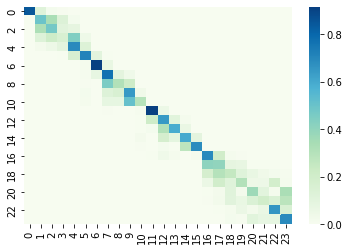

 46%|████▌     | 13.809338521400731/30 [11:09<30:19, 112.38s/it]

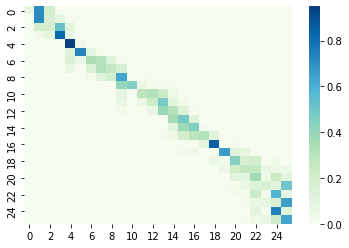

 46%|████▌     | 13.813229571984388/30 [11:09<28:44, 106.54s/it]

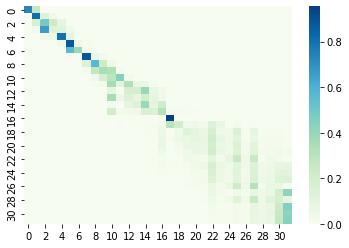

 46%|████▌     | 13.817120622568046/30 [11:09<27:50, 103.25s/it]

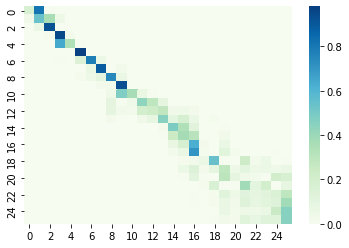

 46%|████▌     | 13.821011673151704/30 [11:10<26:51, 99.59s/it] 

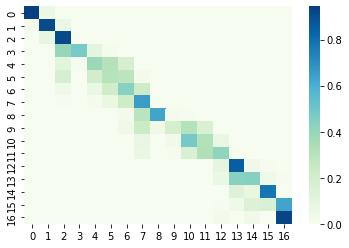

 46%|████▌     | 13.824902723735361/30 [11:10<27:24, 101.69s/it]

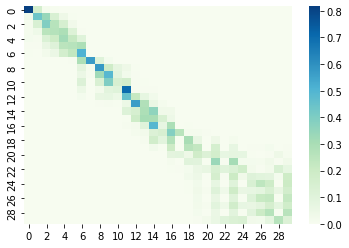

 46%|████▌     | 13.828793774319019/30 [11:11<27:46, 103.03s/it]

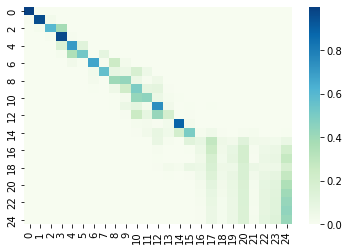

 46%|████▌     | 13.832684824902676/30 [11:11<28:58, 107.54s/it]

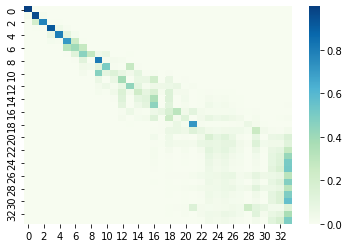

 46%|████▌     | 13.836575875486334/30 [11:11<28:35, 106.14s/it]

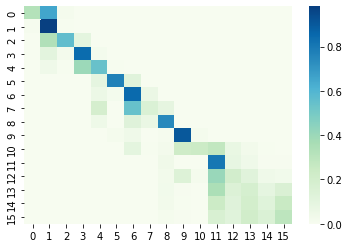

 46%|████▌     | 13.840466926069992/30 [11:12<28:21, 105.32s/it]

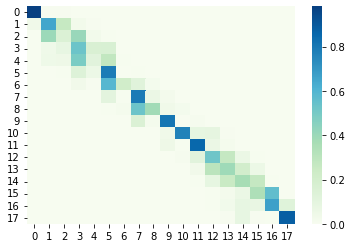

 46%|████▌     | 13.844357976653649/30 [11:12<27:46, 103.16s/it]

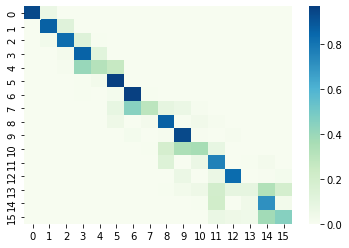

 46%|████▌     | 13.848249027237307/30 [11:13<29:56, 111.22s/it]

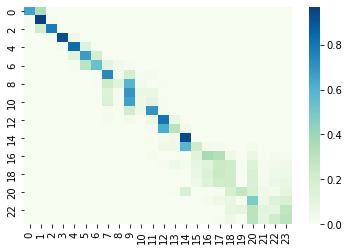

 46%|████▌     | 13.852140077820964/30 [11:13<29:47, 110.72s/it]

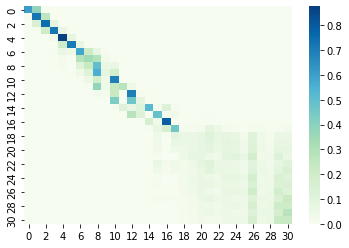

 46%|████▌     | 13.856031128404622/30 [11:14<29:41, 110.32s/it]

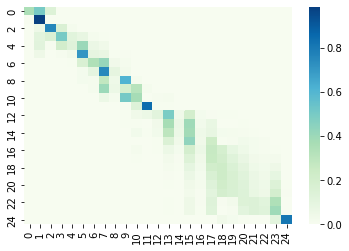

 46%|████▌     | 13.85992217898828/30 [11:14<29:40, 110.32s/it] 

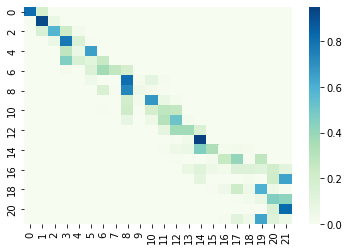

 46%|████▌     | 13.863813229571937/30 [11:14<28:38, 106.48s/it]

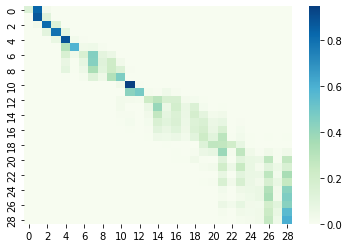

 46%|████▌     | 13.867704280155595/30 [11:15<27:55, 103.87s/it]

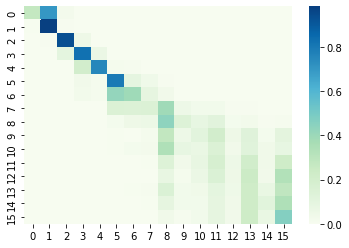

 46%|████▌     | 13.871595330739252/30 [11:15<26:50, 99.86s/it] 

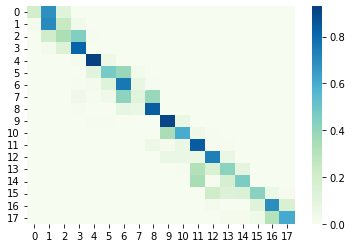

 46%|████▋     | 13.87548638132291/30 [11:15<26:28, 98.51s/it] 

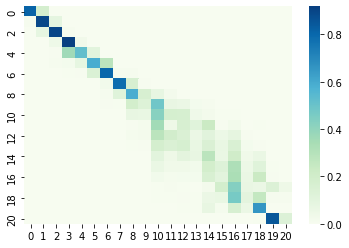

 46%|████▋     | 13.879377431906567/30 [11:16<25:47, 96.02s/it]

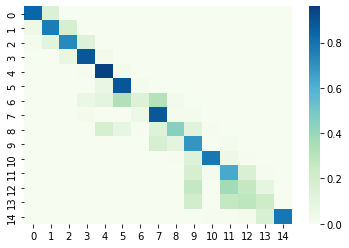

 46%|████▋     | 13.883268482490225/30 [11:16<25:41, 95.63s/it]

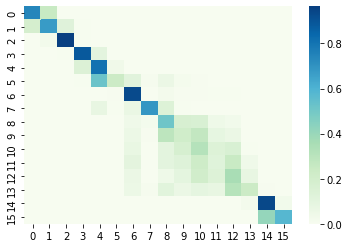

 46%|████▋     | 13.887159533073882/30 [11:17<26:21, 98.18s/it]

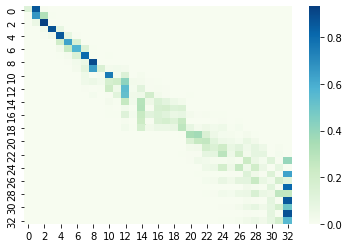

 46%|████▋     | 13.89105058365754/30 [11:17<29:44, 110.76s/it]

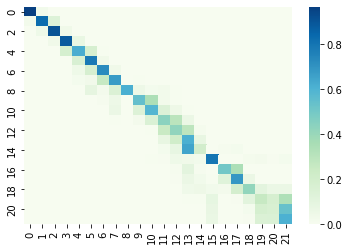

 46%|████▋     | 13.894941634241198/30 [11:18<28:24, 105.86s/it]

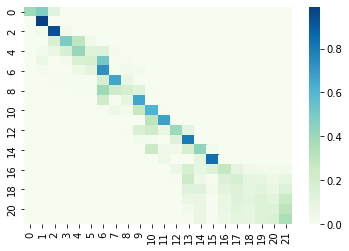

 46%|████▋     | 13.898832684824855/30 [11:18<27:04, 100.92s/it]

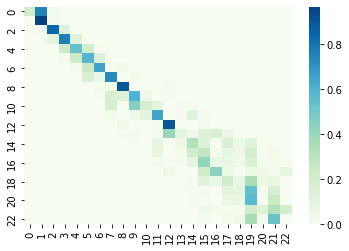

 46%|████▋     | 13.902723735408513/30 [11:18<26:35, 99.09s/it] 

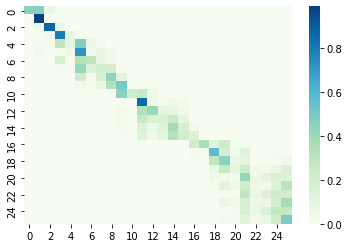

 46%|████▋     | 13.90661478599217/30 [11:19<26:20, 98.20s/it] 

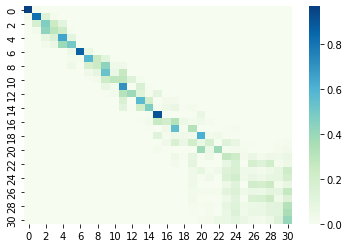

 46%|████▋     | 13.910505836575828/30 [11:19<25:49, 96.31s/it]

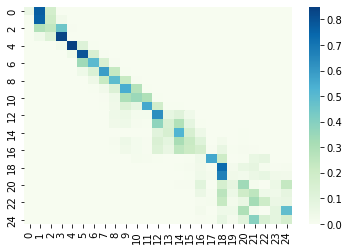

 46%|████▋     | 13.914396887159485/30 [11:19<27:04, 100.98s/it]

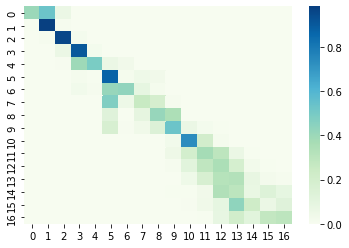

 46%|████▋     | 13.918287937743143/30 [11:20<27:12, 101.49s/it]

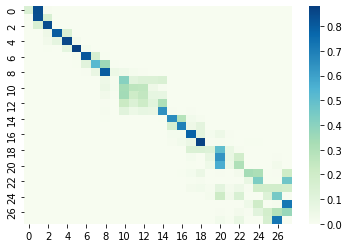

 46%|████▋     | 13.9221789883268/30 [11:20<26:54, 100.41s/it]  

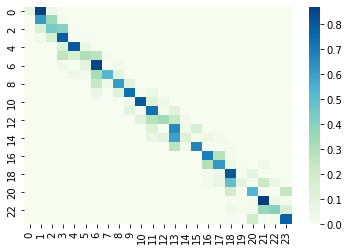

 46%|████▋     | 13.926070038910458/30 [11:21<27:57, 104.34s/it]

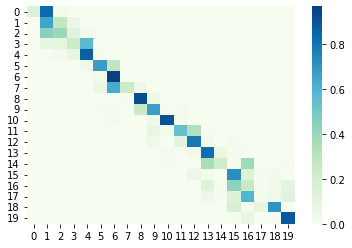

 46%|████▋     | 13.929961089494116/30 [11:21<28:33, 106.61s/it]

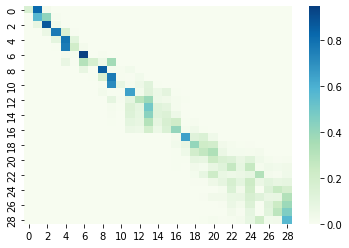

 46%|████▋     | 13.933852140077773/30 [11:22<30:00, 112.08s/it]

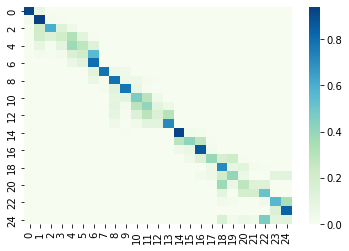

 46%|████▋     | 13.93774319066143/30 [11:22<29:34, 110.50s/it] 

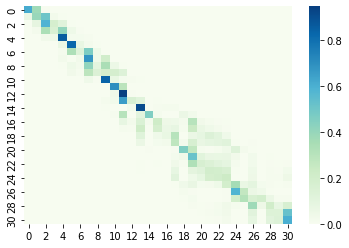

 46%|████▋     | 13.941634241245088/30 [11:22<28:42, 107.27s/it]

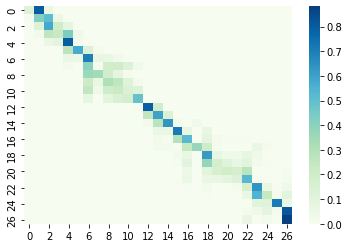

 46%|████▋     | 13.945525291828746/30 [11:23<28:27, 106.38s/it]

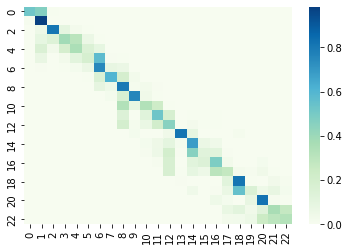

 46%|████▋     | 13.949416342412404/30 [11:23<28:25, 106.28s/it]

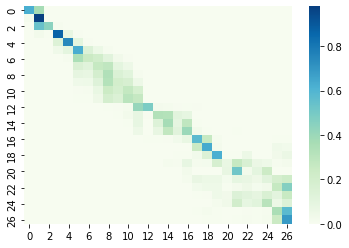

 47%|████▋     | 13.953307392996061/30 [11:24<27:22, 102.35s/it]

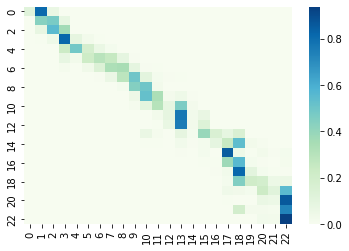

 47%|████▋     | 13.957198443579719/30 [11:24<27:46, 103.89s/it]

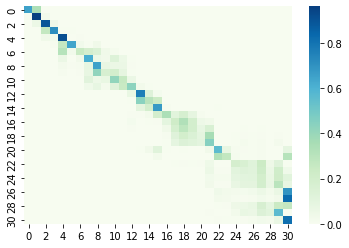

 47%|████▋     | 13.961089494163376/30 [11:24<27:20, 102.28s/it]

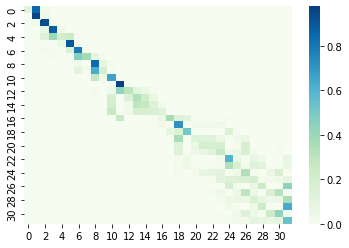

 47%|████▋     | 13.964980544747034/30 [11:25<27:10, 101.67s/it]

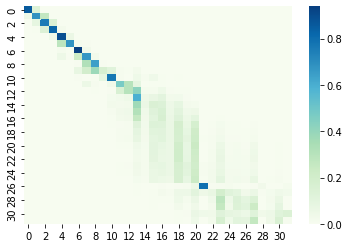

 47%|████▋     | 13.968871595330691/30 [11:25<26:54, 100.73s/it]

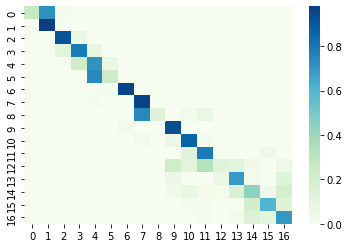

 47%|████▋     | 13.972762645914349/30 [11:25<26:18, 98.52s/it] 

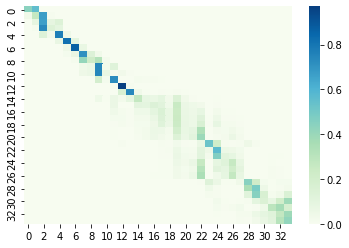

 47%|████▋     | 13.976653696498007/30 [11:26<29:52, 111.87s/it]

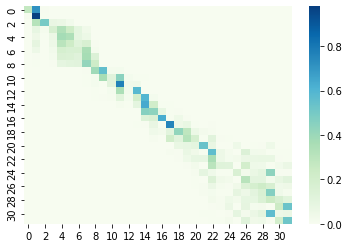

 47%|████▋     | 13.980544747081664/30 [11:26<28:56, 108.41s/it]

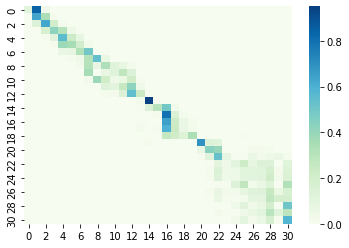

 47%|████▋     | 13.984435797665322/30 [11:27<28:26, 106.57s/it]

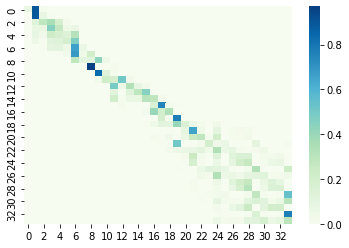

 47%|████▋     | 13.98832684824898/30 [11:27<27:56, 104.73s/it] 

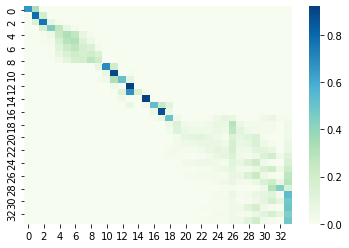

 47%|████▋     | 13.992217898832637/30 [11:28<27:46, 104.12s/it]

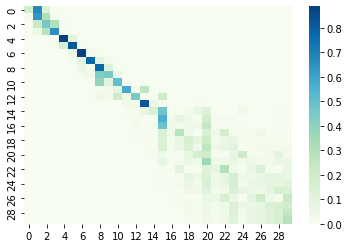

 47%|████▋     | 13.996108949416294/30 [11:28<27:33, 103.32s/it]

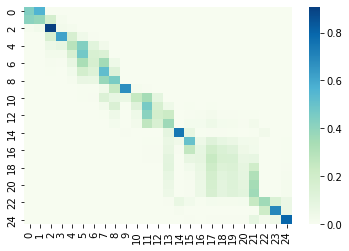

 47%|████▋     | 13.999999999999952/30 [11:28<28:03, 105.24s/it]

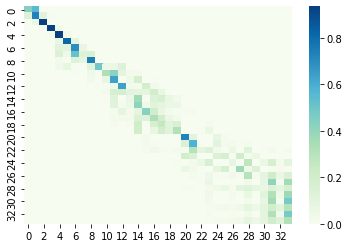

 49%|████▊     | 14.610894941634191/30 [11:44<05:37, 21.92s/it]

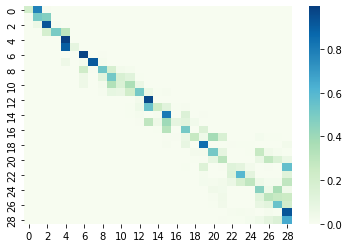

 49%|████▊     | 14.618677042801506/30 [11:45<10:29, 40.96s/it]

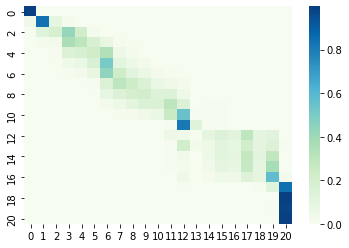

 49%|████▊     | 14.622568093385164/30 [11:45<12:38, 49.34s/it]

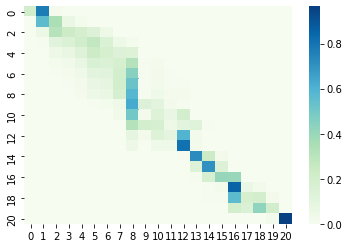

 49%|████▉     | 14.626459143968821/30 [11:46<15:02, 58.67s/it]

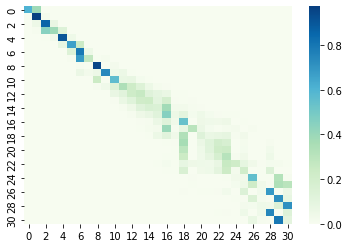

 49%|████▉     | 14.630350194552479/30 [11:46<19:25, 75.86s/it]

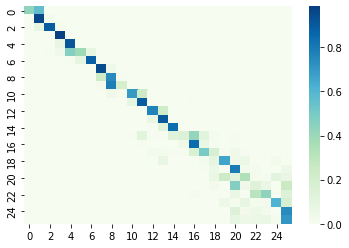

 49%|████▉     | 14.634241245136137/30 [11:47<20:34, 80.35s/it]

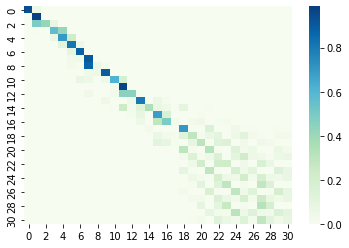

 49%|████▉     | 14.638132295719794/30 [11:47<21:34, 84.29s/it]

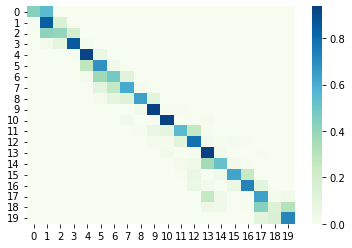

 49%|████▉     | 14.642023346303452/30 [11:47<22:15, 86.97s/it]

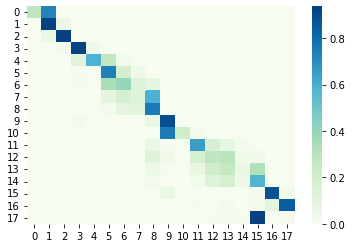

 49%|████▉     | 14.64591439688711/30 [11:48<24:14, 94.76s/it] 

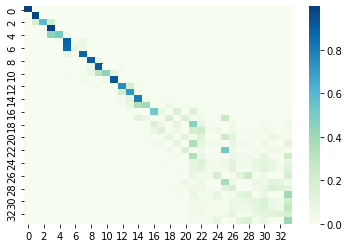

 49%|████▉     | 14.649805447470767/30 [11:48<24:34, 96.03s/it]

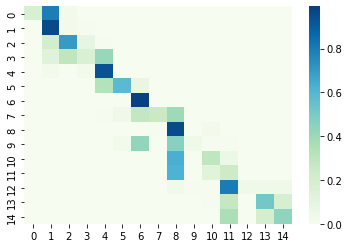

 49%|████▉     | 14.653696498054424/30 [11:49<24:34, 96.09s/it]

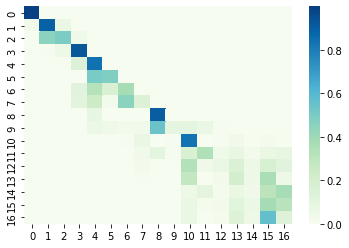

 49%|████▉     | 14.657587548638082/30 [11:49<25:20, 99.13s/it]

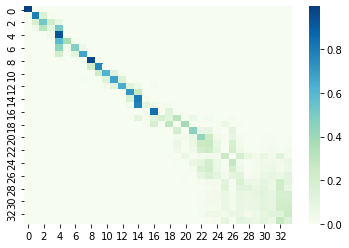

 49%|████▉     | 14.66147859922174/30 [11:49<24:37, 96.35s/it] 

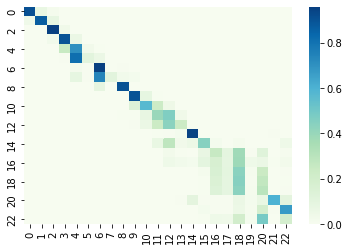

 49%|████▉     | 14.665369649805397/30 [11:50<25:32, 99.96s/it]

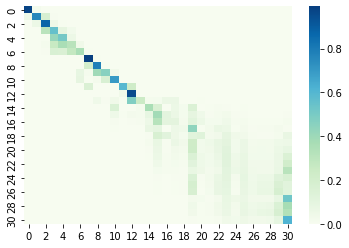

 49%|████▉     | 14.669260700389055/30 [11:50<25:11, 98.62s/it]

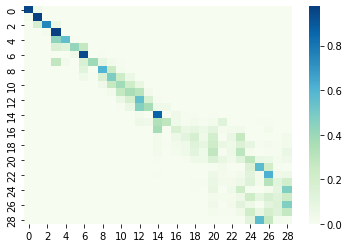

 49%|████▉     | 14.673151750972712/30 [11:51<27:07, 106.16s/it]

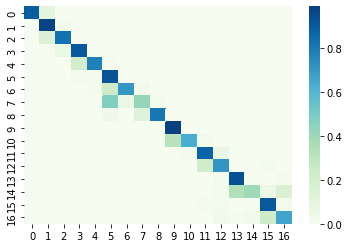

 49%|████▉     | 14.67704280155637/30 [11:51<26:33, 104.00s/it] 

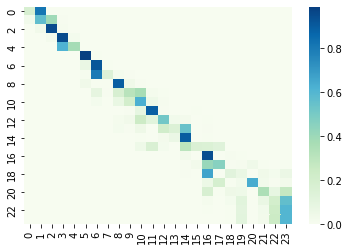

 49%|████▉     | 14.680933852140027/30 [11:52<26:50, 105.16s/it]

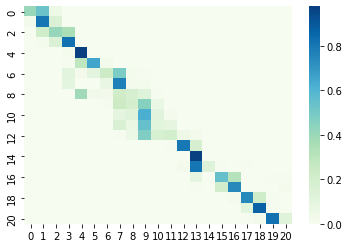

 49%|████▉     | 14.684824902723685/30 [11:52<26:28, 103.69s/it]

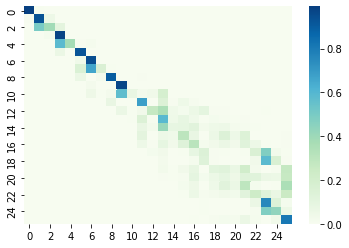

 49%|████▉     | 14.688715953307343/30 [11:52<25:30, 99.96s/it] 

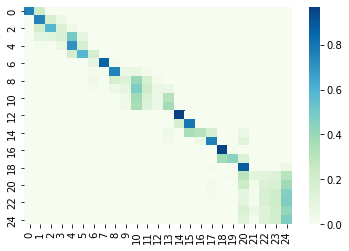

 49%|████▉     | 14.692607003891/30 [11:53<26:25, 103.59s/it]  

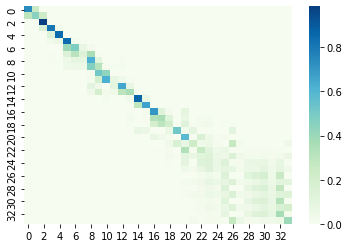

 49%|████▉     | 14.696498054474658/30 [11:53<26:26, 103.64s/it]

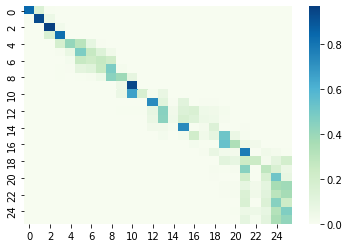

 49%|████▉     | 14.700389105058315/30 [11:53<24:39, 96.68s/it] 

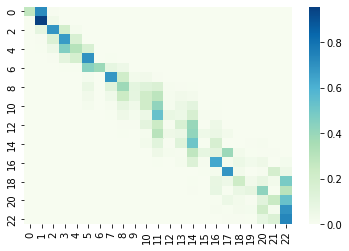

 49%|████▉     | 14.704280155641973/30 [11:54<24:18, 95.37s/it]

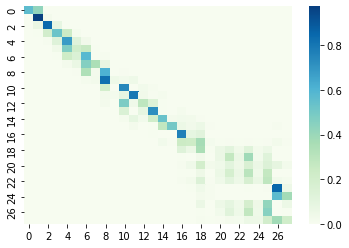

 49%|████▉     | 14.70817120622563/30 [11:54<24:13, 95.06s/it] 

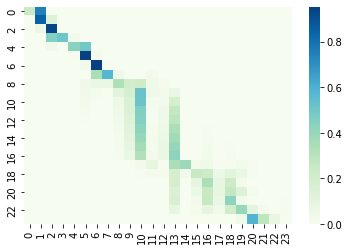

 49%|████▉     | 14.712062256809288/30 [11:55<24:29, 96.11s/it]

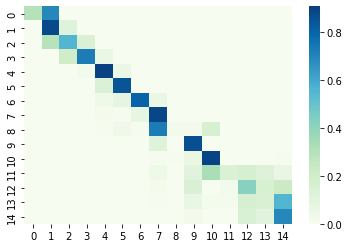

 49%|████▉     | 14.715953307392946/30 [11:55<27:08, 106.56s/it]

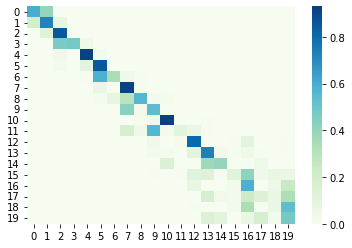

 49%|████▉     | 14.719844357976603/30 [11:55<27:24, 107.65s/it]

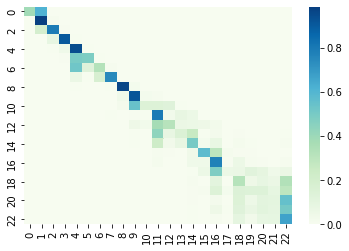

 49%|████▉     | 14.72373540856026/30 [11:56<26:18, 103.32s/it] 

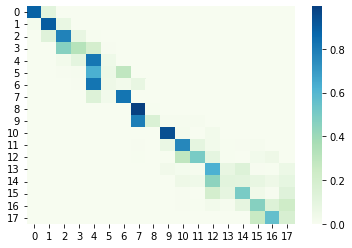

 49%|████▉     | 14.727626459143918/30 [11:56<26:24, 103.77s/it]

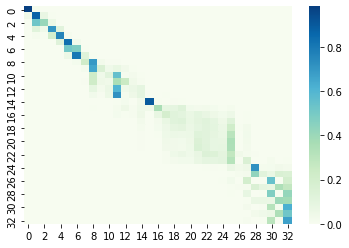

 49%|████▉     | 14.731517509727576/30 [11:57<26:43, 105.02s/it]

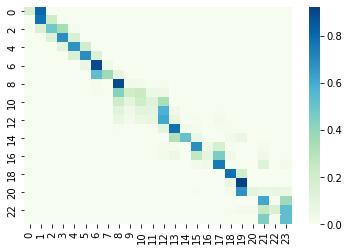

 49%|████▉     | 14.735408560311233/30 [11:57<25:44, 101.21s/it]

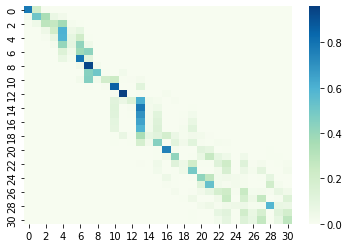

 49%|████▉     | 14.739299610894891/30 [11:57<24:46, 97.43s/it] 

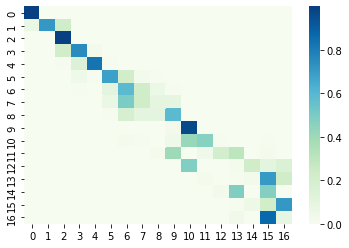

 49%|████▉     | 14.743190661478549/30 [11:58<25:11, 99.04s/it]

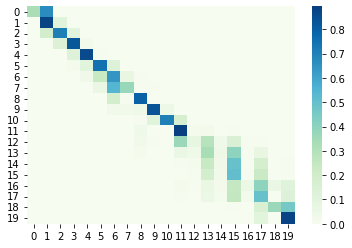

 49%|████▉     | 14.747081712062206/30 [11:58<25:30, 100.34s/it]

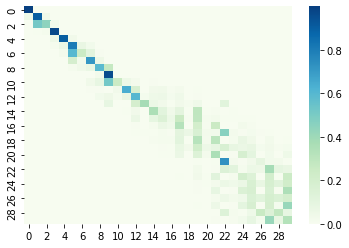

 49%|████▉     | 14.750972762645864/30 [11:58<24:22, 95.90s/it] 

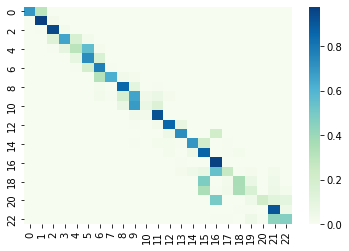

 49%|████▉     | 14.754863813229521/30 [11:59<24:46, 97.47s/it]

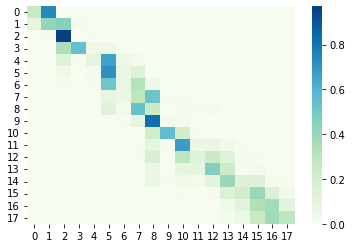

 49%|████▉     | 14.758754863813179/30 [11:59<27:44, 109.19s/it]

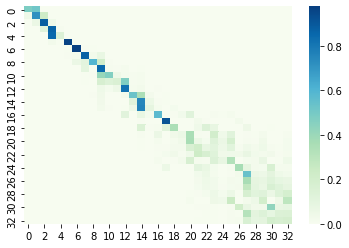

 49%|████▉     | 14.762645914396836/30 [12:00<27:16, 107.41s/it]

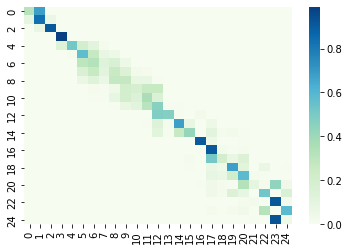

 49%|████▉     | 14.766536964980494/30 [12:00<27:49, 109.61s/it]

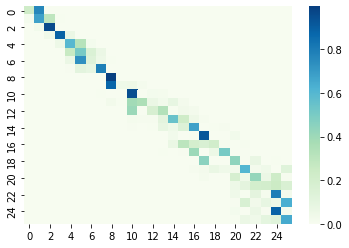

 49%|████▉     | 14.770428015564152/30 [12:01<26:32, 104.55s/it]

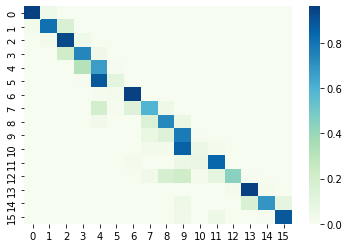

 49%|████▉     | 14.77431906614781/30 [12:01<25:54, 102.11s/it] 

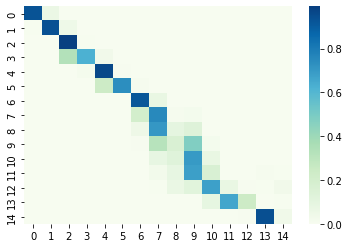

 49%|████▉     | 14.778210116731467/30 [12:01<24:46, 97.68s/it]

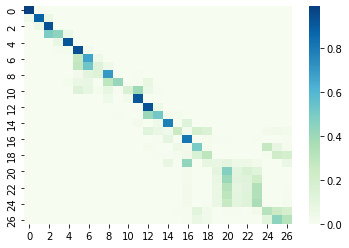

 49%|████▉     | 14.782101167315124/30 [12:02<23:40, 93.33s/it]

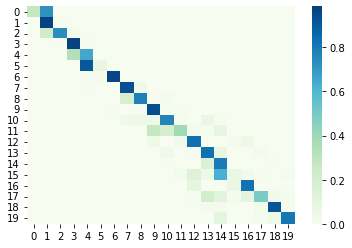

 49%|████▉     | 14.785992217898782/30 [12:02<26:55, 106.18s/it]

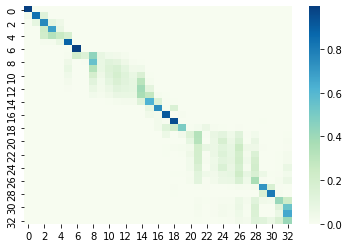

 49%|████▉     | 14.78988326848244/30 [12:03<27:23, 108.03s/it] 

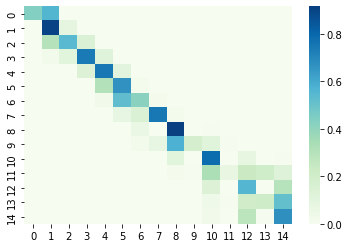

 49%|████▉     | 14.793774319066097/30 [12:03<28:10, 111.20s/it]

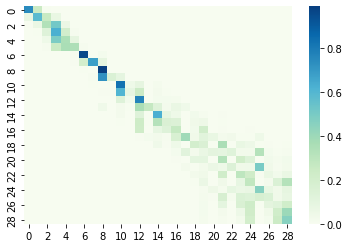

 49%|████▉     | 14.797665369649755/30 [12:04<28:34, 112.80s/it]

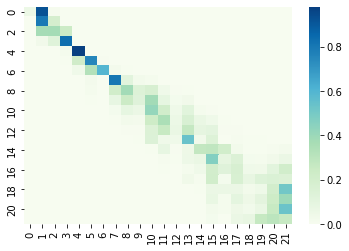

 49%|████▉     | 14.801556420233412/30 [12:04<30:28, 120.32s/it]

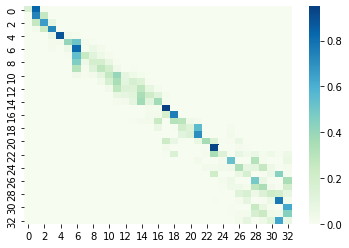

 49%|████▉     | 14.80544747081707/30 [12:05<30:21, 119.90s/it] 

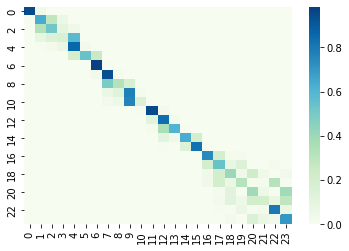

 49%|████▉     | 14.809338521400727/30 [12:05<30:48, 121.68s/it]

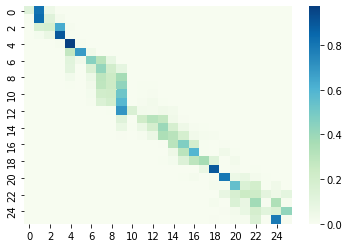

 49%|████▉     | 14.813229571984385/30 [12:05<29:44, 117.51s/it]

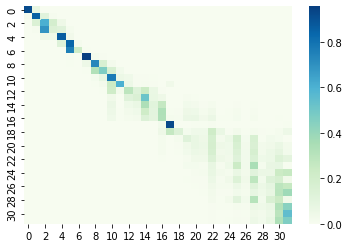

 49%|████▉     | 14.817120622568043/30 [12:06<29:58, 118.44s/it]

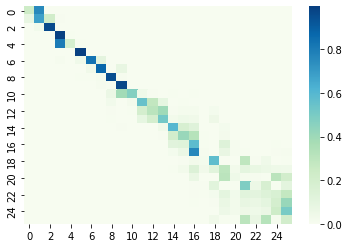

 49%|████▉     | 14.8210116731517/30 [12:06<28:08, 111.27s/it]  

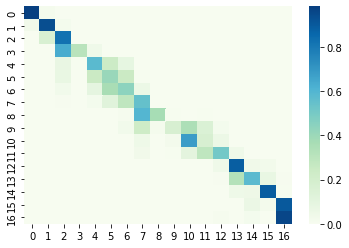

 49%|████▉     | 14.824902723735358/30 [12:07<28:01, 110.83s/it]

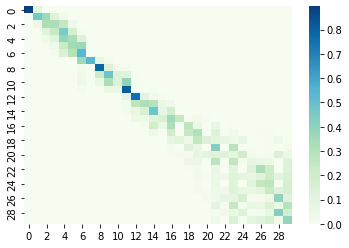

 49%|████▉     | 14.828793774319015/30 [12:07<28:12, 111.54s/it]

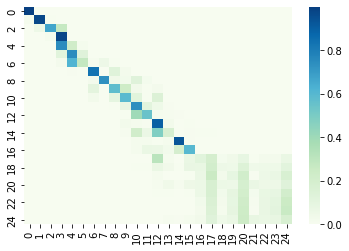

 49%|████▉     | 14.832684824902673/30 [12:08<28:16, 111.83s/it]

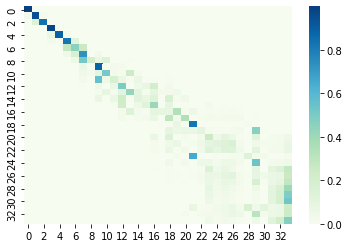

 49%|████▉     | 14.83657587548633/30 [12:08<26:39, 105.46s/it] 

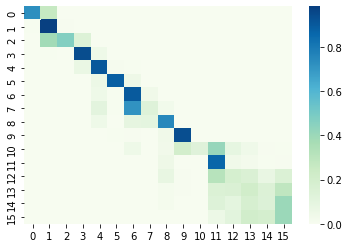

 49%|████▉     | 14.840466926069988/30 [12:08<25:23, 100.50s/it]

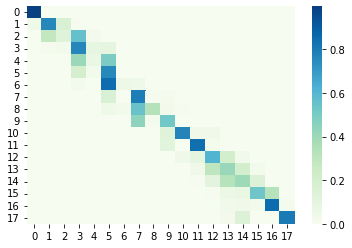

 49%|████▉     | 14.844357976653646/30 [12:09<28:46, 113.93s/it]

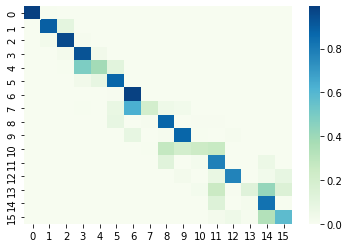

 49%|████▉     | 14.848249027237303/30 [12:09<27:39, 109.52s/it]

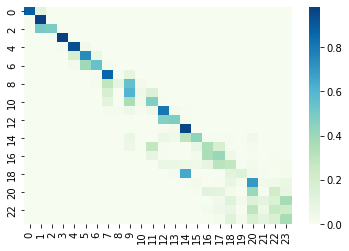

 50%|████▉     | 14.85214007782096/30 [12:10<28:08, 111.49s/it] 

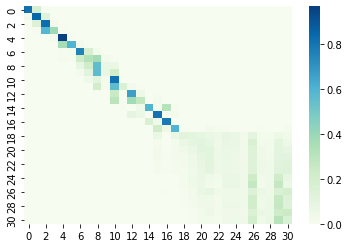

 50%|████▉     | 14.856031128404618/30 [12:10<26:07, 103.48s/it]

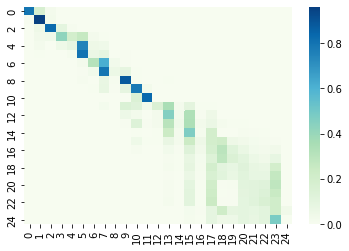

 50%|████▉     | 14.859922178988276/30 [12:10<25:49, 102.31s/it]

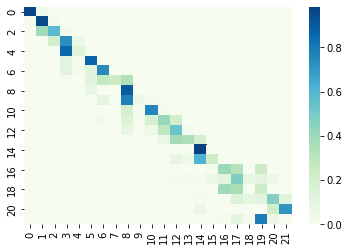

 50%|████▉     | 14.863813229571933/30 [12:11<26:10, 103.79s/it]

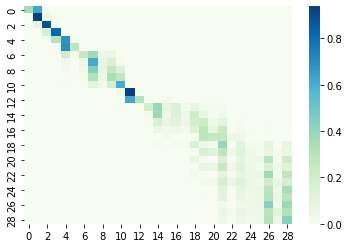

 50%|████▉     | 14.867704280155591/30 [12:11<25:38, 101.67s/it]

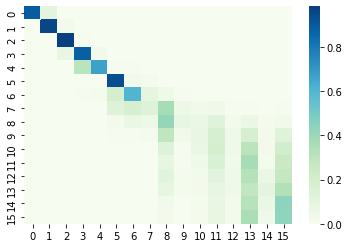

 50%|████▉     | 14.871595330739249/30 [12:12<25:34, 101.43s/it]

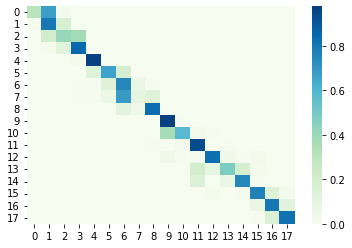

 50%|████▉     | 14.875486381322906/30 [12:12<26:29, 105.12s/it]

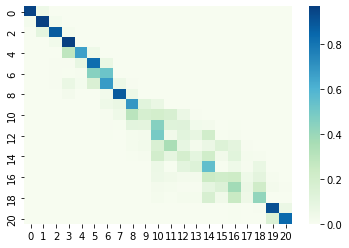

 50%|████▉     | 14.879377431906564/30 [12:12<25:56, 102.91s/it]

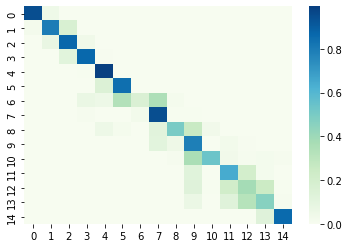

 50%|████▉     | 14.883268482490221/30 [12:13<25:05, 99.59s/it] 

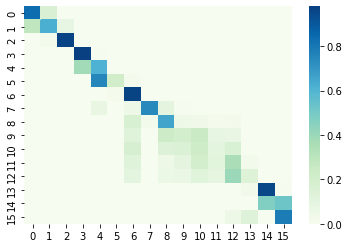

 50%|████▉     | 14.887159533073879/30 [12:13<27:47, 110.33s/it]

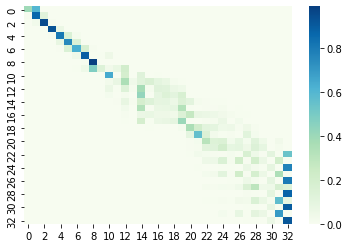

 50%|████▉     | 14.891050583657536/30 [12:14<26:40, 105.96s/it]

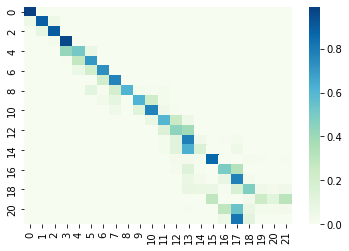

 50%|████▉     | 14.894941634241194/30 [12:14<26:53, 106.82s/it]

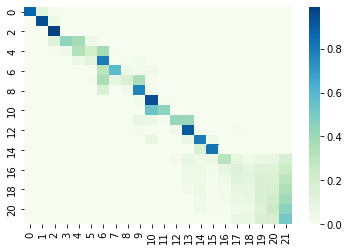

 50%|████▉     | 14.898832684824852/30 [12:14<26:01, 103.39s/it]

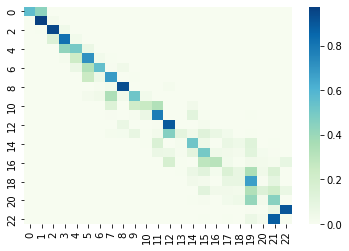

 50%|████▉     | 14.90272373540851/30 [12:15<25:23, 100.92s/it] 

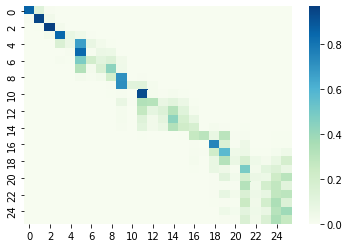

 50%|████▉     | 14.906614785992167/30 [12:15<25:13, 100.30s/it]

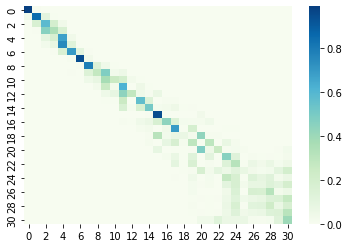

 50%|████▉     | 14.910505836575824/30 [12:16<25:21, 100.85s/it]

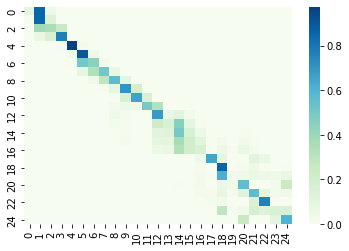

 50%|████▉     | 14.914396887159482/30 [12:16<26:19, 104.70s/it]

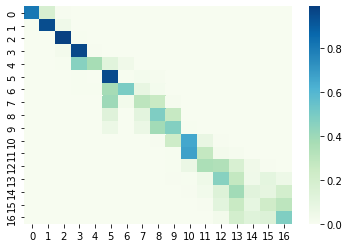

 50%|████▉     | 14.91828793774314/30 [12:16<25:30, 101.45s/it] 

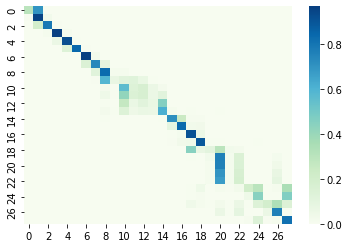

 50%|████▉     | 14.922178988326797/30 [12:17<24:45, 98.54s/it]

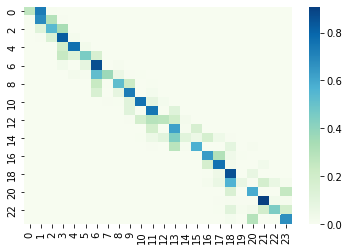

 50%|████▉     | 14.926070038910455/30 [12:17<25:42, 102.33s/it]

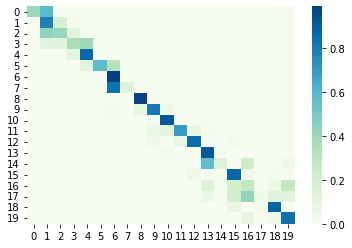

 50%|████▉     | 14.929961089494112/30 [12:18<29:11, 116.23s/it]

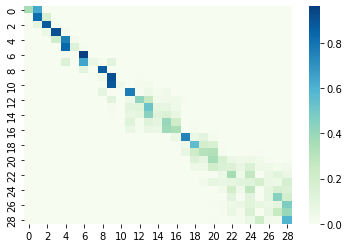

 50%|████▉     | 14.93385214007777/30 [12:18<27:56, 111.28s/it] 

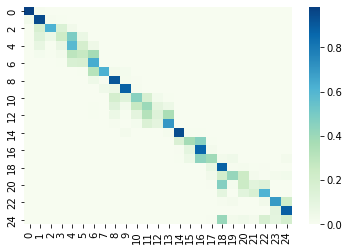

 50%|████▉     | 14.937743190661427/30 [12:19<27:32, 109.69s/it]

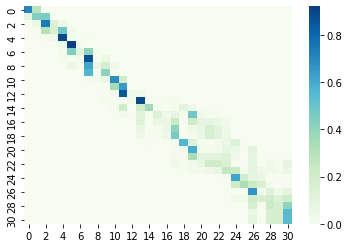

 50%|████▉     | 14.941634241245085/30 [12:19<26:42, 106.40s/it]

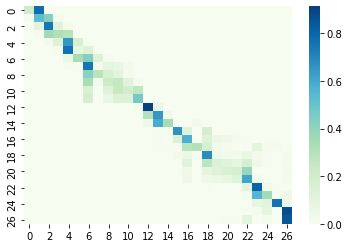

 50%|████▉     | 14.945525291828742/30 [12:19<25:49, 102.94s/it]

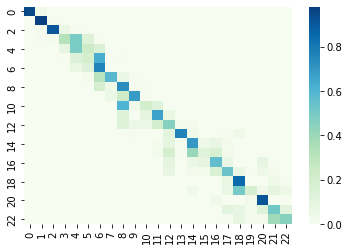

 50%|████▉     | 14.9494163424124/30 [12:20<26:19, 104.97s/it]  

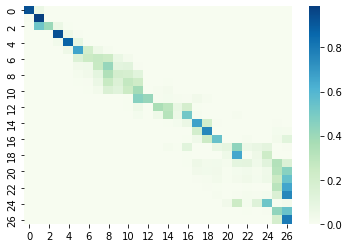

 50%|████▉     | 14.953307392996058/30 [12:20<24:32, 97.86s/it]

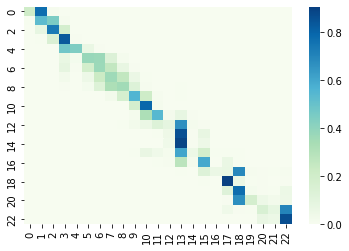

 50%|████▉     | 14.957198443579715/30 [12:20<24:39, 98.33s/it]

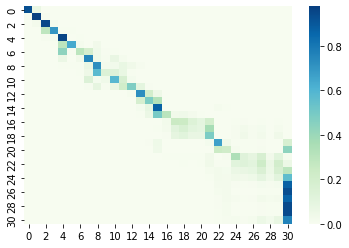

 50%|████▉     | 14.961089494163373/30 [12:21<25:03, 100.00s/it]

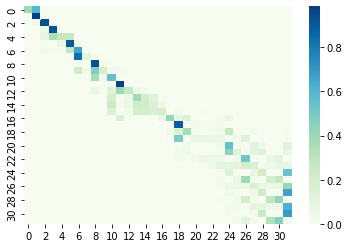

 50%|████▉     | 14.96498054474703/30 [12:21<25:18, 100.98s/it] 

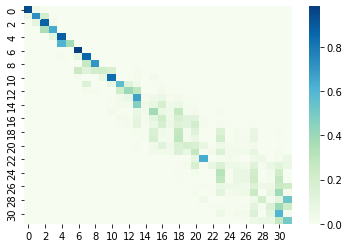

 50%|████▉     | 14.968871595330688/30 [12:22<25:08, 100.36s/it]

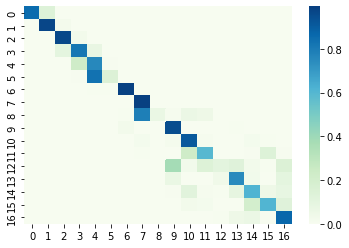

 50%|████▉     | 14.972762645914345/30 [12:22<28:13, 112.67s/it]

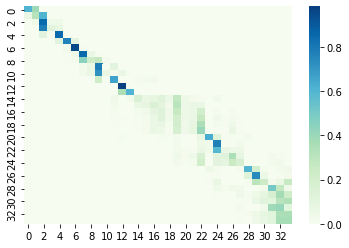

 50%|████▉     | 14.976653696498003/30 [12:23<27:53, 111.40s/it]

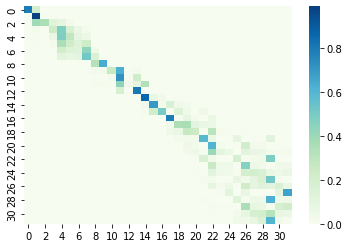

 50%|████▉     | 14.98054474708166/30 [12:23<27:08, 108.40s/it] 

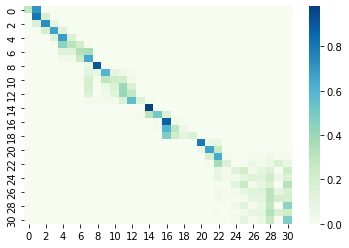

 50%|████▉     | 14.984435797665318/30 [12:23<26:53, 107.43s/it]

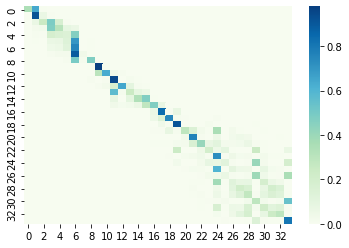

 50%|████▉     | 14.988326848248976/30 [12:24<26:30, 105.93s/it]

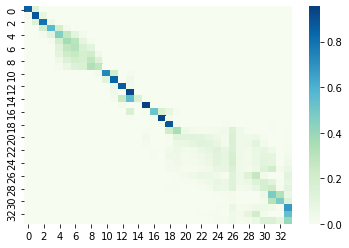

 50%|████▉     | 14.992217898832633/30 [12:24<26:21, 105.35s/it]

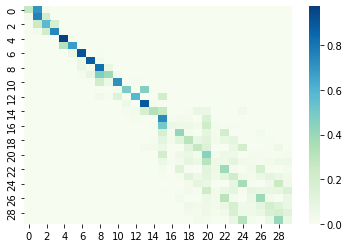

 50%|████▉     | 14.996108949416291/30 [12:25<26:00, 104.03s/it]

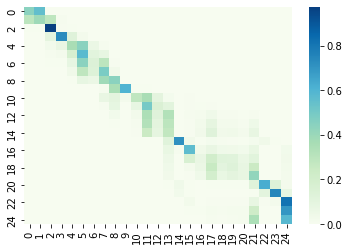

 50%|████▉     | 14.999999999999948/30 [12:25<26:27, 105.81s/it]

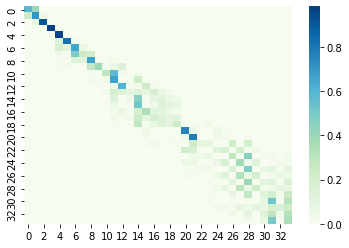

 52%|█████▏    | 15.614785992217845/30 [12:40<06:12, 25.89s/it]

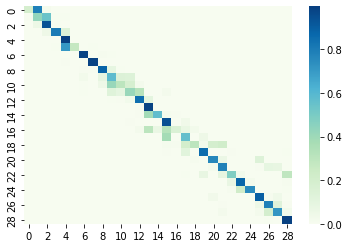

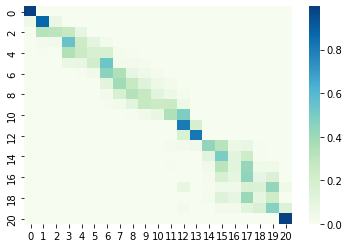

 52%|█████▏    | 15.62256809338516/30 [12:41<11:40, 48.73s/it] 

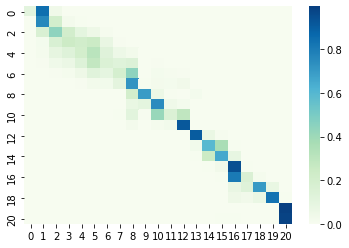

 52%|█████▏    | 15.626459143968818/30 [12:41<16:03, 67.04s/it]

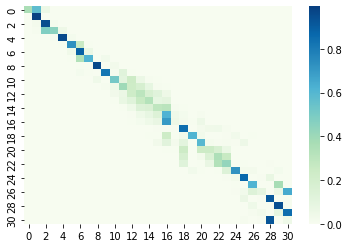

 52%|█████▏    | 15.630350194552475/30 [12:42<17:17, 72.19s/it]

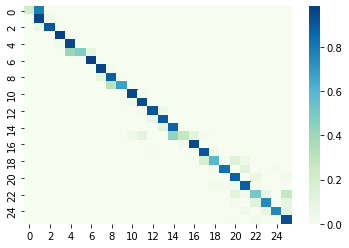

 52%|█████▏    | 15.634241245136133/30 [12:42<17:55, 74.87s/it]

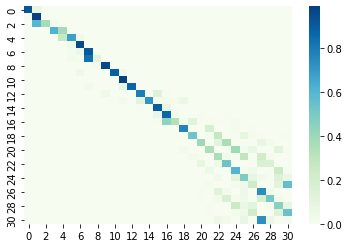

 52%|█████▏    | 15.63813229571979/30 [12:42<19:14, 80.40s/it] 

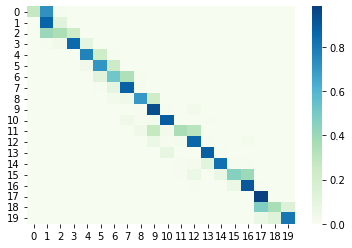

 52%|█████▏    | 15.642023346303448/30 [12:43<21:13, 88.72s/it]

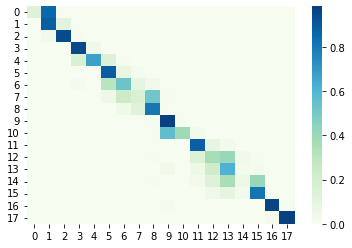

 52%|█████▏    | 15.645914396887106/30 [12:43<22:29, 93.99s/it]

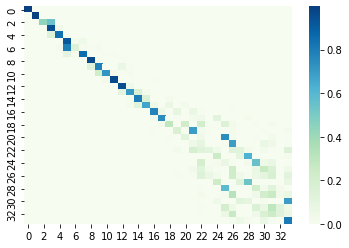

 52%|█████▏    | 15.649805447470763/30 [12:44<22:40, 94.79s/it]

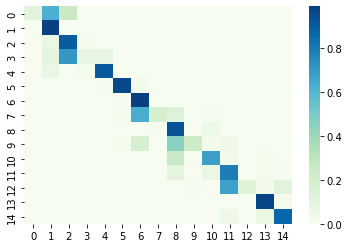

 52%|█████▏    | 15.65369649805442/30 [12:44<22:33, 94.35s/it] 

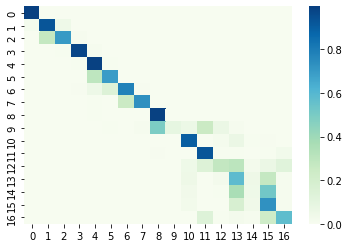

 52%|█████▏    | 15.657587548638078/30 [12:44<23:18, 97.53s/it]

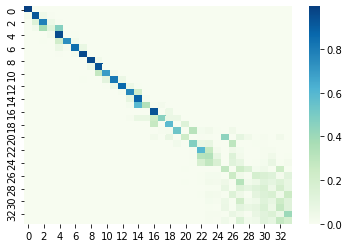

 52%|█████▏    | 15.661478599221736/30 [12:45<23:54, 100.06s/it]

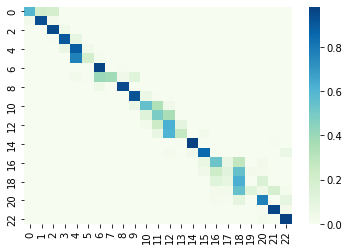

 52%|█████▏    | 15.665369649805394/30 [12:45<24:12, 101.36s/it]

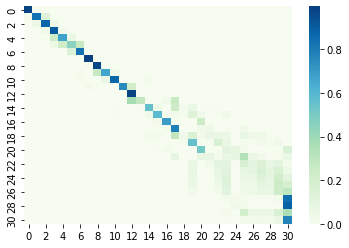

 52%|█████▏    | 15.669260700389051/30 [12:46<27:18, 114.31s/it]

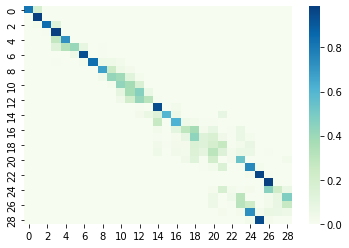

 52%|█████▏    | 15.673151750972709/30 [12:46<26:07, 109.39s/it]

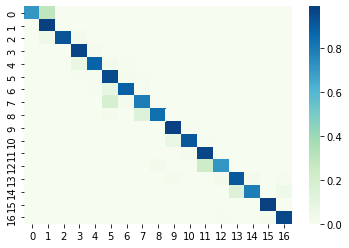

 52%|█████▏    | 15.677042801556366/30 [12:47<25:45, 107.87s/it]

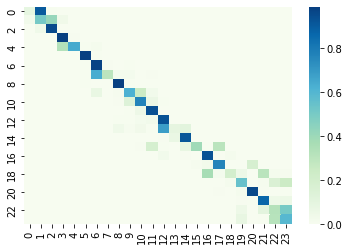

 52%|█████▏    | 15.680933852140024/30 [12:47<26:04, 109.25s/it]

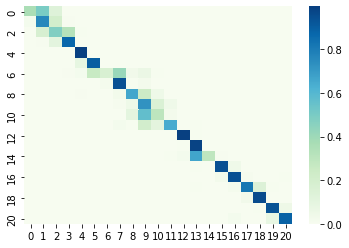

 52%|█████▏    | 15.684824902723681/30 [12:47<25:28, 106.79s/it]

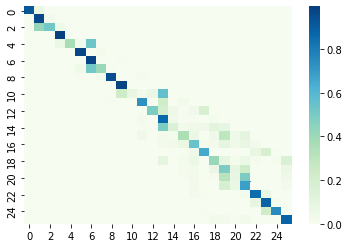

 52%|█████▏    | 15.688715953307339/30 [12:48<24:26, 102.44s/it]

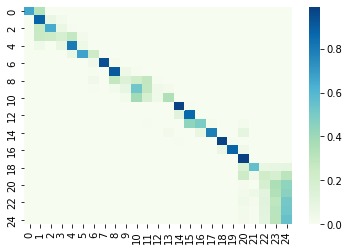

 52%|█████▏    | 15.692607003890997/30 [12:48<25:25, 106.62s/it]

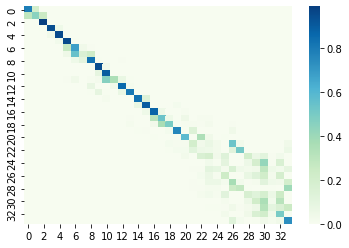

 52%|█████▏    | 15.696498054474654/30 [12:49<25:19, 106.20s/it]

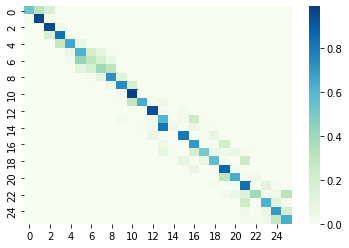

 52%|█████▏    | 15.700389105058312/30 [12:49<23:37, 99.14s/it] 

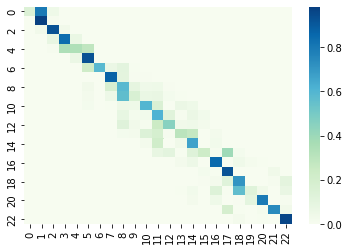

 52%|█████▏    | 15.70428015564197/30 [12:49<23:15, 97.61s/it] 

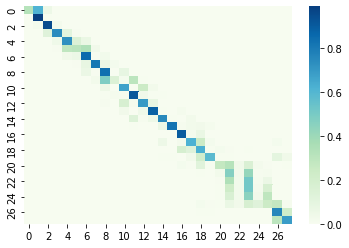

 52%|█████▏    | 15.708171206225627/30 [12:50<23:02, 96.73s/it]

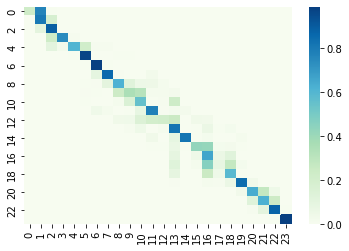

 52%|█████▏    | 15.712062256809284/30 [12:50<26:32, 111.45s/it]

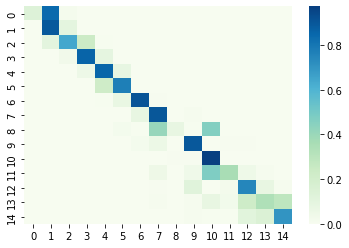

 52%|█████▏    | 15.715953307392942/30 [12:51<25:31, 107.19s/it]

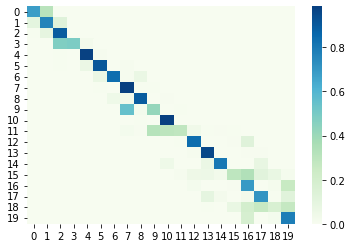

 52%|█████▏    | 15.7198443579766/30 [12:51<25:37, 107.68s/it]  

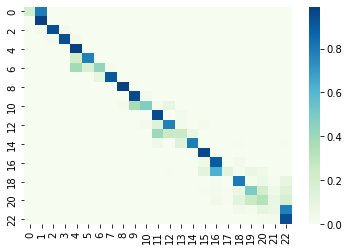

 52%|█████▏    | 15.723735408560257/30 [12:51<24:57, 104.90s/it]

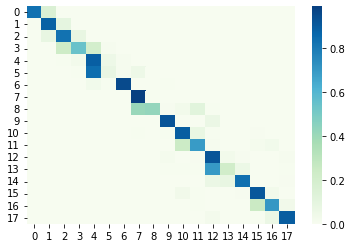

 52%|█████▏    | 15.727626459143915/30 [12:52<25:22, 106.65s/it]

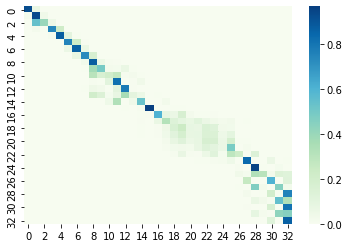

 52%|█████▏    | 15.731517509727572/30 [12:52<23:59, 100.91s/it]

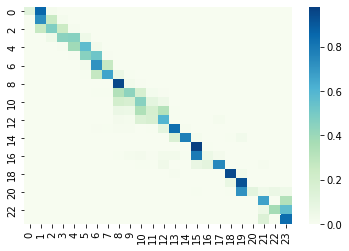

 52%|█████▏    | 15.73540856031123/30 [12:53<23:30, 98.88s/it]  

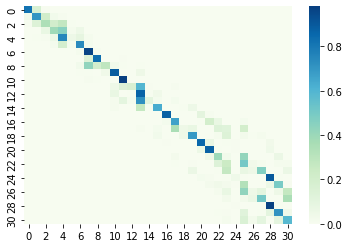

 52%|█████▏    | 15.739299610894887/30 [12:53<23:48, 100.16s/it]

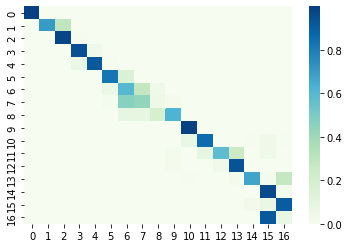

 52%|█████▏    | 15.743190661478545/30 [12:53<23:54, 100.64s/it]

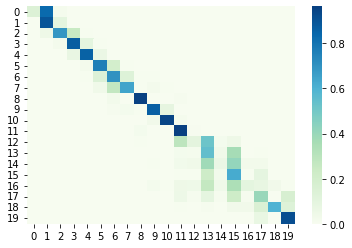

 52%|█████▏    | 15.747081712062203/30 [12:54<24:47, 104.39s/it]

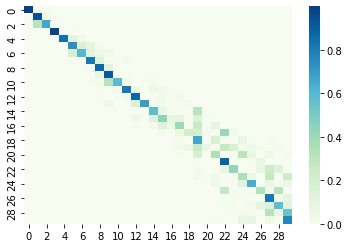

 53%|█████▎    | 15.75097276264586/30 [12:54<24:00, 101.11s/it] 

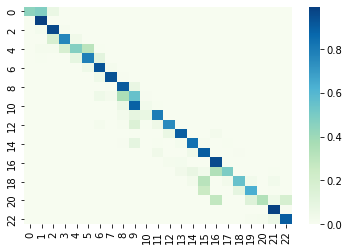

 53%|█████▎    | 15.754863813229518/30 [12:55<27:21, 115.21s/it]

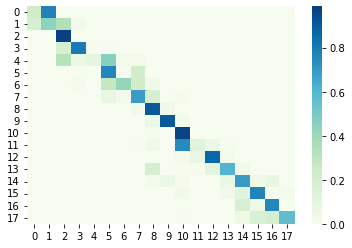

 53%|█████▎    | 15.758754863813175/30 [12:55<26:57, 113.59s/it]

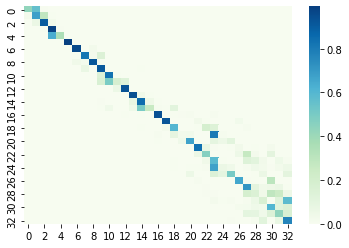

 53%|█████▎    | 15.762645914396833/30 [12:56<26:22, 111.13s/it]

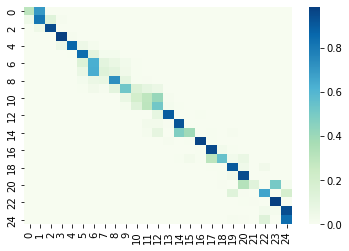

 53%|█████▎    | 15.76653696498049/30 [12:56<26:24, 111.33s/it] 

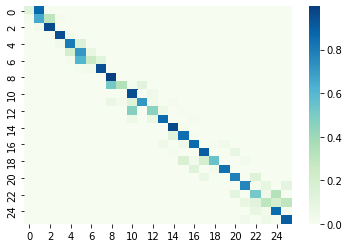

 53%|█████▎    | 15.770428015564148/30 [12:56<24:56, 105.16s/it]

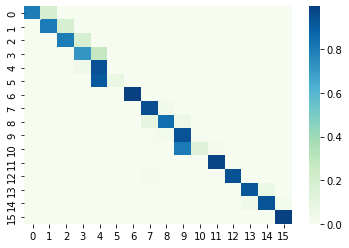

 53%|█████▎    | 15.774319066147806/30 [12:57<24:41, 104.16s/it]

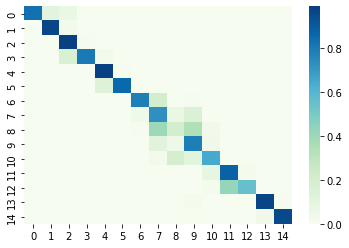

 53%|█████▎    | 15.778210116731463/30 [12:57<23:23, 98.68s/it] 

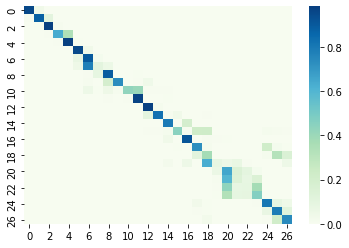

 53%|█████▎    | 15.78210116731512/30 [12:58<23:13, 97.98s/it] 

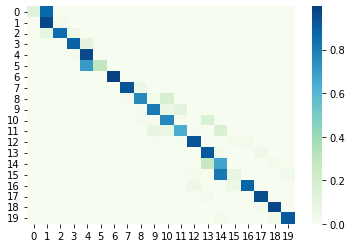

 53%|█████▎    | 15.785992217898778/30 [12:58<24:32, 103.63s/it]

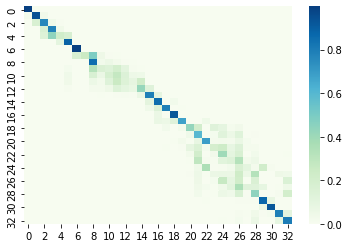

 53%|█████▎    | 15.789883268482436/30 [12:58<24:37, 103.94s/it]

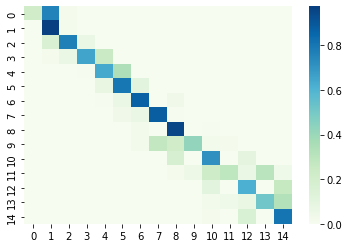

 53%|█████▎    | 15.793774319066094/30 [12:59<23:19, 98.49s/it] 

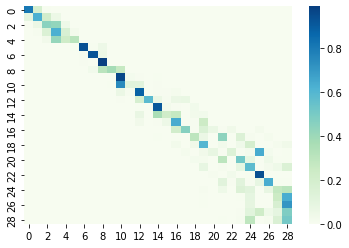

 53%|█████▎    | 15.797665369649751/30 [12:59<24:52, 105.09s/it]

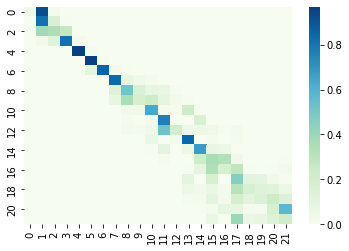

 53%|█████▎    | 15.801556420233409/30 [13:00<23:50, 100.76s/it]

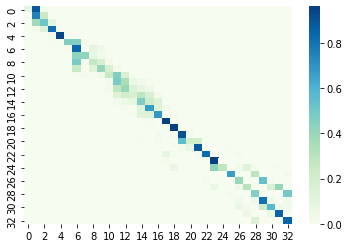

 53%|█████▎    | 15.805447470817066/30 [13:00<23:24, 98.92s/it] 

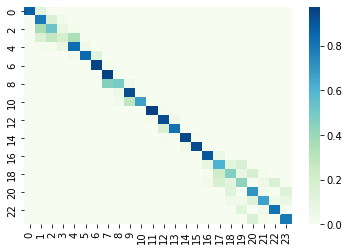

 53%|█████▎    | 15.809338521400724/30 [13:00<24:09, 102.13s/it]

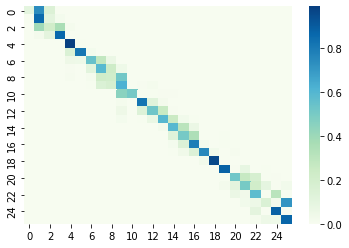

 53%|█████▎    | 15.813229571984381/30 [13:01<23:53, 101.04s/it]

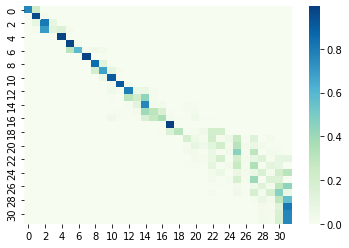

 53%|█████▎    | 15.817120622568039/30 [13:01<23:44, 100.47s/it]

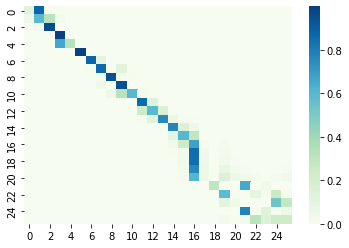

 53%|█████▎    | 15.821011673151697/30 [13:01<23:22, 98.89s/it] 

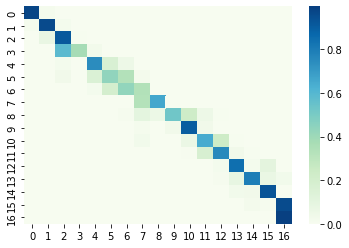

 53%|█████▎    | 15.824902723735354/30 [13:02<23:38, 100.08s/it]

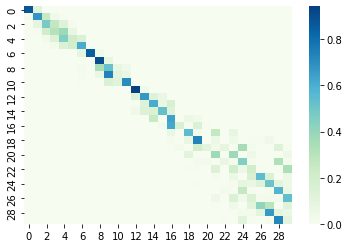

 53%|█████▎    | 15.828793774319012/30 [13:02<23:23, 99.02s/it] 

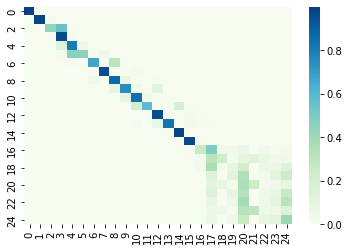

 53%|█████▎    | 15.83268482490267/30 [13:03<24:33, 104.00s/it]

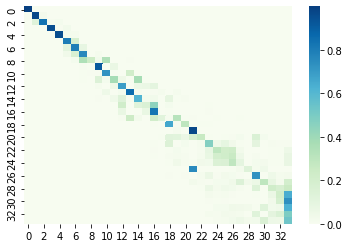

 53%|█████▎    | 15.836575875486327/30 [13:03<24:26, 103.53s/it]

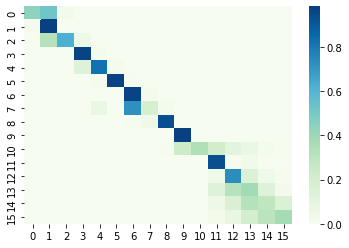

 53%|█████▎    | 15.840466926069984/30 [13:04<27:36, 116.98s/it]

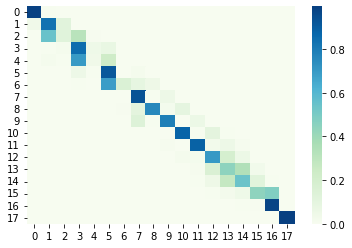

 53%|█████▎    | 15.844357976653642/30 [13:04<27:00, 114.51s/it]

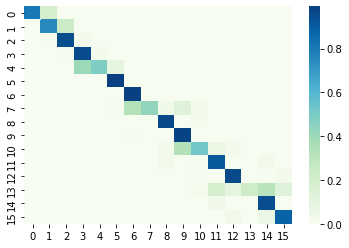

 53%|█████▎    | 15.8482490272373/30 [13:04<25:47, 109.32s/it]  

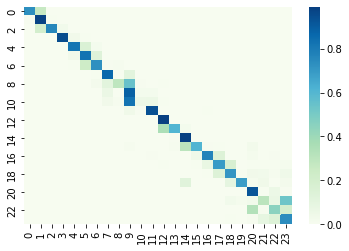

 53%|█████▎    | 15.852140077820957/30 [13:05<26:05, 110.62s/it]

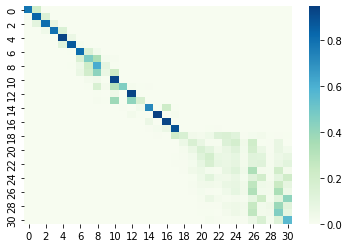

 53%|█████▎    | 15.856031128404615/30 [13:05<25:44, 109.21s/it]

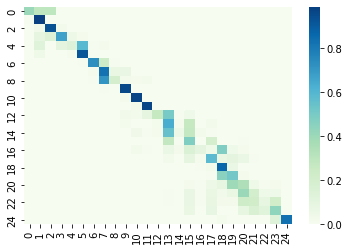

 53%|█████▎    | 15.859922178988272/30 [13:06<25:47, 109.42s/it]

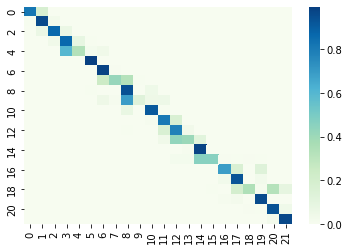

 53%|█████▎    | 15.86381322957193/30 [13:06<25:53, 109.89s/it] 

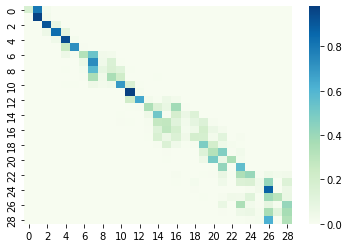

 53%|█████▎    | 15.867704280155587/30 [13:07<26:00, 110.44s/it]

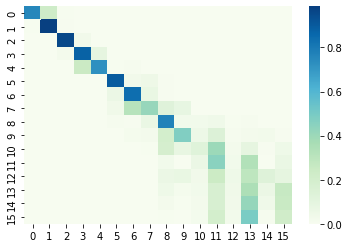

 53%|█████▎    | 15.871595330739245/30 [13:07<25:46, 109.47s/it]

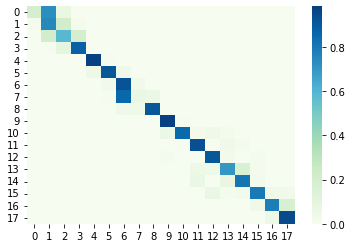

 53%|█████▎    | 15.875486381322903/30 [13:07<25:10, 106.93s/it]

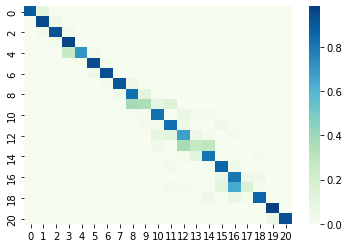

 53%|█████▎    | 15.87937743190656/30 [13:08<25:12, 107.11s/it] 

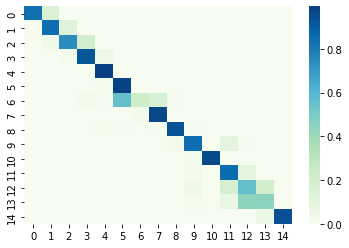

 53%|█████▎    | 15.883268482490218/30 [13:08<27:38, 117.45s/it]

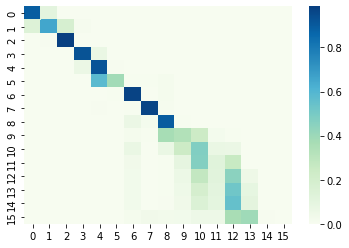

 53%|█████▎    | 15.887159533073875/30 [13:09<26:30, 112.67s/it]

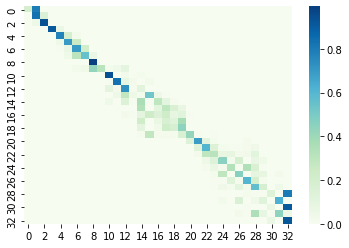

 53%|█████▎    | 15.891050583657533/30 [13:09<27:05, 115.21s/it]

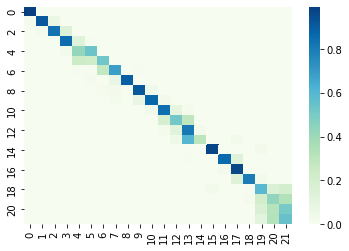

 53%|█████▎    | 15.89494163424119/30 [13:10<25:28, 108.34s/it] 

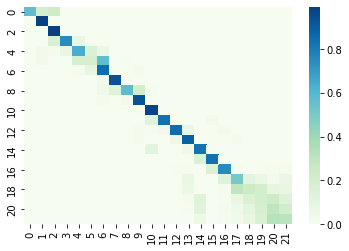

 53%|█████▎    | 15.898832684824848/30 [13:10<25:12, 107.24s/it]

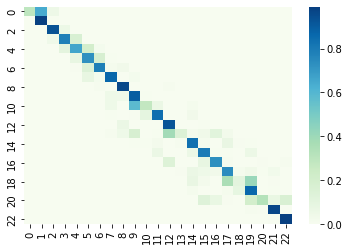

 53%|█████▎    | 15.902723735408506/30 [13:10<24:27, 104.07s/it]

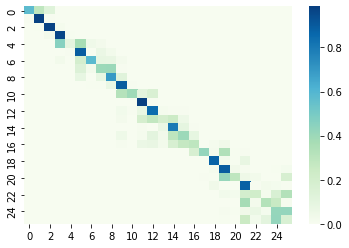

 53%|█████▎    | 15.906614785992163/30 [13:11<23:18, 99.20s/it] 

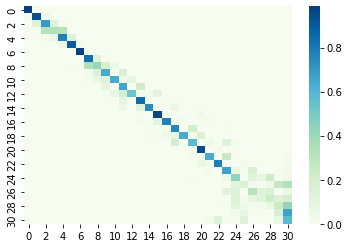

 53%|█████▎    | 15.91050583657582/30 [13:11<23:06, 98.38s/it] 

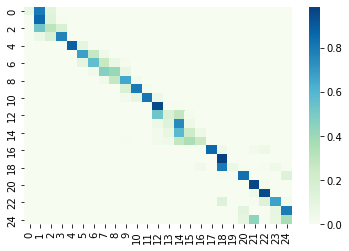

 53%|█████▎    | 15.914396887159478/30 [13:12<23:22, 99.58s/it]

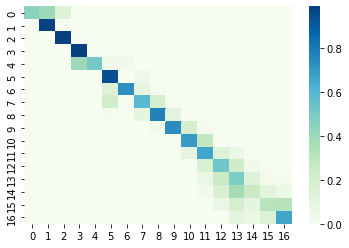

 53%|█████▎    | 15.918287937743136/30 [13:12<23:59, 102.21s/it]

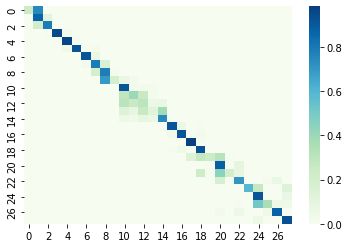

 53%|█████▎    | 15.922178988326793/30 [13:12<22:53, 97.54s/it] 

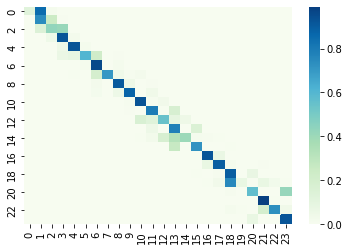

 53%|█████▎    | 15.926070038910451/30 [13:13<25:25, 108.40s/it]

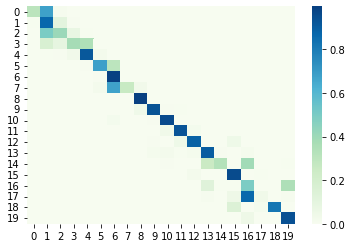

 53%|█████▎    | 15.929961089494109/30 [13:13<25:36, 109.18s/it]

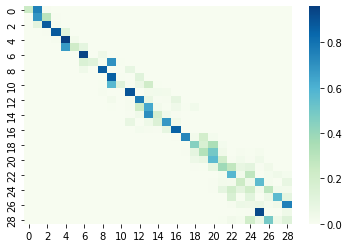

 53%|█████▎    | 15.933852140077766/30 [13:14<24:11, 103.19s/it]

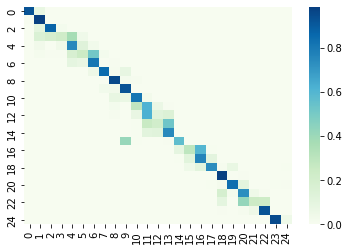

 53%|█████▎    | 15.937743190661424/30 [13:14<24:40, 105.26s/it]

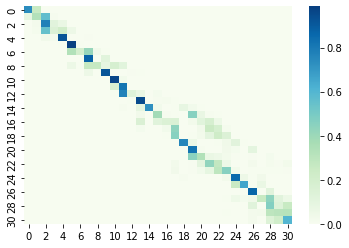

 53%|█████▎    | 15.941634241245081/30 [13:14<24:34, 104.88s/it]

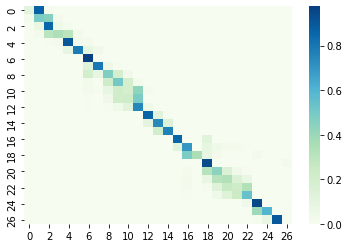

 53%|█████▎    | 15.945525291828739/30 [13:15<23:57, 102.30s/it]

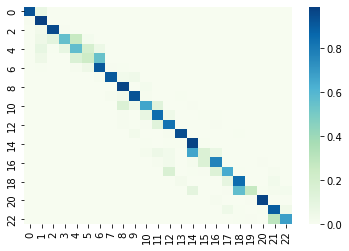

 53%|█████▎    | 15.949416342412396/30 [13:15<24:14, 103.55s/it]

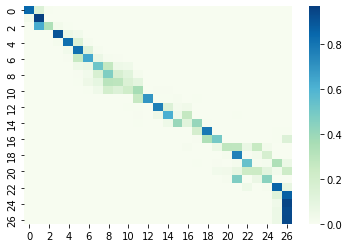

 53%|█████▎    | 15.953307392996054/30 [13:16<23:57, 102.32s/it]

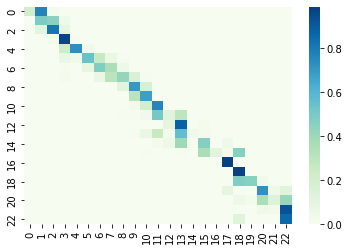

 53%|█████▎    | 15.957198443579712/30 [13:16<23:26, 100.16s/it]

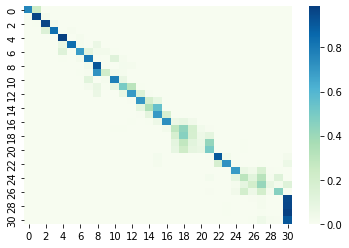

 53%|█████▎    | 15.96108949416337/30 [13:16<23:45, 101.54s/it] 

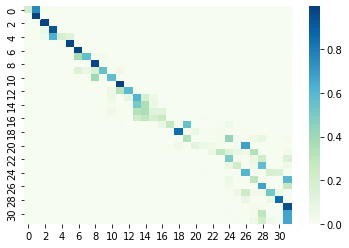

 53%|█████▎    | 15.964980544747027/30 [13:17<23:15, 99.45s/it]

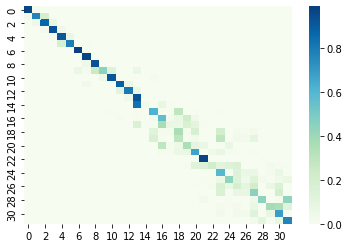

 53%|█████▎    | 15.968871595330684/30 [13:17<25:01, 106.98s/it]

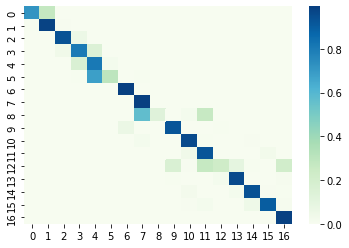

 53%|█████▎    | 15.972762645914342/30 [13:18<23:31, 100.61s/it]

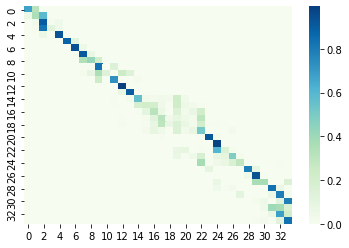

 53%|█████▎    | 15.976653696498/30 [13:18<23:17, 99.63s/it]    

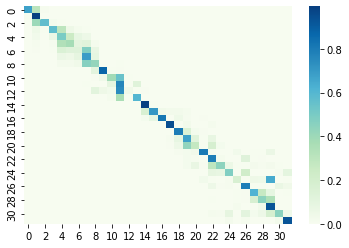

 53%|█████▎    | 15.980544747081657/30 [13:18<22:36, 96.79s/it]

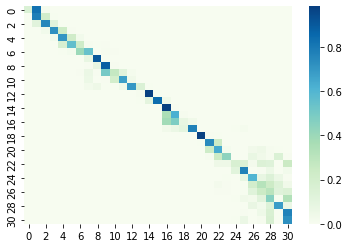

 53%|█████▎    | 15.984435797665315/30 [13:19<22:27, 96.16s/it]

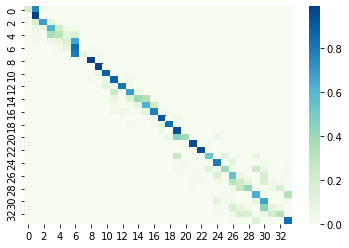

 53%|█████▎    | 15.988326848248972/30 [13:19<22:00, 94.23s/it]

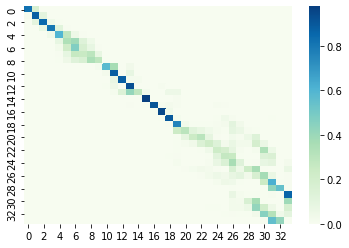

 53%|█████▎    | 15.99221789883263/30 [13:19<22:26, 96.14s/it] 

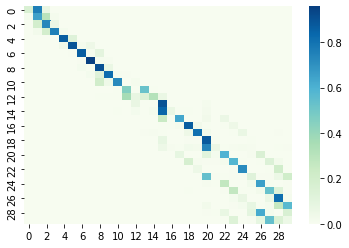

 53%|█████▎    | 15.996108949416287/30 [13:20<22:11, 95.10s/it]

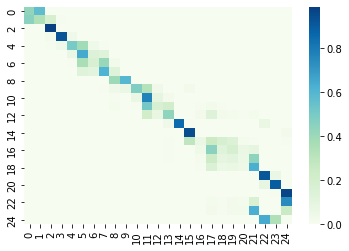

 53%|█████▎    | 15.999999999999945/30 [13:20<22:28, 96.32s/it]

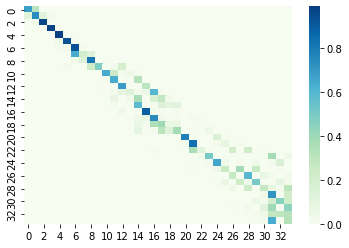

 55%|█████▌    | 16.614785992217843/30 [13:35<06:01, 26.99s/it]

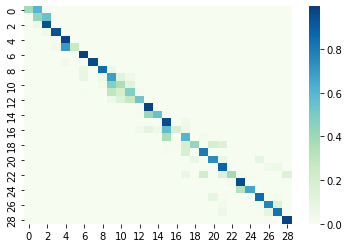

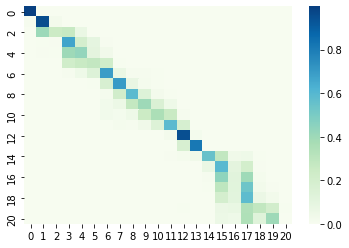

 55%|█████▌    | 16.62256809338516/30 [13:36<12:14, 54.91s/it] 

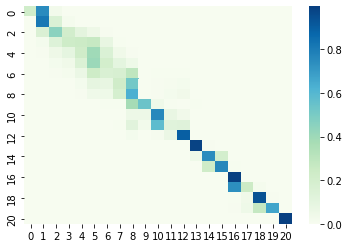

 55%|█████▌    | 16.626459143968816/30 [13:36<13:27, 60.38s/it]

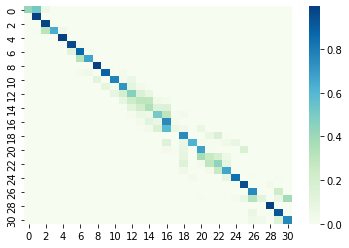

 55%|█████▌    | 16.630350194552474/30 [13:37<15:20, 68.83s/it]

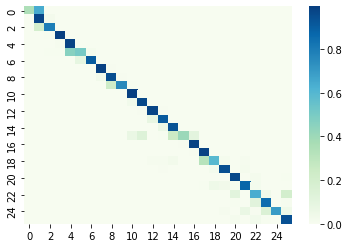

 55%|█████▌    | 16.63424124513613/30 [13:37<16:37, 74.60s/it] 

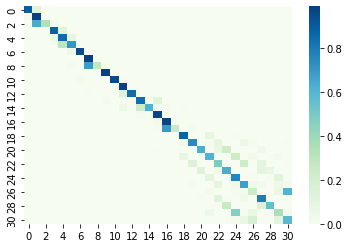

 55%|█████▌    | 16.63813229571979/30 [13:37<17:39, 79.26s/it]

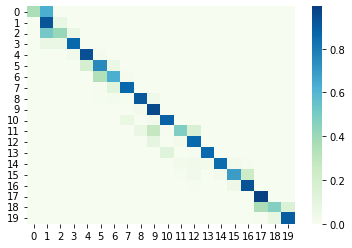

 55%|█████▌    | 16.642023346303446/30 [13:38<19:36, 88.09s/it]

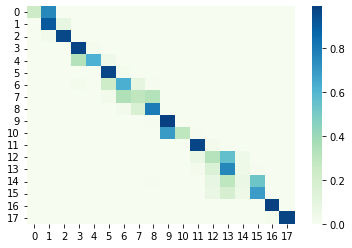

 55%|█████▌    | 16.645914396887104/30 [13:38<21:23, 96.10s/it]

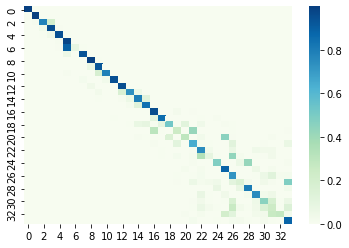

 55%|█████▌    | 16.64980544747076/30 [13:39<21:29, 96.59s/it] 

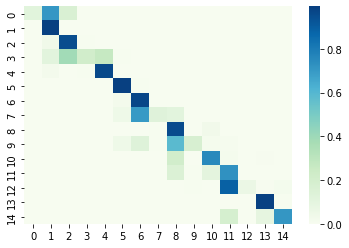

 56%|█████▌    | 16.65369649805442/30 [13:39<21:12, 95.37s/it]

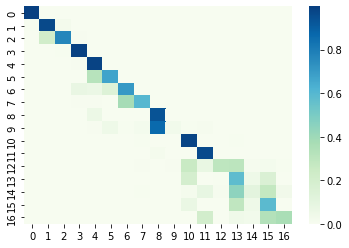

 56%|█████▌    | 16.657587548638077/30 [13:39<21:38, 97.33s/it]

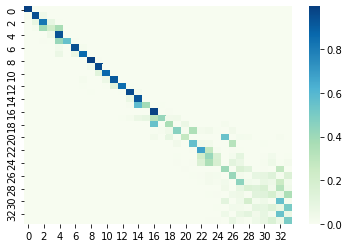

 56%|█████▌    | 16.661478599221734/30 [13:40<22:07, 99.51s/it]

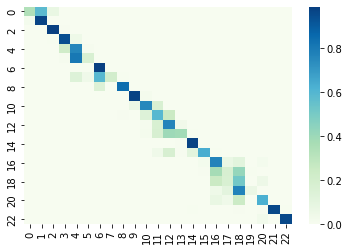

 56%|█████▌    | 16.665369649805392/30 [13:40<24:51, 111.85s/it]

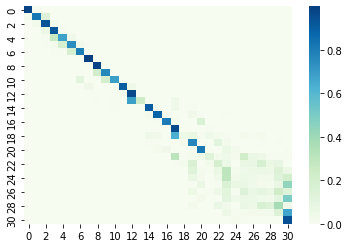

 56%|█████▌    | 16.66926070038905/30 [13:41<24:07, 108.62s/it] 

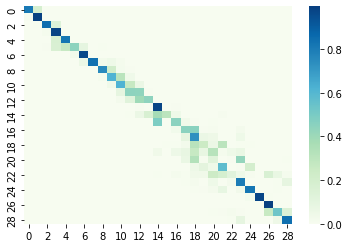

 56%|█████▌    | 16.673151750972707/30 [13:41<22:42, 102.25s/it]

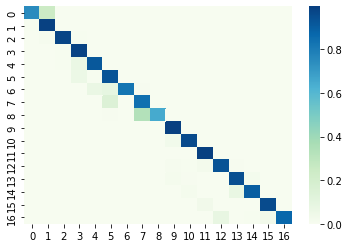

 56%|█████▌    | 16.677042801556365/30 [13:41<22:41, 102.17s/it]

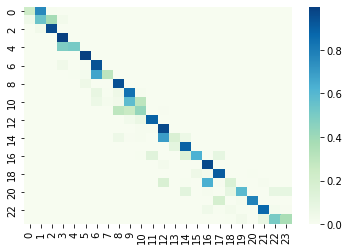

 56%|█████▌    | 16.680933852140022/30 [13:42<22:57, 103.44s/it]

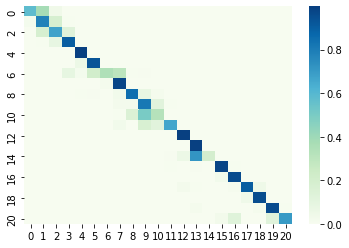

 56%|█████▌    | 16.68482490272368/30 [13:42<22:43, 102.43s/it] 

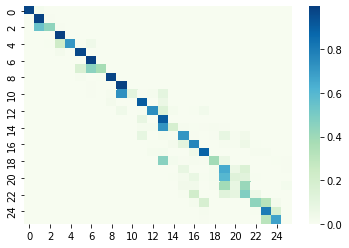

 56%|█████▌    | 16.688715953307337/30 [13:43<21:34, 97.27s/it]

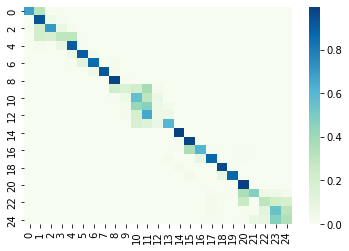

 56%|█████▌    | 16.692607003890995/30 [13:43<22:47, 102.75s/it]

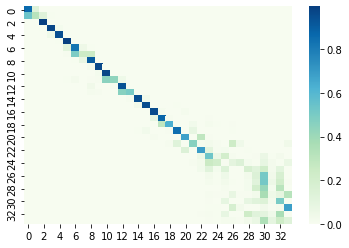

 56%|█████▌    | 16.696498054474652/30 [13:43<22:33, 101.77s/it]

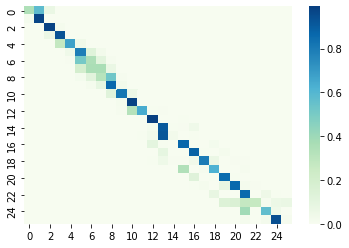

 56%|█████▌    | 16.70038910505831/30 [13:44<20:58, 94.64s/it]  

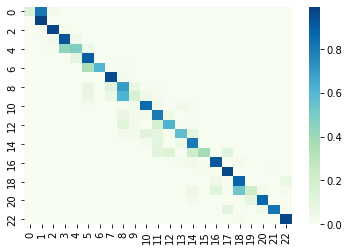

 56%|█████▌    | 16.704280155641968/30 [13:44<21:47, 98.30s/it]

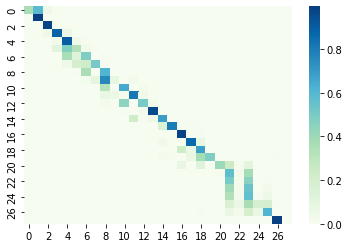

 56%|█████▌    | 16.708171206225625/30 [13:45<23:40, 106.84s/it]

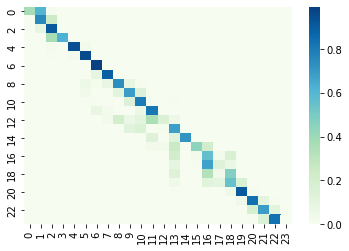

 56%|█████▌    | 16.712062256809283/30 [13:45<23:31, 106.23s/it]

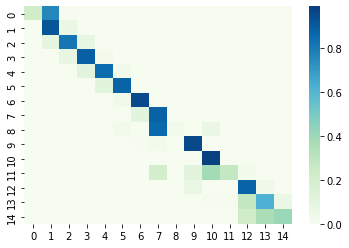

 56%|█████▌    | 16.71595330739294/30 [13:45<23:06, 104.39s/it] 

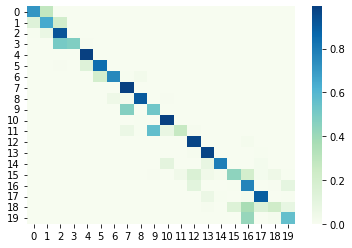

 56%|█████▌    | 16.719844357976598/30 [13:46<23:17, 105.20s/it]

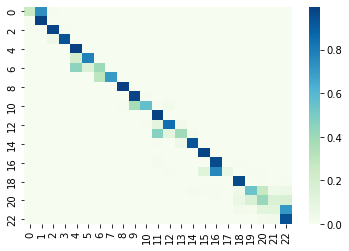

 56%|█████▌    | 16.723735408560255/30 [13:46<23:30, 106.28s/it]

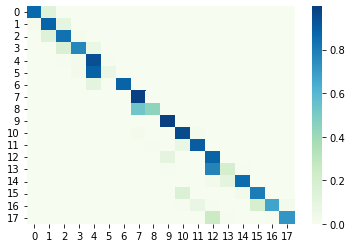

 56%|█████▌    | 16.727626459143913/30 [13:47<23:30, 106.30s/it]

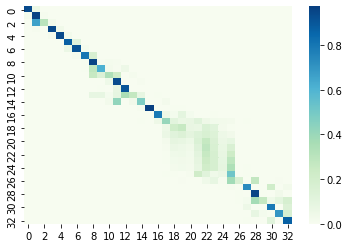

 56%|█████▌    | 16.73151750972757/30 [13:47<23:25, 105.90s/it] 

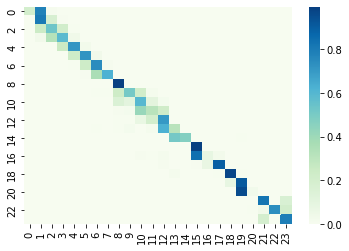

 56%|█████▌    | 16.735408560311228/30 [13:48<23:45, 107.43s/it]

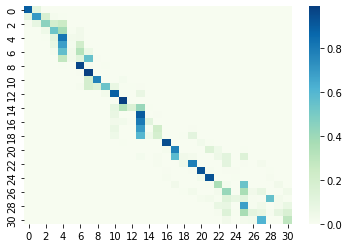

 56%|█████▌    | 16.739299610894886/30 [13:48<23:13, 105.07s/it]

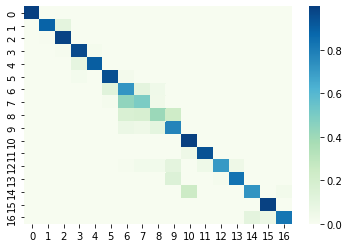

 56%|█████▌    | 16.743190661478543/30 [13:48<22:52, 103.50s/it]

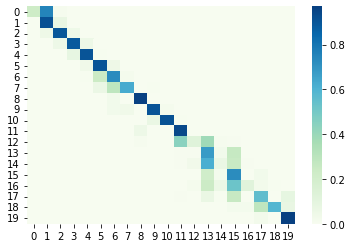

 56%|█████▌    | 16.7470817120622/30 [13:49<23:54, 108.22s/it]  

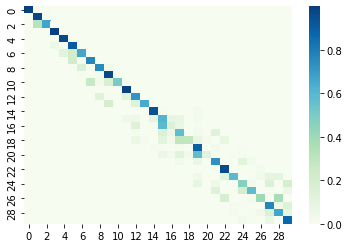

 56%|█████▌    | 16.75097276264586/30 [13:49<25:40, 116.28s/it]

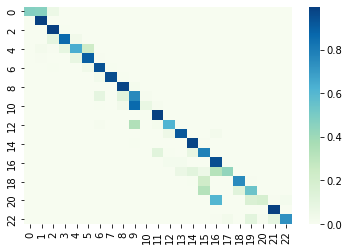

 56%|█████▌    | 16.754863813229516/30 [13:50<24:48, 112.40s/it]

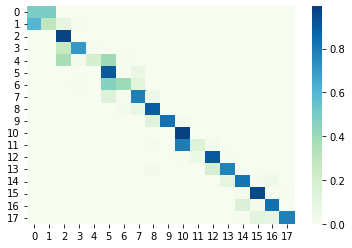

 56%|█████▌    | 16.758754863813174/30 [13:50<24:08, 109.40s/it]

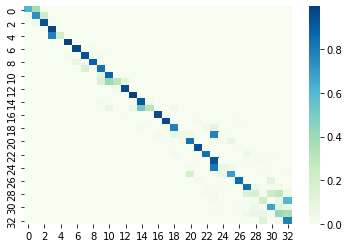

 56%|█████▌    | 16.76264591439683/30 [13:51<23:36, 107.04s/it] 

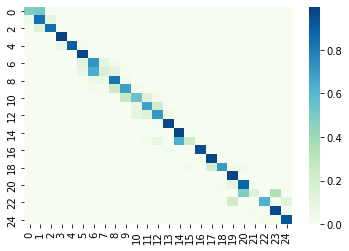

 56%|█████▌    | 16.76653696498049/30 [13:51<23:56, 108.58s/it]

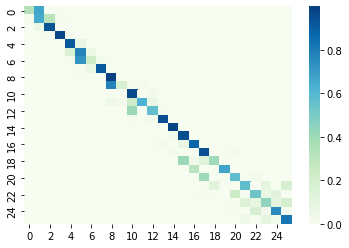

 56%|█████▌    | 16.770428015564146/30 [13:51<22:45, 103.23s/it]

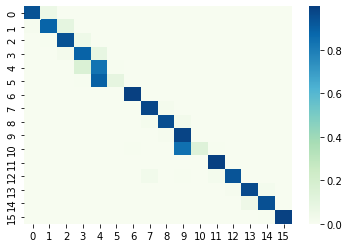

 56%|█████▌    | 16.774319066147804/30 [13:52<22:26, 101.79s/it]

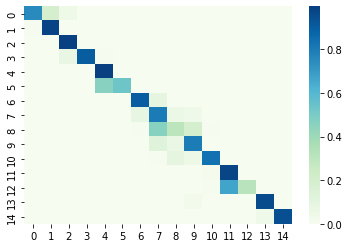

 56%|█████▌    | 16.77821011673146/30 [13:52<20:57, 95.09s/it]  

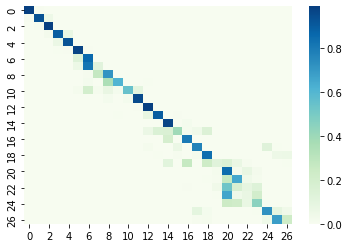

 56%|█████▌    | 16.78210116731512/30 [13:52<20:27, 92.86s/it]

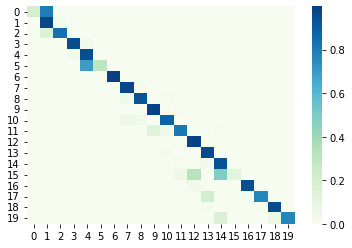

 56%|█████▌    | 16.785992217898777/30 [13:53<21:50, 99.21s/it]

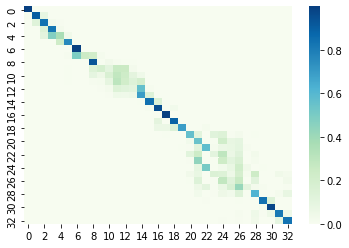

 56%|█████▌    | 16.789883268482434/30 [13:53<21:35, 98.07s/it]

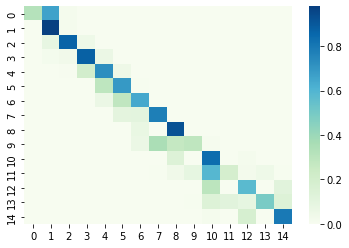

 56%|█████▌    | 16.79377431906609/30 [13:54<24:13, 110.09s/it]

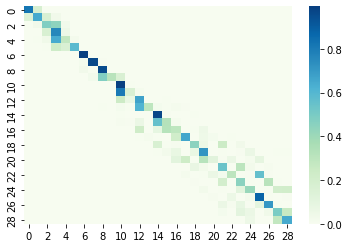

 56%|█████▌    | 16.79766536964975/30 [13:54<22:42, 103.18s/it]

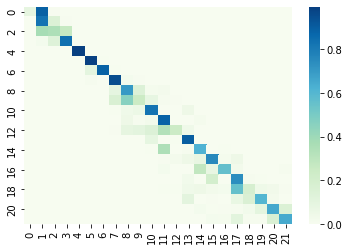

 56%|█████▌    | 16.801556420233407/30 [13:54<22:37, 102.85s/it]

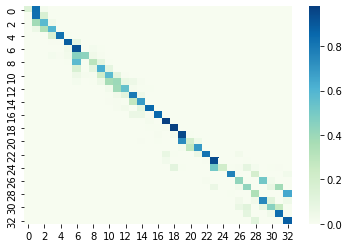

 56%|█████▌    | 16.805447470817064/30 [13:55<21:55, 99.69s/it] 

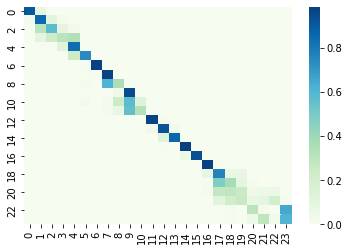

 56%|█████▌    | 16.809338521400722/30 [13:55<21:30, 97.83s/it]

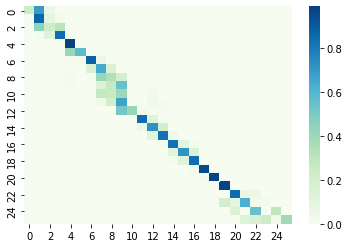

 56%|█████▌    | 16.81322957198438/30 [13:55<20:44, 94.36s/it] 

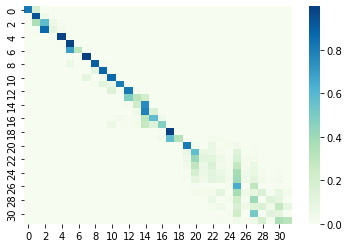

 56%|█████▌    | 16.817120622568037/30 [13:56<21:14, 96.67s/it]

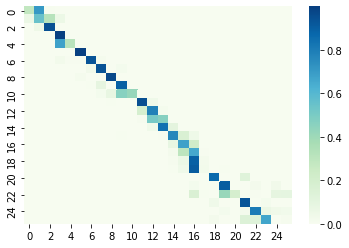

 56%|█████▌    | 16.821011673151695/30 [13:56<20:55, 95.23s/it]

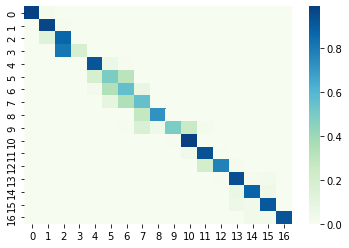

 56%|█████▌    | 16.824902723735352/30 [13:57<21:27, 97.69s/it]

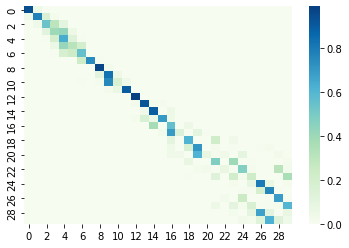

 56%|█████▌    | 16.82879377431901/30 [13:57<21:25, 97.64s/it] 

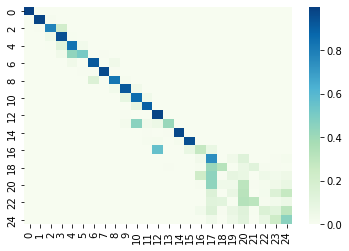

 56%|█████▌    | 16.832684824902667/30 [13:57<22:14, 101.31s/it]

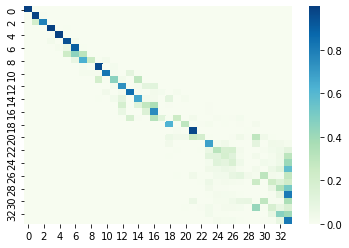

 56%|█████▌    | 16.836575875486325/30 [13:58<24:57, 113.73s/it]

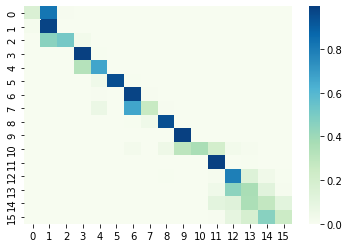

 56%|█████▌    | 16.840466926069983/30 [13:58<23:57, 109.24s/it]

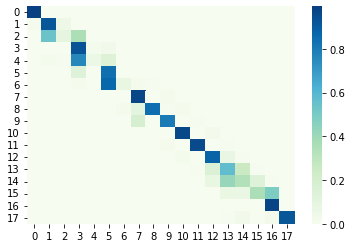

 56%|█████▌    | 16.84435797665364/30 [13:59<23:47, 108.51s/it] 

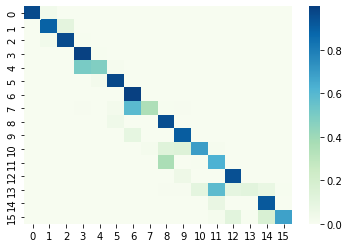

 56%|█████▌    | 16.848249027237298/30 [13:59<22:54, 104.55s/it]

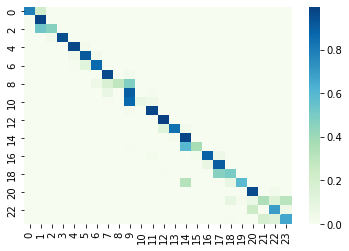

 56%|█████▌    | 16.852140077820955/30 [14:00<23:00, 104.99s/it]

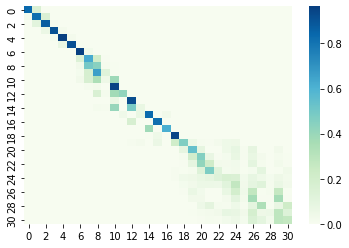

 56%|█████▌    | 16.856031128404613/30 [14:00<21:47, 99.47s/it] 

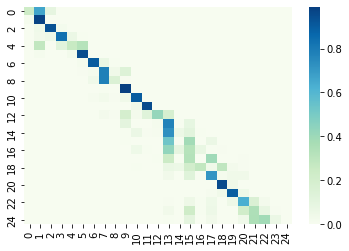

 56%|█████▌    | 16.85992217898827/30 [14:00<21:33, 98.45s/it] 

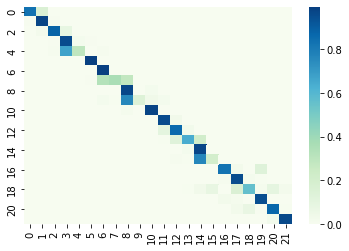

 56%|█████▌    | 16.863813229571928/30 [14:01<21:27, 98.02s/it]

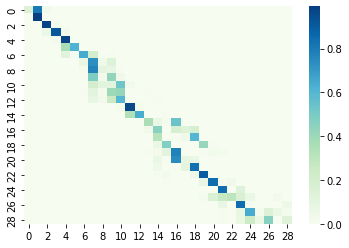

 56%|█████▌    | 16.867704280155586/30 [14:01<20:31, 93.80s/it]

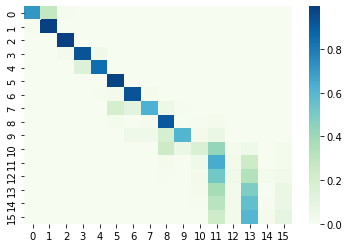

 56%|█████▌    | 16.871595330739243/30 [14:01<19:56, 91.17s/it]

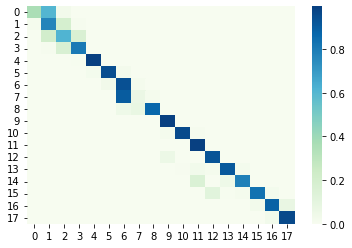

 56%|█████▋    | 16.8754863813229/30 [14:02<20:05, 91.83s/it]  

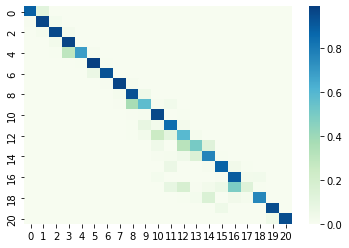

 56%|█████▋    | 16.87937743190656/30 [14:02<23:23, 106.98s/it]

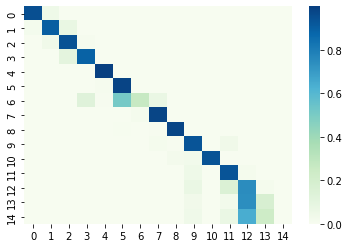

 56%|█████▋    | 16.883268482490216/30 [14:03<21:47, 99.71s/it]

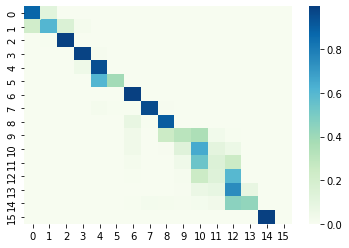

 56%|█████▋    | 16.887159533073874/30 [14:03<21:07, 96.63s/it]

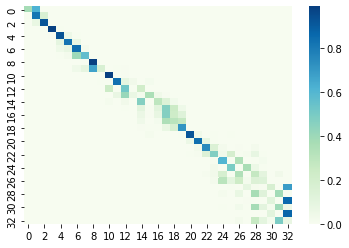

 56%|█████▋    | 16.89105058365753/30 [14:03<21:27, 98.19s/it] 

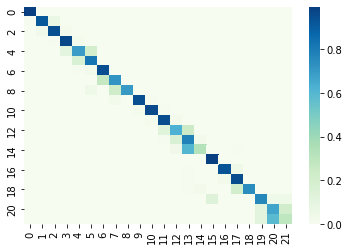

 56%|█████▋    | 16.89494163424119/30 [14:04<21:37, 99.01s/it]

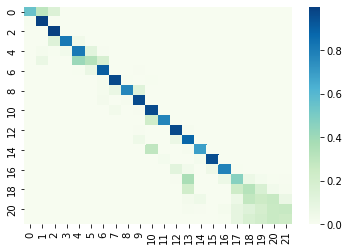

 56%|█████▋    | 16.898832684824846/30 [14:04<21:47, 99.78s/it]

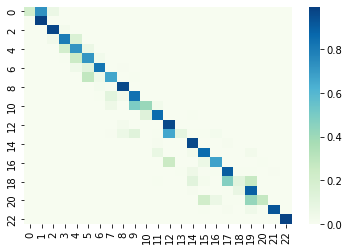

 56%|█████▋    | 16.902723735408504/30 [14:05<22:11, 101.69s/it]

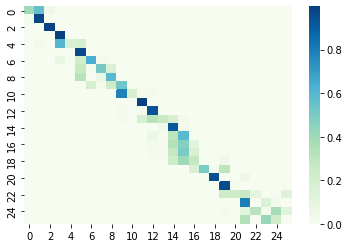

 56%|█████▋    | 16.90661478599216/30 [14:05<21:30, 98.57s/it]  

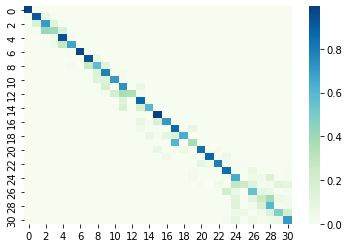

 56%|█████▋    | 16.91050583657582/30 [14:05<21:36, 99.05s/it]

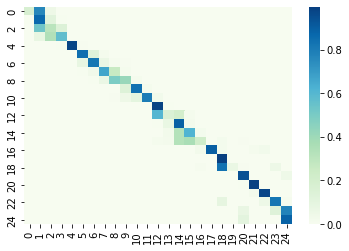

 56%|█████▋    | 16.914396887159477/30 [14:06<22:09, 101.61s/it]

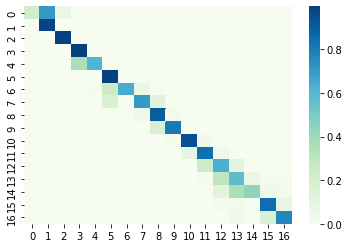

 56%|█████▋    | 16.918287937743134/30 [14:06<21:56, 100.67s/it]

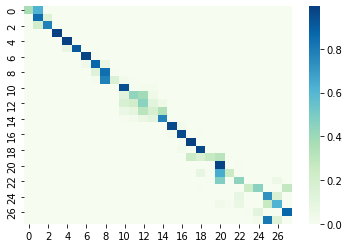

 56%|█████▋    | 16.92217898832679/30 [14:07<23:09, 106.22s/it] 

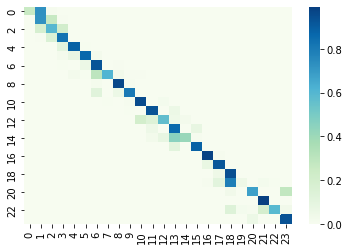

 56%|█████▋    | 16.92607003891045/30 [14:07<23:10, 106.33s/it]

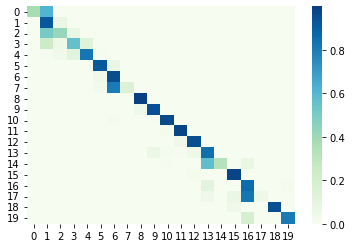

 56%|█████▋    | 16.929961089494107/30 [14:07<23:14, 106.66s/it]

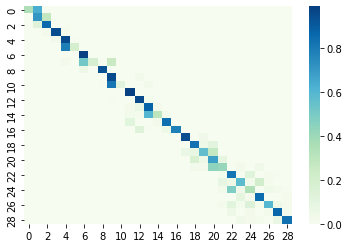

 56%|█████▋    | 16.933852140077764/30 [14:08<22:44, 104.46s/it]

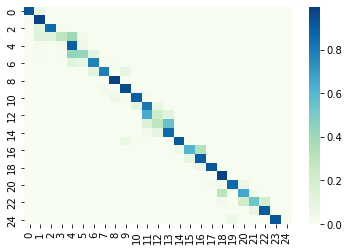

 56%|█████▋    | 16.937743190661422/30 [14:08<23:11, 106.51s/it]

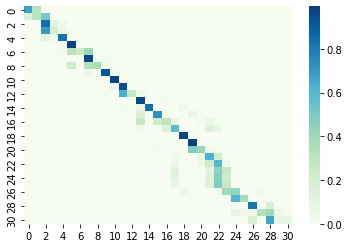

 56%|█████▋    | 16.94163424124508/30 [14:09<22:14, 102.16s/it] 

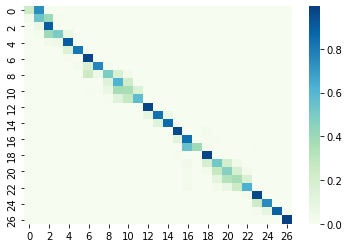

 56%|█████▋    | 16.945525291828737/30 [14:09<21:48, 100.26s/it]

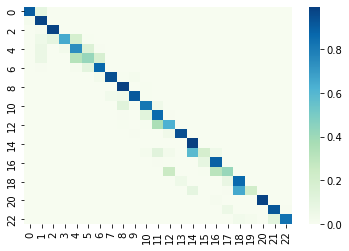

 56%|█████▋    | 16.949416342412395/30 [14:09<22:16, 102.41s/it]

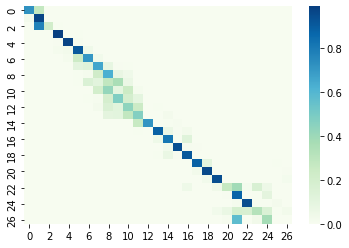

 57%|█████▋    | 16.953307392996052/30 [14:10<21:40, 99.68s/it] 

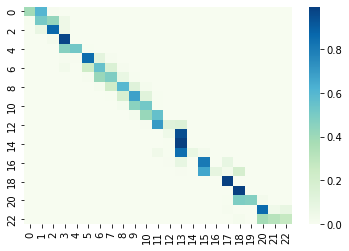

 57%|█████▋    | 16.95719844357971/30 [14:10<22:29, 103.44s/it]

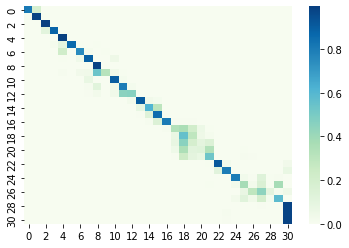

 57%|█████▋    | 16.961089494163367/30 [14:11<22:45, 104.72s/it]

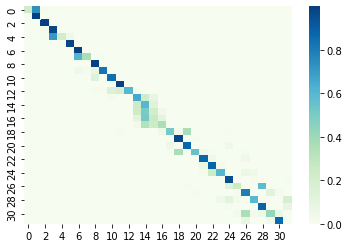

 57%|█████▋    | 16.964980544747025/30 [14:11<25:38, 118.00s/it]

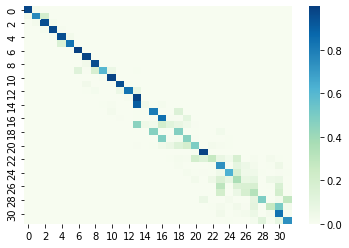

 57%|█████▋    | 16.968871595330683/30 [14:12<24:44, 113.92s/it]

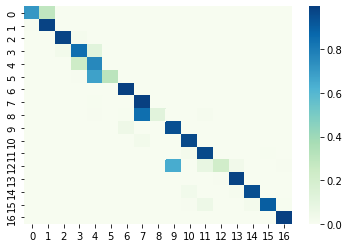

 57%|█████▋    | 16.97276264591434/30 [14:12<24:33, 113.11s/it] 

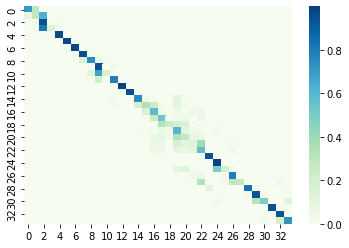

 57%|█████▋    | 16.976653696497998/30 [14:12<24:40, 113.71s/it]

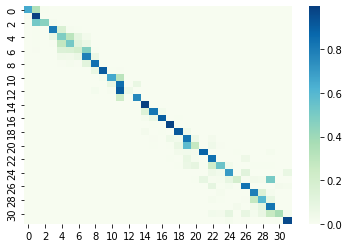

 57%|█████▋    | 16.980544747081655/30 [14:13<24:39, 113.61s/it]

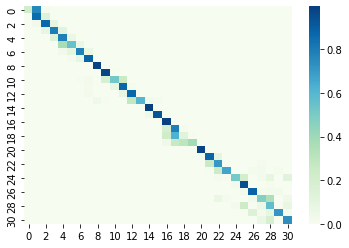

 57%|█████▋    | 16.984435797665313/30 [14:13<25:00, 115.31s/it]

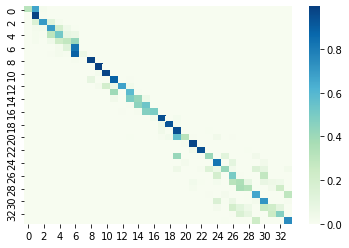

 57%|█████▋    | 16.98832684824897/30 [14:14<25:14, 116.38s/it] 

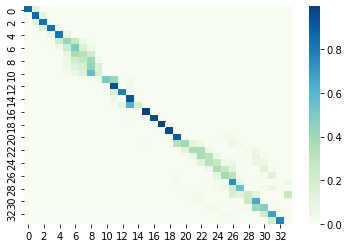

 57%|█████▋    | 16.992217898832628/30 [14:14<24:07, 111.25s/it]

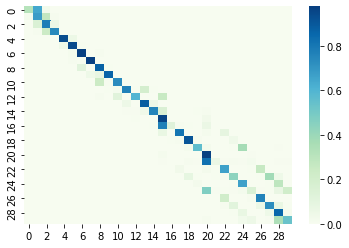

 57%|█████▋    | 16.996108949416286/30 [14:15<23:57, 110.56s/it]

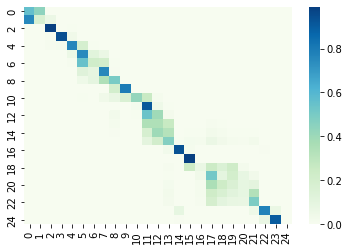

 57%|█████▋    | 16.999999999999943/30 [14:15<24:05, 111.17s/it]

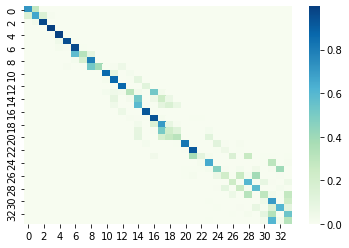

 59%|█████▊    | 17.610894941634182/30 [14:30<04:27, 21.61s/it]

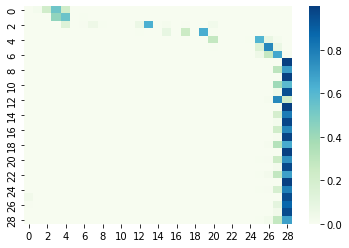

 59%|█████▊    | 17.618677042801497/30 [14:31<07:50, 38.01s/it]

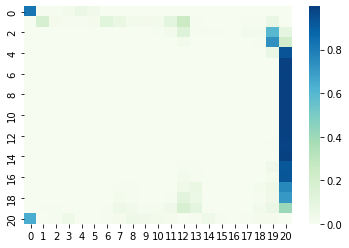

 59%|█████▊    | 17.622568093385155/30 [14:31<10:00, 48.54s/it]

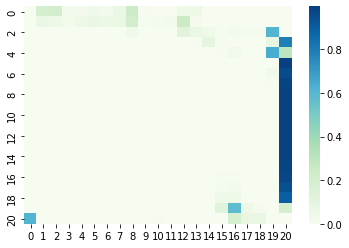

 59%|█████▉    | 17.626459143968813/30 [14:31<12:34, 60.99s/it]

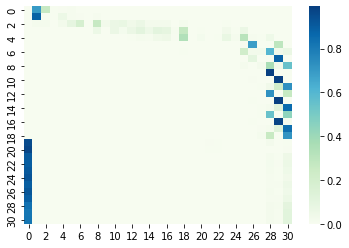

 59%|█████▉    | 17.63035019455247/30 [14:32<14:23, 69.82s/it] 

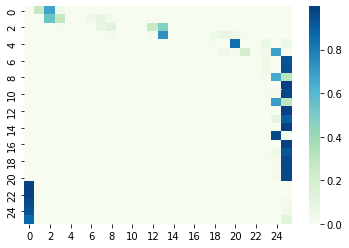

 59%|█████▉    | 17.634241245136128/30 [14:32<15:33, 75.51s/it]

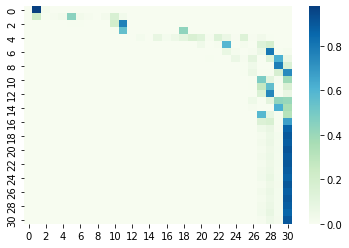

 59%|█████▉    | 17.638132295719785/30 [14:33<17:07, 83.13s/it]

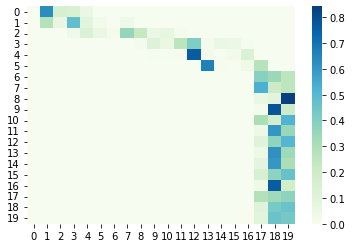

 59%|█████▉    | 17.642023346303443/30 [14:33<19:01, 92.40s/it]

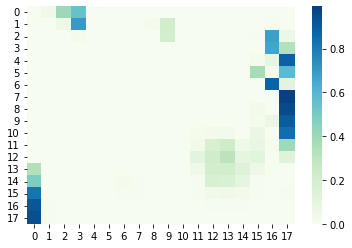

 59%|█████▉    | 17.6459143968871/30 [14:33<19:38, 95.40s/it]  

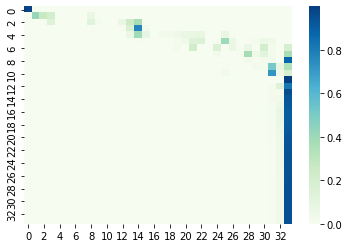

 59%|█████▉    | 17.649805447470758/30 [14:34<19:13, 93.40s/it]

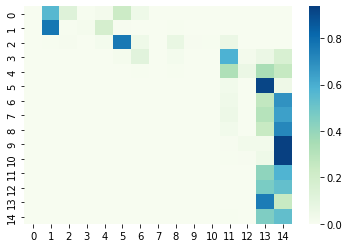

 59%|█████▉    | 17.653696498054416/30 [14:34<19:03, 92.65s/it]

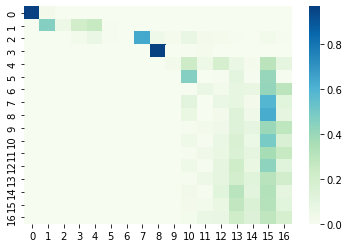

 59%|█████▉    | 17.657587548638073/30 [14:35<19:49, 96.40s/it]

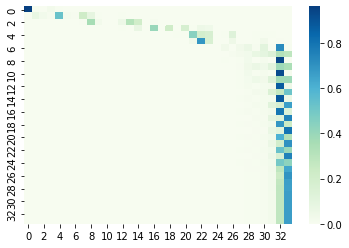

 59%|█████▉    | 17.66147859922173/30 [14:35<23:20, 113.49s/it]

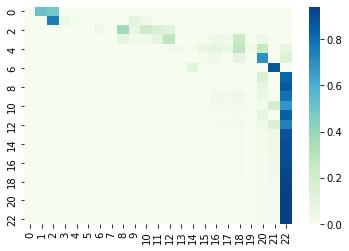

 59%|█████▉    | 17.66536964980539/30 [14:36<23:03, 112.18s/it]

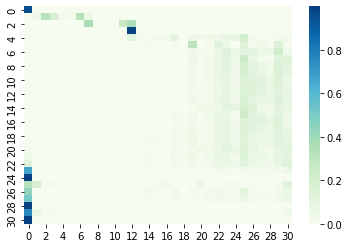

 59%|█████▉    | 17.669260700389046/30 [14:36<22:23, 108.99s/it]

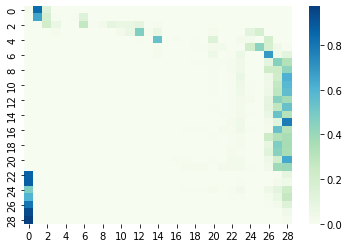

 59%|█████▉    | 17.673151750972703/30 [14:36<21:38, 105.34s/it]

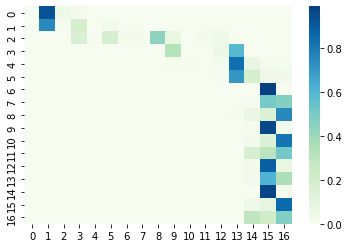

 59%|█████▉    | 17.67704280155636/30 [14:37<21:26, 104.43s/it] 

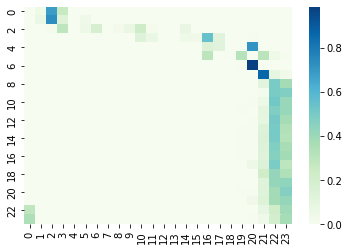

 59%|█████▉    | 17.68093385214002/30 [14:37<21:00, 102.30s/it]

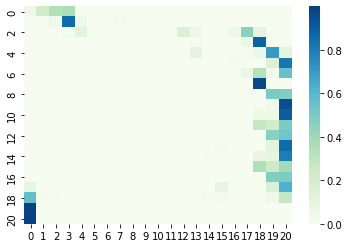

 59%|█████▉    | 17.684824902723676/30 [14:37<20:19, 99.06s/it]

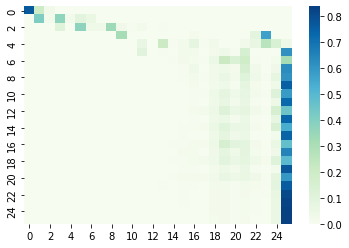

 59%|█████▉    | 17.688715953307334/30 [14:38<20:13, 98.57s/it]

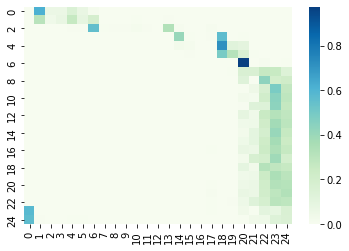

 59%|█████▉    | 17.69260700389099/30 [14:38<20:52, 101.76s/it]

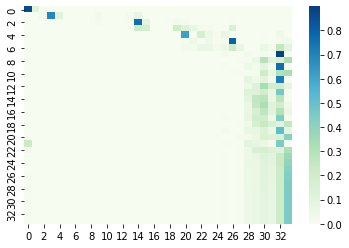

 59%|█████▉    | 17.69649805447465/30 [14:39<21:18, 103.94s/it]

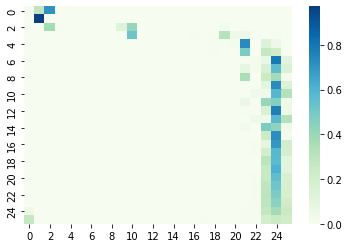

 59%|█████▉    | 17.700389105058306/30 [14:39<20:34, 100.34s/it]

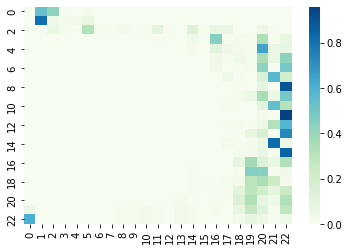

 59%|█████▉    | 17.704280155641964/30 [14:40<23:09, 113.00s/it]

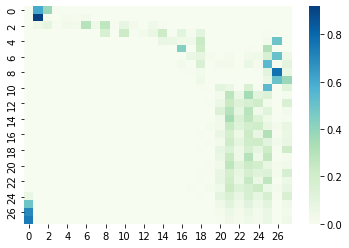

 59%|█████▉    | 17.70817120622562/30 [14:40<20:56, 102.21s/it] 

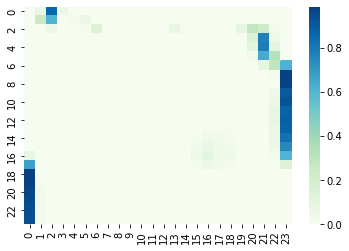

 59%|█████▉    | 17.71206225680928/30 [14:40<20:32, 100.28s/it]

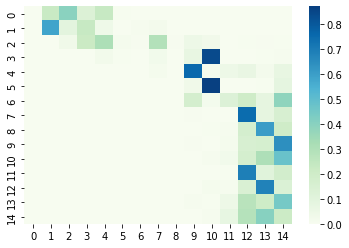

 59%|█████▉    | 17.715953307392937/30 [14:41<20:52, 101.94s/it]

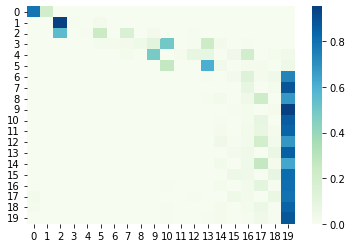

 59%|█████▉    | 17.719844357976594/30 [14:41<21:07, 103.19s/it]

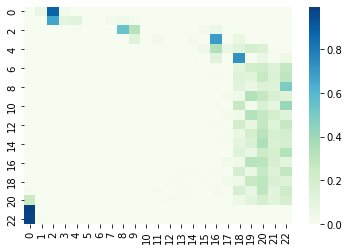

 59%|█████▉    | 17.723735408560252/30 [14:41<20:27, 100.02s/it]

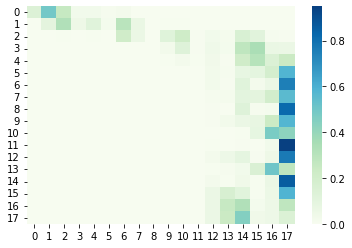

 59%|█████▉    | 17.72762645914391/30 [14:42<20:42, 101.27s/it] 

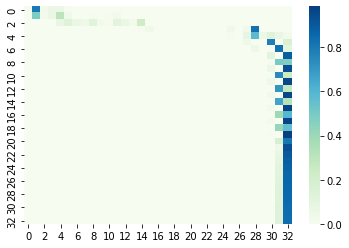

 59%|█████▉    | 17.731517509727567/30 [14:42<20:44, 101.46s/it]

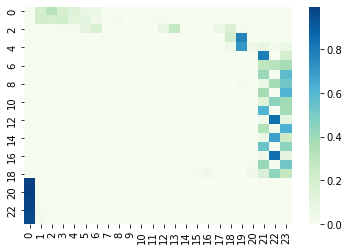

 59%|█████▉    | 17.735408560311225/30 [14:43<21:06, 103.28s/it]

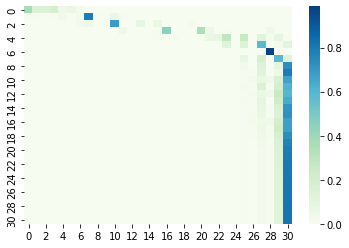

 59%|█████▉    | 17.739299610894882/30 [14:43<20:48, 101.83s/it]

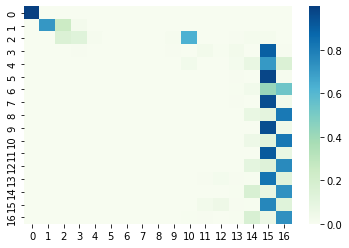

 59%|█████▉    | 17.74319066147854/30 [14:43<20:13, 99.01s/it]  

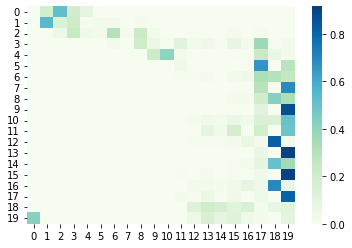

 59%|█████▉    | 17.747081712062197/30 [14:44<22:59, 112.59s/it]

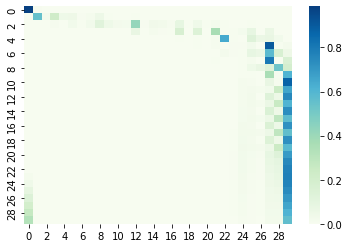

 59%|█████▉    | 17.750972762645855/30 [14:44<21:56, 107.50s/it]

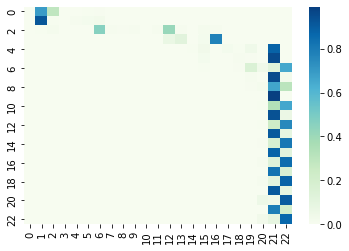

 59%|█████▉    | 17.754863813229512/30 [14:45<21:40, 106.19s/it]

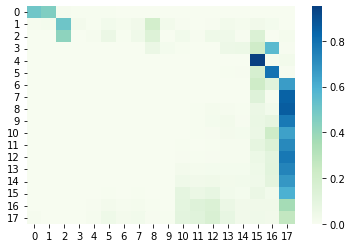

 59%|█████▉    | 17.75875486381317/30 [14:45<21:47, 106.82s/it] 

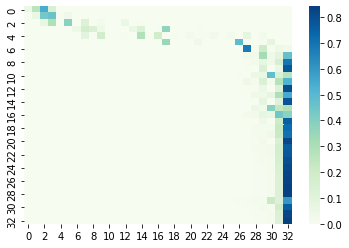

 59%|█████▉    | 17.762645914396828/30 [14:46<21:20, 104.66s/it]

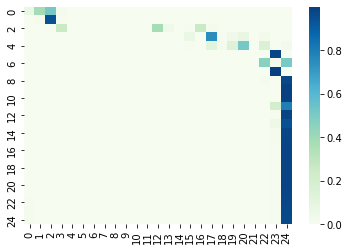

 59%|█████▉    | 17.766536964980485/30 [14:46<21:01, 103.14s/it]

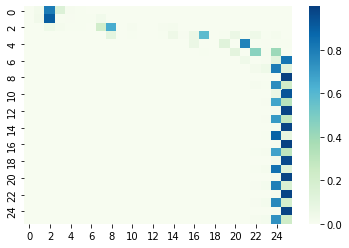

 59%|█████▉    | 17.770428015564143/30 [14:46<19:54, 97.71s/it] 

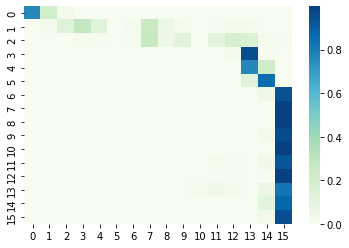

 59%|█████▉    | 17.7743190661478/30 [14:47<19:54, 97.73s/it]  

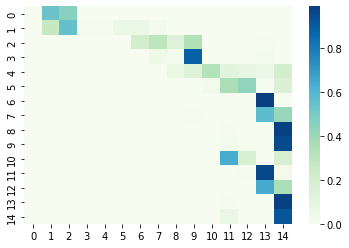

 59%|█████▉    | 17.778210116731458/30 [14:47<20:16, 99.52s/it]

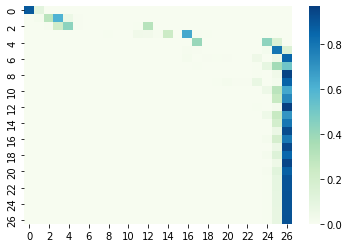

 59%|█████▉    | 17.782101167315115/30 [14:47<20:16, 99.59s/it]

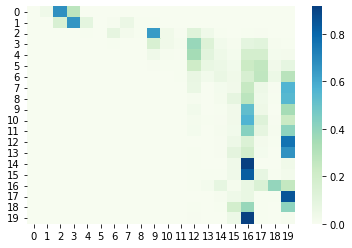

 59%|█████▉    | 17.785992217898773/30 [14:48<21:05, 103.61s/it]

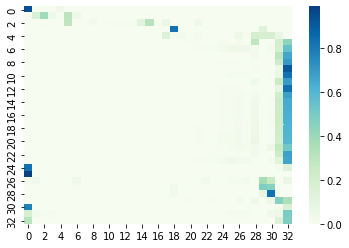

 59%|█████▉    | 17.78988326848243/30 [14:48<22:50, 112.27s/it] 

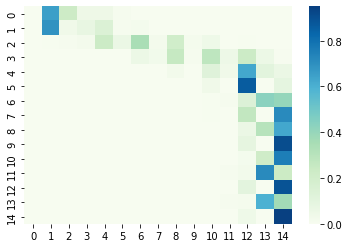

 59%|█████▉    | 17.793774319066088/30 [14:49<21:30, 105.70s/it]

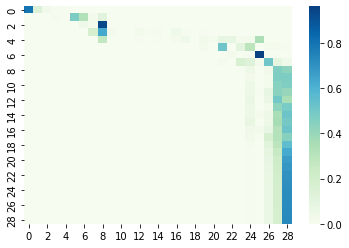

 59%|█████▉    | 17.797665369649746/30 [14:49<20:33, 101.05s/it]

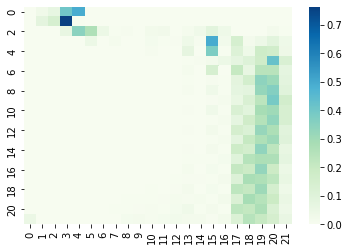

 59%|█████▉    | 17.801556420233403/30 [14:50<21:10, 104.16s/it]

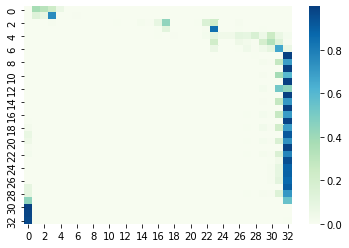

 59%|█████▉    | 17.80544747081706/30 [14:50<20:55, 102.92s/it] 

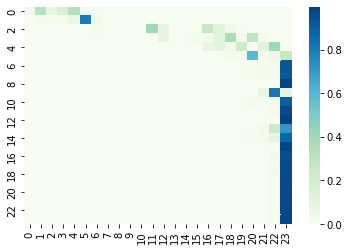

 59%|█████▉    | 17.80933852140072/30 [14:50<20:27, 100.69s/it]

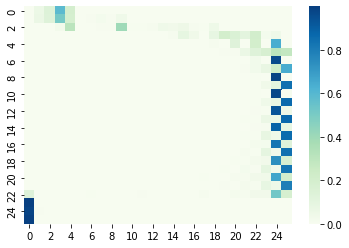

 59%|█████▉    | 17.813229571984376/30 [14:51<19:30, 96.01s/it]

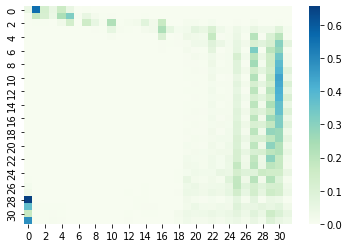

 59%|█████▉    | 17.817120622568034/30 [14:51<19:12, 94.57s/it]

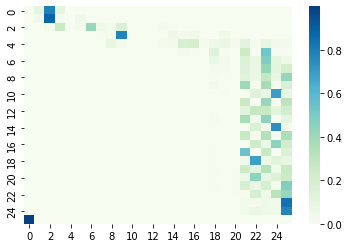

 59%|█████▉    | 17.82101167315169/30 [14:51<18:32, 91.31s/it] 

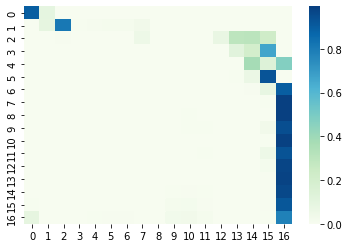

 59%|█████▉    | 17.82490272373535/30 [14:52<19:04, 94.02s/it]

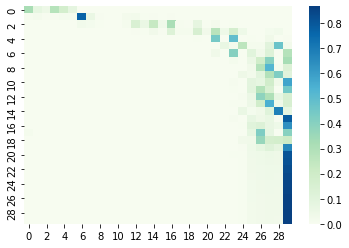

 59%|█████▉    | 17.828793774319006/30 [14:52<19:33, 96.44s/it]

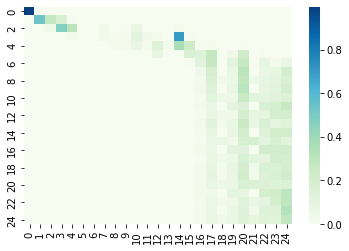

 59%|█████▉    | 17.832684824902664/30 [14:53<23:04, 113.80s/it]

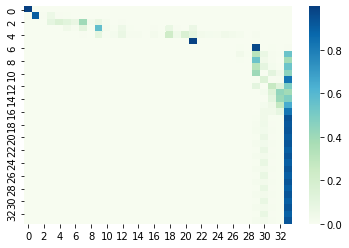

 59%|█████▉    | 17.83657587548632/30 [14:53<22:07, 109.14s/it] 

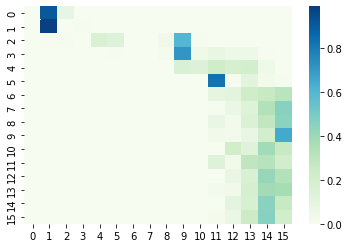

 59%|█████▉    | 17.84046692606998/30 [14:53<21:09, 104.44s/it]

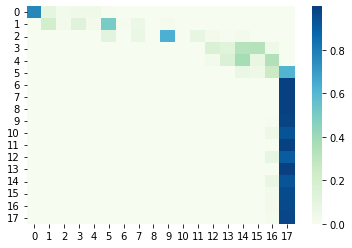

 59%|█████▉    | 17.844357976653637/30 [14:54<20:44, 102.39s/it]

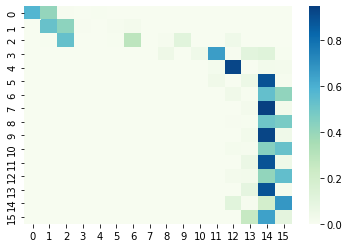

 59%|█████▉    | 17.848249027237294/30 [14:54<20:28, 101.11s/it]

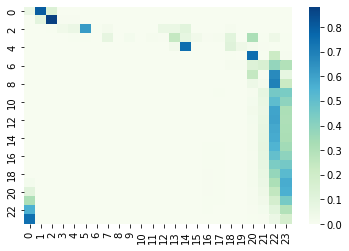

 60%|█████▉    | 17.852140077820952/30 [14:55<20:46, 102.63s/it]

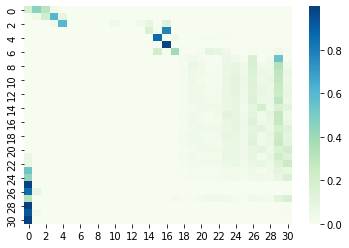

 60%|█████▉    | 17.85603112840461/30 [14:55<20:28, 101.15s/it] 

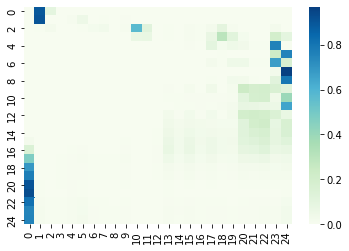

 60%|█████▉    | 17.859922178988267/30 [14:55<20:15, 100.15s/it]

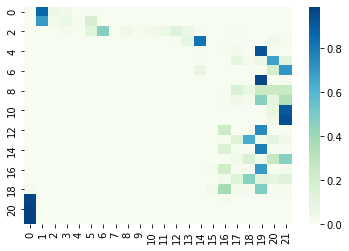

 60%|█████▉    | 17.863813229571925/30 [14:56<20:40, 102.23s/it]

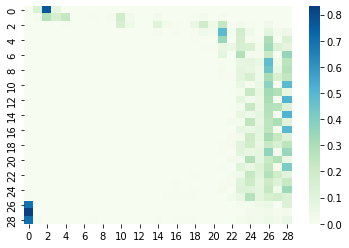

 60%|█████▉    | 17.867704280155582/30 [14:56<20:25, 101.02s/it]

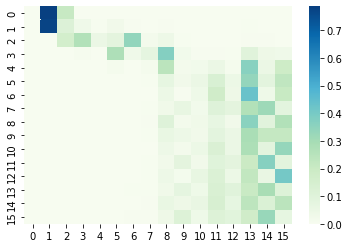

 60%|█████▉    | 17.87159533073924/30 [14:57<20:33, 101.71s/it] 

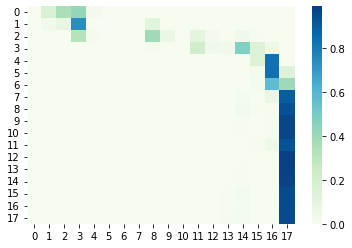

 60%|█████▉    | 17.875486381322897/30 [14:57<23:17, 115.23s/it]

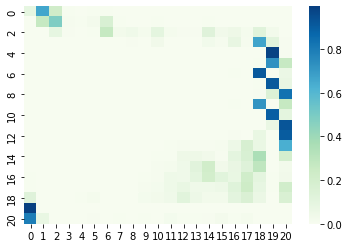

 60%|█████▉    | 17.879377431906555/30 [14:58<22:07, 109.53s/it]

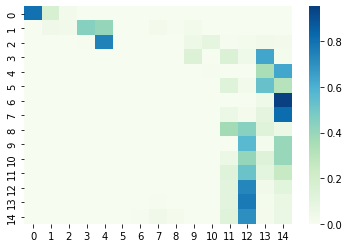

 60%|█████▉    | 17.883268482490212/30 [14:58<20:35, 102.01s/it]

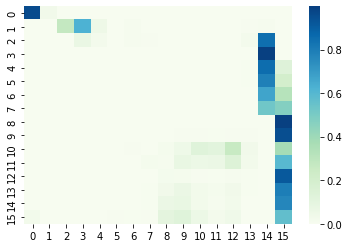

 60%|█████▉    | 17.88715953307387/30 [14:58<20:14, 100.23s/it] 

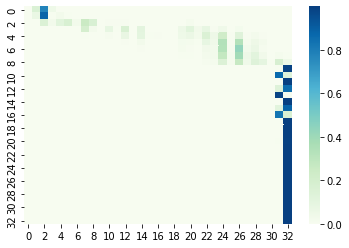

 60%|█████▉    | 17.891050583657528/30 [14:59<20:07, 99.68s/it]

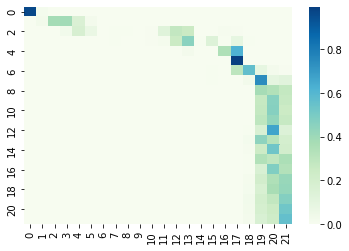

 60%|█████▉    | 17.894941634241185/30 [14:59<20:11, 100.09s/it]

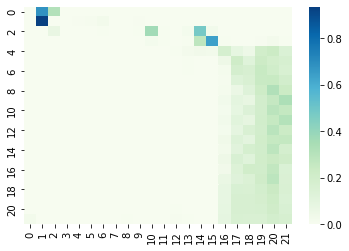

 60%|█████▉    | 17.898832684824843/30 [14:59<20:36, 102.19s/it]

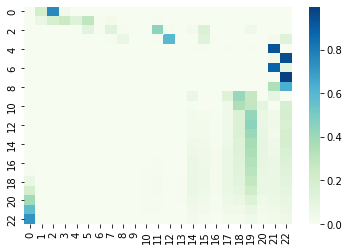

 60%|█████▉    | 17.9027237354085/30 [15:00<20:38, 102.35s/it]  

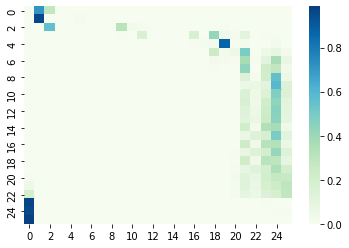

 60%|█████▉    | 17.906614785992158/30 [15:00<19:21, 96.02s/it]

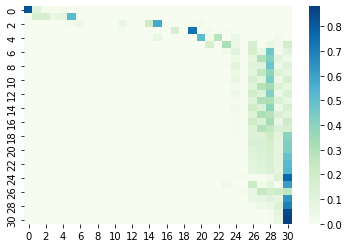

 60%|█████▉    | 17.910505836575815/30 [15:01<20:00, 99.33s/it]

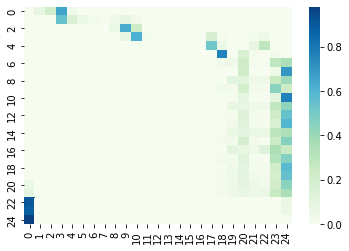

 60%|█████▉    | 17.914396887159473/30 [15:01<20:10, 100.19s/it]

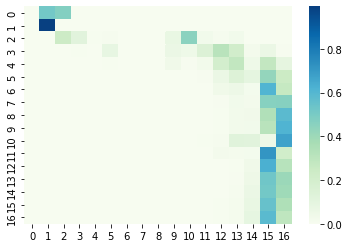

 60%|█████▉    | 17.91828793774313/30 [15:02<22:51, 113.49s/it] 

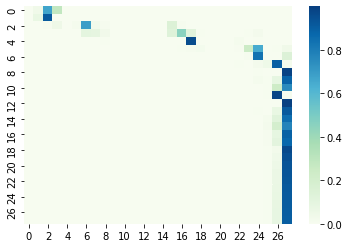

 60%|█████▉    | 17.922178988326788/30 [15:02<21:55, 108.92s/it]

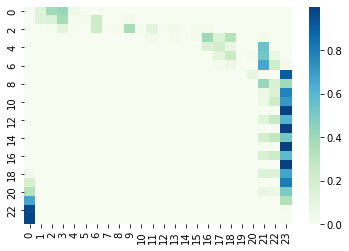

 60%|█████▉    | 17.926070038910446/30 [15:02<20:54, 103.89s/it]

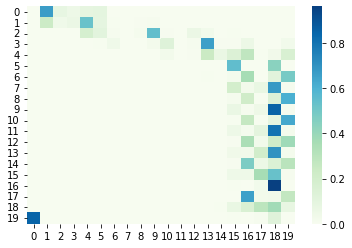

 60%|█████▉    | 17.929961089494103/30 [15:03<20:48, 103.44s/it]

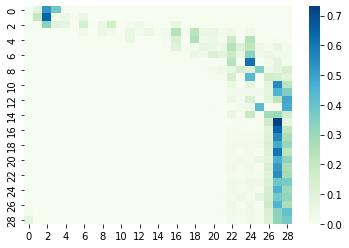

 60%|█████▉    | 17.93385214007776/30 [15:03<19:39, 97.78s/it]  

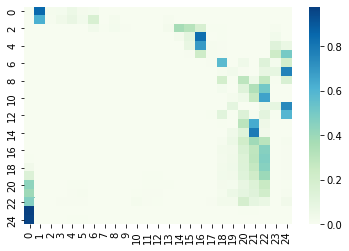

 60%|█████▉    | 17.93774319066142/30 [15:03<20:21, 101.30s/it]

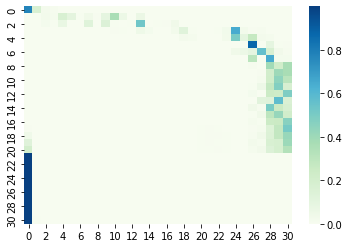

 60%|█████▉    | 17.941634241245076/30 [15:04<20:27, 101.79s/it]

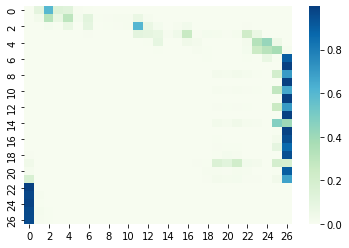

 60%|█████▉    | 17.945525291828734/30 [15:04<19:53, 99.01s/it] 

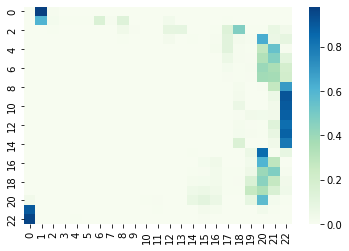

 60%|█████▉    | 17.94941634241239/30 [15:05<20:35, 102.51s/it]

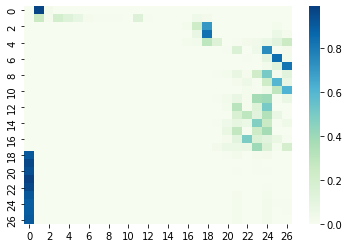

 60%|█████▉    | 17.95330739299605/30 [15:05<20:07, 100.23s/it]

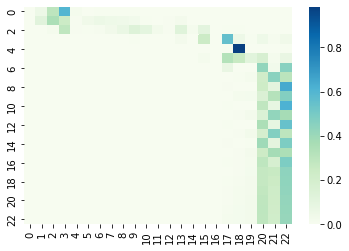

 60%|█████▉    | 17.957198443579706/30 [15:05<19:33, 97.43s/it]

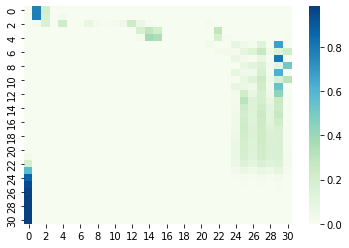

 60%|█████▉    | 17.961089494163364/30 [15:06<22:17, 111.07s/it]

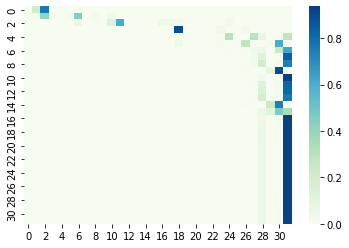

 60%|█████▉    | 17.96498054474702/30 [15:06<20:50, 103.89s/it] 

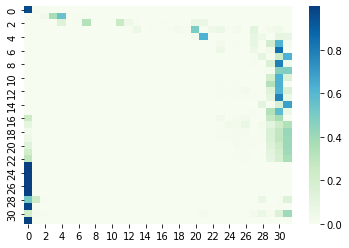

 60%|█████▉    | 17.96887159533068/30 [15:07<20:24, 101.76s/it]

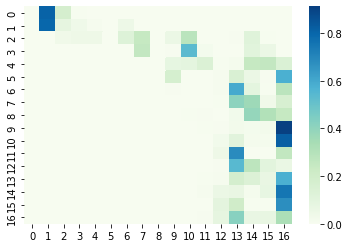

 60%|█████▉    | 17.972762645914337/30 [15:07<20:14, 101.01s/it]

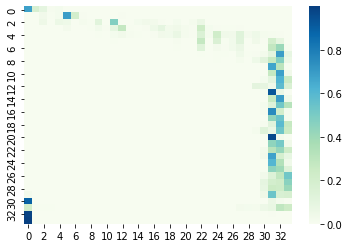

 60%|█████▉    | 17.976653696497994/30 [15:07<20:23, 101.72s/it]

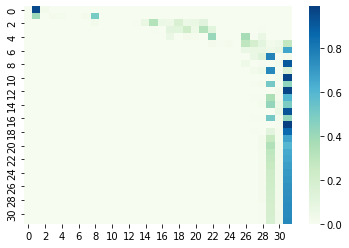

 60%|█████▉    | 17.98054474708165/30 [15:08<19:52, 99.23s/it]  

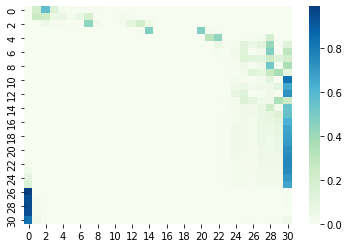

 60%|█████▉    | 17.98443579766531/30 [15:08<19:35, 97.83s/it]

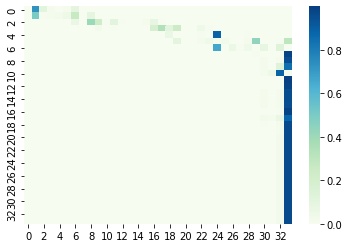

 60%|█████▉    | 17.988326848248967/30 [15:09<19:35, 97.82s/it]

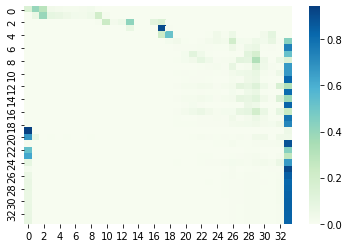

 60%|█████▉    | 17.992217898832624/30 [15:09<19:51, 99.25s/it]

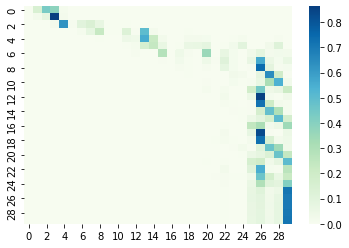

 60%|█████▉    | 17.996108949416282/30 [15:09<19:56, 99.72s/it]

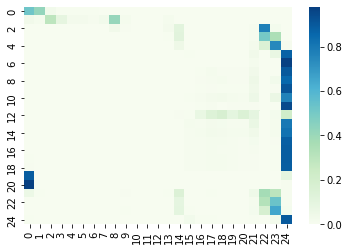

 60%|█████▉    | 17.99999999999994/30 [15:10<20:39, 103.28s/it]

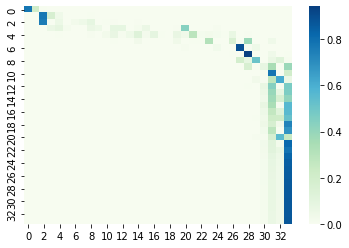

 62%|██████▏   | 18.61089494163418/30 [15:26<04:09, 21.95s/it] 

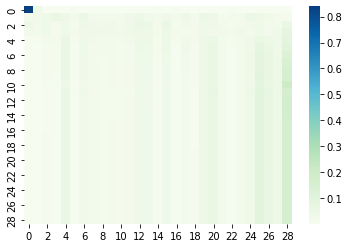

 62%|██████▏   | 18.618677042801494/30 [15:26<07:36, 40.11s/it]

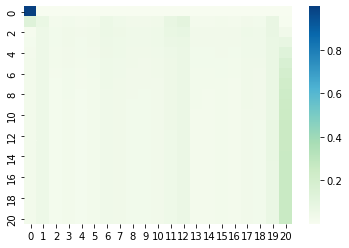

 62%|██████▏   | 18.62256809338515/30 [15:27<09:41, 51.14s/it] 

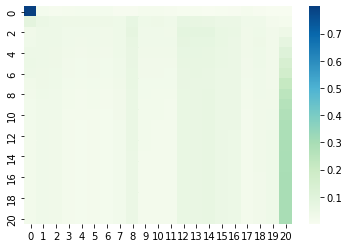

 62%|██████▏   | 18.62645914396881/30 [15:27<11:46, 62.08s/it]

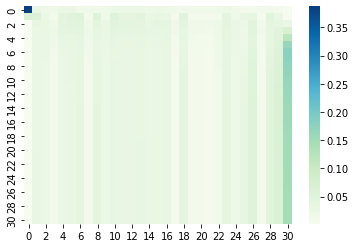

 62%|██████▏   | 18.630350194552467/30 [15:28<13:49, 72.92s/it]

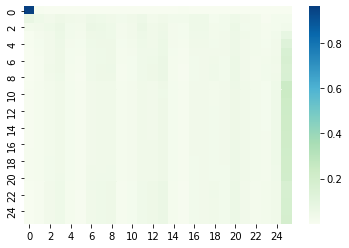

 62%|██████▏   | 18.634241245136124/30 [15:28<14:32, 76.79s/it]

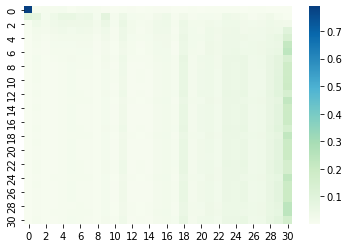

 62%|██████▏   | 18.63813229571978/30 [15:28<15:21, 81.09s/it] 

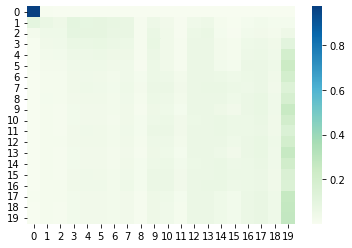

 62%|██████▏   | 18.64202334630344/30 [15:29<16:54, 89.31s/it]

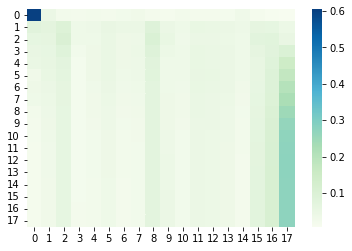

 62%|██████▏   | 18.645914396887097/30 [15:29<18:00, 95.18s/it]

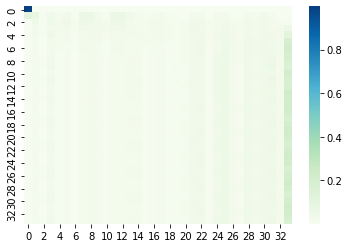

 62%|██████▏   | 18.649805447470754/30 [15:30<18:28, 97.68s/it]

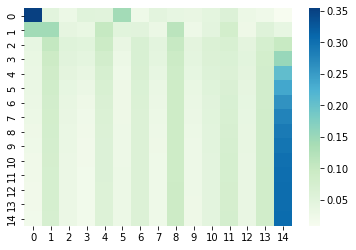

 62%|██████▏   | 18.653696498054412/30 [15:30<17:53, 94.59s/it]

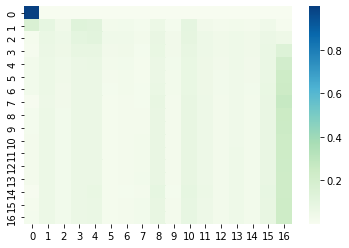

 62%|██████▏   | 18.65758754863807/30 [15:31<20:57, 110.84s/it]

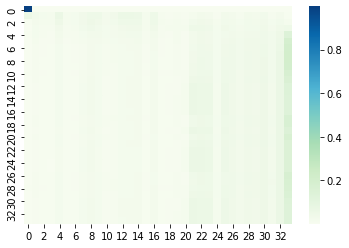

 62%|██████▏   | 18.661478599221727/30 [15:31<19:52, 105.17s/it]

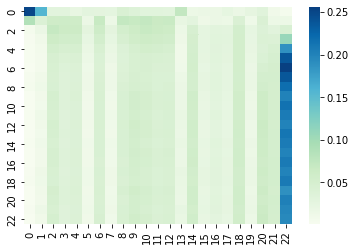

 62%|██████▏   | 18.665369649805385/30 [15:31<19:47, 104.74s/it]

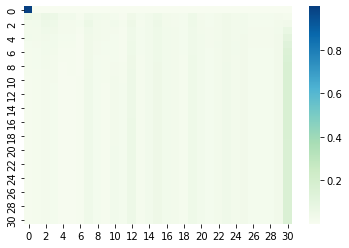

 62%|██████▏   | 18.669260700389042/30 [15:32<19:01, 100.70s/it]

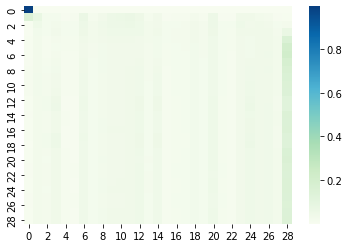

 62%|██████▏   | 18.6731517509727/30 [15:32<18:08, 96.08s/it]   

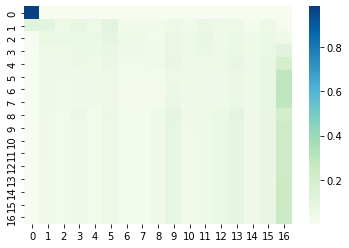

 62%|██████▏   | 18.677042801556357/30 [15:32<17:31, 92.90s/it]

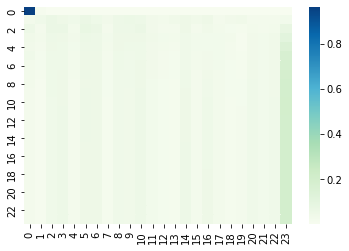

 62%|██████▏   | 18.680933852140015/30 [15:33<17:49, 94.47s/it]

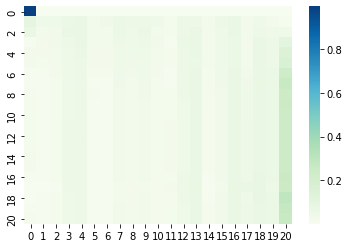

 62%|██████▏   | 18.684824902723673/30 [15:33<17:28, 92.63s/it]

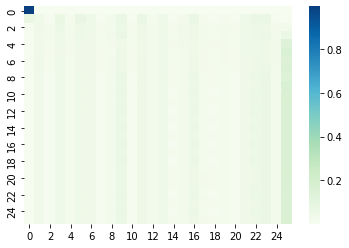

 62%|██████▏   | 18.68871595330733/30 [15:33<16:40, 88.42s/it] 

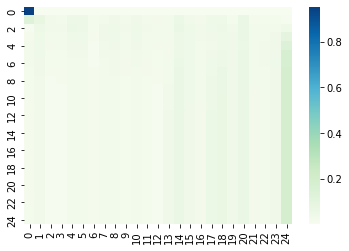

 62%|██████▏   | 18.692607003890988/30 [15:34<17:53, 94.97s/it]

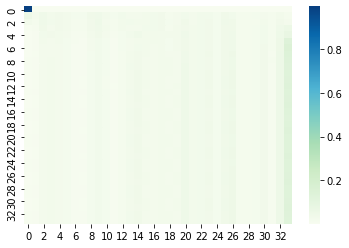

 62%|██████▏   | 18.696498054474645/30 [15:34<18:21, 97.47s/it]

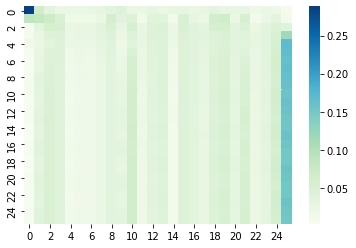

 62%|██████▏   | 18.700389105058303/30 [15:35<20:13, 107.38s/it]

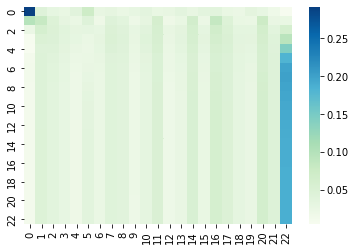

 62%|██████▏   | 18.70428015564196/30 [15:35<20:18, 107.83s/it] 

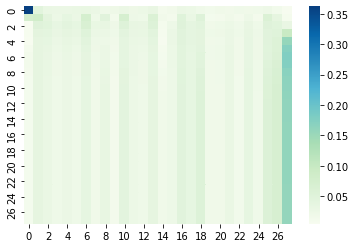

 62%|██████▏   | 18.708171206225618/30 [15:35<19:44, 104.86s/it]

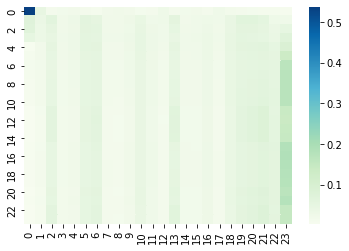

 62%|██████▏   | 18.712062256809276/30 [15:36<19:00, 101.05s/it]

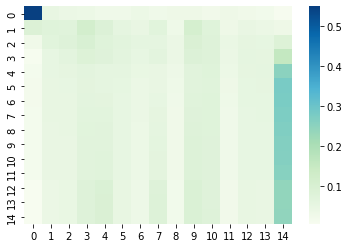

 62%|██████▏   | 18.715953307392933/30 [15:36<18:47, 99.88s/it] 

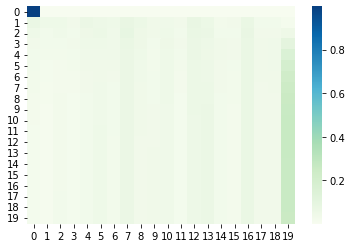

 62%|██████▏   | 18.71984435797659/30 [15:37<18:55, 100.66s/it]

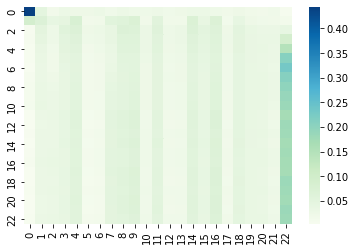

 62%|██████▏   | 18.72373540856025/30 [15:37<18:48, 100.04s/it]

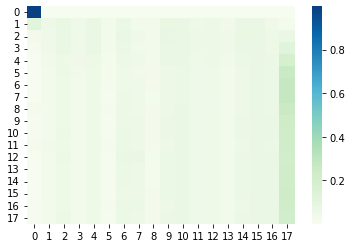

 62%|██████▏   | 18.727626459143906/30 [15:37<19:18, 102.80s/it]

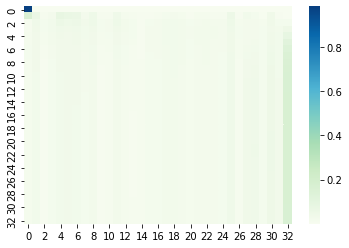

 62%|██████▏   | 18.731517509727563/30 [15:38<18:49, 100.20s/it]

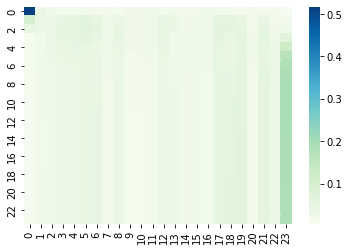

 62%|██████▏   | 18.73540856031122/30 [15:38<19:00, 101.22s/it] 

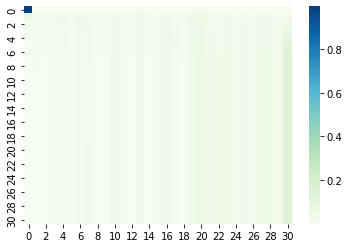

 62%|██████▏   | 18.73929961089488/30 [15:39<18:49, 100.27s/it]

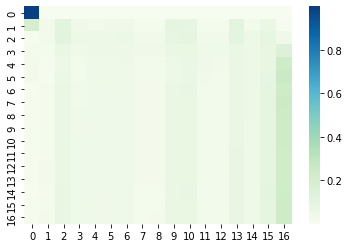

 62%|██████▏   | 18.743190661478536/30 [15:39<20:43, 110.46s/it]

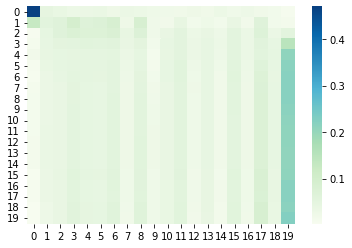

 62%|██████▏   | 18.747081712062194/30 [15:40<20:42, 110.44s/it]

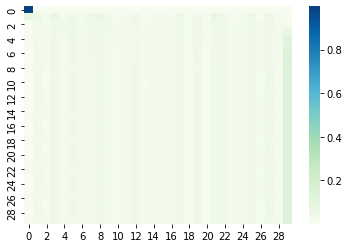

 63%|██████▎   | 18.75097276264585/30 [15:40<19:08, 102.07s/it] 

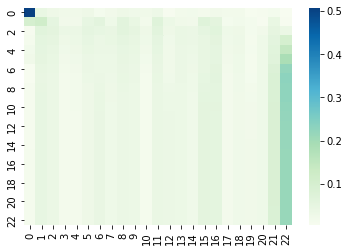

 63%|██████▎   | 18.75486381322951/30 [15:40<19:11, 102.37s/it]

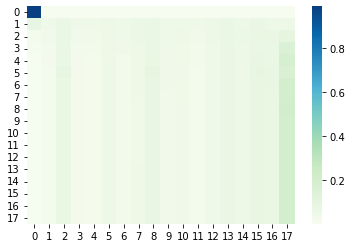

 63%|██████▎   | 18.758754863813166/30 [15:41<19:20, 103.26s/it]

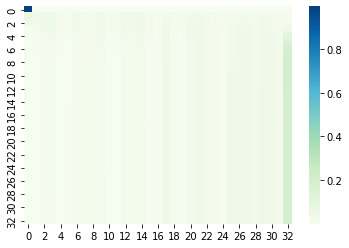

 63%|██████▎   | 18.762645914396824/30 [15:41<19:11, 102.44s/it]

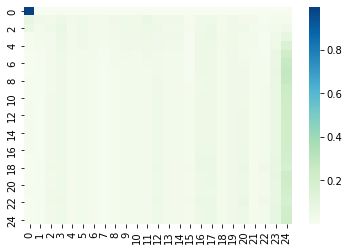

 63%|██████▎   | 18.76653696498048/30 [15:41<19:14, 102.81s/it] 

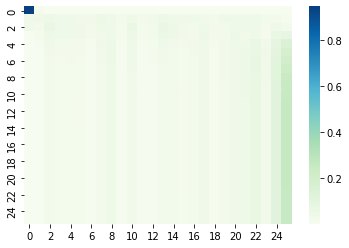

 63%|██████▎   | 18.77042801556414/30 [15:42<18:20, 98.02s/it] 

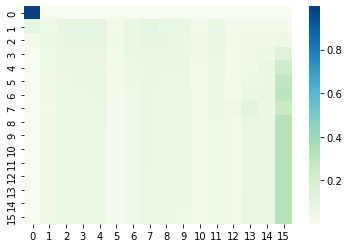

 63%|██████▎   | 18.774319066147797/30 [15:42<17:58, 96.11s/it]

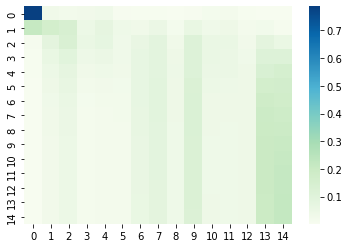

 63%|██████▎   | 18.778210116731454/30 [15:43<18:05, 96.69s/it]

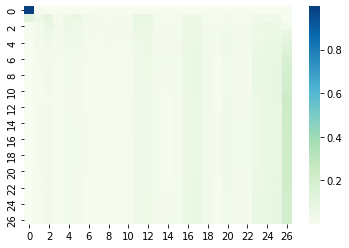

 63%|██████▎   | 18.782101167315112/30 [15:43<17:11, 91.91s/it]

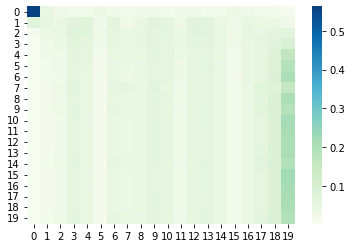

 63%|██████▎   | 18.78599221789877/30 [15:43<20:52, 111.65s/it]

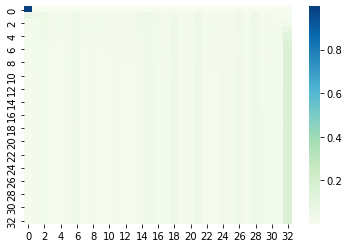

 63%|██████▎   | 18.789883268482427/30 [15:44<19:45, 105.75s/it]

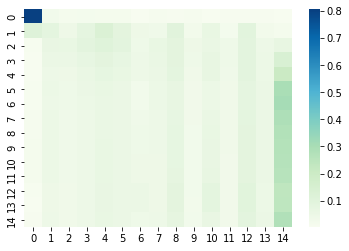

 63%|██████▎   | 18.793774319066085/30 [15:44<19:23, 103.83s/it]

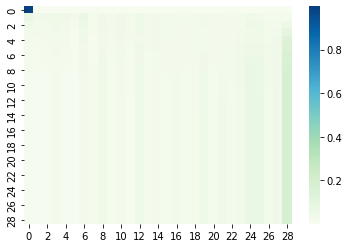

 63%|██████▎   | 18.797665369649742/30 [15:45<18:58, 101.59s/it]

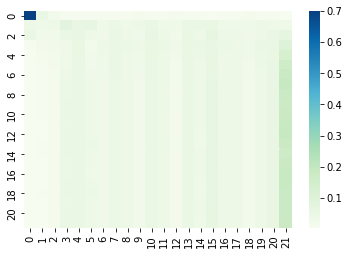

 63%|██████▎   | 18.8015564202334/30 [15:45<19:16, 103.32s/it]  

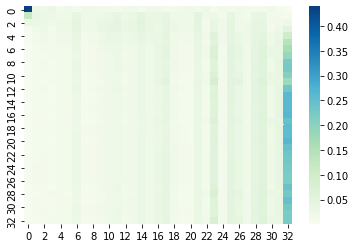

 63%|██████▎   | 18.805447470817057/30 [15:45<18:46, 100.61s/it]

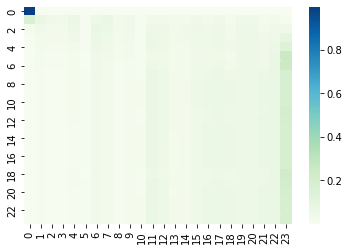

 63%|██████▎   | 18.809338521400715/30 [15:46<19:01, 102.02s/it]

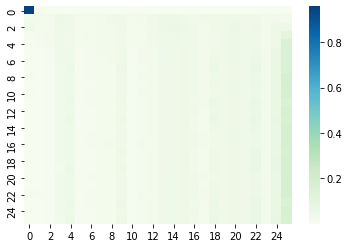

 63%|██████▎   | 18.813229571984373/30 [15:46<18:33, 99.58s/it] 

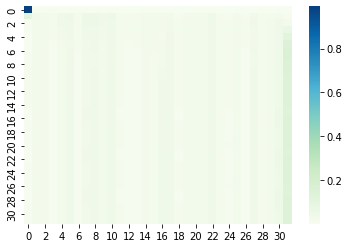

 63%|██████▎   | 18.81712062256803/30 [15:46<18:00, 96.62s/it] 

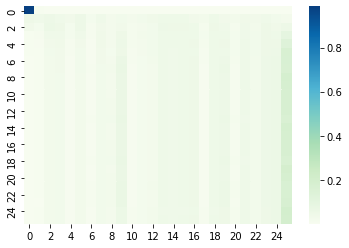

 63%|██████▎   | 18.821011673151688/30 [15:47<17:38, 94.67s/it]

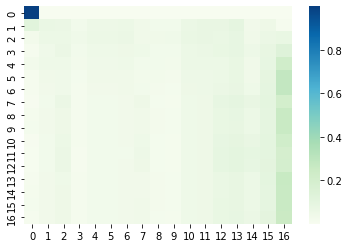

 63%|██████▎   | 18.824902723735345/30 [15:47<17:59, 96.62s/it]

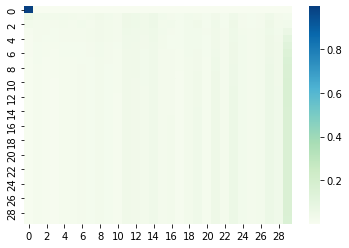

 63%|██████▎   | 18.828793774319003/30 [15:48<20:10, 108.32s/it]

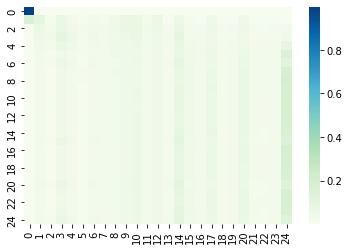

 63%|██████▎   | 18.83268482490266/30 [15:48<20:25, 109.73s/it] 

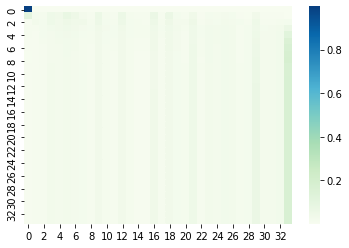

 63%|██████▎   | 18.836575875486318/30 [15:49<20:12, 108.60s/it]

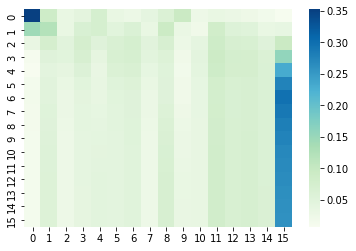

 63%|██████▎   | 18.840466926069976/30 [15:49<19:00, 102.20s/it]

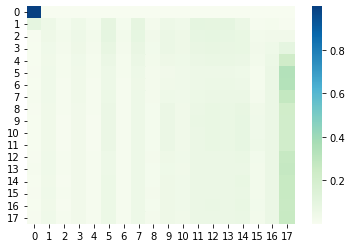

 63%|██████▎   | 18.844357976653633/30 [15:49<18:47, 101.07s/it]

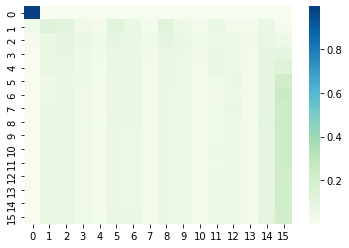

 63%|██████▎   | 18.84824902723729/30 [15:50<18:37, 100.21s/it] 

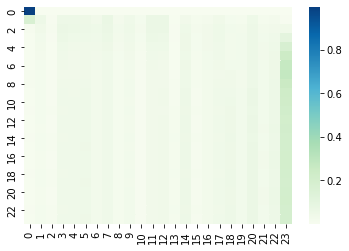

 63%|██████▎   | 18.85214007782095/30 [15:50<18:35, 100.09s/it]

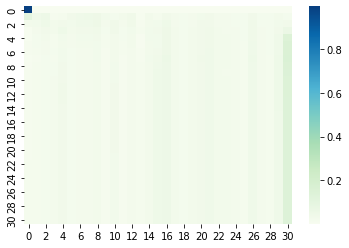

 63%|██████▎   | 18.856031128404606/30 [15:50<17:54, 96.42s/it]

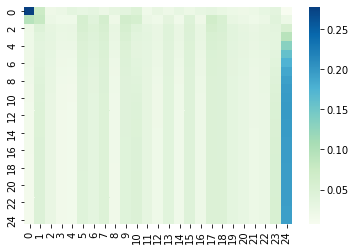

 63%|██████▎   | 18.859922178988263/30 [15:51<18:07, 97.63s/it]

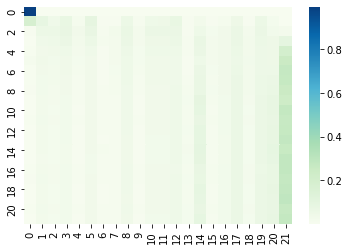

 63%|██████▎   | 18.86381322957192/30 [15:51<17:38, 95.02s/it] 

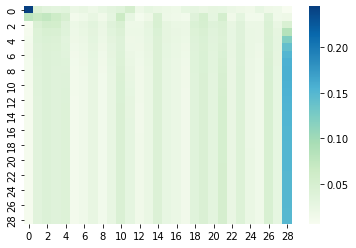

 63%|██████▎   | 18.86770428015558/30 [15:52<17:24, 93.80s/it]

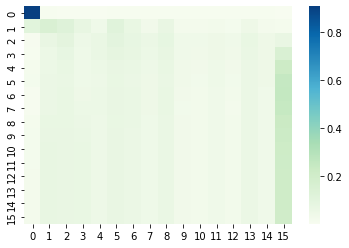

 63%|██████▎   | 18.871595330739236/30 [15:52<18:57, 102.25s/it]

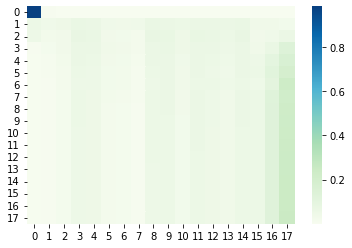

 63%|██████▎   | 18.875486381322894/30 [15:52<19:10, 103.44s/it]

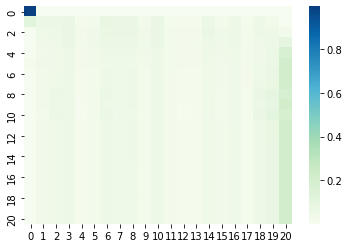

 63%|██████▎   | 18.87937743190655/30 [15:53<18:22, 99.18s/it]  

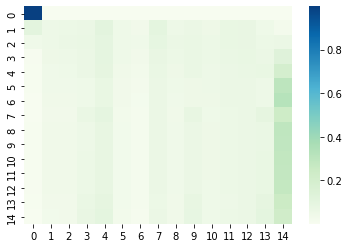

 63%|██████▎   | 18.88326848249021/30 [15:53<17:31, 94.55s/it]

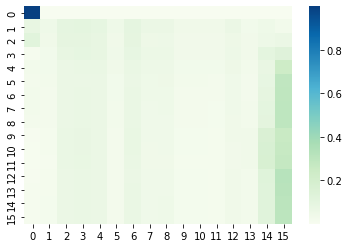

 63%|██████▎   | 18.887159533073866/30 [15:53<17:53, 96.64s/it]

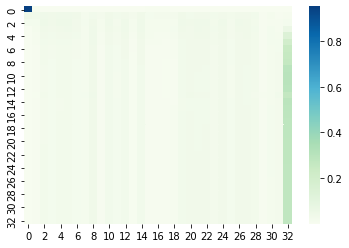

 63%|██████▎   | 18.891050583657524/30 [15:54<18:01, 97.34s/it]

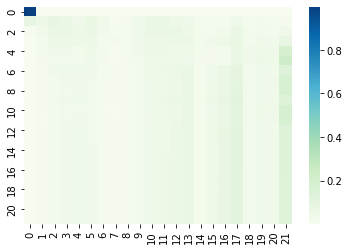

 63%|██████▎   | 18.89494163424118/30 [15:54<18:11, 98.29s/it] 

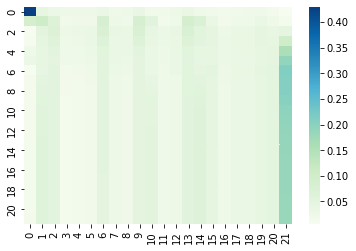

 63%|██████▎   | 18.89883268482484/30 [15:55<18:29, 99.92s/it]

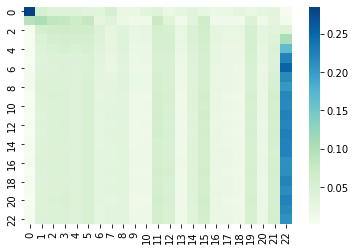

 63%|██████▎   | 18.902723735408497/30 [15:55<18:10, 98.22s/it]

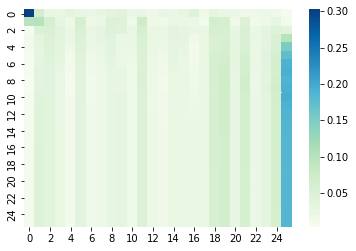

 63%|██████▎   | 18.906614785992154/30 [15:55<17:57, 97.11s/it]

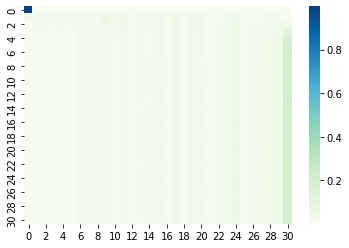

 63%|██████▎   | 18.910505836575812/30 [15:56<17:12, 93.12s/it]

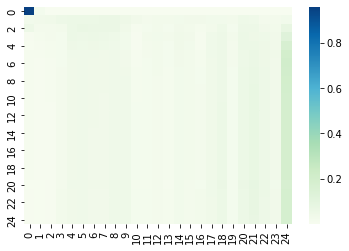

 63%|██████▎   | 18.91439688715947/30 [15:56<19:46, 107.08s/it]

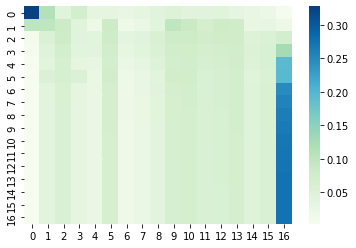

 63%|██████▎   | 18.918287937743127/30 [15:57<18:56, 102.54s/it]

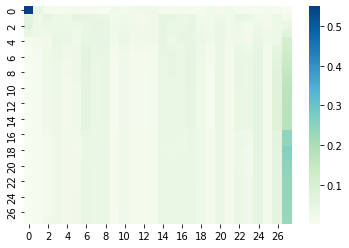

 63%|██████▎   | 18.922178988326785/30 [15:57<18:36, 100.79s/it]

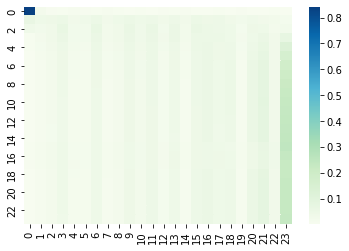

 63%|██████▎   | 18.926070038910442/30 [15:57<19:00, 102.97s/it]

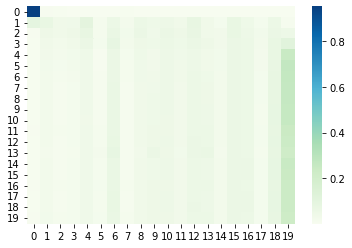

 63%|██████▎   | 18.9299610894941/30 [15:58<19:37, 106.40s/it]  

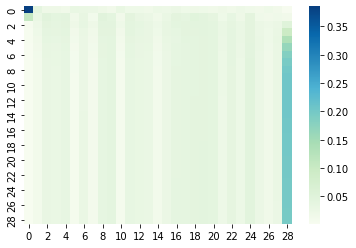

 63%|██████▎   | 18.933852140077757/30 [15:58<19:07, 103.72s/it]

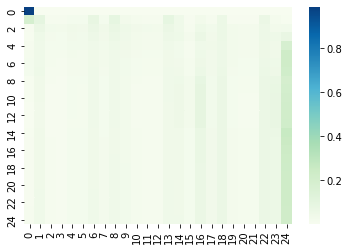

 63%|██████▎   | 18.937743190661415/30 [15:59<19:26, 105.49s/it]

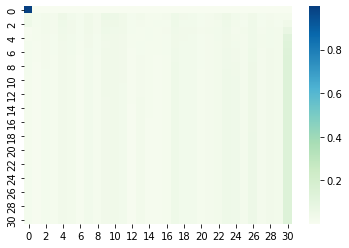

 63%|██████▎   | 18.941634241245072/30 [15:59<18:59, 103.06s/it]

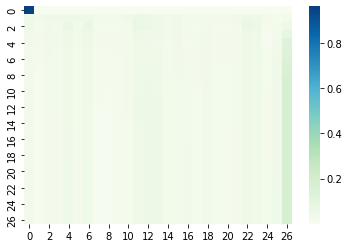

 63%|██████▎   | 18.94552529182873/30 [15:59<18:31, 100.58s/it] 

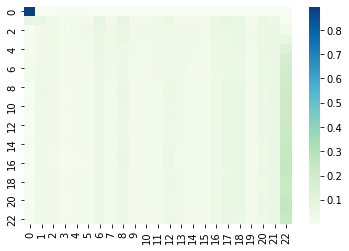

 63%|██████▎   | 18.949416342412388/30 [16:00<19:06, 103.77s/it]

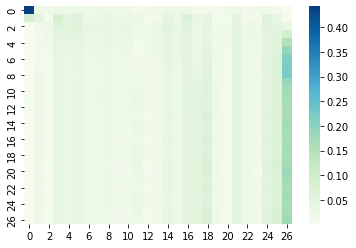

 63%|██████▎   | 18.953307392996045/30 [16:00<18:13, 98.97s/it] 

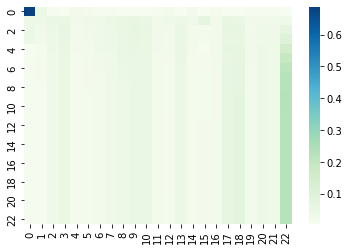

 63%|██████▎   | 18.957198443579703/30 [16:01<21:06, 114.68s/it]

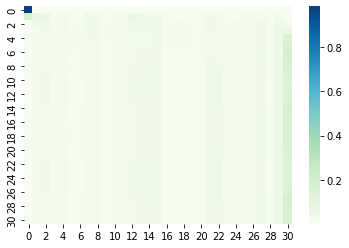

 63%|██████▎   | 18.96108949416336/30 [16:01<20:10, 109.66s/it] 

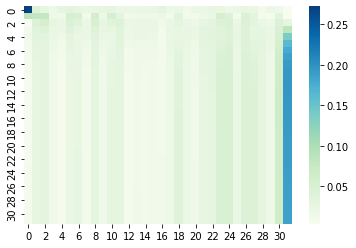

 63%|██████▎   | 18.964980544747018/30 [16:02<19:44, 107.32s/it]

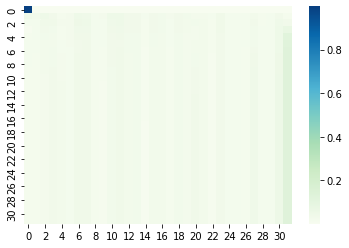

 63%|██████▎   | 18.968871595330675/30 [16:02<18:31, 100.72s/it]

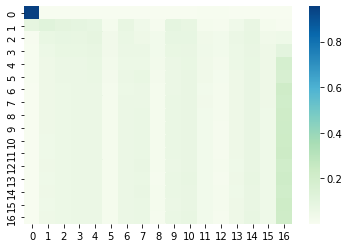

 63%|██████▎   | 18.972762645914333/30 [16:02<18:12, 99.11s/it] 

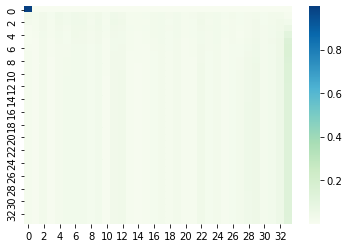

 63%|██████▎   | 18.97665369649799/30 [16:03<18:16, 99.44s/it] 

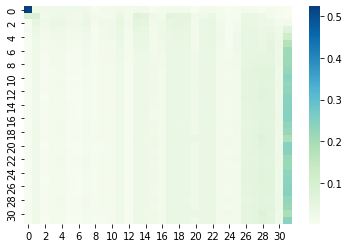

 63%|██████▎   | 18.980544747081648/30 [16:03<17:48, 96.96s/it]

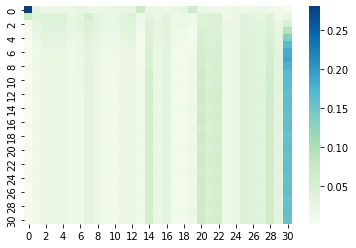

 63%|██████▎   | 18.984435797665306/30 [16:03<18:00, 98.06s/it]

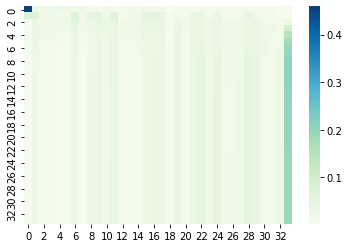

 63%|██████▎   | 18.988326848248963/30 [16:04<18:13, 99.34s/it]

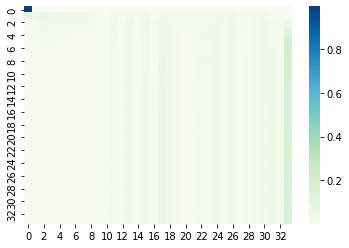

 63%|██████▎   | 18.99221789883262/30 [16:04<18:24, 100.30s/it]

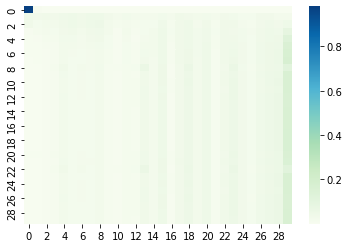

 63%|██████▎   | 18.99610894941628/30 [16:05<18:06, 98.75s/it] 

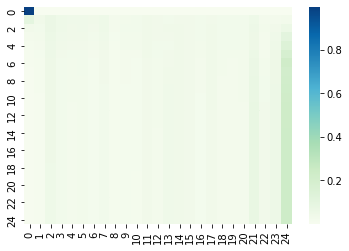

 63%|██████▎   | 18.999999999999936/30 [16:05<20:37, 112.52s/it]

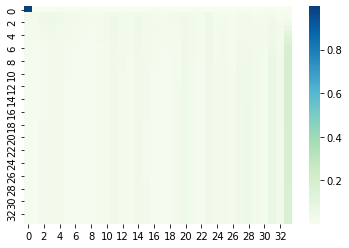

 65%|██████▌   | 19.610894941634175/30 [16:21<04:07, 23.85s/it]

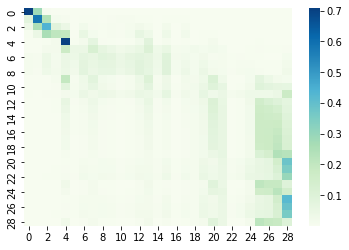

 65%|██████▌   | 19.61867704280149/30 [16:22<07:22, 42.64s/it] 

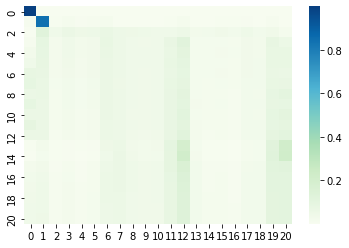

 65%|██████▌   | 19.622568093385148/30 [16:22<09:15, 53.52s/it]

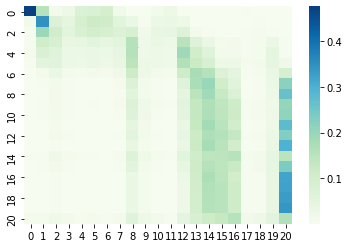

 65%|██████▌   | 19.626459143968805/30 [16:23<11:07, 64.39s/it]

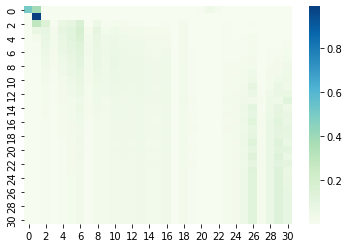

 65%|██████▌   | 19.630350194552463/30 [16:23<12:36, 72.99s/it]

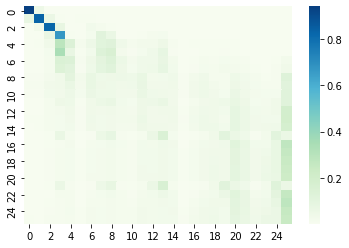

 65%|██████▌   | 19.63424124513612/30 [16:24<13:38, 78.99s/it] 

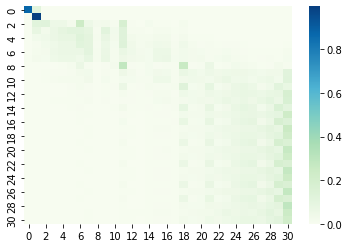

 65%|██████▌   | 19.638132295719778/30 [16:24<14:32, 84.25s/it]

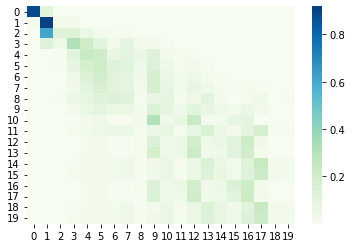

 65%|██████▌   | 19.642023346303436/30 [16:24<16:03, 93.04s/it]

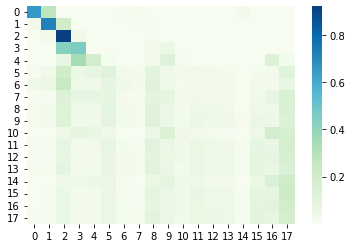

 65%|██████▌   | 19.645914396887093/30 [16:25<16:56, 98.14s/it]

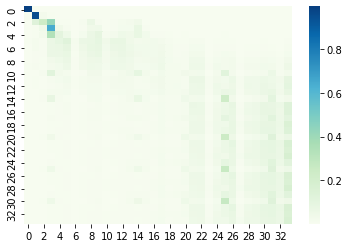

 65%|██████▌   | 19.64980544747075/30 [16:25<17:01, 98.68s/it] 

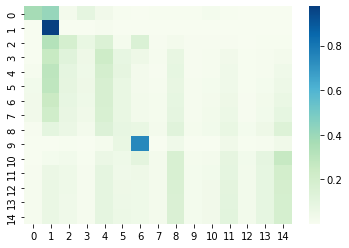

 66%|██████▌   | 19.65369649805441/30 [16:26<20:31, 119.05s/it]

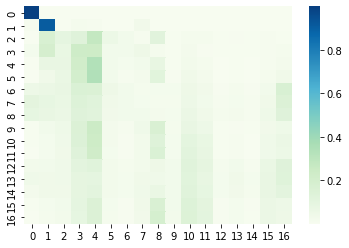

 66%|██████▌   | 19.657587548638066/30 [16:26<19:51, 115.19s/it]

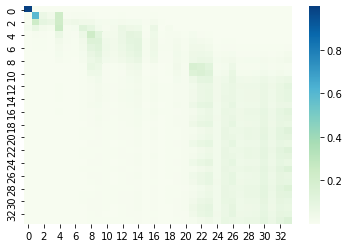

 66%|██████▌   | 19.661478599221724/30 [16:27<19:46, 114.80s/it]

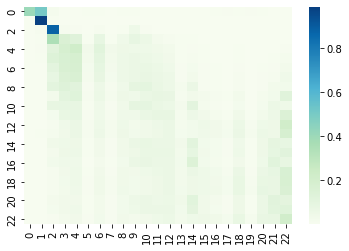

 66%|██████▌   | 19.66536964980538/30 [16:27<20:14, 117.54s/it] 

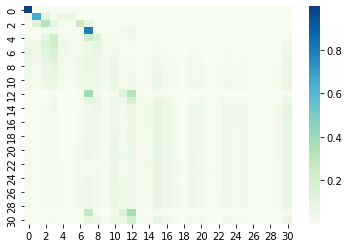

 66%|██████▌   | 19.66926070038904/30 [16:28<18:51, 109.54s/it]

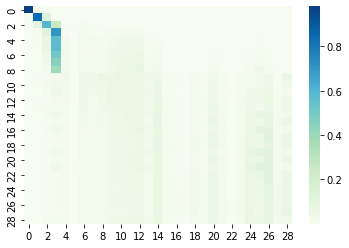

 66%|██████▌   | 19.673151750972696/30 [16:28<18:01, 104.74s/it]

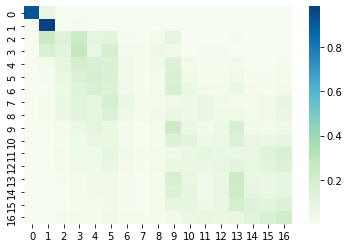

 66%|██████▌   | 19.677042801556354/30 [16:28<17:29, 101.70s/it]

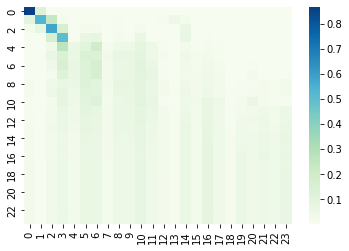

 66%|██████▌   | 19.68093385214001/30 [16:29<18:00, 104.73s/it] 

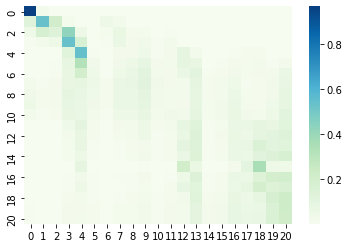

 66%|██████▌   | 19.68482490272367/30 [16:29<17:03, 99.26s/it] 

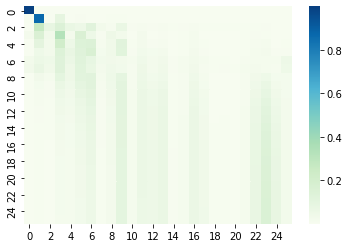

 66%|██████▌   | 19.688715953307327/30 [16:30<16:35, 96.51s/it]

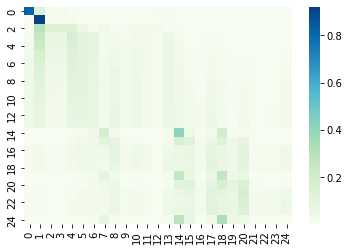

 66%|██████▌   | 19.692607003890984/30 [16:30<17:50, 103.84s/it]

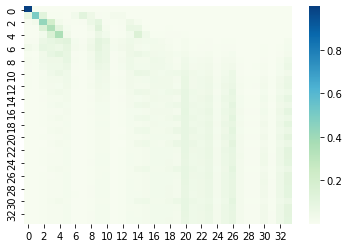

 66%|██████▌   | 19.69649805447464/30 [16:31<19:47, 115.30s/it] 

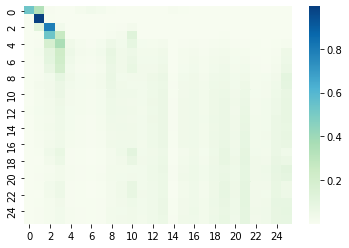

 66%|██████▌   | 19.7003891050583/30 [16:31<19:44, 115.04s/it] 

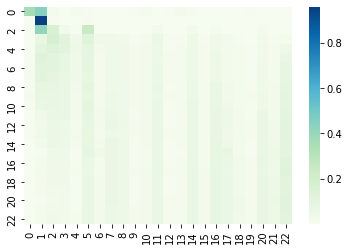

 66%|██████▌   | 19.704280155641957/30 [16:31<19:40, 114.68s/it]

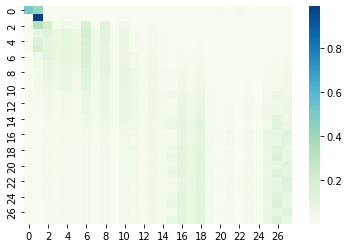

 66%|██████▌   | 19.708171206225614/30 [16:32<18:15, 106.43s/it]

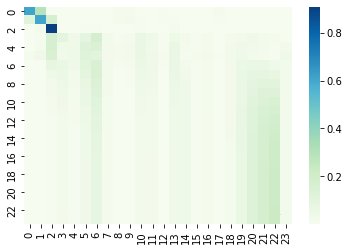

 66%|██████▌   | 19.712062256809272/30 [16:32<18:12, 106.20s/it]

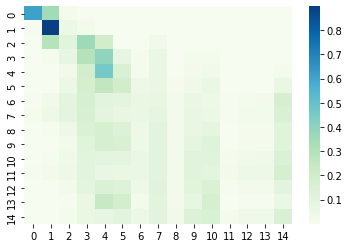

 66%|██████▌   | 19.71595330739293/30 [16:33<17:32, 102.35s/it] 

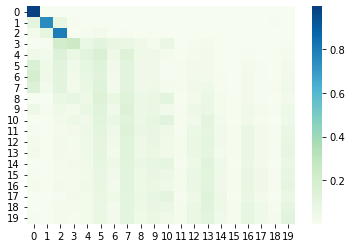

 66%|██████▌   | 19.719844357976587/30 [16:33<18:12, 106.31s/it]

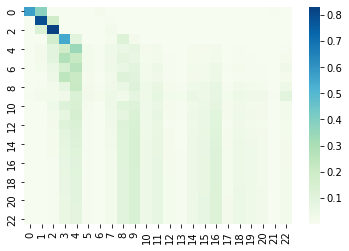

 66%|██████▌   | 19.723735408560245/30 [16:33<18:13, 106.39s/it]

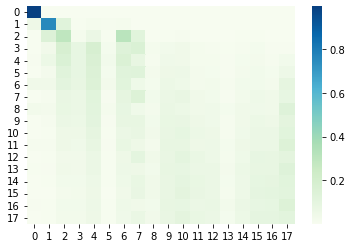

 66%|██████▌   | 19.727626459143902/30 [16:34<18:17, 106.87s/it]

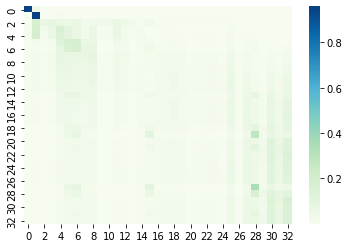

 66%|██████▌   | 19.73151750972756/30 [16:34<17:14, 100.74s/it] 

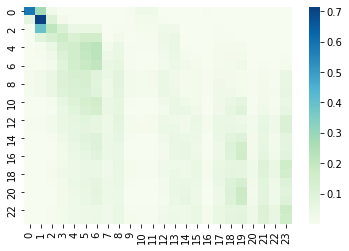

 66%|██████▌   | 19.735408560311217/30 [16:35<17:41, 103.42s/it]

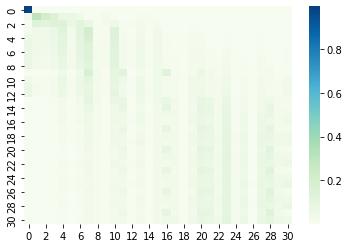

 66%|██████▌   | 19.739299610894875/30 [16:35<19:41, 115.15s/it]

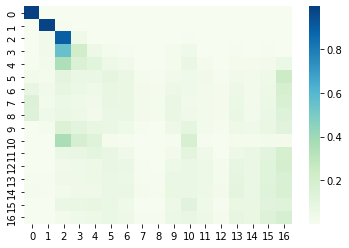

 66%|██████▌   | 19.743190661478533/30 [16:36<18:59, 111.12s/it]

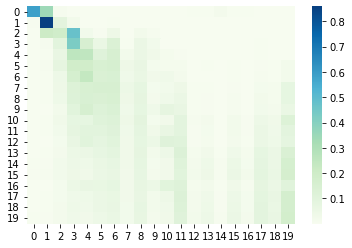

 66%|██████▌   | 19.74708171206219/30 [16:36<19:12, 112.37s/it] 

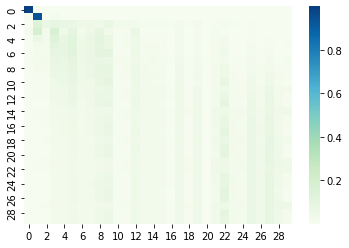

 66%|██████▌   | 19.750972762645848/30 [16:36<18:27, 108.04s/it]

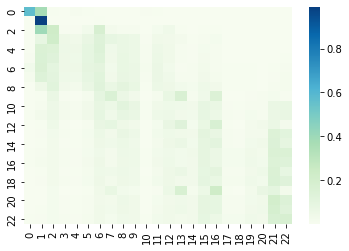

 66%|██████▌   | 19.754863813229505/30 [16:37<18:26, 108.02s/it]

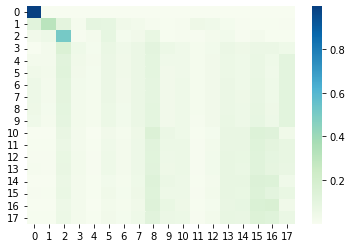

 66%|██████▌   | 19.758754863813163/30 [16:37<18:27, 108.13s/it]

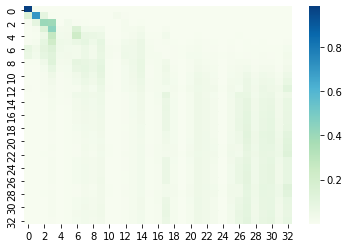

 66%|██████▌   | 19.76264591439682/30 [16:38<18:12, 106.67s/it] 

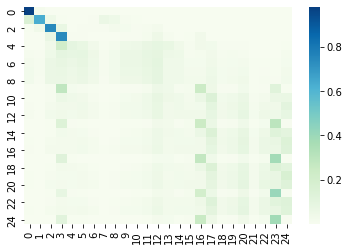

 66%|██████▌   | 19.766536964980478/30 [16:38<17:42, 103.86s/it]

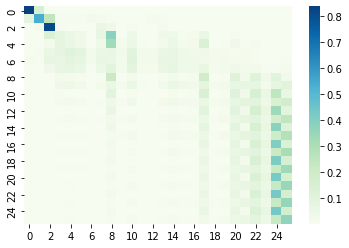

 66%|██████▌   | 19.770428015564136/30 [16:38<16:45, 98.25s/it] 

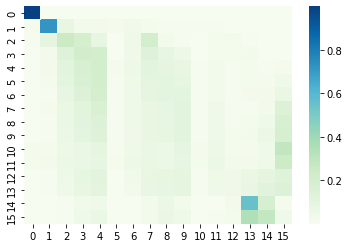

 66%|██████▌   | 19.774319066147793/30 [16:39<16:40, 97.84s/it]

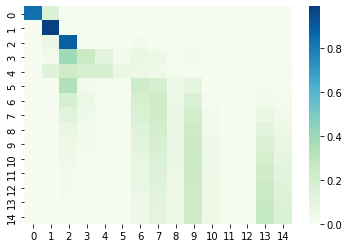

 66%|██████▌   | 19.77821011673145/30 [16:39<16:33, 97.24s/it] 

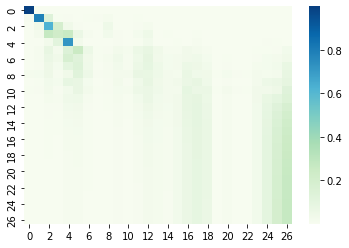

 66%|██████▌   | 19.78210116731511/30 [16:40<18:16, 107.27s/it]

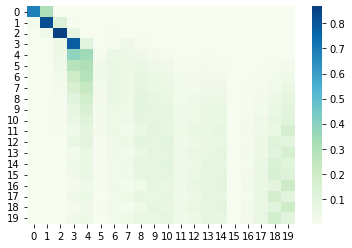

 66%|██████▌   | 19.785992217898766/30 [16:40<18:34, 109.13s/it]

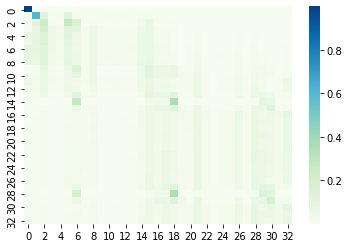

 66%|██████▌   | 19.789883268482424/30 [16:40<17:54, 105.21s/it]

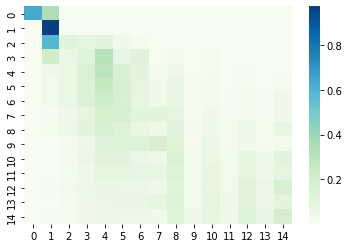

 66%|██████▌   | 19.79377431906608/30 [16:41<17:18, 101.72s/it] 

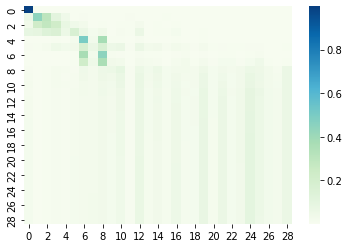

 66%|██████▌   | 19.79766536964974/30 [16:41<16:17, 95.81s/it] 

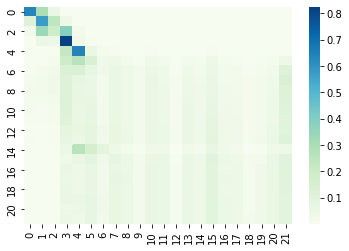

 66%|██████▌   | 19.801556420233396/30 [16:41<16:59, 100.00s/it]

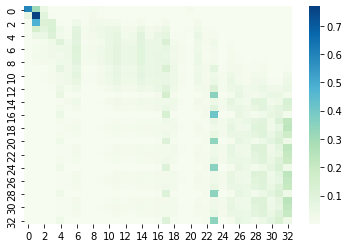

 66%|██████▌   | 19.805447470817054/30 [16:42<16:43, 98.40s/it] 

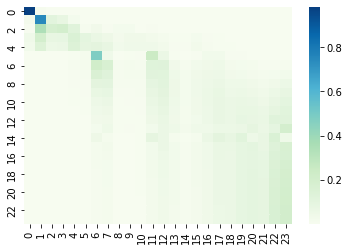

 66%|██████▌   | 19.80933852140071/30 [16:42<17:24, 102.46s/it]

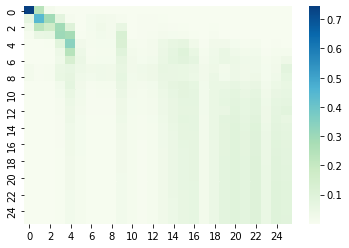

 66%|██████▌   | 19.81322957198437/30 [16:43<16:43, 98.55s/it] 

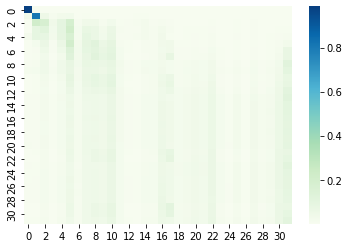

 66%|██████▌   | 19.817120622568027/30 [16:43<16:22, 96.44s/it]

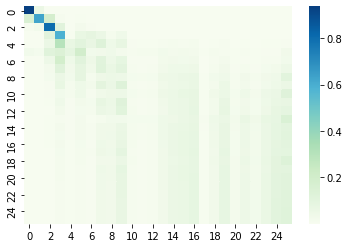

 66%|██████▌   | 19.821011673151684/30 [16:43<15:44, 92.74s/it]

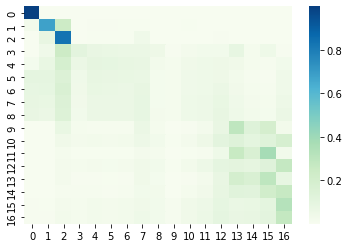

 66%|██████▌   | 19.82490272373534/30 [16:44<17:42, 104.43s/it]

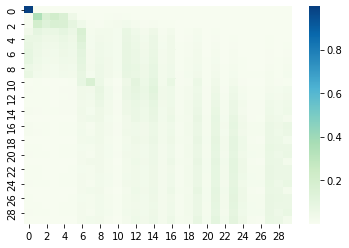

 66%|██████▌   | 19.828793774319/30 [16:44<17:11, 101.46s/it]  

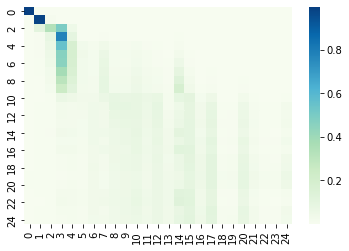

 66%|██████▌   | 19.832684824902657/30 [16:45<17:36, 103.89s/it]

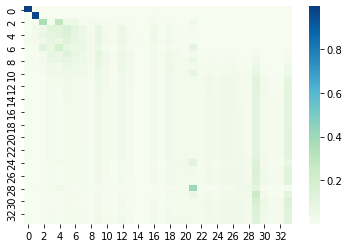

 66%|██████▌   | 19.836575875486314/30 [16:45<17:22, 102.61s/it]

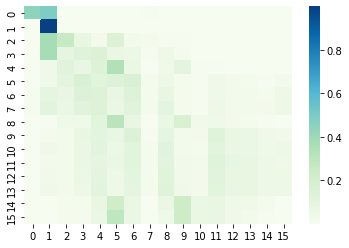

 66%|██████▌   | 19.840466926069972/30 [16:45<17:24, 102.81s/it]

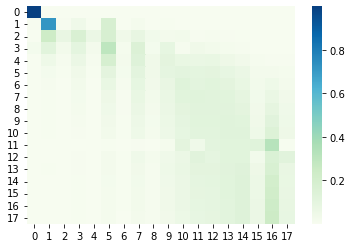

 66%|██████▌   | 19.84435797665363/30 [16:46<17:30, 103.43s/it] 

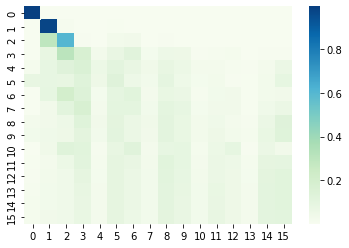

 66%|██████▌   | 19.848249027237287/30 [16:46<16:20, 96.57s/it]

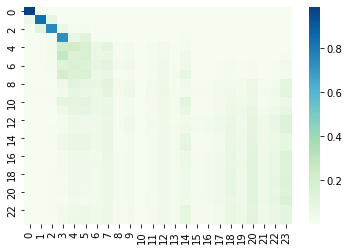

 66%|██████▌   | 19.852140077820945/30 [16:47<16:13, 95.95s/it]

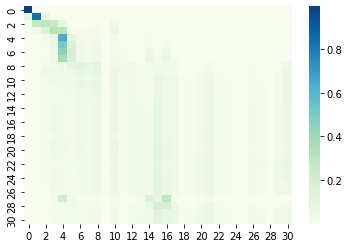

 66%|██████▌   | 19.856031128404602/30 [16:47<15:39, 92.64s/it]

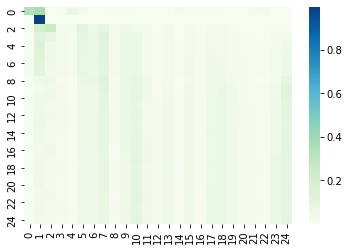

 66%|██████▌   | 19.85992217898826/30 [16:47<15:56, 94.36s/it] 

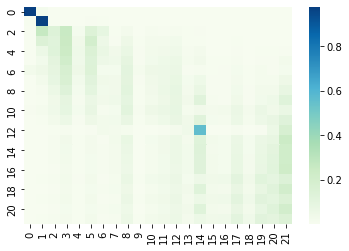

 66%|██████▌   | 19.863813229571917/30 [16:48<15:57, 94.42s/it]

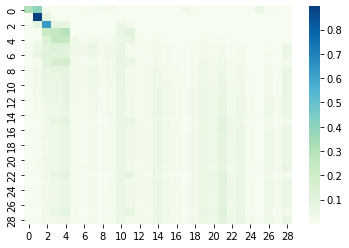

 66%|██████▌   | 19.867704280155575/30 [16:48<18:05, 107.17s/it]

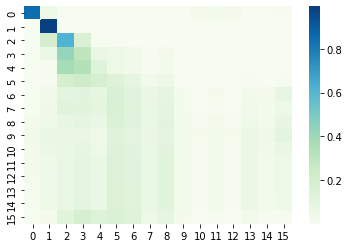

 66%|██████▌   | 19.871595330739233/30 [16:49<17:41, 104.80s/it]

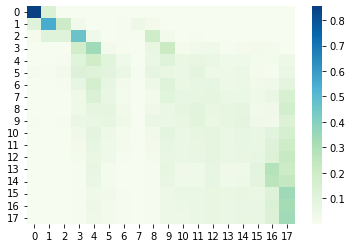

 66%|██████▋   | 19.87548638132289/30 [16:49<18:08, 107.51s/it] 

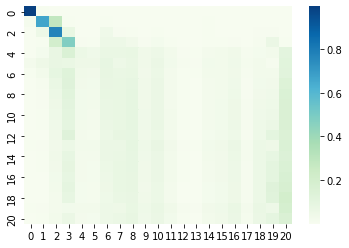

 66%|██████▋   | 19.879377431906548/30 [16:49<17:50, 105.81s/it]

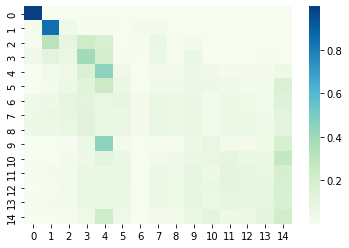

 66%|██████▋   | 19.883268482490205/30 [16:50<17:17, 102.54s/it]

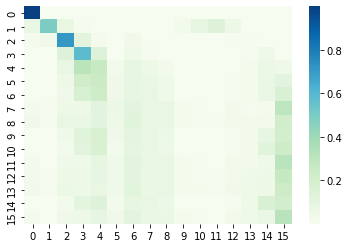

 66%|██████▋   | 19.887159533073863/30 [16:50<17:09, 101.81s/it]

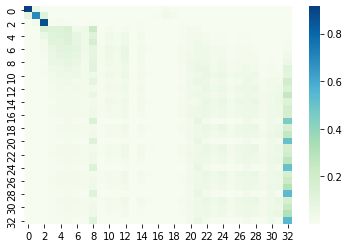

 66%|██████▋   | 19.89105058365752/30 [16:51<17:05, 101.48s/it] 

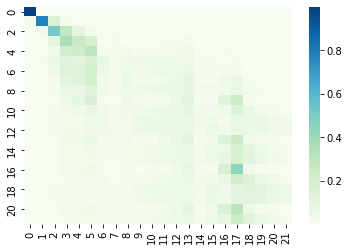

 66%|██████▋   | 19.894941634241178/30 [16:51<16:41, 99.07s/it]

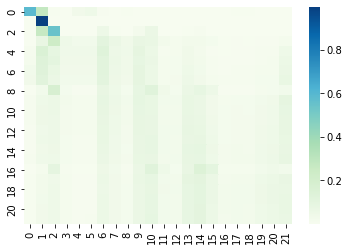

 66%|██████▋   | 19.898832684824836/30 [16:51<15:54, 94.51s/it]

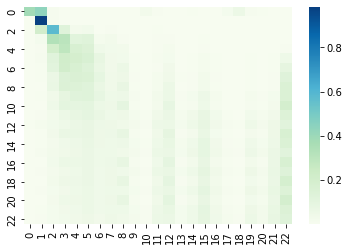

 66%|██████▋   | 19.902723735408493/30 [16:52<15:49, 94.08s/it]

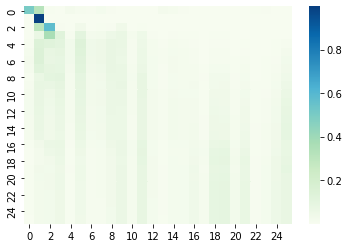

 66%|██████▋   | 19.90661478599215/30 [16:52<15:21, 91.28s/it] 

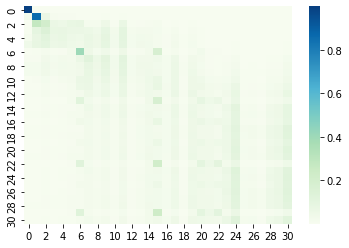

 66%|██████▋   | 19.91050583657581/30 [16:52<17:41, 105.18s/it]

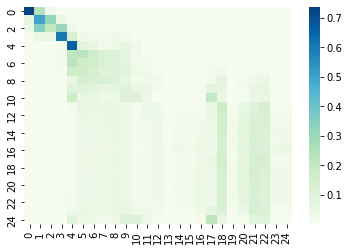

 66%|██████▋   | 19.914396887159466/30 [16:53<17:32, 104.32s/it]

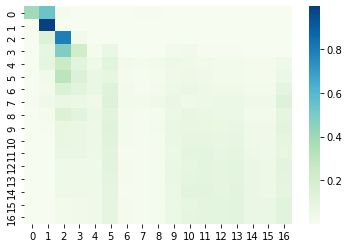

 66%|██████▋   | 19.918287937743123/30 [16:53<17:18, 102.97s/it]

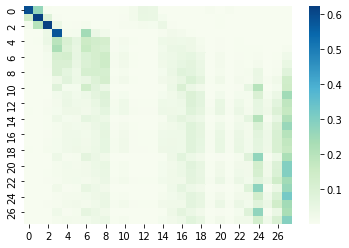

 66%|██████▋   | 19.92217898832678/30 [16:54<16:36, 98.83s/it]  

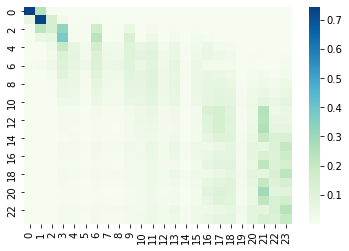

 66%|██████▋   | 19.92607003891044/30 [16:54<16:29, 98.24s/it]

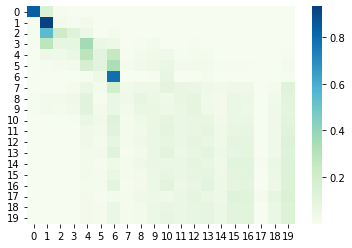

 66%|██████▋   | 19.929961089494096/30 [16:54<16:46, 99.96s/it]

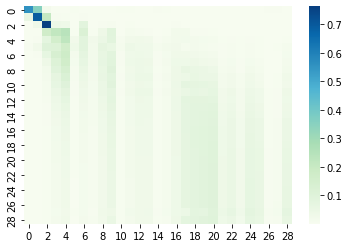

 66%|██████▋   | 19.933852140077754/30 [16:55<16:51, 100.44s/it]

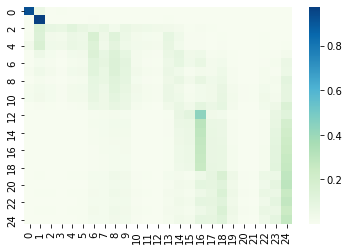

 66%|██████▋   | 19.93774319066141/30 [16:55<17:19, 103.26s/it] 

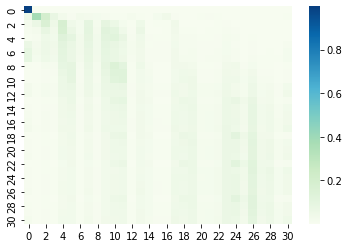

 66%|██████▋   | 19.94163424124507/30 [16:56<17:01, 101.52s/it]

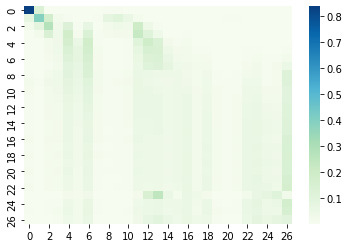

 66%|██████▋   | 19.945525291828726/30 [16:56<16:45, 99.97s/it]

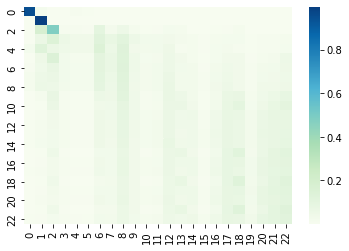

 66%|██████▋   | 19.949416342412384/30 [16:56<16:36, 99.16s/it]

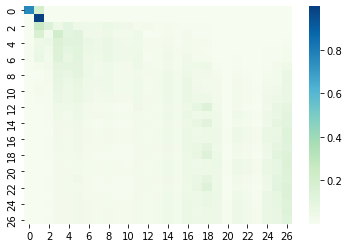

 67%|██████▋   | 19.95330739299604/30 [16:57<17:32, 104.71s/it]

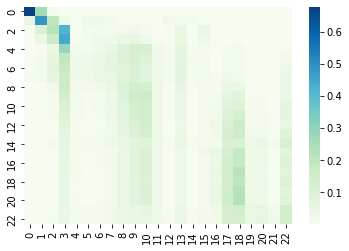

 67%|██████▋   | 19.9571984435797/30 [16:57<16:56, 101.25s/it] 

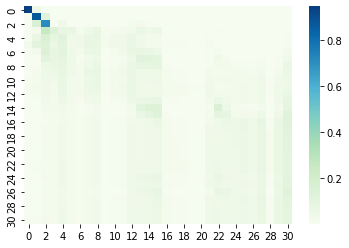

 67%|██████▋   | 19.961089494163357/30 [16:57<16:06, 96.28s/it]

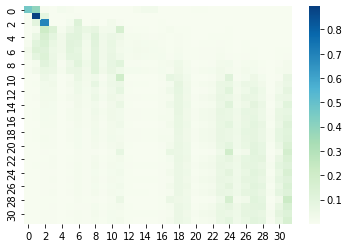

 67%|██████▋   | 19.964980544747014/30 [16:58<16:26, 98.35s/it]

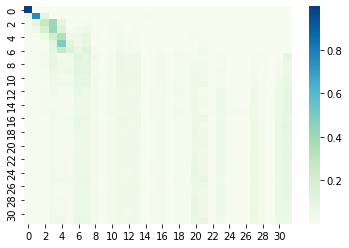

 67%|██████▋   | 19.968871595330672/30 [16:58<15:48, 94.57s/it]

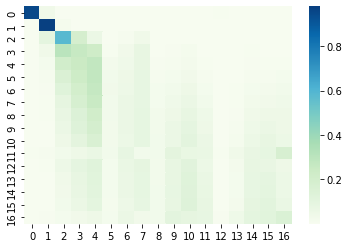

 67%|██████▋   | 19.97276264591433/30 [16:59<15:32, 92.99s/it] 

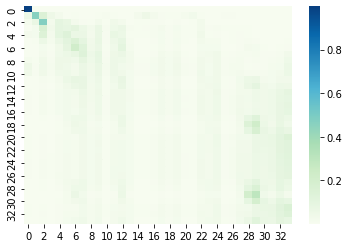

 67%|██████▋   | 19.976653696497987/30 [16:59<16:01, 95.94s/it]

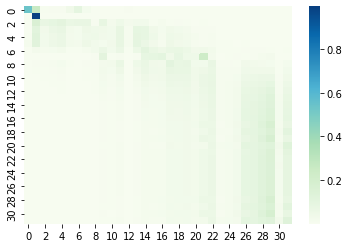

 67%|██████▋   | 19.980544747081645/30 [16:59<15:49, 94.76s/it]

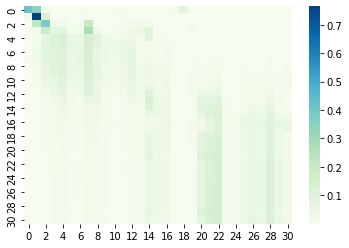

 67%|██████▋   | 19.984435797665302/30 [17:00<16:11, 97.00s/it]

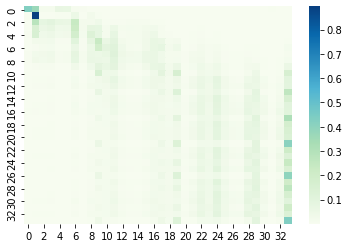

 67%|██████▋   | 19.98832684824896/30 [17:00<16:49, 100.82s/it]

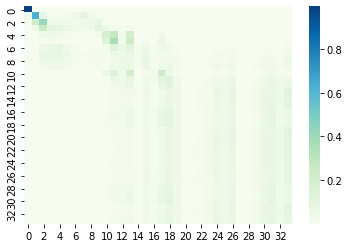

 67%|██████▋   | 19.992217898832617/30 [17:00<16:45, 100.51s/it]

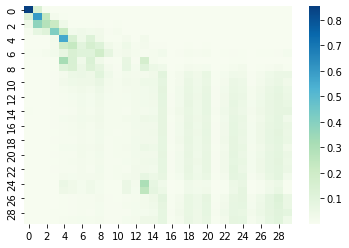

 67%|██████▋   | 19.996108949416275/30 [17:01<18:38, 111.82s/it]

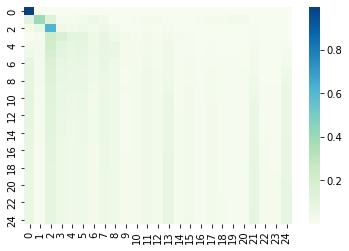

 67%|██████▋   | 19.999999999999932/30 [17:01<18:31, 111.16s/it]

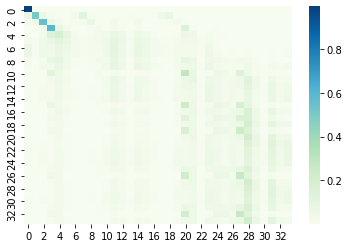

 69%|██████▊   | 20.61089494163417/30 [17:16<03:48, 24.34s/it] 

 69%|██████▊   | 20.618677042801487/30 [17:17<07:43, 49.43s/it]

 69%|██████▊   | 20.622568093385144/30 [17:18<09:27, 60.56s/it]

 69%|██████▉   | 20.626459143968802/30 [17:18<11:20, 72.56s/it]

 69%|██████▉   | 20.63035019455246/30 [17:19<13:24, 85.90s/it] 

 69%|██████▉   | 20.634241245136117/30 [17:19<14:11, 90.95s/it]

 69%|██████▉   | 20.638132295719775/30 [17:20<15:32, 99.56s/it]

 69%|██████▉   | 20.642023346303432/30 [17:20<16:18, 104.53s/it]

 69%|██████▉   | 20.64591439688709/30 [17:20<16:53, 108.34s/it] 

 69%|██████▉   | 20.649805447470747/30 [17:21<19:15, 123.57s/it]

 69%|██████▉   | 20.653696498054405/30 [17:22<18:55, 121.52s/it]

 69%|██████▉   | 20.657587548638062/30 [17:22<18:52, 121.27s/it]

 69%|██████▉   | 20.66147859922172/30 [17:22<18:18, 117.65s/it] 

 69%|██████▉   | 20.665369649805378/30 [17:23<17:31, 112.61s/it]

 69%|██████▉   | 20.669260700389035/30 [17:23<16:39, 107.13s/it]

 69%|██████▉   | 20.673151750972693/30 [17:24<16:16, 104.66s/it]

 69%|██████▉   | 20.67704280155635/30 [17:24<15:57, 102.69s/it] 

 69%|██████▉   | 20.680933852140008/30 [17:24<15:52, 102.17s/it]

 69%|██████▉   | 20.684824902723665/30 [17:25<15:05, 97.16s/it] 

 69%|██████▉   | 20.688715953307323/30 [17:25<14:47, 95.35s/it]

 69%|██████▉   | 20.69260700389098/30 [17:26<17:11, 110.82s/it]

 69%|██████▉   | 20.696498054474638/30 [17:26<16:53, 108.93s/it]

 69%|██████▉   | 20.700389105058296/30 [17:26<15:45, 101.62s/it]

 69%|██████▉   | 20.704280155641953/30 [17:27<15:06, 97.47s/it] 

 69%|██████▉   | 20.70817120622561/30 [17:27<14:40, 94.78s/it] 

 69%|██████▉   | 20.71206225680927/30 [17:27<14:30, 93.75s/it]

 69%|██████▉   | 20.715953307392926/30 [17:28<13:59, 90.48s/it]

 69%|██████▉   | 20.719844357976584/30 [17:28<15:08, 97.94s/it]

 69%|██████▉   | 20.72373540856024/30 [17:29<14:57, 96.78s/it] 

 69%|██████▉   | 20.7276264591439/30 [17:29<15:23, 99.56s/it] 

 69%|██████▉   | 20.731517509727556/30 [17:29<15:24, 99.77s/it]

 69%|██████▉   | 20.735408560311214/30 [17:30<17:22, 112.53s/it]

 69%|██████▉   | 20.73929961089487/30 [17:30<16:41, 108.13s/it] 

 69%|██████▉   | 20.74319066147853/30 [17:31<16:21, 106.03s/it]

 69%|██████▉   | 20.747081712062187/30 [17:31<16:34, 107.53s/it]

 69%|██████▉   | 20.750972762645844/30 [17:31<15:45, 102.18s/it]

 69%|██████▉   | 20.754863813229502/30 [17:32<15:40, 101.69s/it]

 69%|██████▉   | 20.75875486381316/30 [17:32<15:54, 103.31s/it] 

 69%|██████▉   | 20.762645914396817/30 [17:33<15:40, 101.82s/it]

 69%|██████▉   | 20.766536964980475/30 [17:33<16:10, 105.06s/it]

 69%|██████▉   | 20.770428015564132/30 [17:33<15:27, 100.48s/it]

 69%|██████▉   | 20.77431906614779/30 [17:34<15:13, 98.99s/it]  

 69%|██████▉   | 20.778210116731447/30 [17:34<16:54, 109.99s/it]

 69%|██████▉   | 20.782101167315105/30 [17:35<16:11, 105.34s/it]

 69%|██████▉   | 20.785992217898762/30 [17:35<16:45, 109.15s/it]

 69%|██████▉   | 20.78988326848242/30 [17:36<16:23, 106.82s/it] 

 69%|██████▉   | 20.793774319066078/30 [17:36<15:55, 103.76s/it]

 69%|██████▉   | 20.797665369649735/30 [17:36<15:30, 101.11s/it]

 69%|██████▉   | 20.801556420233393/30 [17:37<15:46, 102.94s/it]

 69%|██████▉   | 20.80544747081705/30 [17:37<15:38, 102.06s/it] 

 69%|██████▉   | 20.809338521400708/30 [17:37<15:55, 103.93s/it]

 69%|██████▉   | 20.813229571984365/30 [17:38<15:32, 101.52s/it]

 69%|██████▉   | 20.817120622568023/30 [17:38<15:19, 100.11s/it]

 69%|██████▉   | 20.82101167315168/30 [17:39<16:47, 109.80s/it] 

 69%|██████▉   | 20.824902723735338/30 [17:39<16:13, 106.10s/it]

 69%|██████▉   | 20.828793774318996/30 [17:40<15:52, 103.87s/it]

 69%|██████▉   | 20.832684824902653/30 [17:40<16:03, 105.10s/it]

 69%|██████▉   | 20.83657587548631/30 [17:40<15:53, 104.04s/it] 

 69%|██████▉   | 20.84046692606997/30 [17:41<15:38, 102.49s/it]

 69%|██████▉   | 20.844357976653626/30 [17:41<15:46, 103.41s/it]

 69%|██████▉   | 20.848249027237284/30 [17:42<15:37, 102.45s/it]

 70%|██████▉   | 20.85214007782094/30 [17:42<15:54, 104.32s/it] 

 70%|██████▉   | 20.8560311284046/30 [17:42<15:37, 102.55s/it] 

 70%|██████▉   | 20.859922178988256/30 [17:43<16:12, 106.39s/it]

 70%|██████▉   | 20.863813229571914/30 [17:43<17:48, 116.97s/it]

 70%|██████▉   | 20.86770428015557/30 [17:44<17:07, 112.46s/it] 

 70%|██████▉   | 20.87159533073923/30 [17:44<16:21, 107.48s/it]

 70%|██████▉   | 20.875486381322887/30 [17:45<16:24, 107.93s/it]

 70%|██████▉   | 20.879377431906544/30 [17:45<16:08, 106.17s/it]

 70%|██████▉   | 20.8832684824902/30 [17:45<15:40, 103.16s/it]  

 70%|██████▉   | 20.88715953307386/30 [17:46<15:40, 103.17s/it]

 70%|██████▉   | 20.891050583657517/30 [17:46<14:56, 98.40s/it]

 70%|██████▉   | 20.894941634241174/30 [17:46<14:24, 94.98s/it]

 70%|██████▉   | 20.898832684824832/30 [17:47<14:17, 94.20s/it]

 70%|██████▉   | 20.90272373540849/30 [17:47<14:38, 96.60s/it] 

 70%|██████▉   | 20.906614785992147/30 [17:48<15:47, 104.22s/it]

 70%|██████▉   | 20.910505836575805/30 [17:48<15:43, 103.79s/it]

 70%|██████▉   | 20.914396887159462/30 [17:48<15:45, 104.12s/it]

 70%|██████▉   | 20.91828793774312/30 [17:49<15:59, 105.68s/it] 

 70%|██████▉   | 20.922178988326777/30 [17:49<15:26, 102.09s/it]

 70%|██████▉   | 20.926070038910435/30 [17:50<15:49, 104.66s/it]

 70%|██████▉   | 20.929961089494093/30 [17:50<16:19, 108.00s/it]

 70%|██████▉   | 20.93385214007775/30 [17:50<15:56, 105.50s/it] 

 70%|██████▉   | 20.937743190661408/30 [17:51<16:13, 107.42s/it]

 70%|██████▉   | 20.941634241245065/30 [17:51<15:48, 104.73s/it]

 70%|██████▉   | 20.945525291828723/30 [17:52<15:21, 101.82s/it]

 70%|██████▉   | 20.94941634241238/30 [17:52<17:10, 113.87s/it] 

 70%|██████▉   | 20.953307392996038/30 [17:53<16:17, 108.04s/it]

 70%|██████▉   | 20.957198443579696/30 [17:53<16:23, 108.78s/it]

 70%|██████▉   | 20.961089494163353/30 [17:53<16:02, 106.51s/it]

 70%|██████▉   | 20.96498054474701/30 [17:54<15:42, 104.33s/it] 

 70%|██████▉   | 20.96887159533067/30 [17:54<15:34, 103.46s/it]

 70%|██████▉   | 20.972762645914326/30 [17:55<15:29, 103.01s/it]

 70%|██████▉   | 20.976653696497984/30 [17:55<15:39, 104.10s/it]

 70%|██████▉   | 20.98054474708164/30 [17:55<15:21, 102.12s/it] 

 70%|██████▉   | 20.9844357976653/30 [17:56<15:16, 101.62s/it] 

 70%|██████▉   | 20.988326848248956/30 [17:56<15:06, 100.57s/it]

 70%|██████▉   | 20.992217898832614/30 [17:57<17:01, 113.36s/it]

 70%|██████▉   | 20.99610894941627/30 [17:57<16:14, 108.24s/it] 

 70%|██████▉   | 20.99999999999993/30 [17:57<15:52, 105.87s/it]

 72%|███████▏  | 21.610894941634168/30 [18:12<03:00, 21.57s/it]

 72%|███████▏  | 21.618677042801483/30 [18:13<05:30, 39.46s/it]

 72%|███████▏  | 21.62256809338514/30 [18:13<06:55, 49.64s/it] 

 72%|███████▏  | 21.6264591439688/30 [18:13<08:26, 60.43s/it] 

 72%|███████▏  | 21.630350194552456/30 [18:14<09:46, 70.12s/it]

 72%|███████▏  | 21.634241245136113/30 [18:14<10:35, 75.91s/it]

 72%|███████▏  | 21.63813229571977/30 [18:15<11:29, 82.45s/it] 

 72%|███████▏  | 21.64202334630343/30 [18:15<12:35, 90.38s/it]

 72%|███████▏  | 21.645914396887086/30 [18:16<15:01, 107.94s/it]

 72%|███████▏  | 21.649805447470744/30 [18:16<14:47, 106.34s/it]

 72%|███████▏  | 21.6536964980544/30 [18:16<14:00, 100.73s/it]  

 72%|███████▏  | 21.65758754863806/30 [18:17<14:03, 101.14s/it]

 72%|███████▏  | 21.661478599221716/30 [18:17<13:31, 97.30s/it]

 72%|███████▏  | 21.665369649805374/30 [18:17<13:30, 97.19s/it]

 72%|███████▏  | 21.66926070038903/30 [18:18<13:47, 99.31s/it] 

 72%|███████▏  | 21.67315175097269/30 [18:18<13:14, 95.44s/it]

 72%|███████▏  | 21.677042801556347/30 [18:19<13:42, 98.79s/it]

 72%|███████▏  | 21.680933852140004/30 [18:19<14:18, 103.17s/it]

 72%|███████▏  | 21.684824902723662/30 [18:19<14:11, 102.42s/it]

 72%|███████▏  | 21.68871595330732/30 [18:20<15:25, 111.40s/it] 

 72%|███████▏  | 21.692607003890977/30 [18:20<16:08, 116.60s/it]

 72%|███████▏  | 21.696498054474635/30 [18:21<16:48, 121.50s/it]

 72%|███████▏  | 21.700389105058292/30 [18:21<15:29, 112.01s/it]

 72%|███████▏  | 21.70428015564195/30 [18:22<14:59, 108.42s/it] 

 72%|███████▏  | 21.708171206225607/30 [18:22<14:38, 105.92s/it]

 72%|███████▏  | 21.712062256809265/30 [18:23<15:09, 109.78s/it]

 72%|███████▏  | 21.715953307392923/30 [18:23<14:45, 106.86s/it]

 72%|███████▏  | 21.71984435797658/30 [18:23<14:57, 108.37s/it] 

 72%|███████▏  | 21.723735408560238/30 [18:24<15:53, 115.15s/it]

 72%|███████▏  | 21.727626459143895/30 [18:24<15:16, 110.76s/it]

 72%|███████▏  | 21.731517509727553/30 [18:25<16:43, 121.37s/it]

 72%|███████▏  | 21.73540856031121/30 [18:25<16:41, 121.16s/it] 

 72%|███████▏  | 21.739299610894868/30 [18:26<15:52, 115.32s/it]

 72%|███████▏  | 21.743190661478526/30 [18:26<15:02, 109.33s/it]

 72%|███████▏  | 21.747081712062183/30 [18:27<15:14, 110.86s/it]

 73%|███████▎  | 21.75097276264584/30 [18:27<14:38, 106.48s/it] 

 73%|███████▎  | 21.7548638132295/30 [18:27<14:25, 104.98s/it] 

 73%|███████▎  | 21.758754863813156/30 [18:28<14:32, 105.86s/it]

 73%|███████▎  | 21.762645914396813/30 [18:28<13:54, 101.35s/it]

 73%|███████▎  | 21.76653696498047/30 [18:29<14:19, 104.43s/it] 

 73%|███████▎  | 21.77042801556413/30 [18:29<13:15, 96.62s/it] 

 73%|███████▎  | 21.774319066147786/30 [18:29<15:01, 109.64s/it]

 73%|███████▎  | 21.778210116731444/30 [18:30<13:50, 101.06s/it]

 73%|███████▎  | 21.7821011673151/30 [18:30<13:19, 97.31s/it]   

 73%|███████▎  | 21.78599221789876/30 [18:30<13:54, 101.56s/it]

 73%|███████▎  | 21.789883268482416/30 [18:31<14:05, 102.96s/it]

 73%|███████▎  | 21.793774319066074/30 [18:31<13:29, 98.62s/it] 

 73%|███████▎  | 21.79766536964973/30 [18:32<12:46, 93.40s/it] 

 73%|███████▎  | 21.80155642023339/30 [18:32<12:29, 91.39s/it]

 73%|███████▎  | 21.805447470817047/30 [18:32<12:21, 90.49s/it]

 73%|███████▎  | 21.809338521400704/30 [18:33<12:49, 93.90s/it]

 73%|███████▎  | 21.813229571984362/30 [18:33<12:48, 93.84s/it]

 73%|███████▎  | 21.81712062256802/30 [18:34<14:41, 107.68s/it]

 73%|███████▎  | 21.821011673151677/30 [18:34<13:58, 102.51s/it]

 73%|███████▎  | 21.824902723735335/30 [18:34<13:54, 102.08s/it]

 73%|███████▎  | 21.828793774318992/30 [18:35<13:45, 101.06s/it]

 73%|███████▎  | 21.83268482490265/30 [18:35<14:10, 104.19s/it] 

 73%|███████▎  | 21.836575875486307/30 [18:35<14:05, 103.59s/it]

 73%|███████▎  | 21.840466926069965/30 [18:36<13:51, 101.89s/it]

 73%|███████▎  | 21.844357976653622/30 [18:36<13:37, 100.23s/it]

 73%|███████▎  | 21.84824902723728/30 [18:37<12:53, 94.84s/it]  

 73%|███████▎  | 21.852140077820938/30 [18:37<12:54, 95.05s/it]

 73%|███████▎  | 21.856031128404595/30 [18:37<12:35, 92.77s/it]

 73%|███████▎  | 21.859922178988253/30 [18:38<14:54, 109.94s/it]

 73%|███████▎  | 21.86381322957191/30 [18:38<14:34, 107.53s/it] 

 73%|███████▎  | 21.867704280155568/30 [18:39<14:01, 103.47s/it]

 73%|███████▎  | 21.871595330739225/30 [18:39<13:43, 101.29s/it]

 73%|███████▎  | 21.875486381322883/30 [18:39<13:51, 102.30s/it]

 73%|███████▎  | 21.87937743190654/30 [18:40<13:28, 99.56s/it]  

 73%|███████▎  | 21.883268482490198/30 [18:40<12:36, 93.17s/it]

 73%|███████▎  | 21.887159533073856/30 [18:40<12:35, 93.08s/it]

 73%|███████▎  | 21.891050583657513/30 [18:41<12:54, 95.47s/it]

 73%|███████▎  | 21.89494163424117/30 [18:41<12:59, 96.13s/it] 

 73%|███████▎  | 21.89883268482483/30 [18:42<13:18, 98.54s/it]

 73%|███████▎  | 21.902723735408486/30 [18:42<14:55, 110.56s/it]

 73%|███████▎  | 21.906614785992144/30 [18:43<14:14, 105.57s/it]

 73%|███████▎  | 21.9105058365758/30 [18:43<14:13, 105.53s/it]  

 73%|███████▎  | 21.91439688715946/30 [18:43<14:26, 107.13s/it]

 73%|███████▎  | 21.918287937743116/30 [18:44<14:00, 103.96s/it]

 73%|███████▎  | 21.922178988326774/30 [18:44<13:18, 98.87s/it] 

 73%|███████▎  | 21.92607003891043/30 [18:44<13:36, 101.11s/it]

 73%|███████▎  | 21.92996108949409/30 [18:45<14:11, 105.47s/it]

 73%|███████▎  | 21.933852140077747/30 [18:45<13:52, 103.16s/it]

 73%|███████▎  | 21.937743190661404/30 [18:46<14:07, 105.12s/it]

 73%|███████▎  | 21.941634241245062/30 [18:46<13:58, 104.02s/it]

 73%|███████▎  | 21.94552529182872/30 [18:47<14:57, 111.43s/it] 

 73%|███████▎  | 21.949416342412377/30 [18:47<15:06, 112.57s/it]

 73%|███████▎  | 21.953307392996035/30 [18:47<14:10, 105.70s/it]

 73%|███████▎  | 21.957198443579692/30 [18:48<14:03, 104.93s/it]

 73%|███████▎  | 21.96108949416335/30 [18:48<13:33, 101.18s/it] 

 73%|███████▎  | 21.964980544747007/30 [18:49<13:16, 99.12s/it]

 73%|███████▎  | 21.968871595330665/30 [18:49<13:20, 99.71s/it]

 73%|███████▎  | 21.972762645914322/30 [18:49<12:55, 96.62s/it]

 73%|███████▎  | 21.97665369649798/30 [18:50<12:32, 93.79s/it] 

 73%|███████▎  | 21.980544747081638/30 [18:50<12:54, 96.54s/it]

 73%|███████▎  | 21.984435797665295/30 [18:50<12:36, 94.34s/it]

 73%|███████▎  | 21.988326848248953/30 [18:51<14:15, 106.84s/it]

 73%|███████▎  | 21.99221789883261/30 [18:51<13:41, 102.58s/it] 

 73%|███████▎  | 21.996108949416268/30 [18:52<13:35, 101.93s/it]

 73%|███████▎  | 21.999999999999925/30 [18:52<13:54, 104.36s/it]

 75%|███████▌  | 22.614785992217822/30 [19:07<03:14, 26.27s/it]

 75%|███████▌  | 22.622568093385137/30 [19:08<06:11, 50.29s/it]

 75%|███████▌  | 22.626459143968795/30 [19:08<07:20, 59.73s/it]

 75%|███████▌  | 22.630350194552452/30 [19:09<08:23, 68.33s/it]

 75%|███████▌  | 22.63424124513611/30 [19:09<09:09, 74.55s/it] 

 75%|███████▌  | 22.638132295719767/30 [19:09<10:08, 82.65s/it]

 75%|███████▌  | 22.642023346303425/30 [19:10<12:33, 102.38s/it]

 75%|███████▌  | 22.645914396887083/30 [19:10<12:43, 103.83s/it]

 75%|███████▌  | 22.64980544747074/30 [19:11<12:49, 104.68s/it] 

 76%|███████▌  | 22.653696498054398/30 [19:11<12:25, 101.55s/it]

 76%|███████▌  | 22.657587548638055/30 [19:12<12:27, 101.78s/it]

 76%|███████▌  | 22.661478599221713/30 [19:12<12:23, 101.38s/it]

 76%|███████▌  | 22.66536964980537/30 [19:12<12:36, 103.09s/it] 

 76%|███████▌  | 22.669260700389028/30 [19:13<12:40, 103.81s/it]

 76%|███████▌  | 22.673151750972686/30 [19:13<12:36, 103.29s/it]

 76%|███████▌  | 22.677042801556343/30 [19:14<12:07, 99.32s/it] 

 76%|███████▌  | 22.68093385214/30 [19:14<12:05, 99.17s/it]    

 76%|███████▌  | 22.68482490272366/30 [19:14<13:04, 107.27s/it]

 76%|███████▌  | 22.688715953307316/30 [19:15<12:05, 99.22s/it]

 76%|███████▌  | 22.692607003890974/30 [19:15<12:39, 103.89s/it]

 76%|███████▌  | 22.69649805447463/30 [19:16<12:38, 103.86s/it] 

 76%|███████▌  | 22.70038910505829/30 [19:16<12:16, 100.96s/it]

 76%|███████▌  | 22.704280155641946/30 [19:16<12:32, 103.08s/it]

 76%|███████▌  | 22.708171206225604/30 [19:17<11:43, 96.47s/it] 

 76%|███████▌  | 22.71206225680926/30 [19:17<11:37, 95.69s/it] 

 76%|███████▌  | 22.71595330739292/30 [19:17<11:20, 93.36s/it]

 76%|███████▌  | 22.719844357976577/30 [19:18<11:42, 96.46s/it]

 76%|███████▌  | 22.723735408560234/30 [19:18<11:58, 98.68s/it]

 76%|███████▌  | 22.72762645914389/30 [19:19<13:39, 112.65s/it]

 76%|███████▌  | 22.73151750972755/30 [19:19<13:24, 110.63s/it]

 76%|███████▌  | 22.735408560311207/30 [19:20<13:20, 110.16s/it]

 76%|███████▌  | 22.739299610894864/30 [19:20<12:55, 106.85s/it]

 76%|███████▌  | 22.743190661478522/30 [19:20<12:43, 105.16s/it]

 76%|███████▌  | 22.74708171206218/30 [19:21<12:58, 107.34s/it] 

 76%|███████▌  | 22.750972762645837/30 [19:21<12:49, 106.15s/it]

 76%|███████▌  | 22.754863813229495/30 [19:22<12:50, 106.29s/it]

 76%|███████▌  | 22.758754863813152/30 [19:22<12:46, 105.92s/it]

 76%|███████▌  | 22.76264591439681/30 [19:23<12:42, 105.39s/it] 

 76%|███████▌  | 22.766536964980467/30 [19:23<12:55, 107.17s/it]

 76%|███████▌  | 22.770428015564125/30 [19:23<13:46, 114.26s/it]

 76%|███████▌  | 22.774319066147783/30 [19:24<13:11, 109.54s/it]

 76%|███████▌  | 22.77821011673144/30 [19:24<12:45, 106.03s/it] 

 76%|███████▌  | 22.782101167315098/30 [19:25<12:28, 103.72s/it]

 76%|███████▌  | 22.785992217898755/30 [19:25<12:19, 102.53s/it]

 76%|███████▌  | 22.789883268482413/30 [19:25<12:32, 104.30s/it]

 76%|███████▌  | 22.79377431906607/30 [19:26<12:56, 107.70s/it] 

 76%|███████▌  | 22.797665369649728/30 [19:26<13:22, 111.38s/it]

 76%|███████▌  | 22.801556420233386/30 [19:27<13:27, 112.19s/it]

 76%|███████▌  | 22.805447470817043/30 [19:27<13:18, 110.99s/it]

 76%|███████▌  | 22.8093385214007/30 [19:28<13:45, 114.85s/it]  

 76%|███████▌  | 22.81322957198436/30 [19:28<14:55, 124.54s/it]

 76%|███████▌  | 22.817120622568016/30 [19:29<14:30, 121.21s/it]

 76%|███████▌  | 22.821011673151673/30 [19:29<14:00, 117.14s/it]

 76%|███████▌  | 22.82490272373533/30 [19:30<13:36, 113.80s/it] 

 76%|███████▌  | 22.82879377431899/30 [19:30<13:40, 114.44s/it]

 76%|███████▌  | 22.832684824902646/30 [19:30<13:56, 116.69s/it]

 76%|███████▌  | 22.836575875486304/30 [19:31<13:47, 115.55s/it]

 76%|███████▌  | 22.84046692606996/30 [19:31<13:29, 113.03s/it] 

 76%|███████▌  | 22.84435797665362/30 [19:32<13:14, 111.07s/it]

 76%|███████▌  | 22.848249027237276/30 [19:32<12:50, 107.80s/it]

 76%|███████▌  | 22.852140077820934/30 [19:33<12:46, 107.29s/it]

 76%|███████▌  | 22.85603112840459/30 [19:33<14:04, 118.28s/it] 

 76%|███████▌  | 22.85992217898825/30 [19:33<13:18, 111.80s/it]

 76%|███████▌  | 22.863813229571907/30 [19:34<12:34, 105.78s/it]

 76%|███████▌  | 22.867704280155564/30 [19:34<12:07, 101.98s/it]

 76%|███████▌  | 22.871595330739222/30 [19:35<12:01, 101.20s/it]

 76%|███████▋  | 22.87548638132288/30 [19:35<12:17, 103.49s/it] 

 76%|███████▋  | 22.879377431906537/30 [19:35<12:08, 102.34s/it]

 76%|███████▋  | 22.883268482490195/30 [19:36<11:53, 100.27s/it]

 76%|███████▋  | 22.887159533073852/30 [19:36<11:53, 100.24s/it]

 76%|███████▋  | 22.89105058365751/30 [19:37<11:59, 101.15s/it] 

 76%|███████▋  | 22.894941634241167/30 [19:37<12:03, 101.87s/it]

 76%|███████▋  | 22.898832684824825/30 [19:37<13:25, 113.41s/it]

 76%|███████▋  | 22.902723735408482/30 [19:38<13:10, 111.44s/it]

 76%|███████▋  | 22.90661478599214/30 [19:38<12:05, 102.30s/it] 

 76%|███████▋  | 22.910505836575798/30 [19:39<12:06, 102.43s/it]

 76%|███████▋  | 22.914396887159455/30 [19:39<12:28, 105.57s/it]

 76%|███████▋  | 22.918287937743113/30 [19:39<12:13, 103.62s/it]

 76%|███████▋  | 22.92217898832677/30 [19:40<11:52, 100.64s/it] 

 76%|███████▋  | 22.926070038910428/30 [19:40<12:03, 102.33s/it]

 76%|███████▋  | 22.929961089494086/30 [19:41<12:20, 104.70s/it]

 76%|███████▋  | 22.933852140077743/30 [19:41<11:40, 99.15s/it] 

 76%|███████▋  | 22.9377431906614/30 [19:41<12:00, 101.96s/it] 

 76%|███████▋  | 22.94163424124506/30 [19:42<13:14, 112.61s/it]

 76%|███████▋  | 22.945525291828716/30 [19:42<12:42, 108.08s/it]

 76%|███████▋  | 22.949416342412373/30 [19:43<12:38, 107.62s/it]

 77%|███████▋  | 22.95330739299603/30 [19:43<12:13, 104.13s/it] 

 77%|███████▋  | 22.95719844357969/30 [19:44<12:21, 105.32s/it]

 77%|███████▋  | 22.961089494163346/30 [19:44<12:09, 103.67s/it]

 77%|███████▋  | 22.964980544747004/30 [19:44<12:09, 103.65s/it]

 77%|███████▋  | 22.96887159533066/30 [19:45<11:56, 101.85s/it] 

 77%|███████▋  | 22.97276264591432/30 [19:45<11:54, 101.68s/it]

 77%|███████▋  | 22.976653696497976/30 [19:45<11:59, 102.48s/it]

 77%|███████▋  | 22.980544747081634/30 [19:46<11:56, 102.11s/it]

 77%|███████▋  | 22.98443579766529/30 [19:46<13:17, 113.73s/it] 

 77%|███████▋  | 22.98832684824895/30 [19:47<12:30, 107.01s/it]

 77%|███████▋  | 22.992217898832607/30 [19:47<12:28, 106.84s/it]

 77%|███████▋  | 22.996108949416264/30 [19:48<12:15, 104.94s/it]

 77%|███████▋  | 22.999999999999922/30 [19:48<12:24, 106.37s/it]

 79%|███████▊  | 23.61089494163416/30 [20:02<02:13, 20.94s/it] 

 79%|███████▊  | 23.618677042801476/30 [20:03<04:10, 39.33s/it]

 79%|███████▊  | 23.622568093385134/30 [20:03<05:21, 50.45s/it]

 79%|███████▉  | 23.62645914396879/30 [20:04<06:11, 58.34s/it] 

 79%|███████▉  | 23.63035019455245/30 [20:04<07:02, 66.32s/it]

 79%|███████▉  | 23.634241245136106/30 [20:05<07:45, 73.12s/it]

 79%|███████▉  | 23.638132295719764/30 [20:05<09:46, 92.18s/it]

 79%|███████▉  | 23.64202334630342/30 [20:06<10:23, 98.06s/it] 

 79%|███████▉  | 23.64591439688708/30 [20:06<10:50, 102.34s/it]

 79%|███████▉  | 23.649805447470737/30 [20:06<10:48, 102.05s/it]

 79%|███████▉  | 23.653696498054394/30 [20:07<10:36, 100.35s/it]

 79%|███████▉  | 23.657587548638052/30 [20:07<10:36, 100.35s/it]

 79%|███████▉  | 23.66147859922171/30 [20:08<10:43, 101.54s/it] 

 79%|███████▉  | 23.665369649805367/30 [20:08<10:50, 102.73s/it]

 79%|███████▉  | 23.669260700389025/30 [20:08<10:45, 101.99s/it]

 79%|███████▉  | 23.673151750972682/30 [20:09<10:23, 98.58s/it] 

 79%|███████▉  | 23.67704280155634/30 [20:09<10:31, 99.88s/it] 

 79%|███████▉  | 23.680933852139997/30 [20:10<11:56, 113.35s/it]

 79%|███████▉  | 23.684824902723655/30 [20:10<11:33, 109.74s/it]

 79%|███████▉  | 23.688715953307312/30 [20:10<10:42, 101.78s/it]

 79%|███████▉  | 23.69260700389097/30 [20:11<10:30, 100.02s/it] 

 79%|███████▉  | 23.696498054474628/30 [20:11<10:43, 102.13s/it]

 79%|███████▉  | 23.700389105058285/30 [20:12<10:38, 101.38s/it]

 79%|███████▉  | 23.704280155641943/30 [20:12<10:46, 102.70s/it]

 79%|███████▉  | 23.7081712062256/30 [20:12<10:19, 98.41s/it]   

 79%|███████▉  | 23.712062256809258/30 [20:13<10:07, 96.59s/it]

 79%|███████▉  | 23.715953307392915/30 [20:13<10:08, 96.90s/it]

 79%|███████▉  | 23.719844357976573/30 [20:14<10:23, 99.35s/it]

 79%|███████▉  | 23.72373540856023/30 [20:14<11:21, 108.53s/it]

 79%|███████▉  | 23.727626459143888/30 [20:14<11:26, 109.50s/it]

 79%|███████▉  | 23.731517509727546/30 [20:15<10:42, 102.53s/it]

 79%|███████▉  | 23.735408560311203/30 [20:15<10:42, 102.58s/it]

 79%|███████▉  | 23.73929961089486/30 [20:16<10:16, 98.41s/it]  

 79%|███████▉  | 23.74319066147852/30 [20:16<10:13, 98.07s/it]

 79%|███████▉  | 23.747081712062176/30 [20:16<10:43, 102.88s/it]

 79%|███████▉  | 23.750972762645834/30 [20:17<10:33, 101.34s/it]

 79%|███████▉  | 23.75486381322949/30 [20:17<10:36, 101.99s/it] 

 79%|███████▉  | 23.75875486381315/30 [20:18<10:27, 100.50s/it]

 79%|███████▉  | 23.762645914396806/30 [20:18<10:04, 96.97s/it]

 79%|███████▉  | 23.766536964980464/30 [20:18<11:19, 109.08s/it]

 79%|███████▉  | 23.77042801556412/30 [20:19<10:24, 100.26s/it] 

 79%|███████▉  | 23.77431906614778/30 [20:19<10:21, 99.79s/it] 

 79%|███████▉  | 23.778210116731437/30 [20:19<10:21, 99.90s/it]

 79%|███████▉  | 23.782101167315094/30 [20:20<09:53, 95.42s/it]

 79%|███████▉  | 23.78599221789875/30 [20:20<10:15, 99.02s/it] 

 79%|███████▉  | 23.78988326848241/30 [20:21<10:20, 99.89s/it]

 79%|███████▉  | 23.793774319066067/30 [20:21<10:18, 99.58s/it]

 79%|███████▉  | 23.797665369649724/30 [20:21<10:15, 99.27s/it]

 79%|███████▉  | 23.801556420233382/30 [20:22<10:25, 100.95s/it]

 79%|███████▉  | 23.80544747081704/30 [20:22<10:03, 97.45s/it]  

 79%|███████▉  | 23.809338521400697/30 [20:23<11:48, 114.51s/it]

 79%|███████▉  | 23.813229571984355/30 [20:23<10:42, 103.93s/it]

 79%|███████▉  | 23.817120622568012/30 [20:23<10:36, 102.88s/it]

 79%|███████▉  | 23.82101167315167/30 [20:24<10:17, 99.86s/it]  

 79%|███████▉  | 23.824902723735327/30 [20:24<10:20, 100.52s/it]

 79%|███████▉  | 23.828793774318985/30 [20:25<10:17, 100.11s/it]

 79%|███████▉  | 23.832684824902643/30 [20:25<10:45, 104.70s/it]

 79%|███████▉  | 23.8365758754863/30 [20:25<10:21, 100.80s/it]  

 79%|███████▉  | 23.840466926069958/30 [20:26<10:24, 101.32s/it]

 79%|███████▉  | 23.844357976653615/30 [20:26<10:54, 106.33s/it]

 79%|███████▉  | 23.848249027237273/30 [20:27<11:26, 111.59s/it]

 80%|███████▉  | 23.85214007782093/30 [20:27<12:25, 121.20s/it] 

 80%|███████▉  | 23.856031128404588/30 [20:28<12:21, 120.64s/it]

 80%|███████▉  | 23.859922178988246/30 [20:28<12:44, 124.43s/it]

 80%|███████▉  | 23.863813229571903/30 [20:29<12:43, 124.38s/it]

 80%|███████▉  | 23.86770428015556/30 [20:29<11:38, 113.84s/it] 

 80%|███████▉  | 23.87159533073922/30 [20:29<10:59, 107.54s/it]

 80%|███████▉  | 23.875486381322876/30 [20:30<11:03, 108.28s/it]

 80%|███████▉  | 23.879377431906534/30 [20:30<10:25, 102.18s/it]

 80%|███████▉  | 23.88326848249019/30 [20:31<09:55, 97.34s/it]  

 80%|███████▉  | 23.88715953307385/30 [20:31<10:04, 98.84s/it]

 80%|███████▉  | 23.891050583657506/30 [20:31<10:00, 98.23s/it]

 80%|███████▉  | 23.894941634241164/30 [20:32<11:27, 112.56s/it]

 80%|███████▉  | 23.89883268482482/30 [20:32<11:20, 111.49s/it] 

 80%|███████▉  | 23.90272373540848/30 [20:33<10:47, 106.27s/it]

 80%|███████▉  | 23.906614785992137/30 [20:33<10:27, 102.91s/it]

 80%|███████▉  | 23.910505836575794/30 [20:33<10:26, 102.90s/it]

 80%|███████▉  | 23.91439688715945/30 [20:34<10:40, 105.20s/it] 

 80%|███████▉  | 23.91828793774311/30 [20:34<10:30, 103.65s/it]

 80%|███████▉  | 23.922178988326767/30 [20:35<10:10, 100.49s/it]

 80%|███████▉  | 23.926070038910424/30 [20:35<10:27, 103.24s/it]

 80%|███████▉  | 23.929961089494082/30 [20:36<10:51, 107.27s/it]

 80%|███████▉  | 23.93385214007774/30 [20:36<10:30, 103.88s/it] 

 80%|███████▉  | 23.937743190661397/30 [20:37<11:54, 117.91s/it]

 80%|███████▉  | 23.941634241245055/30 [20:37<11:21, 112.45s/it]

 80%|███████▉  | 23.945525291828712/30 [20:37<10:52, 107.78s/it]

 80%|███████▉  | 23.94941634241237/30 [20:38<10:47, 106.99s/it] 

 80%|███████▉  | 23.953307392996027/30 [20:38<10:05, 100.06s/it]

 80%|███████▉  | 23.957198443579685/30 [20:38<09:56, 98.79s/it] 

 80%|███████▉  | 23.961089494163343/30 [20:39<09:33, 95.03s/it]

 80%|███████▉  | 23.964980544747/30 [20:39<09:14, 91.83s/it]   

 80%|███████▉  | 23.968871595330658/30 [20:39<09:30, 94.55s/it]

 80%|███████▉  | 23.972762645914315/30 [20:40<09:16, 92.27s/it]

 80%|███████▉  | 23.976653696497973/30 [20:40<09:11, 91.64s/it]

 80%|███████▉  | 23.98054474708163/30 [20:41<10:34, 105.34s/it]

 80%|███████▉  | 23.984435797665288/30 [20:41<10:19, 103.01s/it]

 80%|███████▉  | 23.988326848248946/30 [20:41<10:06, 100.91s/it]

 80%|███████▉  | 23.992217898832603/30 [20:42<10:07, 101.10s/it]

 80%|███████▉  | 23.99610894941626/30 [20:42<10:00, 100.09s/it] 

 80%|███████▉  | 23.99999999999992/30 [20:43<10:23, 103.94s/it]

 82%|████████▏ | 24.610894941634157/30 [20:57<01:55, 21.38s/it]

 82%|████████▏ | 24.618677042801473/30 [20:58<03:25, 38.24s/it]

 82%|████████▏ | 24.62256809338513/30 [20:58<04:25, 49.45s/it] 

 82%|████████▏ | 24.626459143968788/30 [20:59<05:22, 59.94s/it]

 82%|████████▏ | 24.630350194552445/30 [20:59<06:10, 69.08s/it]

 82%|████████▏ | 24.634241245136103/30 [21:00<07:44, 86.55s/it]

 82%|████████▏ | 24.63813229571976/30 [21:00<08:03, 90.25s/it] 

 82%|████████▏ | 24.642023346303418/30 [21:00<08:22, 93.75s/it]

 82%|████████▏ | 24.645914396887076/30 [21:01<08:44, 98.04s/it]

 82%|████████▏ | 24.649805447470733/30 [21:01<08:29, 95.32s/it]

 82%|████████▏ | 24.65369649805439/30 [21:02<08:17, 92.98s/it] 

 82%|████████▏ | 24.65758754863805/30 [21:02<08:20, 93.77s/it]

 82%|████████▏ | 24.661478599221706/30 [21:02<08:34, 96.36s/it]

 82%|████████▏ | 24.665369649805363/30 [21:03<08:40, 97.56s/it]

 82%|████████▏ | 24.66926070038902/30 [21:03<08:42, 98.00s/it] 

 82%|████████▏ | 24.67315175097268/30 [21:03<08:34, 96.66s/it]

 82%|████████▏ | 24.677042801556336/30 [21:04<09:36, 108.34s/it]

 82%|████████▏ | 24.680933852139994/30 [21:04<09:33, 107.74s/it]

 82%|████████▏ | 24.68482490272365/30 [21:05<09:16, 104.68s/it] 

 82%|████████▏ | 24.68871595330731/30 [21:05<08:53, 100.46s/it]

 82%|████████▏ | 24.692607003890966/30 [21:06<09:17, 104.99s/it]

 82%|████████▏ | 24.696498054474624/30 [21:06<09:11, 103.93s/it]

 82%|████████▏ | 24.70038910505828/30 [21:06<08:51, 100.26s/it] 

 82%|████████▏ | 24.70428015564194/30 [21:07<09:01, 102.23s/it]

 82%|████████▏ | 24.708171206225597/30 [21:07<08:49, 100.05s/it]

 82%|████████▏ | 24.712062256809254/30 [21:08<09:02, 102.61s/it]

 82%|████████▏ | 24.715953307392912/30 [21:08<08:48, 100.06s/it]

 82%|████████▏ | 24.71984435797657/30 [21:08<10:07, 115.03s/it] 

 82%|████████▏ | 24.723735408560227/30 [21:09<09:57, 113.23s/it]

 82%|████████▏ | 24.727626459143885/30 [21:09<09:45, 110.98s/it]

 82%|████████▏ | 24.731517509727542/30 [21:10<09:35, 109.23s/it]

 82%|████████▏ | 24.7354085603112/30 [21:10<09:25, 107.40s/it]  

 82%|████████▏ | 24.739299610894857/30 [21:11<09:26, 107.78s/it]

 82%|████████▏ | 24.743190661478515/30 [21:11<09:36, 109.76s/it]

 82%|████████▏ | 24.747081712062172/30 [21:11<09:42, 110.98s/it]

 83%|████████▎ | 24.75097276264583/30 [21:12<09:44, 111.26s/it] 

 83%|████████▎ | 24.754863813229488/30 [21:12<09:44, 111.41s/it]

 83%|████████▎ | 24.758754863813145/30 [21:13<09:49, 112.55s/it]

 83%|████████▎ | 24.762645914396803/30 [21:13<11:12, 128.48s/it]

 83%|████████▎ | 24.76653696498046/30 [21:14<10:46, 123.50s/it] 

 83%|████████▎ | 24.770428015564118/30 [21:14<10:07, 116.09s/it]

 83%|████████▎ | 24.774319066147775/30 [21:15<09:35, 110.15s/it]

 83%|████████▎ | 24.778210116731433/30 [21:15<09:05, 104.40s/it]

 83%|████████▎ | 24.78210116731509/30 [21:15<08:57, 103.07s/it] 

 83%|████████▎ | 24.785992217898748/30 [21:16<09:25, 108.38s/it]

 83%|████████▎ | 24.789883268482406/30 [21:16<09:30, 109.54s/it]

 83%|████████▎ | 24.793774319066063/30 [21:17<09:37, 110.88s/it]

 83%|████████▎ | 24.79766536964972/30 [21:17<09:00, 103.91s/it] 

 83%|████████▎ | 24.80155642023338/30 [21:17<08:49, 101.90s/it]

 83%|████████▎ | 24.805447470817036/30 [21:18<10:02, 116.02s/it]

 83%|████████▎ | 24.809338521400694/30 [21:18<09:50, 113.82s/it]

 83%|████████▎ | 24.81322957198435/30 [21:19<09:19, 107.78s/it] 

 83%|████████▎ | 24.81712062256801/30 [21:19<09:11, 106.46s/it]

 83%|████████▎ | 24.821011673151666/30 [21:20<08:49, 102.30s/it]

 83%|████████▎ | 24.824902723735324/30 [21:20<08:31, 98.77s/it] 

 83%|████████▎ | 24.82879377431898/30 [21:20<08:30, 98.66s/it] 

 83%|████████▎ | 24.83268482490264/30 [21:21<08:49, 102.41s/it]

 83%|████████▎ | 24.836575875486297/30 [21:21<08:38, 100.49s/it]

 83%|████████▎ | 24.840466926069954/30 [21:21<08:11, 95.29s/it] 

 83%|████████▎ | 24.844357976653612/30 [21:22<08:24, 97.90s/it]

 83%|████████▎ | 24.84824902723727/30 [21:22<09:21, 108.99s/it]

 83%|████████▎ | 24.852140077820927/30 [21:23<09:17, 108.34s/it]

 83%|████████▎ | 24.856031128404585/30 [21:23<09:10, 107.03s/it]

 83%|████████▎ | 24.859922178988242/30 [21:24<09:11, 107.26s/it]

 83%|████████▎ | 24.8638132295719/30 [21:24<09:00, 105.29s/it]  

 83%|████████▎ | 24.867704280155557/30 [21:24<08:42, 101.80s/it]

 83%|████████▎ | 24.871595330739215/30 [21:25<08:17, 96.94s/it] 

 83%|████████▎ | 24.875486381322872/30 [21:25<08:11, 95.85s/it]

 83%|████████▎ | 24.87937743190653/30 [21:25<08:23, 98.34s/it] 

 83%|████████▎ | 24.883268482490188/30 [21:26<07:58, 93.47s/it]

 83%|████████▎ | 24.887159533073845/30 [21:26<07:51, 92.28s/it]

 83%|████████▎ | 24.891050583657503/30 [21:27<09:16, 108.90s/it]

 83%|████████▎ | 24.89494163424116/30 [21:27<09:00, 105.91s/it] 

 83%|████████▎ | 24.898832684824818/30 [21:27<09:05, 106.98s/it]

 83%|████████▎ | 24.902723735408475/30 [21:28<09:39, 113.76s/it]

 83%|████████▎ | 24.906614785992133/30 [21:28<09:28, 111.63s/it]

 83%|████████▎ | 24.91050583657579/30 [21:29<09:42, 114.40s/it] 

 83%|████████▎ | 24.914396887159448/30 [21:29<09:24, 110.97s/it]

 83%|████████▎ | 24.918287937743106/30 [21:30<09:07, 107.81s/it]

 83%|████████▎ | 24.922178988326763/30 [21:30<08:46, 103.68s/it]

 83%|████████▎ | 24.92607003891042/30 [21:30<09:08, 108.04s/it] 

 83%|████████▎ | 24.92996108949408/30 [21:31<09:51, 116.74s/it]

 83%|████████▎ | 24.933852140077736/30 [21:32<11:01, 130.60s/it]

 83%|████████▎ | 24.937743190661394/30 [21:32<10:34, 125.44s/it]

 83%|████████▎ | 24.94163424124505/30 [21:32<10:01, 118.96s/it] 

 83%|████████▎ | 24.94552529182871/30 [21:33<09:55, 117.77s/it]

 83%|████████▎ | 24.949416342412366/30 [21:33<09:44, 115.73s/it]

 83%|████████▎ | 24.953307392996024/30 [21:34<08:55, 106.02s/it]

 83%|████████▎ | 24.95719844357968/30 [21:34<08:36, 102.40s/it] 

 83%|████████▎ | 24.96108949416334/30 [21:34<08:37, 102.79s/it]

 83%|████████▎ | 24.964980544746997/30 [21:35<08:22, 99.72s/it]

 83%|████████▎ | 24.968871595330654/30 [21:35<08:20, 99.56s/it]

 83%|████████▎ | 24.97276264591431/30 [21:36<08:44, 104.39s/it]

 83%|████████▎ | 24.97665369649797/30 [21:36<09:39, 115.35s/it]

 83%|████████▎ | 24.980544747081627/30 [21:37<09:22, 112.16s/it]

 83%|████████▎ | 24.984435797665284/30 [21:37<08:56, 106.98s/it]

 83%|████████▎ | 24.988326848248942/30 [21:37<08:35, 102.85s/it]

 83%|████████▎ | 24.9922178988326/30 [21:38<08:33, 102.50s/it]  

 83%|████████▎ | 24.996108949416257/30 [21:38<08:20, 100.01s/it]

 83%|████████▎ | 24.999999999999915/30 [21:39<08:32, 102.58s/it]

 85%|████████▌ | 25.610894941634154/30 [21:53<01:33, 21.23s/it]

 85%|████████▌ | 25.61867704280147/30 [21:54<02:44, 37.52s/it] 

 85%|████████▌ | 25.622568093385127/30 [21:54<03:30, 48.15s/it]

 85%|████████▌ | 25.626459143968784/30 [21:55<04:18, 59.14s/it]

 85%|████████▌ | 25.63035019455244/30 [21:55<05:46, 79.40s/it] 

 85%|████████▌ | 25.6342412451361/30 [21:55<05:55, 81.34s/it] 

 85%|████████▌ | 25.638132295719757/30 [21:56<06:01, 82.96s/it]

 85%|████████▌ | 25.642023346303414/30 [21:56<06:37, 91.11s/it]

 85%|████████▌ | 25.645914396887072/30 [21:57<07:02, 97.03s/it]

 85%|████████▌ | 25.64980544747073/30 [21:57<07:03, 97.37s/it] 

 86%|████████▌ | 25.653696498054387/30 [21:57<06:56, 95.79s/it]

 86%|████████▌ | 25.657587548638045/30 [21:58<06:47, 93.73s/it]

 86%|████████▌ | 25.661478599221702/30 [21:58<06:57, 96.16s/it]

 86%|████████▌ | 25.66536964980536/30 [21:59<07:15, 100.44s/it]

 86%|████████▌ | 25.669260700389017/30 [21:59<06:58, 96.55s/it]

 86%|████████▌ | 25.673151750972675/30 [21:59<07:46, 107.80s/it]

 86%|████████▌ | 25.677042801556333/30 [22:00<07:38, 106.04s/it]

 86%|████████▌ | 25.68093385213999/30 [22:00<07:38, 106.08s/it] 

 86%|████████▌ | 25.684824902723648/30 [22:01<07:21, 102.33s/it]

 86%|████████▌ | 25.688715953307305/30 [22:01<06:57, 96.91s/it] 

 86%|████████▌ | 25.692607003890963/30 [22:01<07:16, 101.28s/it]

 86%|████████▌ | 25.69649805447462/30 [22:02<07:20, 102.38s/it] 

 86%|████████▌ | 25.700389105058278/30 [22:02<07:10, 100.18s/it]

 86%|████████▌ | 25.704280155641936/30 [22:03<07:16, 101.71s/it]

 86%|████████▌ | 25.708171206225593/30 [22:03<06:56, 96.96s/it] 

 86%|████████▌ | 25.71206225680925/30 [22:03<06:48, 95.32s/it] 

 86%|████████▌ | 25.71595330739291/30 [22:04<07:29, 104.86s/it]

 86%|████████▌ | 25.719844357976566/30 [22:04<07:35, 106.33s/it]

 86%|████████▌ | 25.723735408560223/30 [22:05<07:29, 105.20s/it]

 86%|████████▌ | 25.72762645914388/30 [22:05<07:37, 107.18s/it] 

 86%|████████▌ | 25.73151750972754/30 [22:05<07:30, 105.46s/it]

 86%|████████▌ | 25.735408560311196/30 [22:06<07:35, 106.74s/it]

 86%|████████▌ | 25.739299610894854/30 [22:06<07:22, 103.79s/it]

 86%|████████▌ | 25.74319066147851/30 [22:07<07:20, 103.59s/it] 

 86%|████████▌ | 25.74708171206217/30 [22:07<07:29, 105.67s/it]

 86%|████████▌ | 25.750972762645826/30 [22:07<07:16, 102.79s/it]

 86%|████████▌ | 25.754863813229484/30 [22:08<07:18, 103.23s/it]

 86%|████████▌ | 25.75875486381314/30 [22:08<08:11, 115.84s/it] 

 86%|████████▌ | 25.7626459143968/30 [22:09<07:38, 108.11s/it] 

 86%|████████▌ | 25.766536964980457/30 [22:09<07:21, 104.21s/it]

 86%|████████▌ | 25.770428015564114/30 [22:09<06:52, 97.48s/it] 

 86%|████████▌ | 25.774319066147772/30 [22:10<06:43, 95.39s/it]

 86%|████████▌ | 25.77821011673143/30 [22:10<06:40, 94.78s/it] 

 86%|████████▌ | 25.782101167315087/30 [22:11<06:39, 94.69s/it]

 86%|████████▌ | 25.785992217898745/30 [22:11<07:04, 100.64s/it]

 86%|████████▌ | 25.789883268482402/30 [22:11<07:04, 100.77s/it]

 86%|████████▌ | 25.79377431906606/30 [22:12<06:54, 98.45s/it]  

 86%|████████▌ | 25.797665369649717/30 [22:12<06:36, 94.45s/it]

 86%|████████▌ | 25.801556420233375/30 [22:13<07:18, 104.54s/it]

 86%|████████▌ | 25.805447470817032/30 [22:13<07:16, 104.06s/it]

 86%|████████▌ | 25.80933852140069/30 [22:13<07:24, 106.16s/it] 

 86%|████████▌ | 25.813229571984348/30 [22:14<07:12, 103.36s/it]

 86%|████████▌ | 25.817120622568005/30 [22:14<07:10, 102.82s/it]

 86%|████████▌ | 25.821011673151663/30 [22:14<06:37, 95.23s/it] 

 86%|████████▌ | 25.82490272373532/30 [22:15<06:45, 97.08s/it] 

 86%|████████▌ | 25.828793774318978/30 [22:15<06:50, 98.45s/it]

 86%|████████▌ | 25.832684824902636/30 [22:16<07:04, 101.92s/it]

 86%|████████▌ | 25.836575875486293/30 [22:16<07:02, 101.55s/it]

 86%|████████▌ | 25.84046692606995/30 [22:16<07:00, 101.17s/it] 

 86%|████████▌ | 25.84435797665361/30 [22:17<07:55, 114.48s/it]

 86%|████████▌ | 25.848249027237266/30 [22:17<07:38, 110.33s/it]

 86%|████████▌ | 25.852140077820923/30 [22:18<07:17, 105.44s/it]

 86%|████████▌ | 25.85603112840458/30 [22:18<07:11, 104.14s/it] 

 86%|████████▌ | 25.85992217898824/30 [22:19<07:15, 105.28s/it]

 86%|████████▌ | 25.863813229571896/30 [22:19<07:15, 105.20s/it]

 86%|████████▌ | 25.867704280155554/30 [22:19<07:03, 102.45s/it]

 86%|████████▌ | 25.87159533073921/30 [22:20<06:48, 98.88s/it]  

 86%|████████▋ | 25.87548638132287/30 [22:20<06:58, 101.38s/it]

 86%|████████▋ | 25.879377431906526/30 [22:21<06:58, 101.62s/it]

 86%|████████▋ | 25.883268482490184/30 [22:21<06:49, 99.50s/it] 

 86%|████████▋ | 25.88715953307384/30 [22:22<07:47, 113.63s/it]

 86%|████████▋ | 25.8910505836575/30 [22:22<07:33, 110.32s/it] 

 86%|████████▋ | 25.894941634241157/30 [22:22<07:22, 107.79s/it]

 86%|████████▋ | 25.898832684824814/30 [22:23<07:14, 105.98s/it]

 86%|████████▋ | 25.902723735408472/30 [22:23<07:20, 107.47s/it]

 86%|████████▋ | 25.90661478599213/30 [22:24<07:08, 104.60s/it] 

 86%|████████▋ | 25.910505836575787/30 [22:24<07:01, 103.02s/it]

 86%|████████▋ | 25.914396887159445/30 [22:24<07:10, 105.35s/it]

 86%|████████▋ | 25.918287937743102/30 [22:25<06:56, 102.03s/it]

 86%|████████▋ | 25.92217898832676/30 [22:25<06:33, 96.39s/it]  

 86%|████████▋ | 25.926070038910417/30 [22:25<06:47, 100.08s/it]

 86%|████████▋ | 25.929961089494075/30 [22:26<07:34, 111.78s/it]

 86%|████████▋ | 25.933852140077732/30 [22:26<07:19, 107.99s/it]

 86%|████████▋ | 25.93774319066139/30 [22:27<07:15, 107.30s/it] 

 86%|████████▋ | 25.941634241245048/30 [22:27<07:05, 104.96s/it]

 86%|████████▋ | 25.945525291828705/30 [22:28<06:53, 101.98s/it]

 86%|████████▋ | 25.949416342412363/30 [22:28<06:45, 100.05s/it]

 87%|████████▋ | 25.95330739299602/30 [22:28<06:39, 98.84s/it]  

 87%|████████▋ | 25.957198443579678/30 [22:29<06:53, 102.22s/it]

 87%|████████▋ | 25.961089494163335/30 [22:29<06:32, 97.20s/it] 

 87%|████████▋ | 25.964980544746993/30 [22:29<06:33, 97.58s/it]

 87%|████████▋ | 25.96887159533065/30 [22:30<06:33, 97.61s/it] 

 87%|████████▋ | 25.972762645914308/30 [22:30<07:26, 110.88s/it]

 87%|████████▋ | 25.976653696497966/30 [22:31<07:14, 108.05s/it]

 87%|████████▋ | 25.980544747081623/30 [22:31<07:07, 106.38s/it]

 87%|████████▋ | 25.98443579766528/30 [22:32<07:13, 108.04s/it] 

 87%|████████▋ | 25.98832684824894/30 [22:32<07:08, 106.91s/it]

 87%|████████▋ | 25.992217898832596/30 [22:32<07:13, 108.28s/it]

 87%|████████▋ | 25.996108949416254/30 [22:33<07:37, 114.24s/it]

 87%|████████▋ | 25.99999999999991/30 [22:33<07:43, 115.90s/it] 

 89%|████████▊ | 26.614785992217808/30 [22:49<01:33, 27.75s/it]

 89%|████████▊ | 26.622568093385123/30 [22:50<02:42, 48.10s/it]

 89%|████████▉ | 26.62645914396878/30 [22:50<03:43, 66.35s/it] 

 89%|████████▉ | 26.630350194552438/30 [22:51<04:09, 73.98s/it]

 89%|████████▉ | 26.634241245136096/30 [22:51<04:25, 78.89s/it]

 89%|████████▉ | 26.638132295719753/30 [22:51<04:43, 84.21s/it]

 89%|████████▉ | 26.64202334630341/30 [22:52<05:02, 90.10s/it] 

 89%|████████▉ | 26.64591439688707/30 [22:52<05:15, 94.18s/it]

 89%|████████▉ | 26.649805447470726/30 [22:53<05:22, 96.13s/it]

 89%|████████▉ | 26.653696498054384/30 [22:53<05:18, 95.21s/it]

 89%|████████▉ | 26.65758754863804/30 [22:53<05:26, 97.76s/it] 

 89%|████████▉ | 26.6614785992217/30 [22:54<05:26, 97.65s/it] 

 89%|████████▉ | 26.665369649805356/30 [22:54<05:22, 96.77s/it]

 89%|████████▉ | 26.669260700389014/30 [22:55<06:04, 109.31s/it]

 89%|████████▉ | 26.67315175097267/30 [22:55<05:48, 104.76s/it] 

 89%|████████▉ | 26.67704280155633/30 [22:55<05:44, 103.79s/it]

 89%|████████▉ | 26.680933852139987/30 [22:56<05:47, 104.59s/it]

 89%|████████▉ | 26.684824902723644/30 [22:56<05:42, 103.27s/it]

 89%|████████▉ | 26.6887159533073/30 [22:57<05:31, 100.17s/it]  

 89%|████████▉ | 26.69260700389096/30 [22:57<05:47, 104.92s/it]

 89%|████████▉ | 26.696498054474617/30 [22:57<05:42, 103.59s/it]

 89%|████████▉ | 26.700389105058274/30 [22:58<05:33, 101.10s/it]

 89%|████████▉ | 26.704280155641932/30 [22:58<05:38, 102.82s/it]

 89%|████████▉ | 26.70817120622559/30 [22:59<05:31, 100.77s/it] 

 89%|████████▉ | 26.712062256809247/30 [22:59<06:18, 115.09s/it]

 89%|████████▉ | 26.715953307392905/30 [22:59<05:59, 109.42s/it]

 89%|████████▉ | 26.719844357976562/30 [23:00<06:02, 110.57s/it]

 89%|████████▉ | 26.72373540856022/30 [23:00<05:59, 109.65s/it] 

 89%|████████▉ | 26.727626459143877/30 [23:01<05:51, 107.29s/it]

 89%|████████▉ | 26.731517509727535/30 [23:01<05:30, 101.02s/it]

 89%|████████▉ | 26.735408560311193/30 [23:02<05:38, 103.80s/it]

 89%|████████▉ | 26.73929961089485/30 [23:02<05:36, 103.31s/it] 

 89%|████████▉ | 26.743190661478508/30 [23:02<05:33, 102.26s/it]

 89%|████████▉ | 26.747081712062165/30 [23:03<05:43, 105.67s/it]

 89%|████████▉ | 26.750972762645823/30 [23:03<05:36, 103.69s/it]

 89%|████████▉ | 26.75486381322948/30 [23:04<06:04, 112.29s/it] 

 89%|████████▉ | 26.758754863813138/30 [23:04<05:55, 109.83s/it]

 89%|████████▉ | 26.762645914396796/30 [23:04<05:46, 106.92s/it]

 89%|████████▉ | 26.766536964980453/30 [23:05<05:50, 108.32s/it]

 89%|████████▉ | 26.77042801556411/30 [23:05<05:34, 103.43s/it] 

 89%|████████▉ | 26.77431906614777/30 [23:06<05:29, 102.06s/it]

 89%|████████▉ | 26.778210116731426/30 [23:06<05:23, 100.46s/it]

 89%|████████▉ | 26.782101167315084/30 [23:06<05:17, 98.62s/it] 

 89%|████████▉ | 26.78599221789874/30 [23:07<05:34, 104.06s/it]

 89%|████████▉ | 26.7898832684824/30 [23:07<05:35, 104.39s/it] 

 89%|████████▉ | 26.793774319066056/30 [23:08<05:29, 102.75s/it]

 89%|████████▉ | 26.797665369649714/30 [23:08<06:01, 112.76s/it]

 89%|████████▉ | 26.80155642023337/30 [23:09<05:54, 110.89s/it] 

 89%|████████▉ | 26.80544747081703/30 [23:09<05:45, 108.19s/it]

 89%|████████▉ | 26.809338521400687/30 [23:09<05:49, 109.40s/it]

 89%|████████▉ | 26.813229571984344/30 [23:10<05:31, 103.95s/it]

 89%|████████▉ | 26.817120622568/30 [23:10<05:17, 99.64s/it]    

 89%|████████▉ | 26.82101167315166/30 [23:10<05:12, 98.19s/it]

 89%|████████▉ | 26.824902723735317/30 [23:11<05:16, 99.53s/it]

 89%|████████▉ | 26.828793774318974/30 [23:11<05:03, 95.83s/it]

 89%|████████▉ | 26.832684824902632/30 [23:12<05:18, 100.57s/it]

 89%|████████▉ | 26.83657587548629/30 [23:12<05:17, 100.30s/it] 

 89%|████████▉ | 26.840466926069947/30 [23:13<05:53, 111.79s/it]

 89%|████████▉ | 26.844357976653605/30 [23:13<05:48, 110.42s/it]

 89%|████████▉ | 26.848249027237262/30 [23:13<05:38, 107.49s/it]

 90%|████████▉ | 26.85214007782092/30 [23:14<05:34, 106.31s/it] 

 90%|████████▉ | 26.856031128404577/30 [23:14<05:19, 101.69s/it]

 90%|████████▉ | 26.859922178988235/30 [23:15<05:25, 103.53s/it]

 90%|████████▉ | 26.863813229571893/30 [23:15<05:15, 100.72s/it]

 90%|████████▉ | 26.86770428015555/30 [23:15<05:12, 99.73s/it]  

 90%|████████▉ | 26.871595330739208/30 [23:16<05:06, 97.89s/it]

 90%|████████▉ | 26.875486381322865/30 [23:16<05:09, 98.99s/it]

 90%|████████▉ | 26.879377431906523/30 [23:16<05:11, 99.80s/it]

 90%|████████▉ | 26.88326848249018/30 [23:17<05:44, 110.65s/it]

 90%|████████▉ | 26.887159533073838/30 [23:17<05:35, 107.78s/it]

 90%|████████▉ | 26.891050583657496/30 [23:18<05:31, 106.72s/it]

 90%|████████▉ | 26.894941634241153/30 [23:18<05:26, 105.25s/it]

 90%|████████▉ | 26.89883268482481/30 [23:19<05:28, 105.87s/it] 

 90%|████████▉ | 26.90272373540847/30 [23:19<05:27, 105.70s/it]

 90%|████████▉ | 26.906614785992126/30 [23:19<05:16, 102.40s/it]

 90%|████████▉ | 26.910505836575783/30 [23:20<05:15, 102.12s/it]

 90%|████████▉ | 26.91439688715944/30 [23:20<05:20, 103.75s/it] 

 90%|████████▉ | 26.9182879377431/30 [23:21<05:22, 104.74s/it] 

 90%|████████▉ | 26.922178988326756/30 [23:21<05:15, 102.43s/it]

 90%|████████▉ | 26.926070038910414/30 [23:22<05:55, 115.71s/it]

 90%|████████▉ | 26.92996108949407/30 [23:22<05:52, 114.87s/it] 

 90%|████████▉ | 26.93385214007773/30 [23:22<05:34, 109.18s/it]

 90%|████████▉ | 26.937743190661386/30 [23:23<05:36, 110.01s/it]

 90%|████████▉ | 26.941634241245044/30 [23:23<05:25, 106.59s/it]

 90%|████████▉ | 26.9455252918287/30 [23:24<05:16, 103.55s/it]  

 90%|████████▉ | 26.94941634241236/30 [23:24<05:08, 101.21s/it]

 90%|████████▉ | 26.953307392996017/30 [23:24<04:55, 96.98s/it]

 90%|████████▉ | 26.957198443579674/30 [23:25<05:04, 99.92s/it]

 90%|████████▉ | 26.961089494163332/30 [23:25<05:01, 99.14s/it]

 90%|████████▉ | 26.96498054474699/30 [23:25<05:00, 98.97s/it] 

 90%|████████▉ | 26.968871595330647/30 [23:26<05:26, 107.56s/it]

 90%|████████▉ | 26.972762645914305/30 [23:26<05:17, 104.92s/it]

 90%|████████▉ | 26.976653696497962/30 [23:27<05:15, 104.47s/it]

 90%|████████▉ | 26.98054474708162/30 [23:27<05:13, 103.92s/it] 

 90%|████████▉ | 26.984435797665277/30 [23:28<05:14, 104.14s/it]

 90%|████████▉ | 26.988326848248935/30 [23:28<05:13, 103.97s/it]

 90%|████████▉ | 26.992217898832592/30 [23:28<05:10, 103.12s/it]

 90%|████████▉ | 26.99610894941625/30 [23:29<05:04, 101.35s/it] 

 90%|████████▉ | 26.999999999999908/30 [23:29<05:10, 103.43s/it]

 92%|█████████▏| 27.610894941634147/30 [23:45<00:51, 21.37s/it]

 92%|█████████▏| 27.618677042801462/30 [23:46<01:33, 39.30s/it]

 92%|█████████▏| 27.62256809338512/30 [23:46<02:20, 59.23s/it] 

 92%|█████████▏| 27.626459143968777/30 [23:47<02:36, 66.02s/it]

 92%|█████████▏| 27.630350194552435/30 [23:47<02:55, 74.10s/it]

 92%|█████████▏| 27.634241245136092/30 [23:47<03:04, 78.11s/it]

 92%|█████████▏| 27.63813229571975/30 [23:48<03:15, 82.86s/it] 

 92%|█████████▏| 27.642023346303407/30 [23:48<03:33, 90.63s/it]

 92%|█████████▏| 27.645914396887065/30 [23:49<03:47, 96.74s/it]

 92%|█████████▏| 27.649805447470722/30 [23:49<03:48, 97.15s/it]

 92%|█████████▏| 27.65369649805438/30 [23:49<03:45, 96.28s/it] 

 92%|█████████▏| 27.657587548638038/30 [23:50<03:51, 98.92s/it]

 92%|█████████▏| 27.661478599221695/30 [23:50<03:52, 99.43s/it]

 92%|█████████▏| 27.665369649805353/30 [23:51<04:28, 115.04s/it]

 92%|█████████▏| 27.66926070038901/30 [23:51<04:06, 105.55s/it] 

 92%|█████████▏| 27.673151750972668/30 [23:51<03:58, 102.64s/it]

 92%|█████████▏| 27.677042801556325/30 [23:52<03:53, 100.36s/it]

 92%|█████████▏| 27.680933852139983/30 [23:52<03:54, 101.32s/it]

 92%|█████████▏| 27.68482490272364/30 [23:53<03:54, 101.22s/it] 

 92%|█████████▏| 27.688715953307298/30 [23:53<03:40, 95.50s/it]

 92%|█████████▏| 27.692607003890956/30 [23:53<03:46, 98.28s/it]

 92%|█████████▏| 27.696498054474613/30 [23:54<03:43, 97.08s/it]

 92%|█████████▏| 27.70038910505827/30 [23:54<03:40, 96.02s/it] 

 92%|█████████▏| 27.70428015564193/30 [23:54<03:47, 99.07s/it]

 92%|█████████▏| 27.708171206225586/30 [23:55<04:04, 106.57s/it]

 92%|█████████▏| 27.712062256809244/30 [23:55<03:53, 102.27s/it]

 92%|█████████▏| 27.7159533073929/30 [23:56<03:47, 99.51s/it]   

 92%|█████████▏| 27.71984435797656/30 [23:56<03:51, 101.72s/it]

 92%|█████████▏| 27.723735408560216/30 [23:56<03:51, 101.75s/it]

 92%|█████████▏| 27.727626459143874/30 [23:57<03:59, 105.52s/it]

 92%|█████████▏| 27.73151750972753/30 [23:57<03:56, 104.41s/it] 

 92%|█████████▏| 27.73540856031119/30 [23:58<04:04, 107.94s/it]

 92%|█████████▏| 27.739299610894847/30 [23:58<03:58, 105.63s/it]

 92%|█████████▏| 27.743190661478504/30 [23:59<03:53, 103.42s/it]

 92%|█████████▏| 27.747081712062162/30 [23:59<03:59, 106.20s/it]

 93%|█████████▎| 27.75097276264582/30 [24:00<04:16, 113.92s/it] 

 93%|█████████▎| 27.754863813229477/30 [24:00<04:02, 108.16s/it]

 93%|█████████▎| 27.758754863813135/30 [24:00<04:02, 108.27s/it]

 93%|█████████▎| 27.762645914396792/30 [24:01<03:48, 102.16s/it]

 93%|█████████▎| 27.76653696498045/30 [24:01<03:43, 100.27s/it] 

 93%|█████████▎| 27.770428015564107/30 [24:01<03:32, 95.14s/it]

 93%|█████████▎| 27.774319066147765/30 [24:02<03:21, 90.51s/it]

 93%|█████████▎| 27.778210116731422/30 [24:02<03:12, 86.73s/it]

 93%|█████████▎| 27.78210116731508/30 [24:02<03:07, 84.55s/it] 

 93%|█████████▎| 27.785992217898738/30 [24:03<03:27, 93.94s/it]

 93%|█████████▎| 27.789883268482395/30 [24:03<03:25, 92.83s/it]

 93%|█████████▎| 27.793774319066053/30 [24:04<03:55, 106.79s/it]

 93%|█████████▎| 27.79766536964971/30 [24:04<03:39, 99.54s/it]  

 93%|█████████▎| 27.801556420233368/30 [24:04<03:42, 101.05s/it]

 93%|█████████▎| 27.805447470817025/30 [24:05<03:45, 102.71s/it]

 93%|█████████▎| 27.809338521400683/30 [24:05<03:48, 104.13s/it]

 93%|█████████▎| 27.81322957198434/30 [24:05<03:35, 98.65s/it]  

 93%|█████████▎| 27.817120622567998/30 [24:06<03:33, 97.85s/it]

 93%|█████████▎| 27.821011673151656/30 [24:06<03:28, 95.70s/it]

 93%|█████████▎| 27.824902723735313/30 [24:07<03:29, 96.44s/it]

 93%|█████████▎| 27.82879377431897/30 [24:07<03:28, 95.83s/it] 

 93%|█████████▎| 27.83268482490263/30 [24:07<03:38, 100.71s/it]

 93%|█████████▎| 27.836575875486286/30 [24:08<03:51, 107.07s/it]

 93%|█████████▎| 27.840466926069944/30 [24:08<03:41, 102.45s/it]

 93%|█████████▎| 27.8443579766536/30 [24:09<03:46, 104.86s/it]  

 93%|█████████▎| 27.84824902723726/30 [24:09<03:32, 98.94s/it]

 93%|█████████▎| 27.852140077820916/30 [24:09<03:39, 102.27s/it]

 93%|█████████▎| 27.856031128404574/30 [24:10<03:39, 102.20s/it]

 93%|█████████▎| 27.85992217898823/30 [24:10<03:43, 104.34s/it] 

 93%|█████████▎| 27.86381322957189/30 [24:11<03:41, 103.69s/it]

 93%|█████████▎| 27.867704280155547/30 [24:11<03:22, 95.08s/it]

 93%|█████████▎| 27.871595330739204/30 [24:11<03:15, 91.83s/it]

 93%|█████████▎| 27.87548638132286/30 [24:12<03:23, 95.74s/it] 

 93%|█████████▎| 27.87937743190652/30 [24:12<03:47, 107.18s/it]

 93%|█████████▎| 27.883268482490177/30 [24:13<03:40, 104.32s/it]

 93%|█████████▎| 27.887159533073834/30 [24:13<03:37, 102.88s/it]

 93%|█████████▎| 27.891050583657492/30 [24:13<03:39, 104.15s/it]

 93%|█████████▎| 27.89494163424115/30 [24:14<03:39, 104.46s/it] 

 93%|█████████▎| 27.898832684824807/30 [24:14<03:38, 103.76s/it]

 93%|█████████▎| 27.902723735408465/30 [24:15<03:40, 105.03s/it]

 93%|█████████▎| 27.906614785992122/30 [24:15<03:28, 99.73s/it] 

 93%|█████████▎| 27.91050583657578/30 [24:15<03:27, 99.45s/it] 

 93%|█████████▎| 27.914396887159437/30 [24:16<03:36, 103.62s/it]

 93%|█████████▎| 27.918287937743095/30 [24:16<03:33, 102.44s/it]

 93%|█████████▎| 27.922178988326753/30 [24:17<03:52, 111.82s/it]

 93%|█████████▎| 27.92607003891041/30 [24:17<03:50, 110.96s/it] 

 93%|█████████▎| 27.929961089494068/30 [24:18<03:52, 112.10s/it]

 93%|█████████▎| 27.933852140077725/30 [24:18<03:40, 106.53s/it]

 93%|█████████▎| 27.937743190661383/30 [24:18<03:44, 108.75s/it]

 93%|█████████▎| 27.94163424124504/30 [24:19<03:42, 108.17s/it] 

 93%|█████████▎| 27.945525291828698/30 [24:19<03:28, 101.27s/it]

 93%|█████████▎| 27.949416342412356/30 [24:20<03:30, 102.47s/it]

 93%|█████████▎| 27.953307392996013/30 [24:20<03:26, 101.08s/it]

 93%|█████████▎| 27.95719844357967/30 [24:20<03:29, 102.40s/it] 

 93%|█████████▎| 27.96108949416333/30 [24:21<03:27, 101.64s/it]

 93%|█████████▎| 27.964980544746986/30 [24:21<03:49, 112.80s/it]

 93%|█████████▎| 27.968871595330643/30 [24:22<03:41, 108.87s/it]

 93%|█████████▎| 27.9727626459143/30 [24:22<03:38, 107.72s/it]  

 93%|█████████▎| 27.97665369649796/30 [24:22<03:35, 106.29s/it]

 93%|█████████▎| 27.980544747081616/30 [24:23<03:32, 105.35s/it]

 93%|█████████▎| 27.984435797665274/30 [24:23<03:30, 104.40s/it]

 93%|█████████▎| 27.98832684824893/30 [24:24<03:29, 104.11s/it] 

 93%|█████████▎| 27.99221789883259/30 [24:24<03:22, 100.98s/it]

 93%|█████████▎| 27.996108949416247/30 [24:24<03:10, 95.25s/it]

 93%|█████████▎| 27.999999999999904/30 [24:25<03:15, 97.62s/it]

 95%|█████████▌| 28.610894941634143/30 [24:39<00:29, 21.06s/it]

 95%|█████████▌| 28.61867704280146/30 [24:40<00:52, 37.96s/it] 

 95%|█████████▌| 28.622568093385116/30 [24:40<01:08, 49.52s/it]

 95%|█████████▌| 28.626459143968773/30 [24:41<01:21, 59.15s/it]

 95%|█████████▌| 28.63035019455243/30 [24:41<01:30, 65.82s/it] 

 95%|█████████▌| 28.63424124513609/30 [24:42<01:40, 73.28s/it]

 95%|█████████▌| 28.638132295719746/30 [24:42<01:45, 77.29s/it]

 95%|█████████▌| 28.642023346303404/30 [24:42<02:01, 89.12s/it]

 95%|█████████▌| 28.64591439688706/30 [24:43<02:16, 100.58s/it]

 95%|█████████▌| 28.64980544747072/30 [24:43<02:24, 107.26s/it]

 96%|█████████▌| 28.653696498054376/30 [24:44<02:19, 103.47s/it]

 96%|█████████▌| 28.657587548638034/30 [24:44<02:22, 106.21s/it]

 96%|█████████▌| 28.66147859922169/30 [24:45<02:48, 125.60s/it] 

 96%|█████████▌| 28.66536964980535/30 [24:45<02:40, 120.06s/it]

 96%|█████████▌| 28.669260700389007/30 [24:46<02:34, 116.39s/it]

 96%|█████████▌| 28.673151750972664/30 [24:46<02:31, 114.04s/it]

 96%|█████████▌| 28.677042801556322/30 [24:47<02:29, 113.01s/it]

 96%|█████████▌| 28.68093385213998/30 [24:47<02:32, 115.70s/it] 

 96%|█████████▌| 28.684824902723637/30 [24:47<02:31, 114.85s/it]

 96%|█████████▌| 28.688715953307295/30 [24:48<02:25, 110.91s/it]

 96%|█████████▌| 28.692607003890952/30 [24:48<02:23, 110.10s/it]

 96%|█████████▌| 28.69649805447461/30 [24:49<02:19, 107.07s/it] 

 96%|█████████▌| 28.700389105058267/30 [24:49<02:08, 98.71s/it]

 96%|█████████▌| 28.704280155641925/30 [24:50<02:25, 112.20s/it]

 96%|█████████▌| 28.708171206225582/30 [24:50<02:13, 102.97s/it]

 96%|█████████▌| 28.71206225680924/30 [24:50<02:09, 100.91s/it] 

 96%|█████████▌| 28.715953307392898/30 [24:51<02:04, 96.98s/it]

 96%|█████████▌| 28.719844357976555/30 [24:51<02:02, 95.45s/it]

 96%|█████████▌| 28.723735408560213/30 [24:51<02:03, 96.53s/it]

 96%|█████████▌| 28.72762645914387/30 [24:52<02:06, 99.68s/it] 

 96%|█████████▌| 28.731517509727528/30 [24:52<02:09, 101.80s/it]

 96%|█████████▌| 28.735408560311186/30 [24:53<02:11, 103.79s/it]

 96%|█████████▌| 28.739299610894843/30 [24:53<02:09, 102.70s/it]

 96%|█████████▌| 28.7431906614785/30 [24:53<02:07, 101.47s/it]  

 96%|█████████▌| 28.74708171206216/30 [24:54<02:24, 115.23s/it]

 96%|█████████▌| 28.750972762645816/30 [24:54<02:13, 106.92s/it]

 96%|█████████▌| 28.754863813229473/30 [24:55<02:13, 106.87s/it]

 96%|█████████▌| 28.75875486381313/30 [24:55<02:10, 104.83s/it] 

 96%|█████████▌| 28.76264591439679/30 [24:55<02:09, 104.85s/it]

 96%|█████████▌| 28.766536964980446/30 [24:56<02:10, 105.96s/it]

 96%|█████████▌| 28.770428015564104/30 [24:56<02:01, 99.11s/it] 

 96%|█████████▌| 28.77431906614776/30 [24:57<02:01, 98.81s/it] 

 96%|█████████▌| 28.77821011673142/30 [24:57<01:59, 97.53s/it]

 96%|█████████▌| 28.782101167315076/30 [24:57<01:57, 96.77s/it]

 96%|█████████▌| 28.785992217898734/30 [24:58<02:05, 103.20s/it]

 96%|█████████▌| 28.78988326848239/30 [24:58<02:17, 113.75s/it] 

 96%|█████████▌| 28.79377431906605/30 [24:59<02:13, 110.49s/it]

 96%|█████████▌| 28.797665369649707/30 [24:59<02:07, 106.28s/it]

 96%|█████████▌| 28.801556420233364/30 [25:00<02:07, 106.70s/it]

 96%|█████████▌| 28.805447470817022/30 [25:00<02:00, 101.03s/it]

 96%|█████████▌| 28.80933852140068/30 [25:00<02:02, 102.66s/it] 

 96%|█████████▌| 28.813229571984337/30 [25:01<01:59, 100.45s/it]

 96%|█████████▌| 28.817120622567995/30 [25:01<01:59, 100.86s/it]

 96%|█████████▌| 28.821011673151652/30 [25:01<01:52, 95.50s/it] 

 96%|█████████▌| 28.82490272373531/30 [25:02<01:48, 92.31s/it] 

 96%|█████████▌| 28.828793774318967/30 [25:02<01:45, 89.74s/it]

 96%|█████████▌| 28.832684824902625/30 [25:03<02:01, 104.25s/it]

 96%|█████████▌| 28.836575875486282/30 [25:03<02:00, 103.32s/it]

 96%|█████████▌| 28.84046692606994/30 [25:03<01:57, 101.19s/it] 

 96%|█████████▌| 28.844357976653598/30 [25:04<01:58, 102.83s/it]

 96%|█████████▌| 28.848249027237255/30 [25:04<01:56, 101.30s/it]

 96%|█████████▌| 28.852140077820913/30 [25:05<01:57, 102.65s/it]

 96%|█████████▌| 28.85603112840457/30 [25:05<01:51, 97.38s/it]  

 96%|█████████▌| 28.859922178988228/30 [25:05<01:48, 95.20s/it]

 96%|█████████▌| 28.863813229571885/30 [25:06<01:51, 97.79s/it]

 96%|█████████▌| 28.867704280155543/30 [25:06<01:49, 96.88s/it]

 96%|█████████▌| 28.8715953307392/30 [25:06<01:48, 96.02s/it]  

 96%|█████████▋| 28.875486381322858/30 [25:07<02:05, 111.16s/it]

 96%|█████████▋| 28.879377431906516/30 [25:07<02:00, 107.96s/it]

 96%|█████████▋| 28.883268482490173/30 [25:08<01:52, 100.91s/it]

 96%|█████████▋| 28.88715953307383/30 [25:08<01:50, 99.46s/it]  

 96%|█████████▋| 28.89105058365749/30 [25:08<01:51, 100.33s/it]

 96%|█████████▋| 28.894941634241146/30 [25:09<01:51, 101.13s/it]

 96%|█████████▋| 28.898832684824804/30 [25:09<01:50, 100.60s/it]

 96%|█████████▋| 28.90272373540846/30 [25:10<01:51, 102.01s/it] 

 96%|█████████▋| 28.90661478599212/30 [25:10<01:47, 98.64s/it] 

 96%|█████████▋| 28.910505836575776/30 [25:10<01:46, 97.94s/it]

 96%|█████████▋| 28.914396887159434/30 [25:11<01:49, 100.60s/it]

 96%|█████████▋| 28.91828793774309/30 [25:11<01:59, 110.90s/it] 

 96%|█████████▋| 28.92217898832675/30 [25:12<01:54, 105.91s/it]

 96%|█████████▋| 28.926070038910407/30 [25:12<01:50, 103.33s/it]

 96%|█████████▋| 28.929961089494064/30 [25:12<01:50, 103.49s/it]

 96%|█████████▋| 28.93385214007772/30 [25:13<01:48, 101.94s/it] 

 96%|█████████▋| 28.93774319066138/30 [25:13<01:46, 100.42s/it]

 96%|█████████▋| 28.941634241245037/30 [25:13<01:40, 94.90s/it]

 96%|█████████▋| 28.945525291828694/30 [25:14<01:37, 91.99s/it]

 96%|█████████▋| 28.949416342412352/30 [25:14<01:41, 96.53s/it]

 97%|█████████▋| 28.95330739299601/30 [25:15<01:40, 96.08s/it] 

 97%|█████████▋| 28.957198443579667/30 [25:15<01:43, 99.66s/it]

 97%|█████████▋| 28.961089494163325/30 [25:16<01:52, 108.27s/it]

 97%|█████████▋| 28.964980544746982/30 [25:16<01:50, 106.59s/it]

 97%|█████████▋| 28.96887159533064/30 [25:16<01:43, 100.24s/it] 

 97%|█████████▋| 28.972762645914298/30 [25:17<01:43, 100.55s/it]

 97%|█████████▋| 28.976653696497955/30 [25:17<01:44, 102.60s/it]

 97%|█████████▋| 28.980544747081613/30 [25:17<01:44, 102.84s/it]

 97%|█████████▋| 28.98443579766527/30 [25:18<01:44, 103.24s/it] 

 97%|█████████▋| 28.988326848248928/30 [25:18<01:44, 103.17s/it]

 97%|█████████▋| 28.992217898832585/30 [25:19<01:44, 103.36s/it]

 97%|█████████▋| 28.996108949416243/30 [25:19<01:36, 95.81s/it] 

 97%|█████████▋| 28.9999999999999/30 [25:19<01:35, 95.71s/it]  

 99%|█████████▊| 29.614785992217797/30 [25:34<00:10, 26.68s/it]

 99%|█████████▊| 29.622568093385112/30 [25:35<00:18, 49.71s/it]

 99%|█████████▉| 29.62645914396877/30 [25:35<00:21, 58.83s/it] 

 99%|█████████▉| 29.630350194552427/30 [25:36<00:25, 69.07s/it]

 99%|█████████▉| 29.634241245136085/30 [25:36<00:26, 71.47s/it]

 99%|█████████▉| 29.638132295719743/30 [25:36<00:27, 75.66s/it]

 99%|█████████▉| 29.6420233463034/30 [25:37<00:29, 82.87s/it]  

 99%|█████████▉| 29.645914396887058/30 [25:37<00:30, 86.93s/it]

 99%|█████████▉| 29.649805447470715/30 [25:38<00:30, 86.97s/it]

 99%|█████████▉| 29.653696498054373/30 [25:38<00:31, 90.39s/it]

 99%|█████████▉| 29.65758754863803/30 [25:39<00:36, 107.43s/it]

 99%|█████████▉| 29.661478599221688/30 [25:39<00:36, 106.97s/it]

 99%|█████████▉| 29.665369649805346/30 [25:39<00:35, 105.99s/it]

 99%|█████████▉| 29.669260700389003/30 [25:40<00:35, 105.90s/it]

 99%|█████████▉| 29.67315175097266/30 [25:40<00:33, 102.88s/it] 

 99%|█████████▉| 29.67704280155632/30 [25:41<00:33, 104.86s/it]

 99%|█████████▉| 29.680933852139976/30 [25:41<00:34, 109.02s/it]

 99%|█████████▉| 29.684824902723633/30 [25:41<00:33, 106.83s/it]

 99%|█████████▉| 29.68871595330729/30 [25:42<00:32, 105.71s/it] 

 99%|█████████▉| 29.69260700389095/30 [25:42<00:33, 108.20s/it]

 99%|█████████▉| 29.696498054474606/30 [25:43<00:33, 109.85s/it]

 99%|█████████▉| 29.700389105058264/30 [25:43<00:35, 119.81s/it]

 99%|█████████▉| 29.70428015564192/30 [25:44<00:34, 116.26s/it] 

 99%|█████████▉| 29.70817120622558/30 [25:44<00:31, 108.50s/it]

 99%|█████████▉| 29.712062256809237/30 [25:44<00:29, 103.33s/it]

 99%|█████████▉| 29.715953307392894/30 [25:45<00:27, 97.79s/it] 

 99%|█████████▉| 29.71984435797655/30 [25:45<00:28, 100.42s/it]

 99%|█████████▉| 29.72373540856021/30 [25:46<00:29, 106.04s/it]

 99%|█████████▉| 29.727626459143867/30 [25:46<00:29, 108.86s/it]

 99%|█████████▉| 29.731517509727524/30 [25:46<00:27, 102.55s/it]

 99%|█████████▉| 29.735408560311182/30 [25:47<00:26, 102.04s/it]

 99%|█████████▉| 29.73929961089484/30 [25:47<00:25, 99.36s/it]  

 99%|█████████▉| 29.743190661478497/30 [25:48<00:28, 111.64s/it]

 99%|█████████▉| 29.747081712062155/30 [25:48<00:27, 107.83s/it]

 99%|█████████▉| 29.750972762645812/30 [25:48<00:25, 104.03s/it]

 99%|█████████▉| 29.75486381322947/30 [25:49<00:25, 102.05s/it] 

 99%|█████████▉| 29.758754863813127/30 [25:49<00:24, 100.40s/it]

 99%|█████████▉| 29.762645914396785/30 [25:50<00:24, 101.79s/it]

 99%|█████████▉| 29.766536964980443/30 [25:50<00:24, 104.58s/it]

 99%|█████████▉| 29.7704280155641/30 [25:50<00:23, 101.14s/it]  

 99%|█████████▉| 29.774319066147758/30 [25:51<00:22, 98.15s/it]

 99%|█████████▉| 29.778210116731415/30 [25:51<00:20, 92.12s/it]

 99%|█████████▉| 29.782101167315073/30 [25:51<00:20, 93.61s/it]

 99%|█████████▉| 29.78599221789873/30 [25:52<00:23, 111.27s/it]

 99%|█████████▉| 29.789883268482388/30 [25:52<00:23, 109.89s/it]

 99%|█████████▉| 29.793774319066046/30 [25:53<00:21, 106.26s/it]

 99%|█████████▉| 29.797665369649703/30 [25:53<00:20, 102.93s/it]

 99%|█████████▉| 29.80155642023336/30 [25:54<00:20, 104.45s/it] 

 99%|█████████▉| 29.80544747081702/30 [25:54<00:20, 103.29s/it]

 99%|█████████▉| 29.809338521400676/30 [25:54<00:20, 105.30s/it]

 99%|█████████▉| 29.813229571984333/30 [25:55<00:19, 103.41s/it]

 99%|█████████▉| 29.81712062256799/30 [25:55<00:18, 102.97s/it] 

 99%|█████████▉| 29.82101167315165/30 [25:56<00:17, 99.49s/it] 

 99%|█████████▉| 29.824902723735306/30 [25:56<00:17, 100.39s/it]

 99%|█████████▉| 29.828793774318964/30 [25:57<00:18, 110.50s/it]

 99%|█████████▉| 29.83268482490262/30 [25:57<00:18, 109.12s/it] 

 99%|█████████▉| 29.83657587548628/30 [25:57<00:17, 105.92s/it]

 99%|█████████▉| 29.840466926069936/30 [25:58<00:16, 104.61s/it]

 99%|█████████▉| 29.844357976653594/30 [25:58<00:16, 104.90s/it]

 99%|█████████▉| 29.84824902723725/30 [25:58<00:15, 102.36s/it] 

100%|█████████▉| 29.85214007782091/30 [25:59<00:15, 104.47s/it]

100%|█████████▉| 29.856031128404567/30 [25:59<00:15, 104.21s/it]

100%|█████████▉| 29.859922178988224/30 [26:00<00:14, 106.39s/it]

100%|█████████▉| 29.863813229571882/30 [26:00<00:14, 106.37s/it]

100%|█████████▉| 29.86770428015554/30 [26:01<00:13, 103.11s/it] 

100%|█████████▉| 29.871595330739197/30 [26:01<00:14, 115.01s/it]

100%|█████████▉| 29.875486381322855/30 [26:01<00:13, 111.77s/it]

100%|█████████▉| 29.879377431906512/30 [26:02<00:13, 108.33s/it]

100%|█████████▉| 29.88326848249017/30 [26:02<00:11, 100.67s/it] 

100%|█████████▉| 29.887159533073827/30 [26:03<00:11, 105.53s/it]

100%|█████████▉| 29.891050583657485/30 [26:03<00:11, 108.18s/it]

100%|█████████▉| 29.894941634241142/30 [26:03<00:11, 106.66s/it]

100%|█████████▉| 29.8988326848248/30 [26:04<00:11, 110.36s/it]  

100%|█████████▉| 29.902723735408458/30 [26:04<00:10, 109.59s/it]

100%|█████████▉| 29.906614785992115/30 [26:05<00:10, 108.31s/it]

100%|█████████▉| 29.910505836575773/30 [26:05<00:09, 106.81s/it]

100%|█████████▉| 29.91439688715943/30 [26:06<00:10, 119.76s/it] 

100%|█████████▉| 29.918287937743088/30 [26:06<00:09, 117.62s/it]

100%|█████████▉| 29.922178988326745/30 [26:07<00:09, 116.07s/it]

100%|█████████▉| 29.926070038910403/30 [26:07<00:08, 114.52s/it]

100%|█████████▉| 29.92996108949406/30 [26:08<00:08, 116.70s/it] 

100%|█████████▉| 29.933852140077718/30 [26:08<00:07, 111.35s/it]

100%|█████████▉| 29.937743190661376/30 [26:08<00:07, 112.69s/it]

100%|█████████▉| 29.941634241245033/30 [26:09<00:06, 109.88s/it]

100%|█████████▉| 29.94552529182869/30 [26:09<00:05, 102.98s/it] 

100%|█████████▉| 29.94941634241235/30 [26:10<00:05, 102.26s/it]

100%|█████████▉| 29.953307392996006/30 [26:10<00:04, 97.70s/it]

100%|█████████▉| 29.957198443579664/30 [26:10<00:04, 113.42s/it]

100%|█████████▉| 29.96108949416332/30 [26:11<00:04, 106.03s/it] 

100%|█████████▉| 29.96498054474698/30 [26:11<00:03, 103.24s/it]

100%|█████████▉| 29.968871595330636/30 [26:12<00:03, 100.43s/it]

100%|█████████▉| 29.972762645914294/30 [26:12<00:02, 102.57s/it]

100%|█████████▉| 29.97665369649795/30 [26:12<00:02, 99.57s/it]  

100%|█████████▉| 29.98054474708161/30 [26:13<00:01, 100.35s/it]

100%|█████████▉| 29.984435797665267/30 [26:13<00:01, 100.60s/it]

100%|█████████▉| 29.988326848248924/30 [26:13<00:01, 98.33s/it] 

100%|█████████▉| 29.992217898832582/30 [26:14<00:00, 99.20s/it]

100%|█████████▉| 29.99610894941624/30 [26:14<00:00, 98.03s/it] 

100%|█████████▉| 29.999999999999897/30 [26:15<00:00, 117.31s/it]

100%|█████████▉| 29.999999999999897/30 [26:15<00:00, 52.53s/it] 


In [21]:
vocab_size = len(LETTER_LIST)
input_dim = 40

model = Seq2Seq(input_dim, vocab_size)
model.to(device)

n_epochs = 30
optimizer = optim.Adam(model.parameters(), lr=0.0015)
criterion = nn.CrossEntropyLoss(reduction='none')

pbar_num = 1/(len(train_loader) + len(valid_loader))
with tqdm(total=n_epochs) as pbar:
  for epoch in range(n_epochs):
      train(model, train_loader, criterion, optimizer)
      attention_list = val(model, valid_loader)

In [32]:
attention_lists = []
for attentions in attention_list:
    for attention in attentions:
        attention_lists.append(attention)

In [41]:
result = np.array([attention.numpy().T for attention in attention_lists[:10]], dtype='object')
np.save('attention.npy', result)